In [1]:
%load_ext autoreload
%autoreload 2

# 3rd party imports
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import pandas as pd
np.set_printoptions(linewidth=1000)
from pprint import pprint
from scipy.optimize import minimize, LinearConstraint, NonlinearConstraint


# Local imports
import modules.laplacian as laplacian
import modules.jacobian as jacobian
import modules.correspondences as correspondences

import time

In [2]:
# Define global var
list_dev = []
num_neg_jac_init = []
num_neg_jac = []
time_taken = []
full_start = time.time()

In [3]:
# define global booleans
threshold = 0.01
max_iterations = 10000  # Max times it will move around the image / max number of times it will check for negative jacobians
max_per_index_iter = 50  # Max number of iterations per index, increasing the index, if at 5x5, stops at 105x105
max_minimize_iter = 1000

## Iterative SLSQP

In [4]:
# Define the objective function
def objectiveEuc(phi, phi_init):
    return np.linalg.norm(phi - phi_init)

def objectiveManh(phi, phi_init):
    return np.linalg.norm(phi - phi_init, ord=1)

In [5]:
# jacobian functions

def jacobian_det2D(phi_xy):
    deformation = np.zeros((3,1, *phi_xy.shape[-2:])    )
    deformation[2] = phi_xy[1]
    deformation[1] = phi_xy[0]
    return jacobian.sitk_jacobian_determinant(deformation)

def jacobian_constraint(phi_xy, submatrix_size, exclude_boundaries=True):
    """
    Sets nonlinear constraints and boundary constraints
    """
    deformation = np.zeros((3,1, submatrix_size, submatrix_size))
    pixels = submatrix_size*submatrix_size
    deformation[2] = phi_xy[:pixels].reshape((submatrix_size, submatrix_size))
    deformation[1] = phi_xy[pixels:].reshape((submatrix_size, submatrix_size))
    jacobian_mat = jacobian.sitk_jacobian_determinant(deformation)
    if exclude_boundaries:  # If true, only return pos Jacobian values inside the submatrix, excluding the boundaries required to be positive
        return jacobian_mat[0, 1:-1, 1:-1].flatten()
    else:
        return jacobian_mat.flatten()

In [6]:
# helper functions

def nearest_center(shape, n):
    """
    If submatrix cannot be built around the center, it will return the nearest center
    """
    near_cent = {}
    for z in range(shape[0]):
        for y in range(shape[1]):
            for x in range(shape[2]):
                l_idx = laplacian.get_laplacian_index(z, y, x, shape)
                z_cent = z
                y_cent = y
                x_cent = x
                if (x-n < 0):
                    x_cent = n
                elif (shape[2]-x < n+1):
                    x_cent = shape[2]-n-1

                if (y-n < 0):
                    y_cent = n
                elif (shape[1]-y < n+1):
                    y_cent = shape[1]-n-1
                center_indices = [z, y_cent, x_cent]
                near_cent[(z,y,x)] = center_indices
                # print("Nearest center values for index ", l_idx, center_indices)
    return near_cent


def get_nearest_center(neg_index, slice_shape, submatrix_size, near_cent_dict):
    """
    Uses the nearest center dictionary to find the nearest center for a given index
    Each pixel has its own nearest center, so it is stored in a dictionary
    """
    if submatrix_size in near_cent_dict:
        return near_cent_dict[submatrix_size][(0, *neg_index)]
    else:
        near_cent = nearest_center(slice_shape, submatrix_size // 2)
        near_cent_dict[submatrix_size] = near_cent
        return near_cent[(0, *neg_index)]
    

def argmin_excluding_edges(jacobian_matrix):
    """
    Find pixel with least highest jacobian determinant, excluding the edges
    """
    # Exclude edges: take submatrix excluding first/last row and column
    inner = jacobian_matrix[0, 1:-1, 1:-1]

    # Find index of the minimum in the inner matrix
    flat_index = np.argmin(inner)
    inner_idx = np.unravel_index(flat_index, inner.shape)

    # Map back to original matrix index
    return (inner_idx[0] + 1, inner_idx[1] + 1)

def get_phi_sub_flat(phi, cz, cy, cx, shape, d):
    """
    Flattens grid and gives it back
    """
    phix = phi[1, cy-d:cy+d+1, cx-d:cx+d+1]
    phiy = phi[0, cy-d:cy+d+1, cx-d:cx+d+1]
    # print(f'phi sub flat shapes are {phix.shape, phiy.shape, phi[1].shape, phi[0].shape} with limits being {cx-d}, {cx+d+1}, {cy-d}, {cy+d+1}')
    return np.concatenate([phix.flatten(), phiy.flatten()])


In [17]:
def iterative_with_jacobians2(deformation_i, methodName='SLSQP'):
    '''perform SLSQP on submatrices iteratively'''
    
    def plot_submatrix_callback(phi1):
        # phi1 is the current flat parameter vector for the submatrix
        phi_x_res = phi1[:len(phi1) // 2].reshape((submatrix_size, submatrix_size))
        phi_y_res = phi1[len(phi1) // 2:].reshape((submatrix_size, submatrix_size))
        deformation = np.zeros((3,1,submatrix_size,submatrix_size))
        deformation[2] = phi_x_res
        deformation[1] = phi_y_res
        J = np.squeeze(jacobian.sitk_jacobian_determinant(deformation))
        norm = mcolors.TwoSlopeNorm(vmin=min(J.min(), J.min(), -1), vcenter=0, vmax=max(J.max(), J.max(), 1))
        min_jdet = J.min()
        num_neg_jdet = (J <= 0).sum()
        plt.clf()
        plt.imshow(J, cmap='seismic', interpolation='nearest', norm=norm)
        
        # Add jacobian value to each tile
        for i in range(J.shape[0]):
            for j in range(J.shape[1]):
                plt.text(j, i, f"{J[i, j]:.3f}", ha="center", va="center", color="black", fontsize=8)
        
        plt.title(f'Submatrix Jacobian, size={submatrix_size}, min={min_jdet:.3f}\nnum neg jdet={num_neg_jdet}')
        plt.colorbar()
        plt.pause(0.01)

    
    slice_shape = (1, *deformation_i.shape[-2:])
    near_cent_dict = {}

    # this phi will be updated iteratively
    phi = np.zeros((2, *deformation_i.shape[-2:]))
    phi[1] = deformation_i[-1]
    phi[0] = deformation_i[-2]
    print(f'deformation_i shape: {deformation_i.shape}, phi_init shape: {phi.shape}')
    phi_init = phi.copy()

    # set threshold for Jacobian and store results
    jacobians = []
    indi_times = []
    tot_start = time.time()

    # compute jacobian matrix 
    jacobian_matrix = jacobian_det2D(phi)
    jacobians.append(jacobian_matrix)

    num_neg_jac_init.append((jacobian_matrix<=0).sum())

    iter = 0
    phi_temp = deformation_i.copy()
    while iter < max_iterations and (jacobian_matrix[0, 1:-1, 1:-1] <= threshold - 1e-5).any():
        iter += 1
        window_reached_max = False
        
        neg_index_tuple = argmin_excluding_edges(jacobian_matrix) # find a pixel with -ve jacobian to fix
        print(f'\n\n\nIter {iter}: Fixing index {neg_index_tuple}')

        submatrix_size = 7 # 3 default

        per_index_iter = 0

        # This while loop is for increasing the window, keep increasing the window size until it reaches the max size or all pixels in the submatrix have +ve jacobian
        #while submatrix_size==3 or ((not window_reached_max) and per_index_iter < max_per_index_iter and (jacobian_matrix[0, cy-center_distance+1:cy+center_distance, cx-center_distance+1:cx+center_distance] < threshold - 1e-5).any()): # any pixel in the submatrix has -ve jacobian 3x3 inner
        #while submatrix_size==3 or ((not window_reached_max) and per_index_iter < max_per_index_iter and (jacobian_matrix[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] < threshold - 1e-5).any()): # any pixel in the submatrix has -ve jacobian 3x3 inner  
        while submatrix_size==7 or ((not window_reached_max) and per_index_iter < max_per_index_iter and (jacobian_submatrix < threshold - 1e-5).any()): # any pixel in the submatrix has -ve jacobian 3x3 inner  
            per_index_iter += 1

            # For 20x20, this gives 19
            if submatrix_size < min(slice_shape[1:])-1:
                submatrix_size += 2
                sub_shape = (1,submatrix_size, submatrix_size)
                cz, cy, cx = get_nearest_center(neg_index_tuple, slice_shape, submatrix_size, near_cent_dict)
                

                phi_init_sub_flat = get_phi_sub_flat(phi_init, cz, cy, cx, slice_shape, submatrix_size//2)
                phi_sub_flat = get_phi_sub_flat(phi, cz, cy, cx, slice_shape, submatrix_size//2)

                if (submatrix_size > 5):
                    print(f'Iter {iter}: For index {neg_index_tuple}, window size increased to {submatrix_size} at iter {per_index_iter}')

            # If it hits 19 just run once
            if submatrix_size >= min(slice_shape[1:])-1:
                window_reached_max = True
                # +ve jac constraint everywhere, threshold 
                nonlinear_constraints = NonlinearConstraint(lambda phi1: jacobian_constraint(phi1, submatrix_size, False), threshold, np.inf)
                constraints = [nonlinear_constraints]
            # 
            else:
                # Calculate true position in the full image
                start_y = cy - submatrix_size // 2
                end_y = cy + submatrix_size // 2
                start_x = cx - submatrix_size // 2
                end_x = cx + submatrix_size // 2
                max_y, max_x = slice_shape[1:]  # height, width of image
                
                is_at_edge = (start_y == 0 or end_y >= max_y - 1 or start_x == 0 or end_x >= max_x - 1)
                print(f'Is at edge: {is_at_edge}, start_y: {start_y}, end_y: {end_y}, start_x: {start_x}, end_x: {end_x}, max_y: {max_y - 1}, max_x: {max_x - 1}')
                
                is_top_edge = (start_y == 0)
                is_bottom_edge = (end_y >= max_y - 1)
                is_left_edge = (start_x == 0)
                is_right_edge = (end_x >= max_x - 1)
                
                # +ve jac constraint only inside the ring if not at edge
                nonlinear_constraints = NonlinearConstraint(lambda phi1: jacobian_constraint(phi1, submatrix_size, not is_at_edge), threshold, np.inf)

                # Create equality constraints to fix edge values in ring
                edge_mask = np.zeros((submatrix_size, submatrix_size), dtype=bool)
                edge_mask[[0, -1], :] = True
                edge_mask[:, [0, -1]] = True
                
                
                """
                # Free up top edge if at top boundary
                if start_y == 0:
                    edge_mask[0, :] = False
                # Free up bottom edge if at bottom boundary
                if end_y >= max_y - 1:
                    edge_mask[-1, :] = False
                # Free left edge if at left boundary
                if start_x == 0:
                    edge_mask[:, 0] = False
                # Free up right edge if at right boundary
                if end_x >= max_x - 1:
                    edge_mask[:, -1] = False
                """
                
                
                # Free up if you've hit an edge of the image
                if is_at_edge:
                    print("AT EDGE")
                    edge_mask = np.zeros((submatrix_size, submatrix_size), dtype=bool)

                
                #edge_mask[[0, -1], :] = True
                #edge_mask[:, [0, -1]] = True
                print(f'Edge mask for submatrix size {submatrix_size}:\n{edge_mask}')
                

                if not is_at_edge:
                    print("NOT AT EDGE")
                    edge_indices = np.argwhere(edge_mask)
                    fixed_indices = []
                    y_offset_sub = submatrix_size*submatrix_size
                    for y, x in edge_indices:
                        idx = y*submatrix_size + x
                        fixed_indices.extend([idx, idx + y_offset_sub])

                    print("Fixed indices")
                    print(phi_sub_flat.shape, fixed_indices)
                    fixed_values = phi_sub_flat[fixed_indices]

                    A_eq = np.zeros((len(fixed_indices), phi_sub_flat.size))
                    for row, idx in enumerate(fixed_indices):
                        A_eq[row, idx] = 1

                    linear_constraint = LinearConstraint(A_eq, fixed_values, fixed_values)
                    constraints=[nonlinear_constraints, linear_constraint]
                else:
                    # If at edge, no linear constraints, just nonlinear constraints
                    constraints = [nonlinear_constraints]
                    
                print(f'Constraints: {constraints}')
            
            # run the actual optimisation, maxiter is how many times the optimisation will run
            result = minimize(lambda phi1: objectiveEuc(phi1, phi_init_sub_flat), phi_sub_flat, constraints=constraints, options={'maxiter': max_minimize_iter, 'disp': True}, method=methodName)#, callback=plot_submatrix_callback)

            phi_x_res = result.x[:len(result.x) // 2].reshape(sub_shape[-2:])
            phi_y_res = result.x[len(result.x) // 2:].reshape(sub_shape[-2:])
            
            
            center_distance = submatrix_size//2
            
            # Update phi_temp for plotting
            #phi_temp[2, 0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi[1, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1]
            #phi_temp[1, 0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1]

            
            # Replace deformation
            phi[1, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi_x_res
            phi[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi_y_res
            
            

            jacobian_matrix = jacobian_det2D(phi)
            

            deformation2 = np.zeros(deformation_i.shape)
            deformation2[1, 0] = phi[0]
            deformation2[2, 0] = phi[1]
            deformation2 = deformation2[:, :, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1]
            jacobian_submatrix = jacobian.sitk_jacobian_determinant(deformation2)
            print("Jacobian submatrix:")
            pprint(jacobian_submatrix)
            
            # show the result
            
            #print(phi_temp.shape, deformation_i.shape)
            
            pprint(jacobian_matrix[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1])
            
            plot_deformations(np.array([[0, 0, 0]]), np.array([[0, 0, 0]]), deformation_i, phi)
            
            curr_jac_mat = jacobian_matrix[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1]
            continue_flag = submatrix_size==3 or ((not window_reached_max) and per_index_iter < max_per_index_iter and (jacobian_submatrix < threshold - 1e-5).any())
            print("\nContinue flags:")
            print(continue_flag)
            print(f"y_start: {cy-center_distance}, y_end: {cy+center_distance+1}, x_start: {cx-center_distance}, x_end: {cx+center_distance+1}")
            print(f'submatrix_size==3: {submatrix_size==3} OR\nnot window_reached_max: {not window_reached_max}\nper_index_iter < max_per_index_iter: {per_index_iter < max_per_index_iter}\njacobian_submatrix < threshold - 1e-5: {(jacobian_submatrix < threshold - 1e-5).any()}')
            pprint(curr_jac_mat)
            print(f"Min jacobian value in submatrix: {jacobian_submatrix.min()}")
            print(f"Min jacobian value in full image: {jacobian_matrix.min()}")
            print(f"Number of total -ve jacobians: {(jacobian_matrix <= 0).sum()}")
            print()
            
            #if jacobian_matrix.min() > threshold - 1e-5:
            if jacobian_matrix.min() > 0:
                print(f'All jacobians are positive, stopping at iter {iter}')
                break

        jacobians.append(jacobian_matrix)
        print(f'Iter {iter} with {(jacobian_matrix <= 0).sum()} -ve jacs')
        
        #if jacobian_matrix.min() > threshold - 1e-5:
        if jacobian_matrix.min() > 0:
            print(f'All jacobians are positive, stopping at iter {iter}')
            break
    
    deviation = np.sqrt(np.sum((phi - phi_init)**2))

    print(f'Deviation from initial = {deviation}')
    print(f'Changed number of -ve jacobians from {num_neg_jac_init[-1]} to {(jacobian_matrix<=0).sum()}')

    tot_end = time.time()
    print(f'Time taken for iter SLSQP optimisation: {tot_end-tot_start}s')

    # add to global var list
    list_dev.append(deviation)
    num_neg_jac.append((jacobian_matrix<=0).sum())
    time_taken.append(tot_end-tot_start)

    return phi, jacobians

## preprocessing and plotting methods

In [8]:
def plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10)):
    jacobian_initial = jacobian_det2D(deformation_i[1:])
    jacobian_final = jacobian_det2D(phi_corrected)

    # Create DataFrame
    data = {
        ("x-def", "min"): [np.min(deformation_i[2,0]), np.min(phi_corrected[1])],
        ("x-def", "max"): [np.max(deformation_i[2,0]), np.max(phi_corrected[1])],
        ("y-def", "min"): [np.min(deformation_i[1,0]), np.min(phi_corrected[0])],
        ("y-def", "max"): [np.max(deformation_i[1,0]), np.max(phi_corrected[0])],
        ("jacobian", "min"): [np.min(jacobian_initial), np.min(jacobian_final)],
        ("jacobian", "max"): [np.max(jacobian_initial), np.max(jacobian_final)]
    }

    row_names = ["initial", "final"]
    df = pd.DataFrame(data, index=row_names)

    # Print table
    print(df)


    # plot initial vs final Jacobian
    norm = mcolors.TwoSlopeNorm(vmin=min(jacobian_initial.min(), jacobian_final.min(), -1), vcenter=0, vmax=max(jacobian_initial.max(), jacobian_final.max(), 1))


    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=figsize)

    # jacobians are of shape (1,5,5). Use index [0] for 2D plots
    im0 = axs[0,0].imshow(jacobian_initial[0], cmap='seismic', norm=norm, interpolation='nearest')
    im1 = axs[0,1].imshow(jacobian_final[0], cmap='seismic', norm=norm, interpolation='nearest')

    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0,0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.045, headwidth=8, headlength=10, width=3)
        )
    
    # Create a grid of points
    x, y = np.meshgrid(range(deformation_i.shape[3]), range(deformation_i.shape[2]), indexing='xy')
    print(f'meshgrid shape for plot: {x.shape}')
    
    axs[0,0].set_title('Initial J det')
    axs[0,0].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving')
    axs[0,0].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed')
    axs[0,0].legend()

    axs[0,1].set_title('final J det')

    axs[1,0].set_title('Initial deformation')
    axs[1,0].quiver(x, y, -deformation_i[2,0], deformation_i[1,0])

    axs[1,1].set_title('final deformation')
    axs[1,1].quiver(x, y, -phi_corrected[1], phi_corrected[0])

    for i in range(2):
        axs[1,i].invert_yaxis()
    
    #fig.subplots_adjust(right=0.8)
    cax = fig.add_axes([0.95, 0.5, 0.02, 0.4])
    fig.colorbar(im1, cax=cax)
    plt.show()

In [9]:
def plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP'):
    # assume jacobians is a list of numpy arrays of shape (1, 5, 5)
    # assume msample and fsample are (N, 3) arrays

    num_jacobians = len(jacobians)
    ncols = min(2, num_jacobians)  # wrap at 2 columns
    nrows = (num_jacobians + ncols - 1) // ncols  # ceiling division

    # Compute color normalization
    all_vals = [j[0] for j in jacobians]  # extract 2D arrays from (1,5,5)
    vmin = min(j.min() for j in all_vals)
    vmax = max(j.max() for j in all_vals)
    norm = mcolors.TwoSlopeNorm(vmin=min(vmin, -1), vcenter=0, vmax=max(vmax, 1))

    # Create subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(4 * ncols, 4 * nrows))
    axs = axs.flatten()

    for i, jac in enumerate(jacobians):
        im = axs[i].imshow(jac[0], cmap='seismic', norm=norm, interpolation='nearest')
        num_negs = np.sum(jac <= 0)
        axs[i].set_title(f'Jacobian #{i}, {num_negs} -ves' if i > 0 else f'Initial J det: {num_negs} -ves')

        if i == 0:
            axs[i].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving', s=10)
            axs[i].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed', s=10)
            axs[i].legend()

    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.1, headwidth=3, headlength=5, width=1)
        )

    # Hide any extra axes
    for j in range(len(jacobians), len(axs)):
        axs[j].axis('off')

    # Add colorbar
    fig.colorbar(im, ax=axs, orientation='vertical', fraction=0.046, pad=0.04)

    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()

def run_lapl_and_correction(fixed_sample, msample, fsample, methodName='SLSQP'):
    '''plot each Jacobian matrix'''
    deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, msample, fsample)
    print(f'deformation shape: {deformation_i.shape}')
    phi_corrected, jacobians = iterative_with_jacobians2(deformation_i, methodName)
    # plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
    plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))

## Testcases

## Standard run

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)



Iter 1: Fixing index (2, 4)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


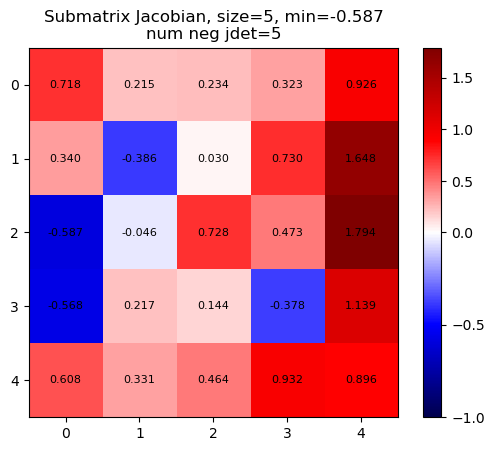

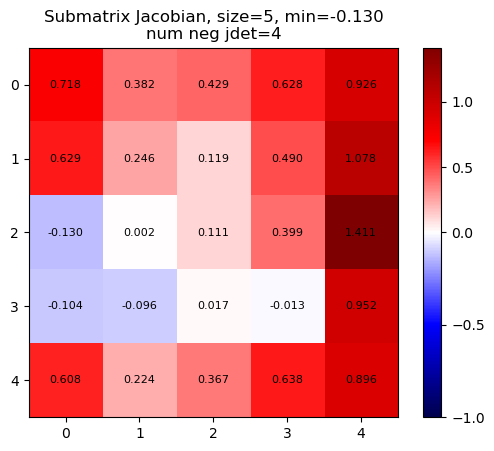

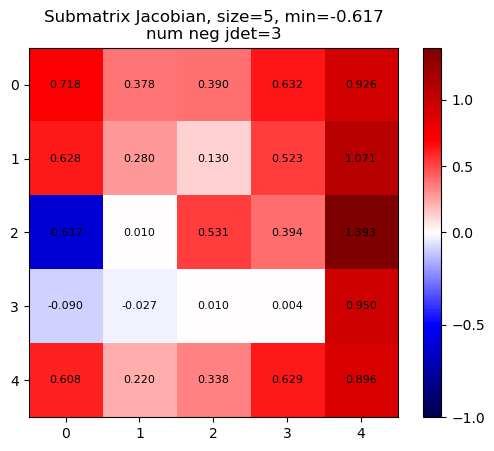

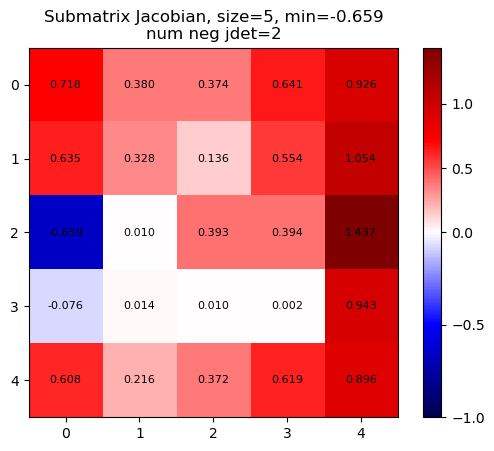

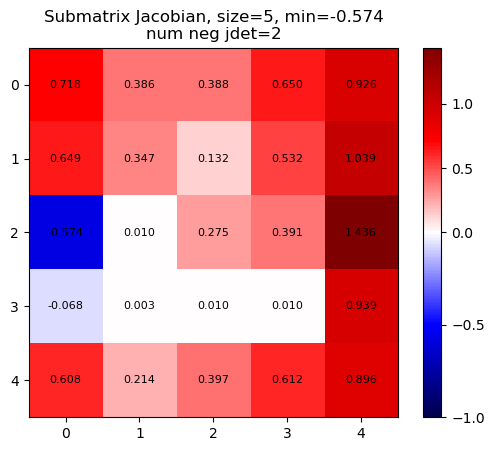

...

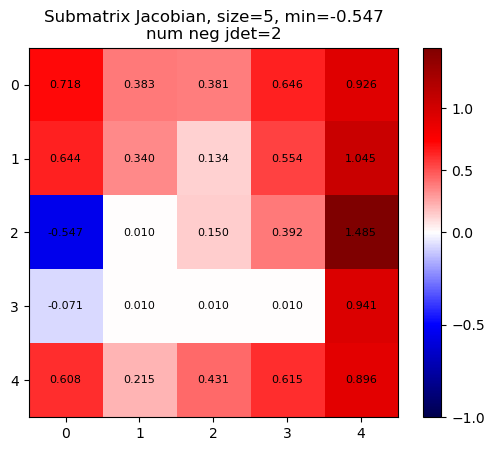

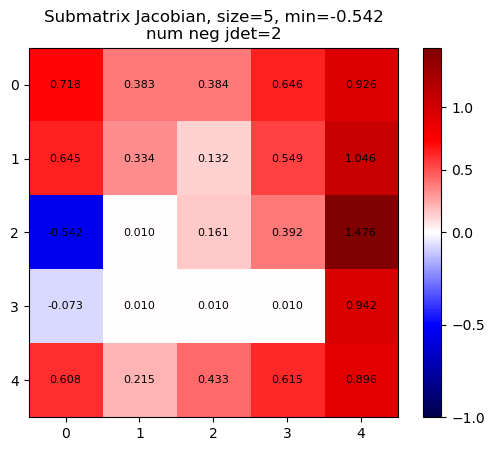

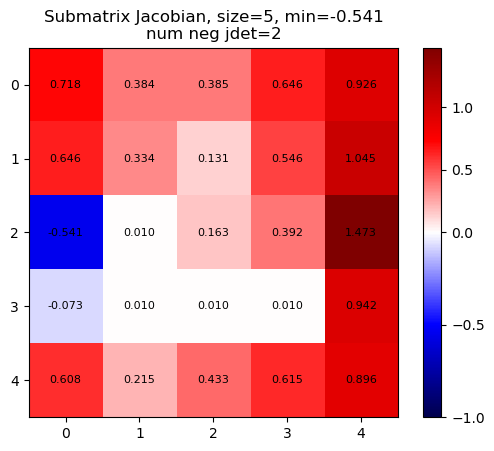

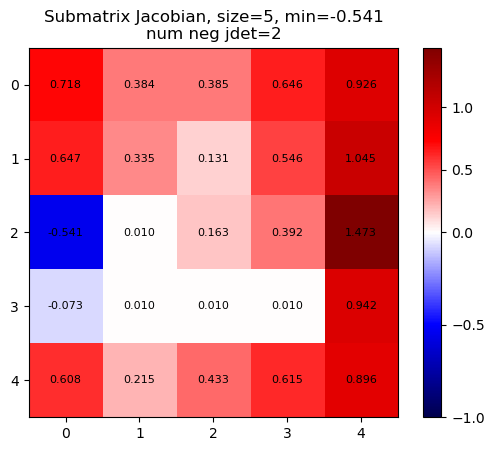

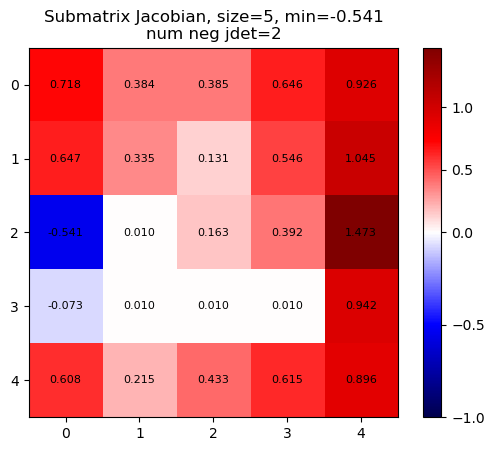

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.6777445902461874
            Iterations: 23
            Function evaluations: 1183
            Gradient evaluations: 23
            x-def               y-def           jacobian          
              min       max       min      max       min       max
initial -2.999704  2.999704  0.000000  0.00000 -0.693885  1.809693
final   -2.774946  2.999704 -0.731668  1.11732 -0.556470  1.722864
meshgrid shape for plot: (10, 10)


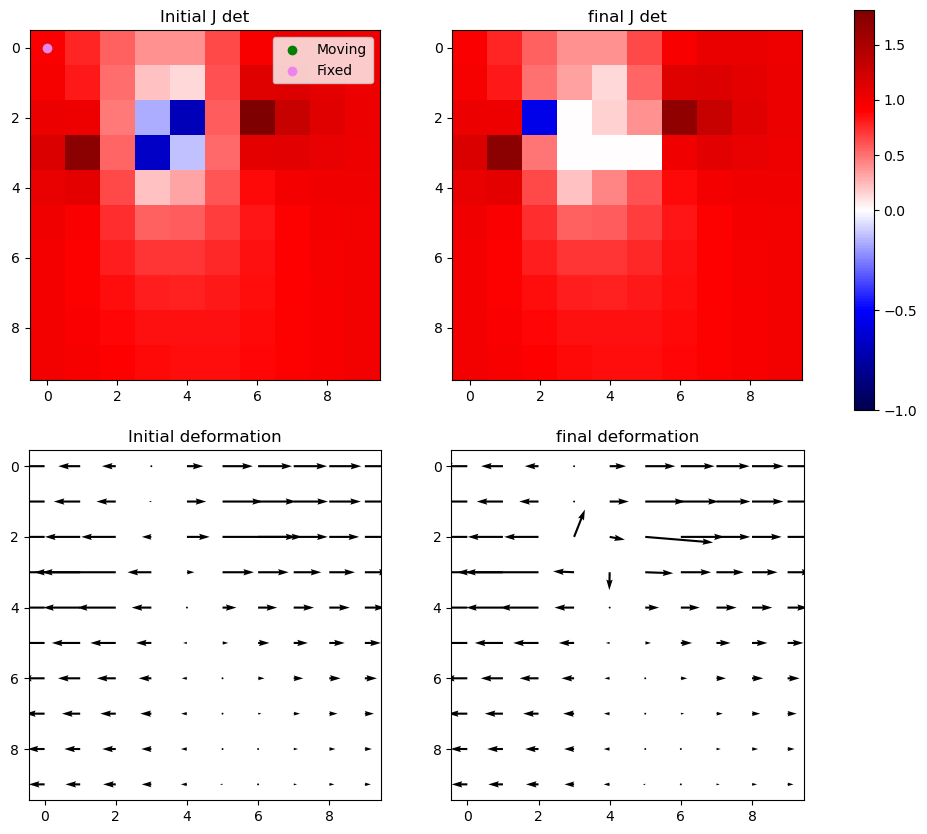

Iter 1: For index (2, 4), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


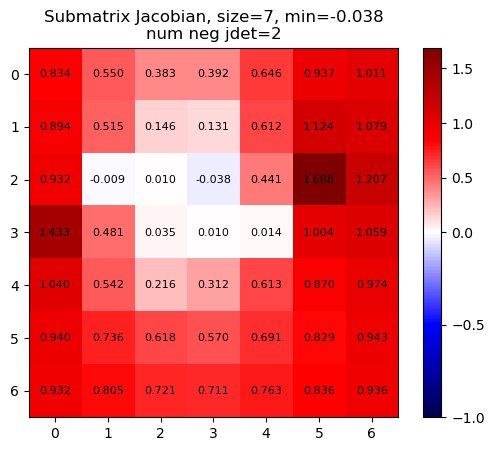

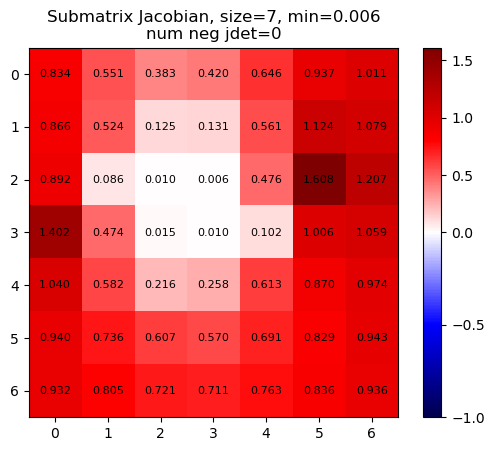

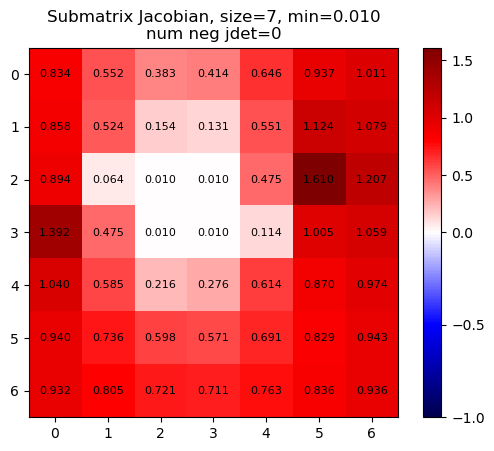

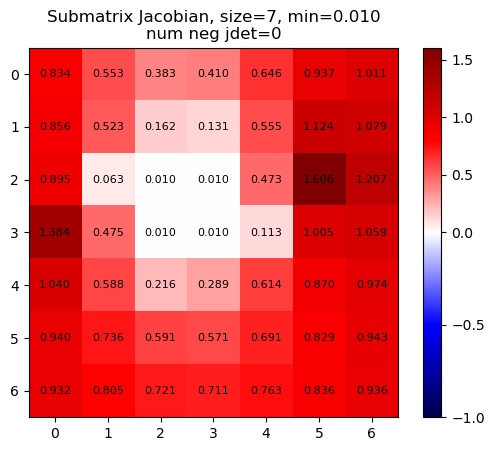

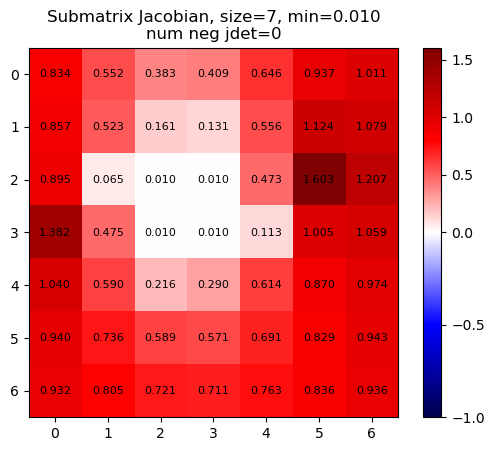

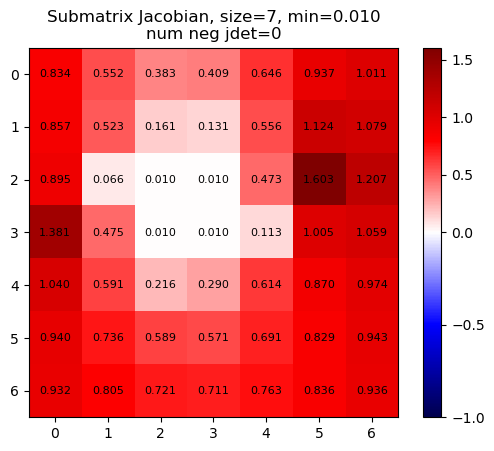

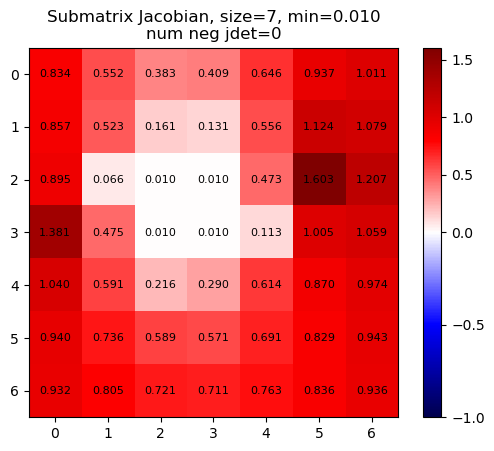

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.1844034755435475
            Iterations: 7
            Function evaluations: 693
            Gradient evaluations: 7
            x-def               y-def           jacobian          
              min       max       min       max      min       max
initial -2.774946  2.999704 -0.731668  1.117320 -0.55647  1.722864
final   -2.630866  2.643654 -0.377210  0.387919  0.01000  1.602945
meshgrid shape for plot: (10, 10)


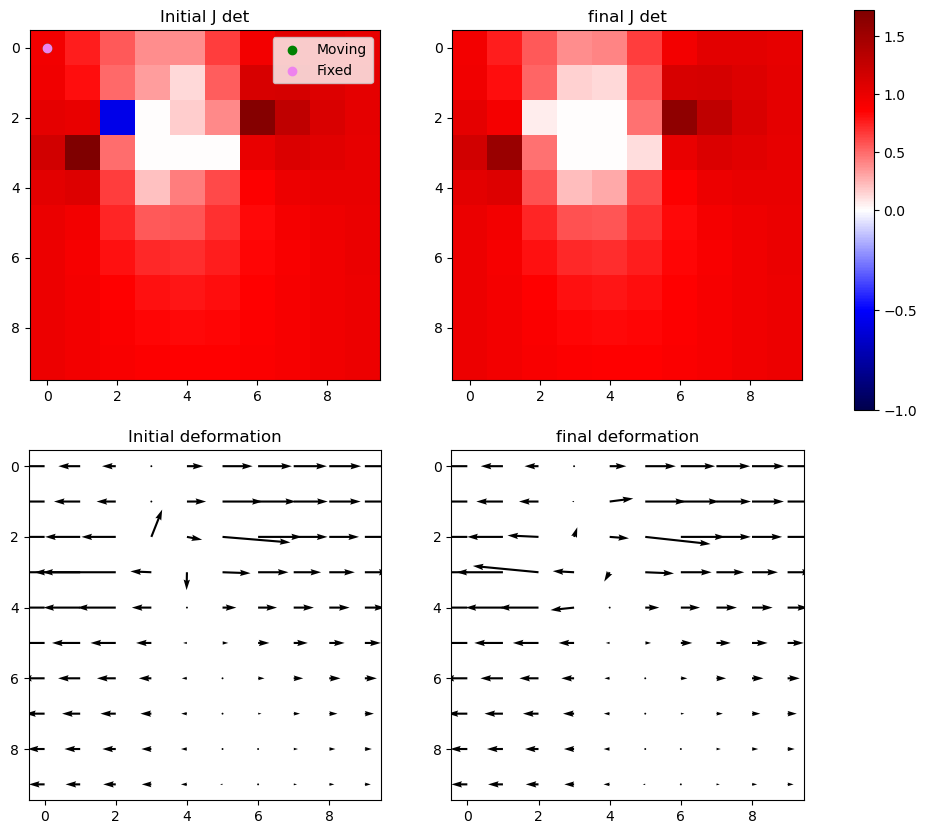

Iter 1 with 0 -ve jacs
Deviation from initial = 1.1844034755435475
Changed number of -ve jacobians from 4 to 0
Time taken for iter SLSQP optimisation: 10.803565263748169s
            x-def              y-def            jacobian          
              min       max      min       max       min       max
initial -2.999704  2.999704  0.00000  0.000000 -0.693885  1.809693
final   -2.630866  2.643654 -0.37721  0.387919  0.010000  1.602945
meshgrid shape for plot: (10, 10)


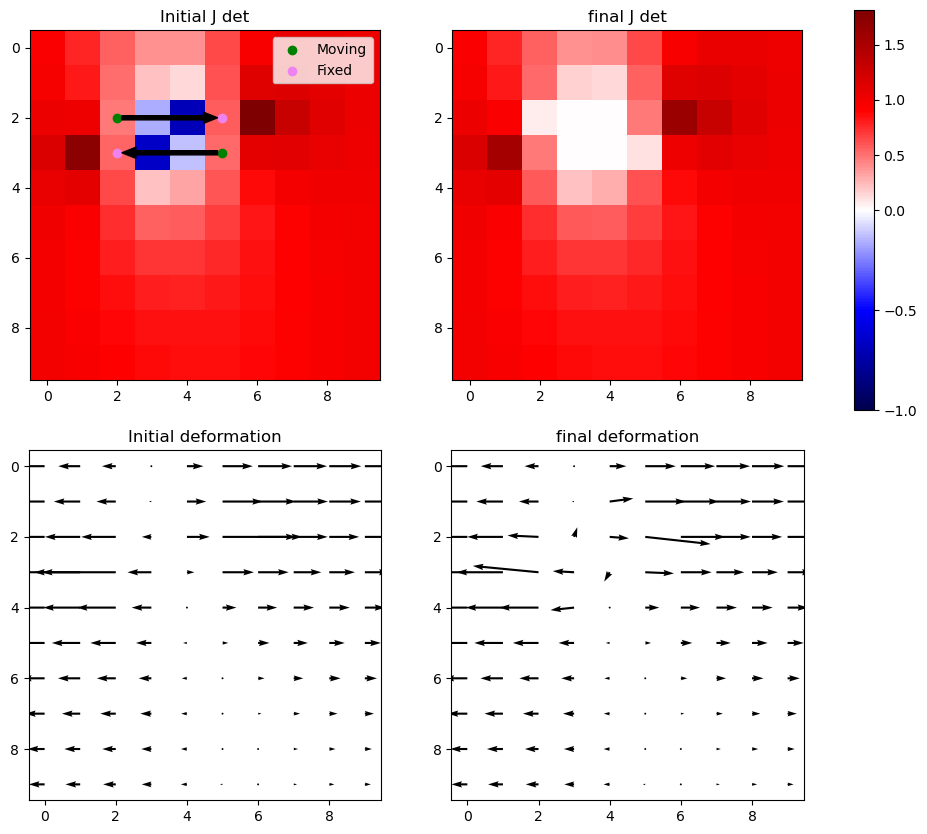

In [114]:
msample = np.array([
    [0, 2, 2],
    [0, 3, 5],
])
fsample = np.array([
    [0, 2, 5],
    [0, 3, 2],
])

fixed_sample = np.zeros((1, 10, 10)) # depth, rows, cols

run_lapl_and_correction(fixed_sample, msample, fsample)

# takes 15 mins and does not conclude on full 20x40 constraints
# 1.5mins on 10x10 constraints
# reduce constraints
# (10,5) - 50 vs 5 - 3.9s vs 0.15s
# (5,5) - 25 vs 5 - 0.35s vs 0.0645s
# (10, 10) - 100 vs 5 - 50s vs 0.46s
# (20, 20) - 400 vs 5 - waited for full one to run for 20min vs 1.5min

# 20x40 with 5 random constraints - 10.5 mins
# 20x40 run over the full thing - 174 min does not finish

## Long runtime

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)



Iter 1: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


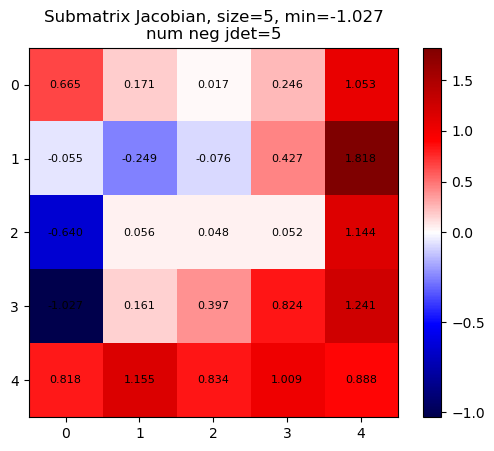

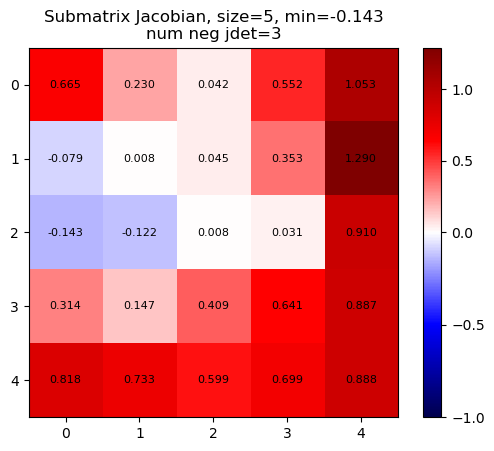

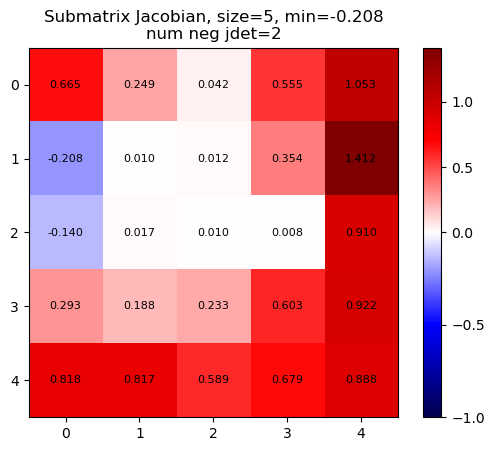

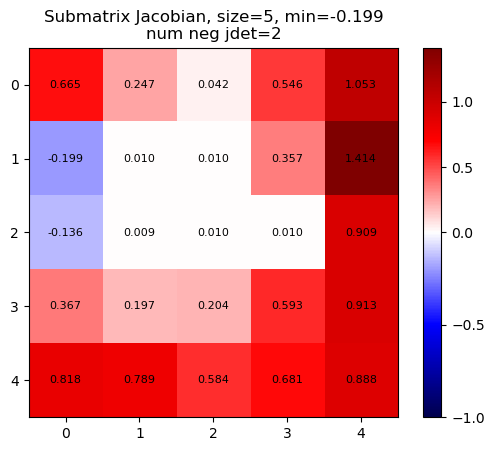

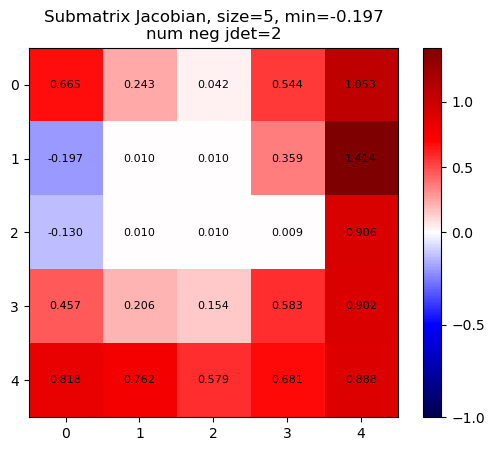

...

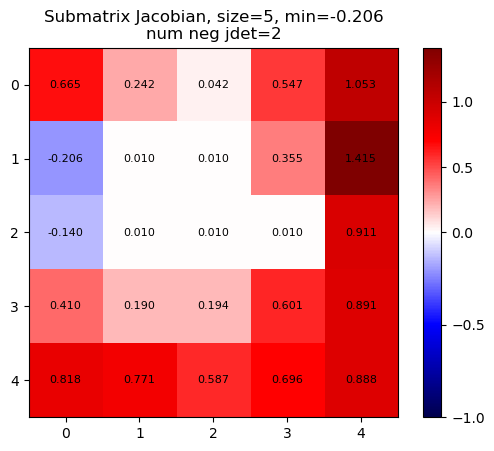

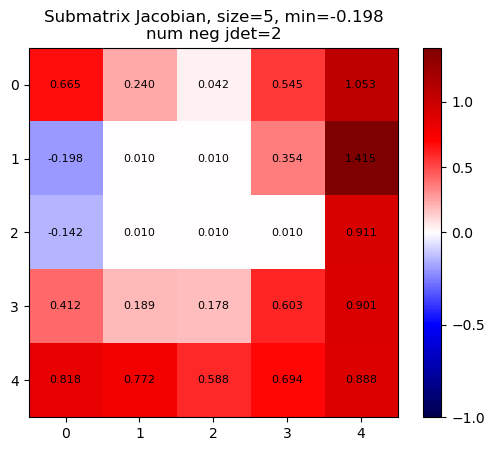

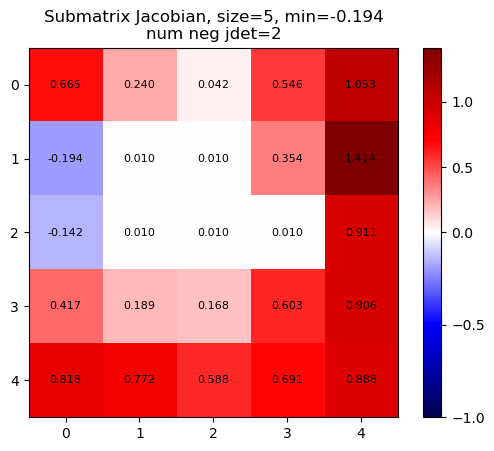

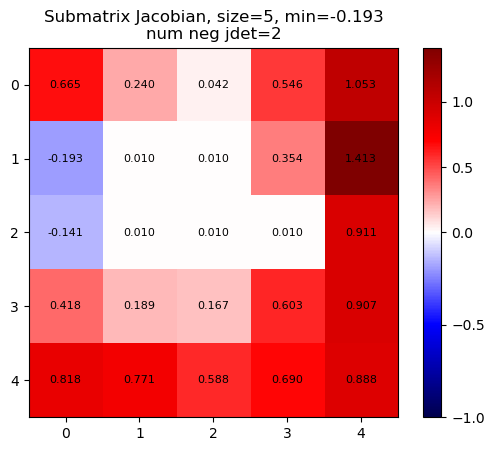

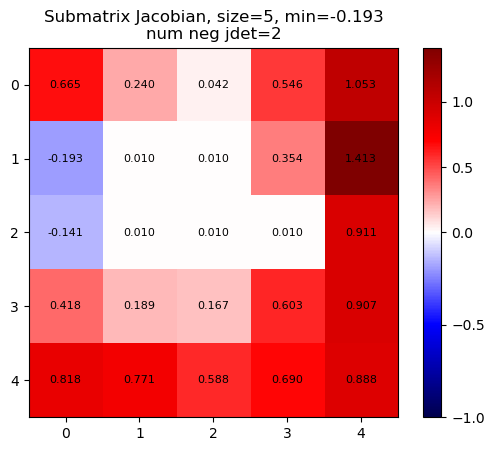

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.4308420092166065
            Iterations: 21
            Function evaluations: 1081
            Gradient evaluations: 21
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.999822  2.999822  0.000000  0.000000 -0.730373  1.709059
final   -2.821565  2.999822 -0.654628  0.702138 -0.192925  1.606286
meshgrid shape for plot: (10, 10)


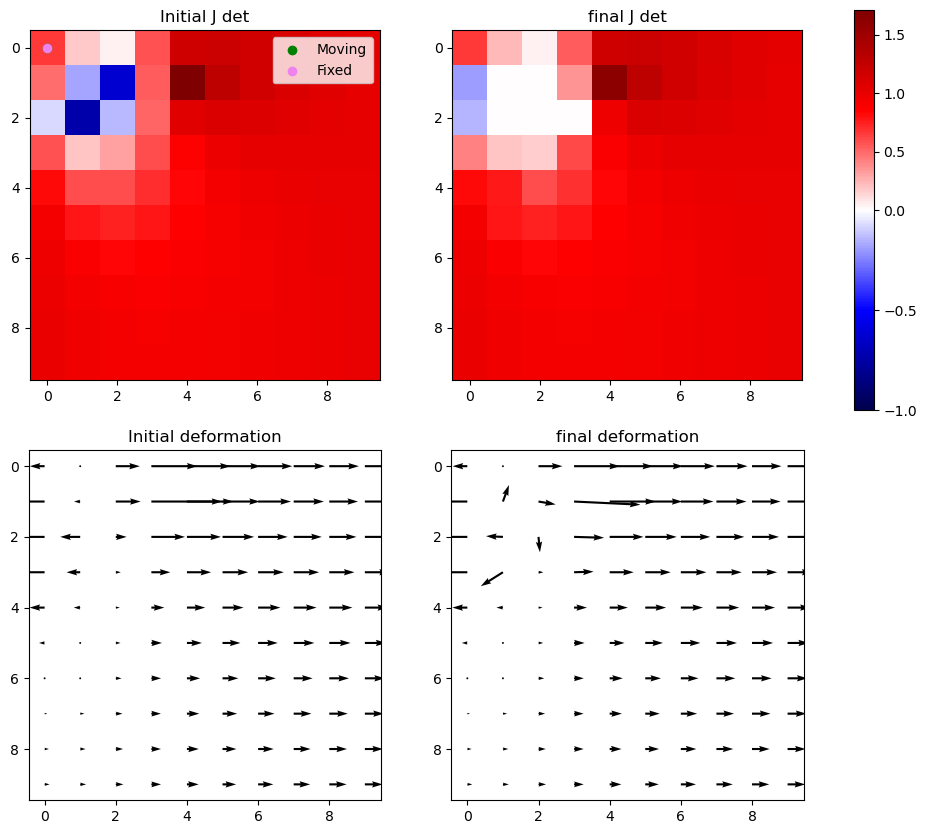

Iter 1: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


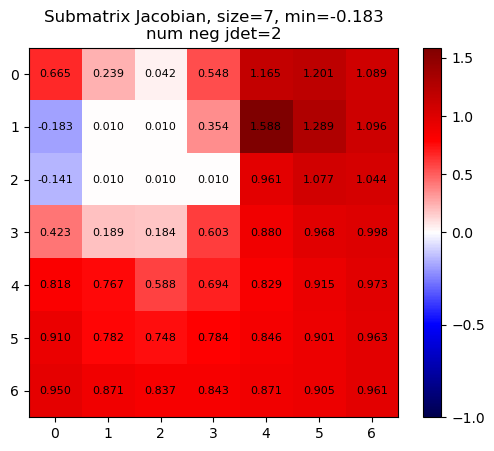

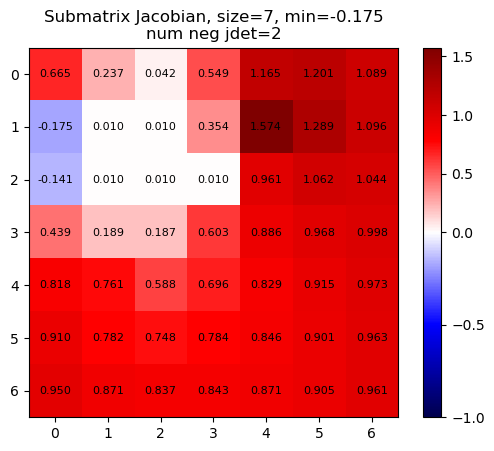

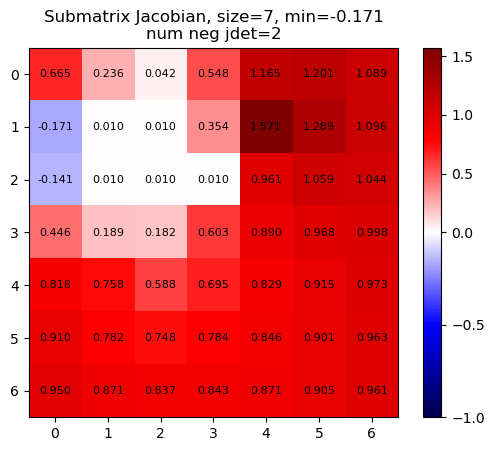

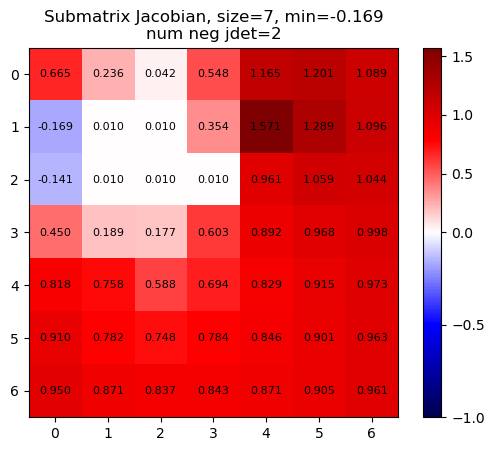

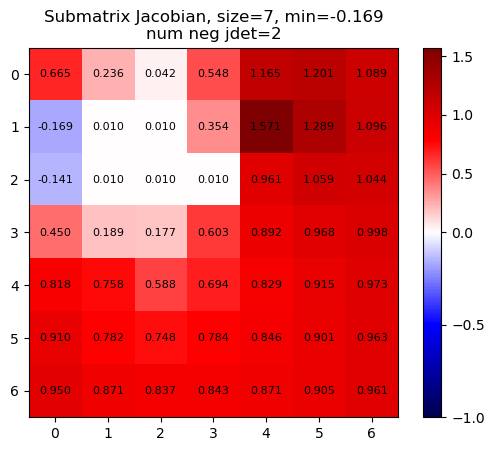

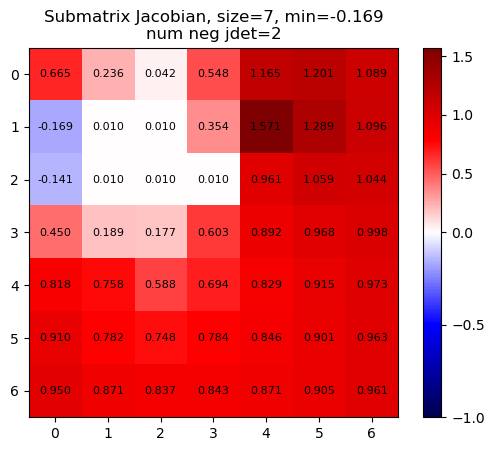

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.4275850554024634
            Iterations: 6
            Function evaluations: 594
            Gradient evaluations: 6
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.821565  2.999822 -0.654628  0.702138 -0.192925  1.606286
final   -2.840009  2.999822 -0.680641  0.660818 -0.169126  1.571461
meshgrid shape for plot: (10, 10)


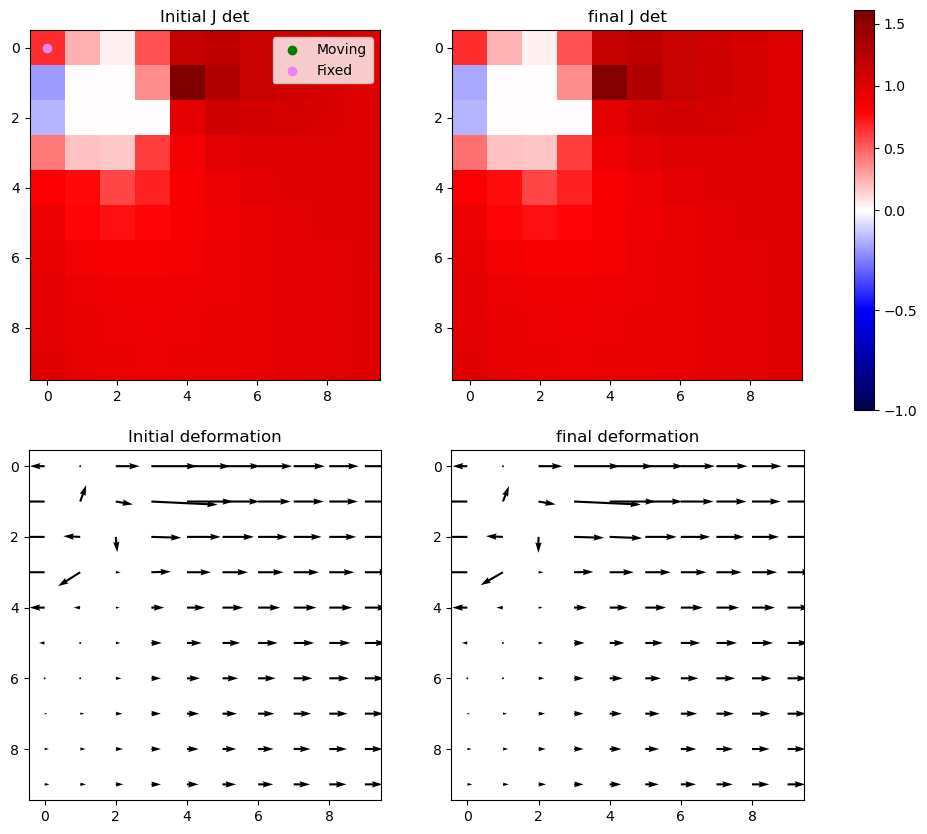

Iter 1: For index (2, 1), window size increased to 9 at iter 3


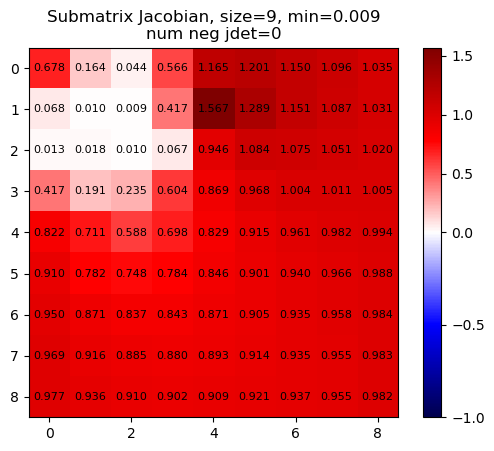

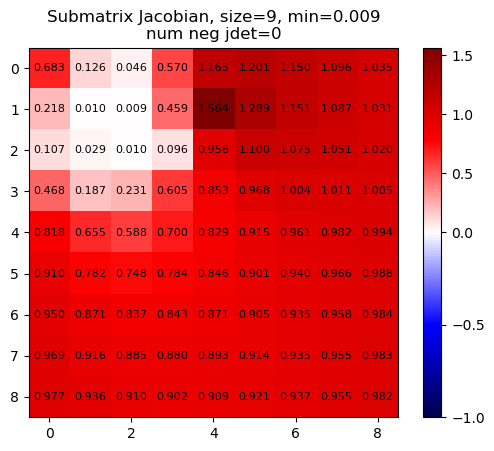

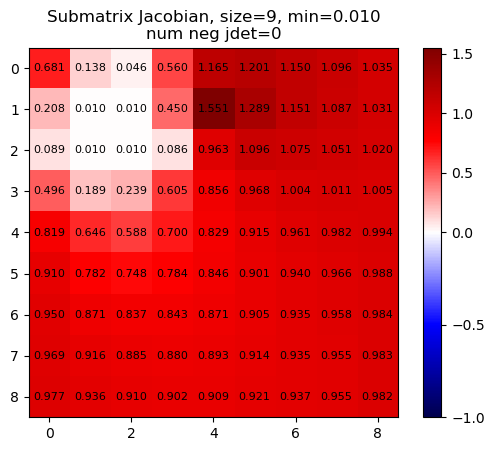

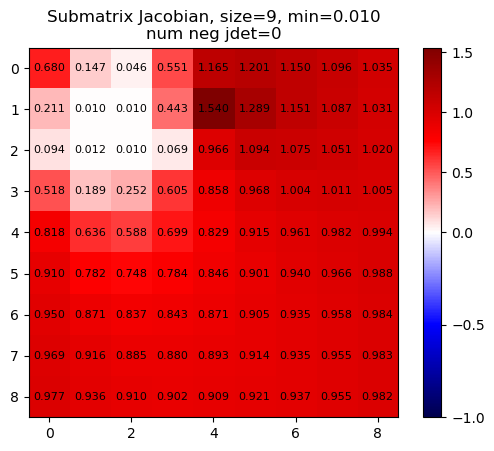

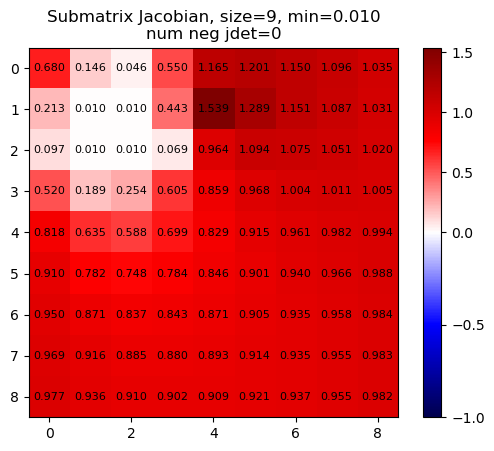

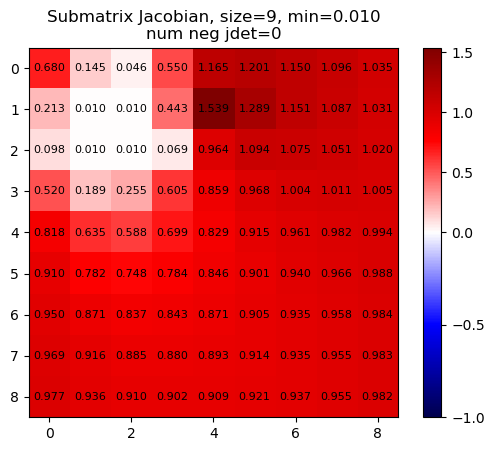

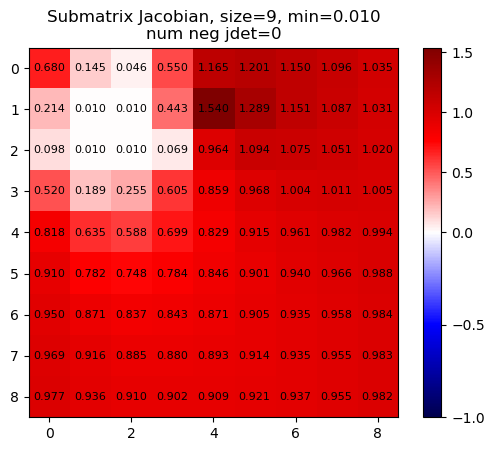

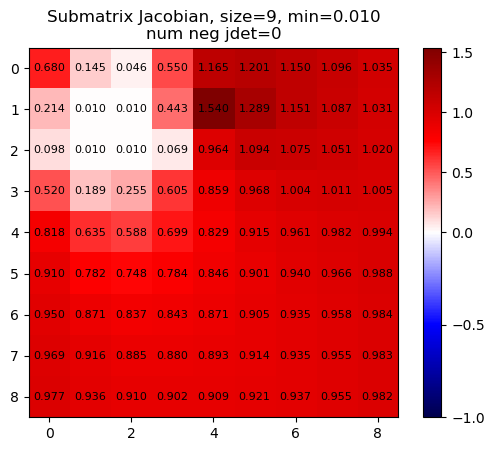

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 8
            Function evaluations: 1304
            Gradient evaluations: 8
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.840009  2.999822 -0.680641  0.660818 -0.169126  1.571461
final   -2.709375  2.555239 -0.395733  0.372456  0.010000  1.539590
meshgrid shape for plot: (10, 10)


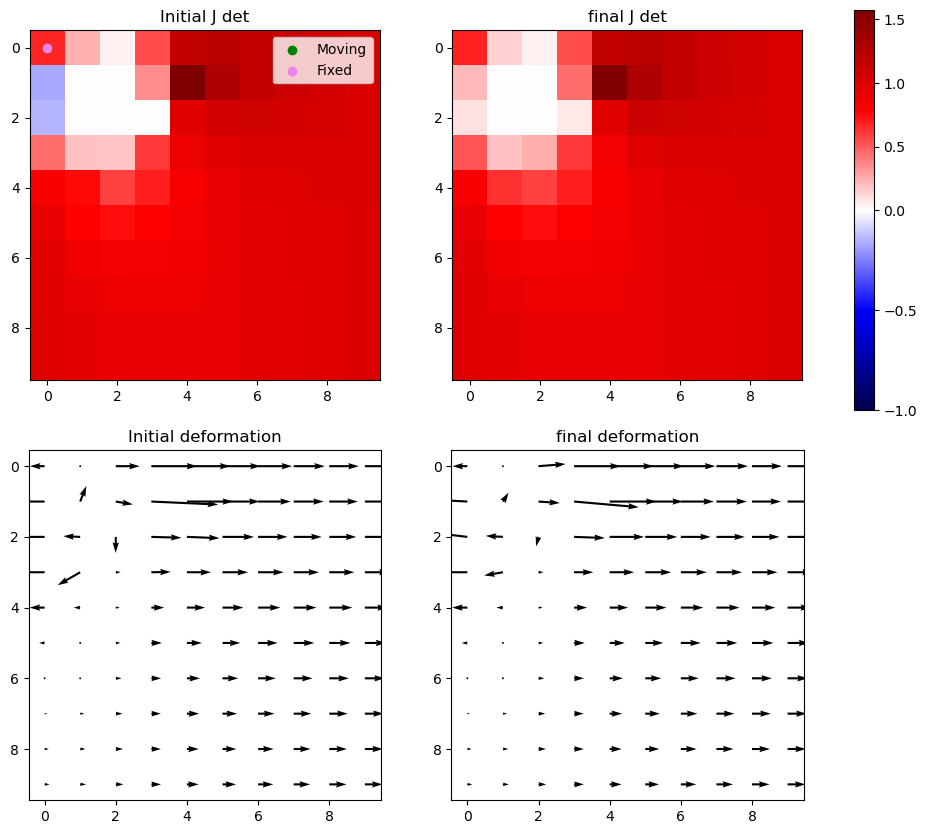

Iter 1 with 0 -ve jacs



Iter 2: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


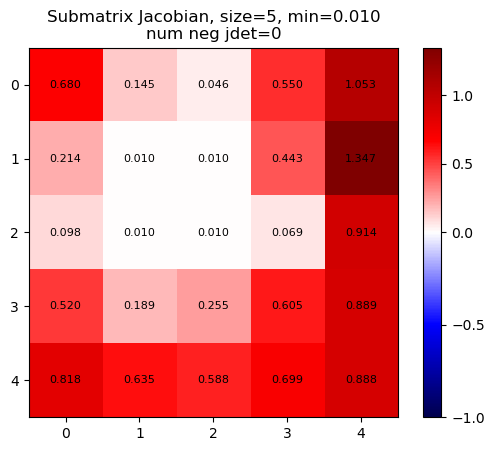

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


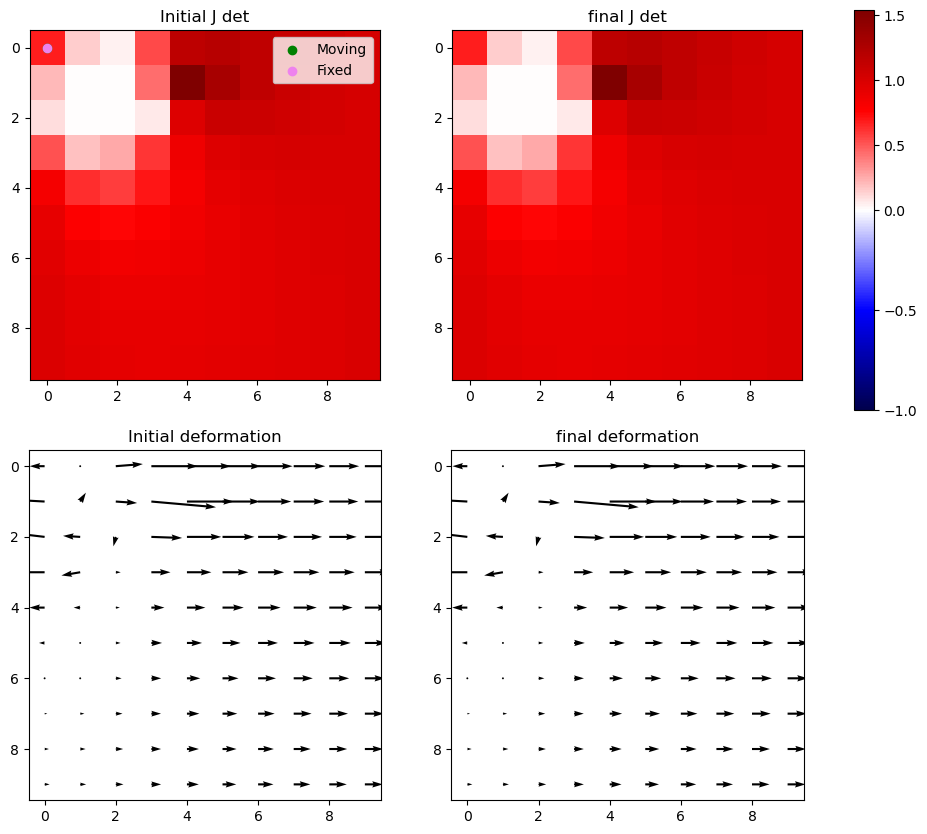

Iter 2: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


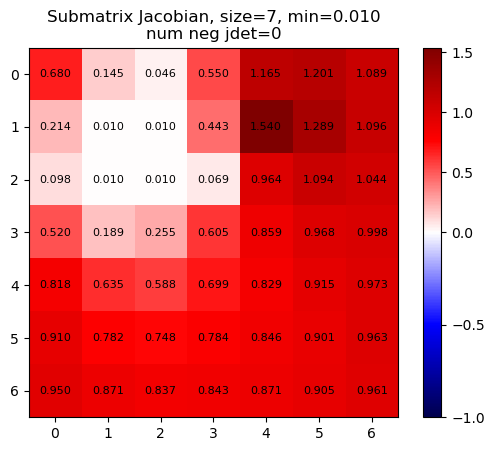

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


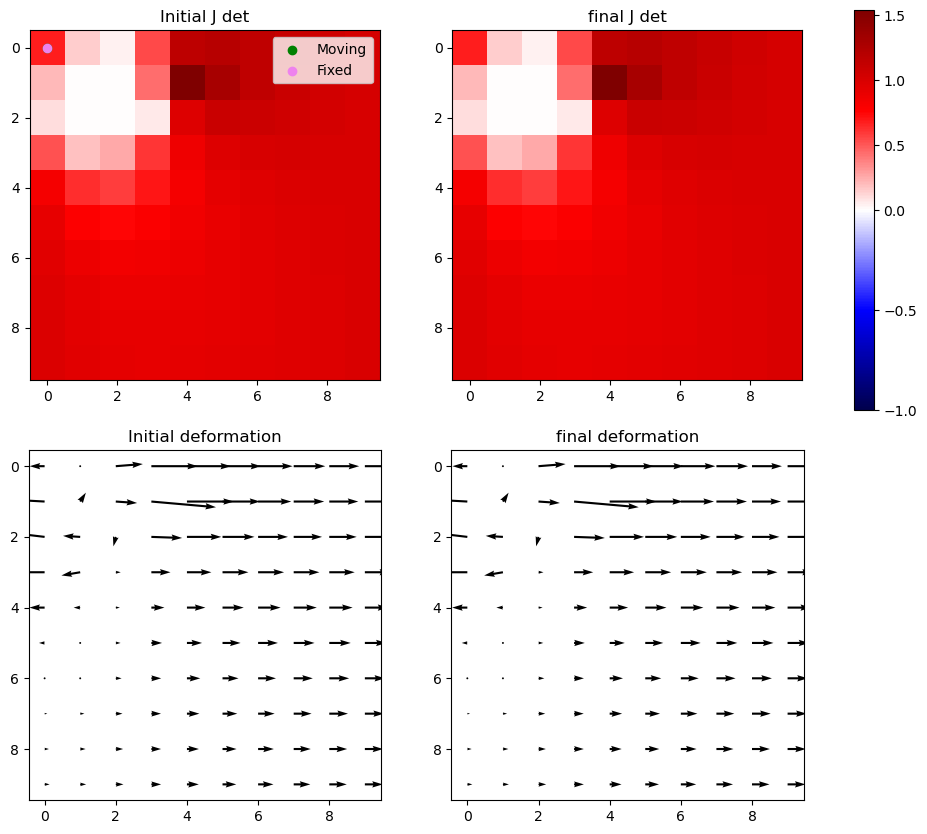

Iter 2: For index (2, 1), window size increased to 9 at iter 3


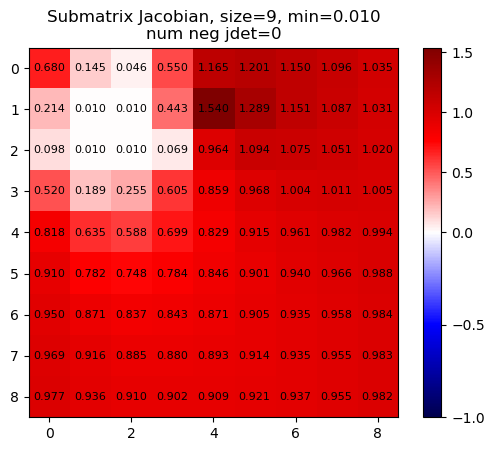

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


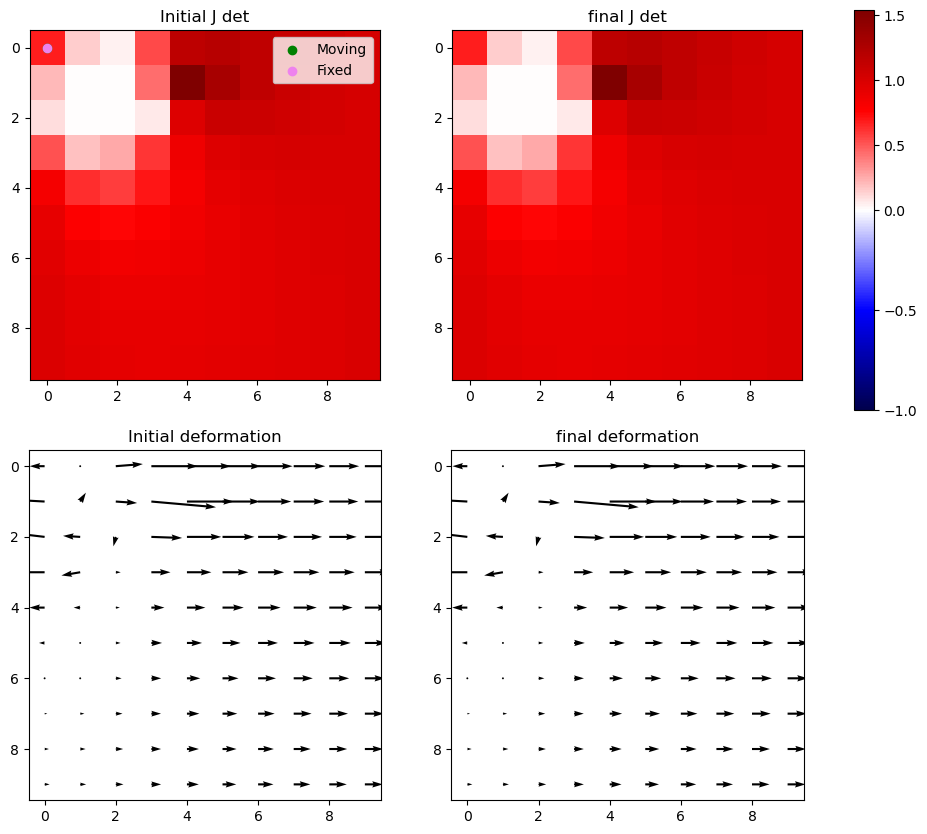

Iter 2 with 0 -ve jacs



Iter 3: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


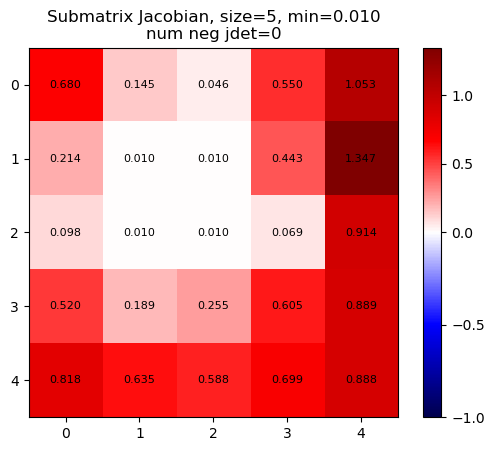

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


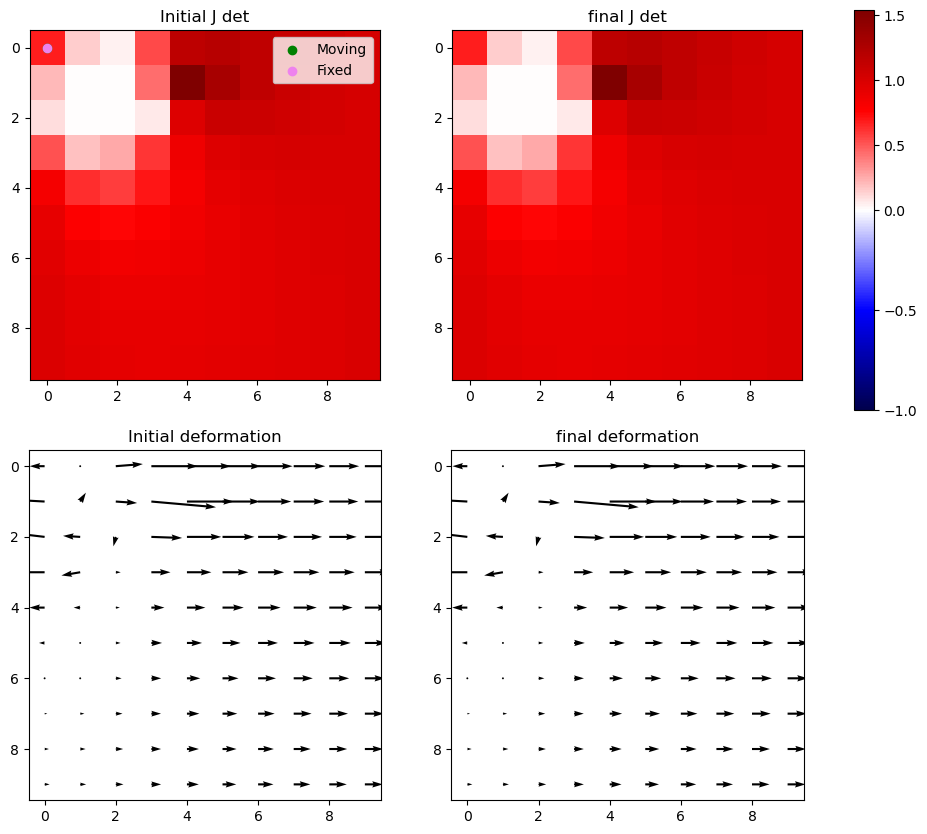

Iter 3: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


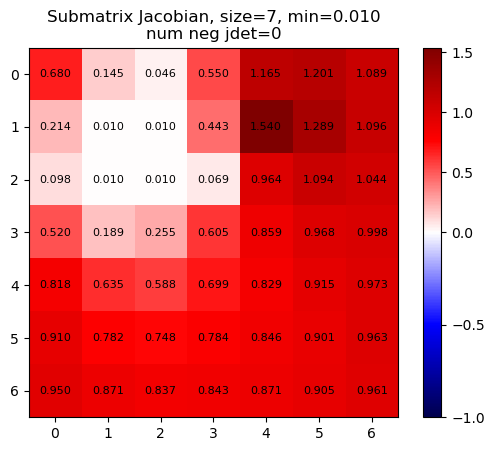

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


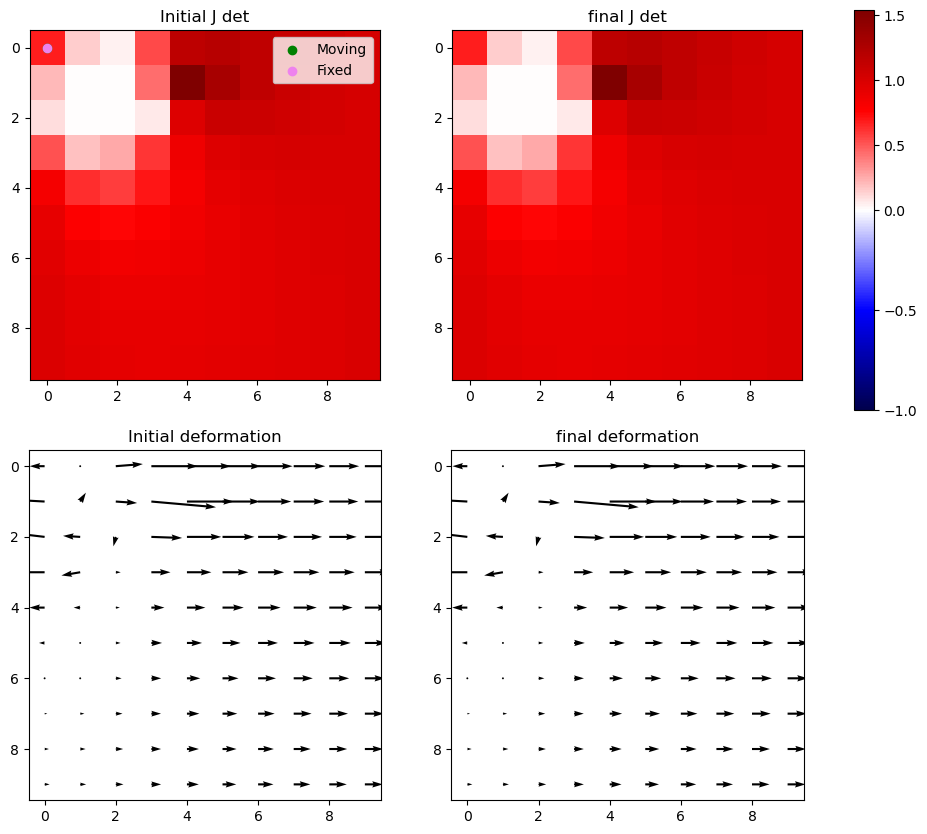

Iter 3: For index (2, 1), window size increased to 9 at iter 3


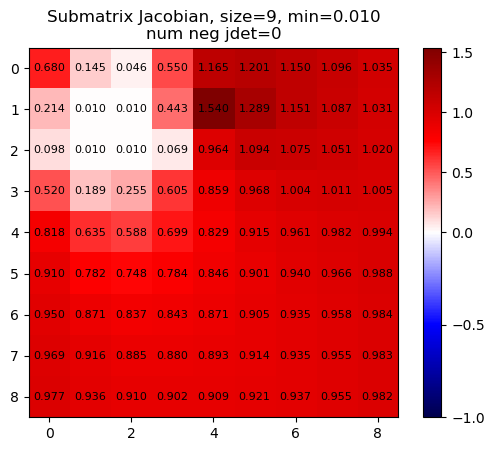

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


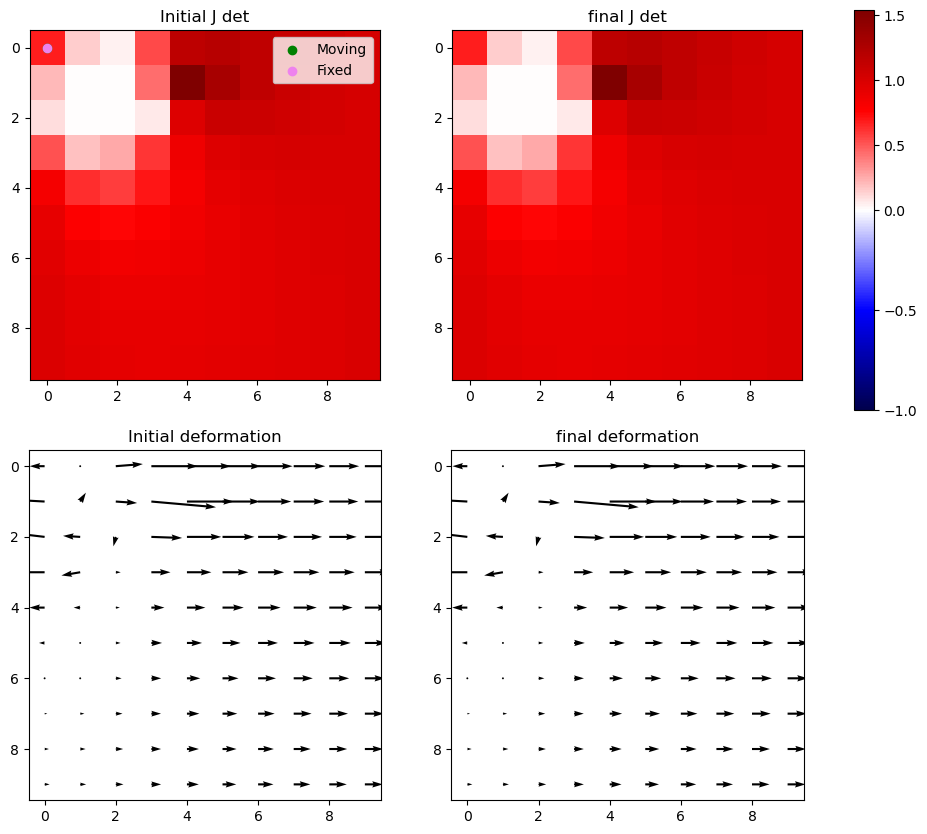

Iter 3 with 0 -ve jacs



Iter 4: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


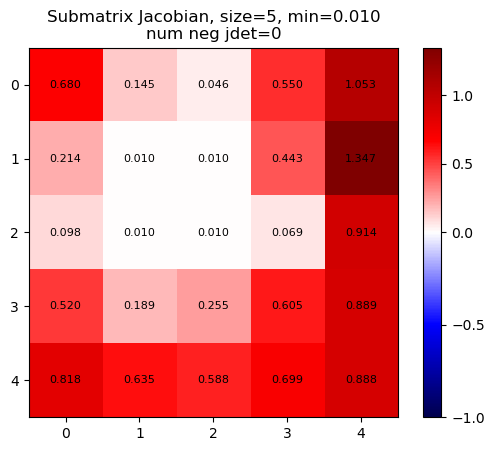

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


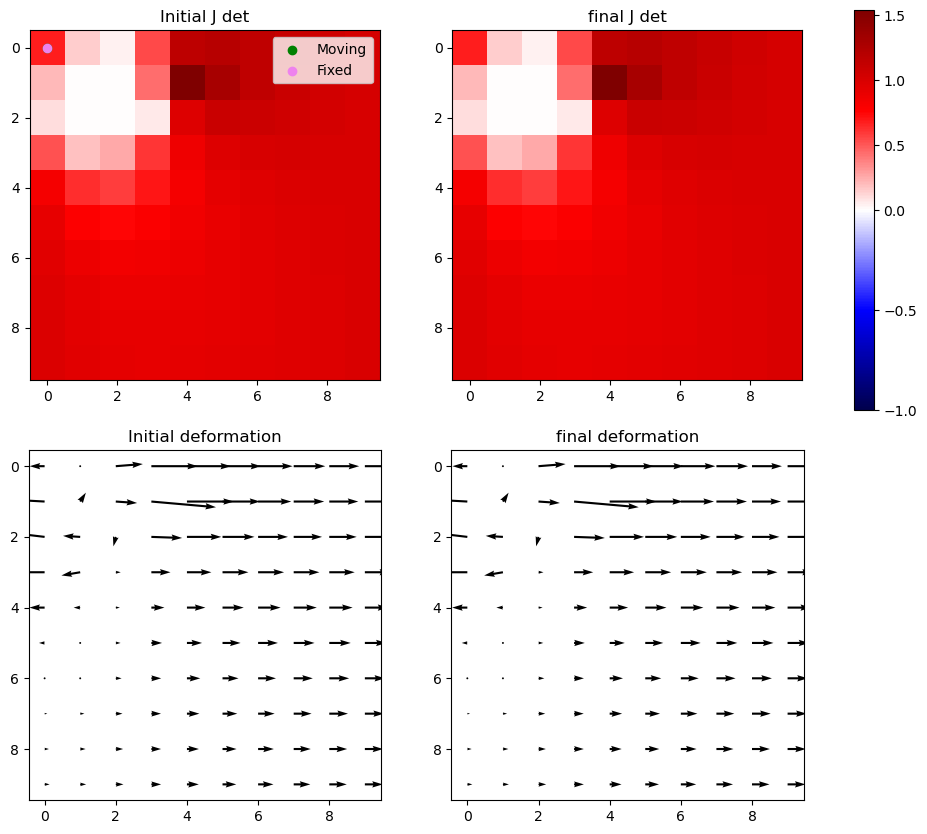

Iter 4: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


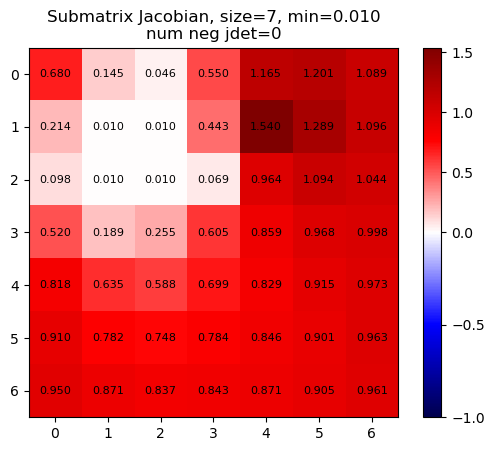

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


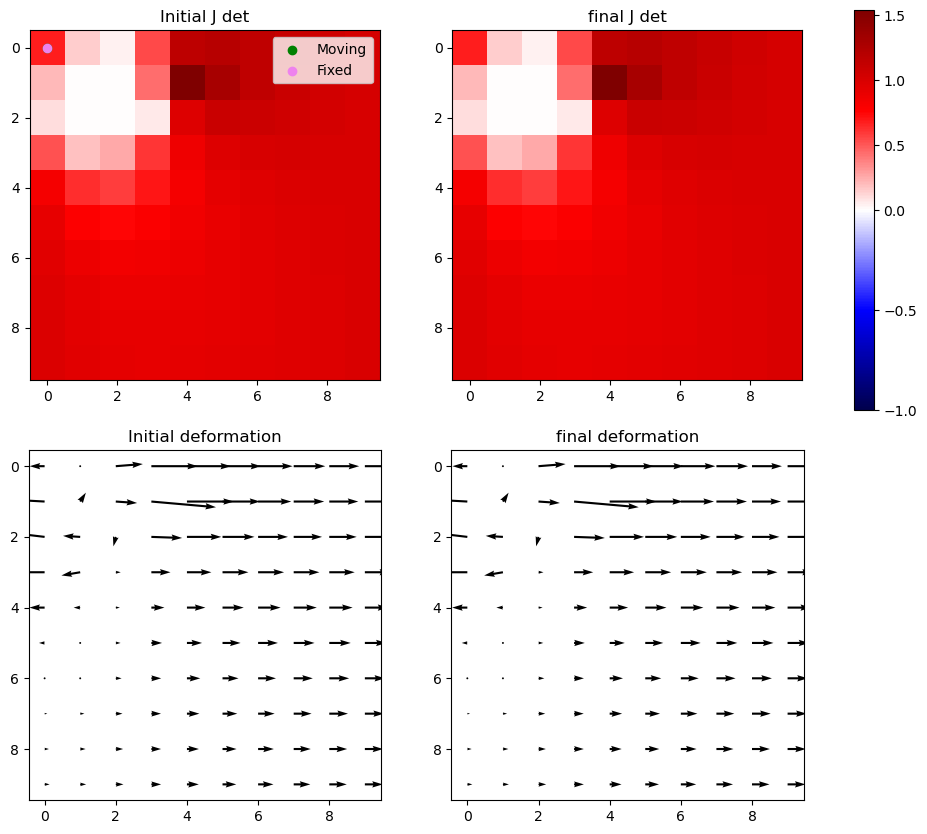

Iter 4: For index (2, 1), window size increased to 9 at iter 3


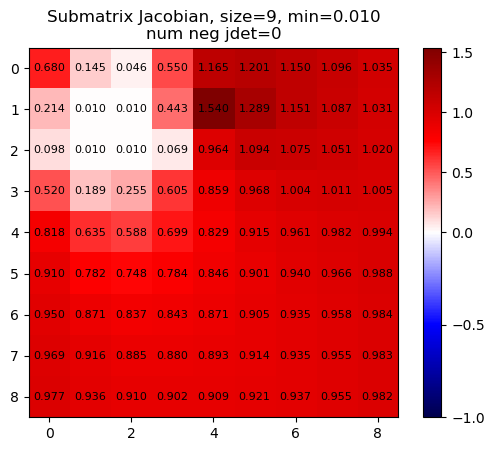

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


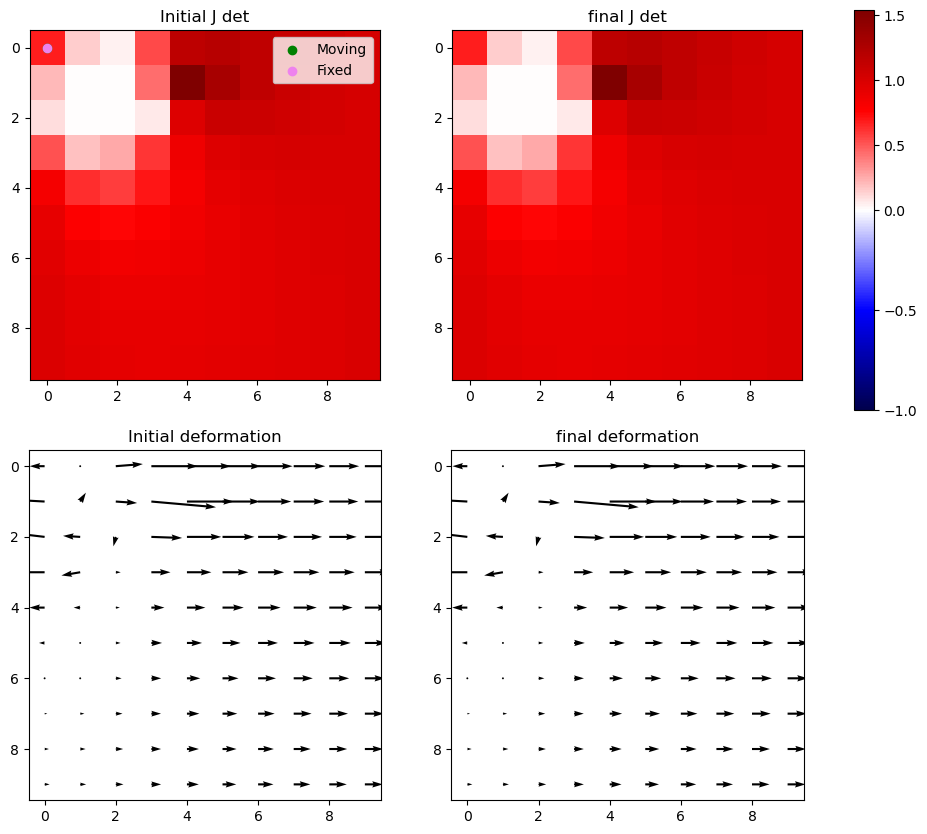

Iter 4 with 0 -ve jacs



Iter 5: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


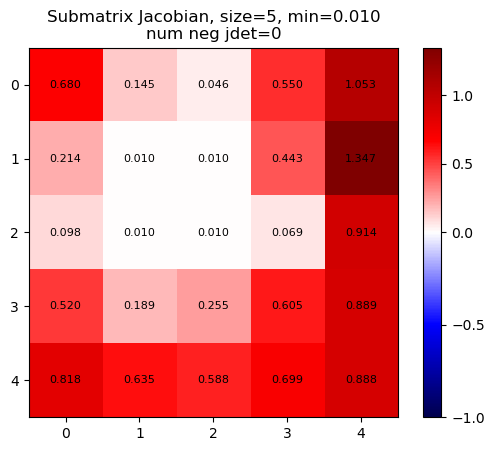

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


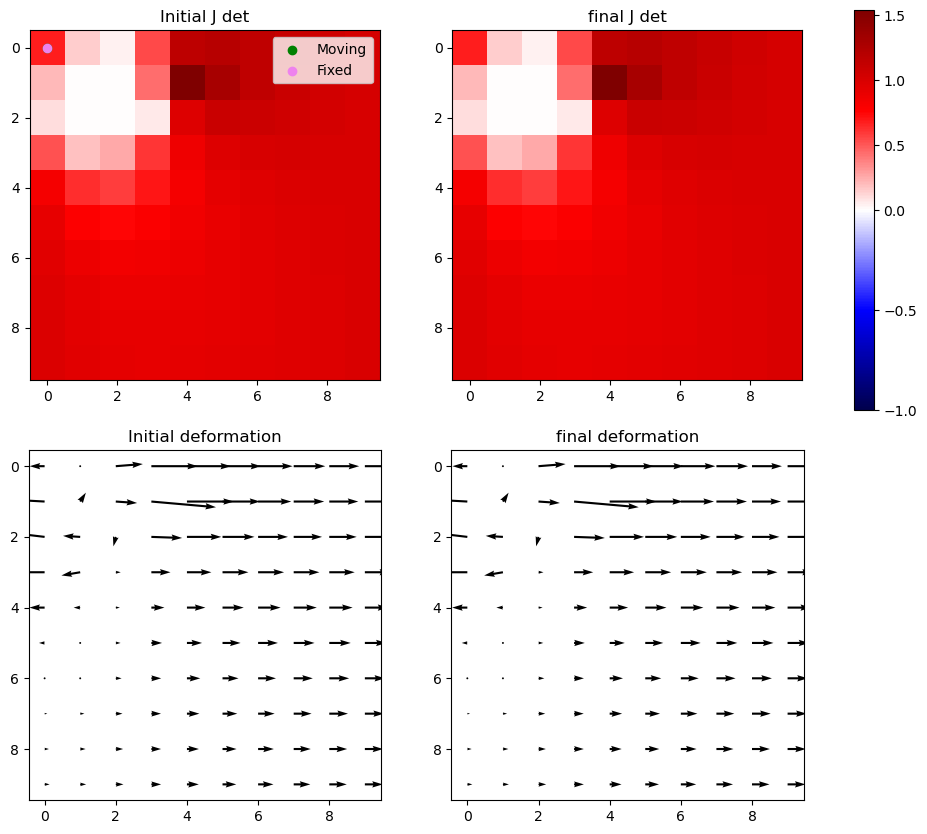

Iter 5: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


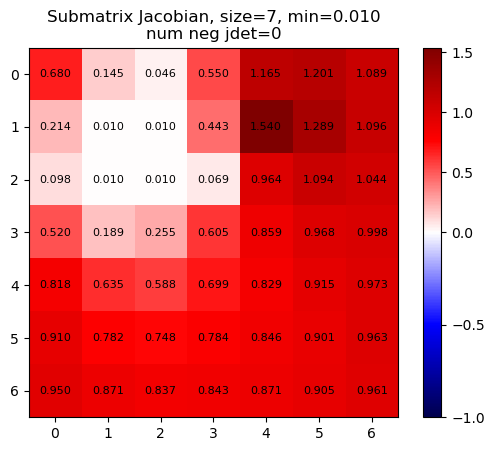

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


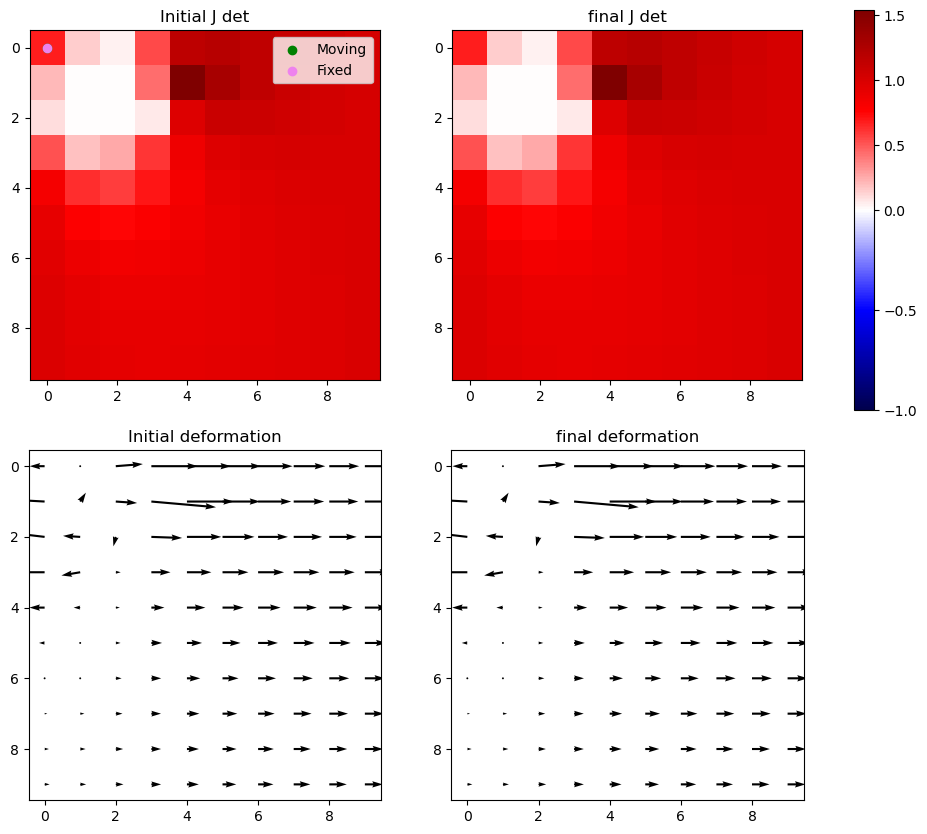

Iter 5: For index (2, 1), window size increased to 9 at iter 3


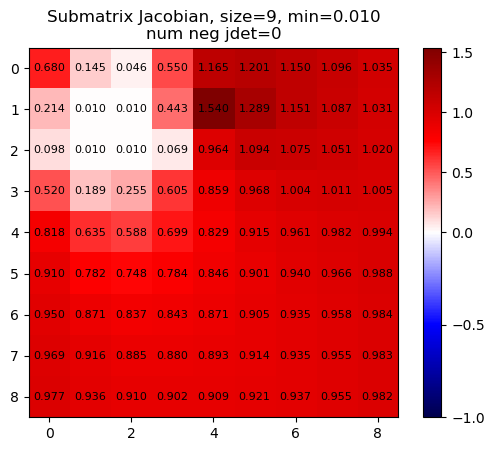

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


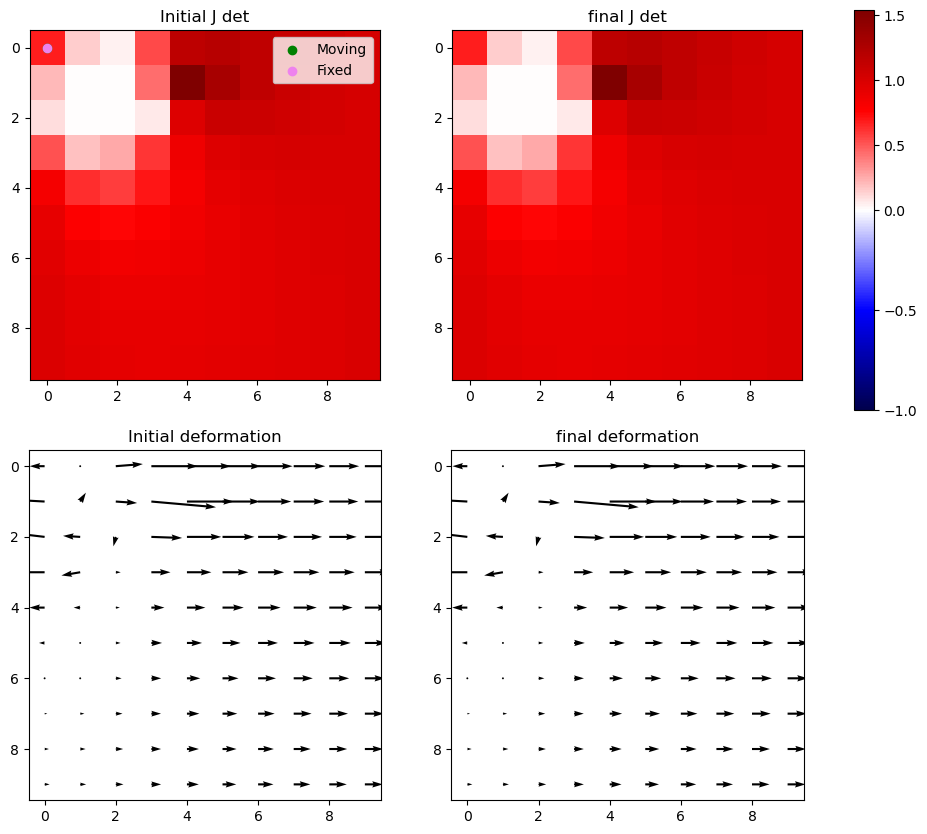

Iter 5 with 0 -ve jacs



Iter 6: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


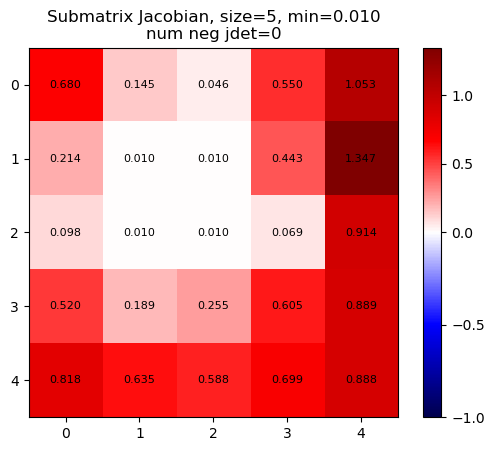

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


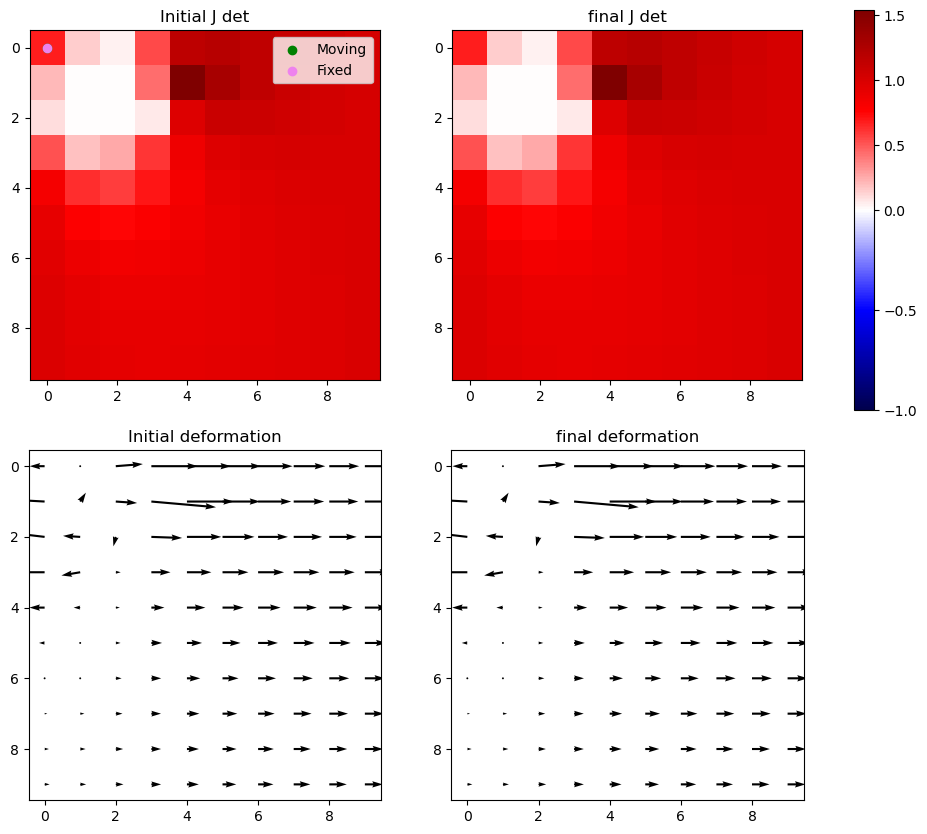

Iter 6: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


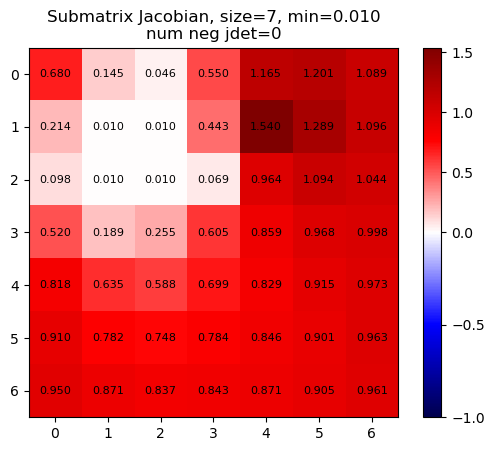

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


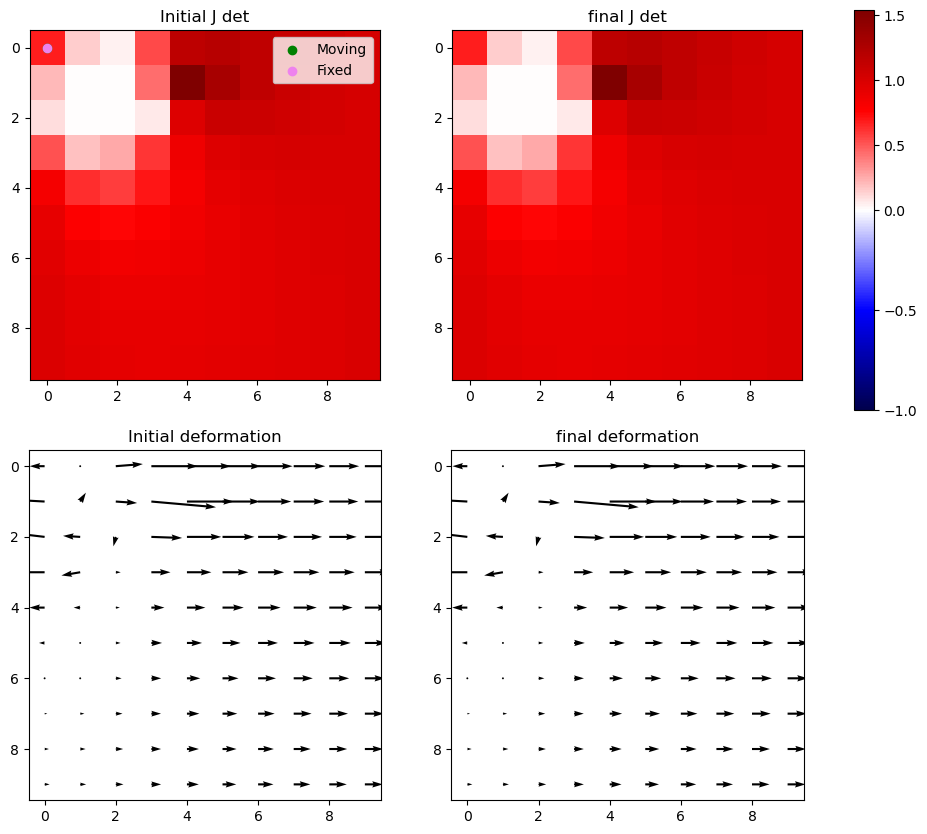

Iter 6: For index (2, 1), window size increased to 9 at iter 3


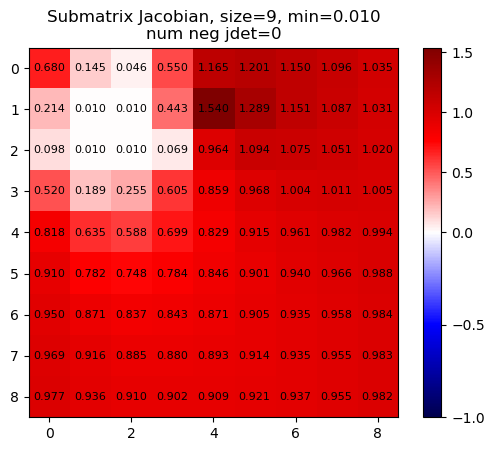

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


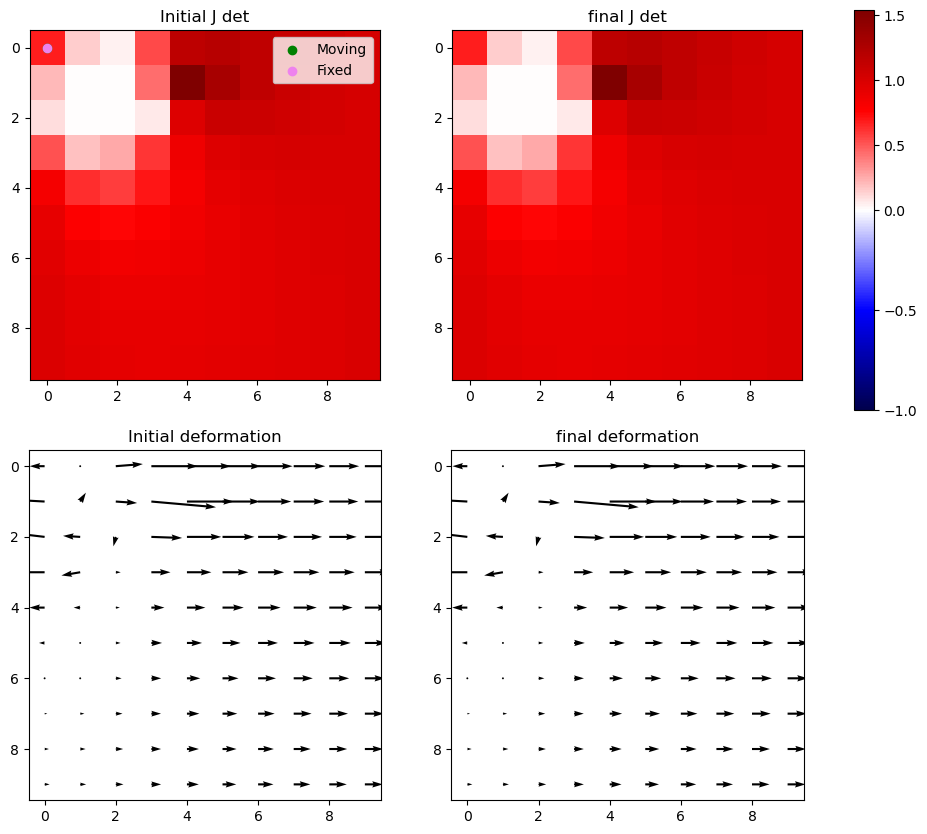

Iter 6 with 0 -ve jacs



Iter 7: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


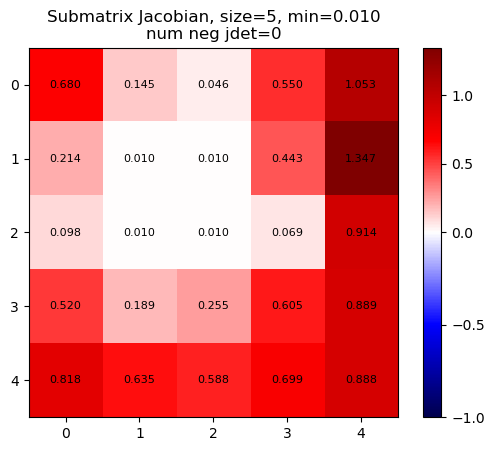

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


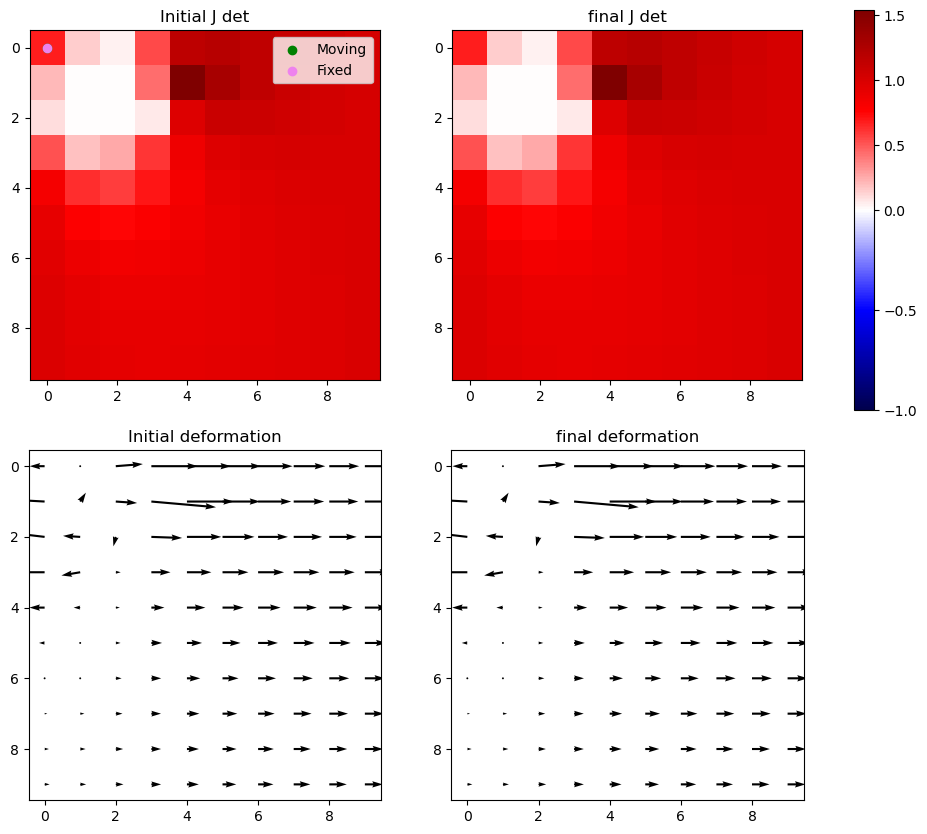

Iter 7: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


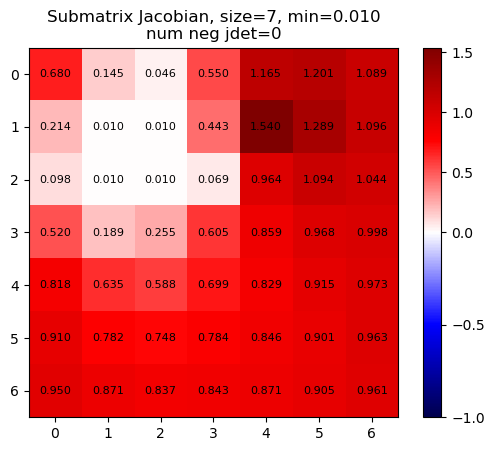

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


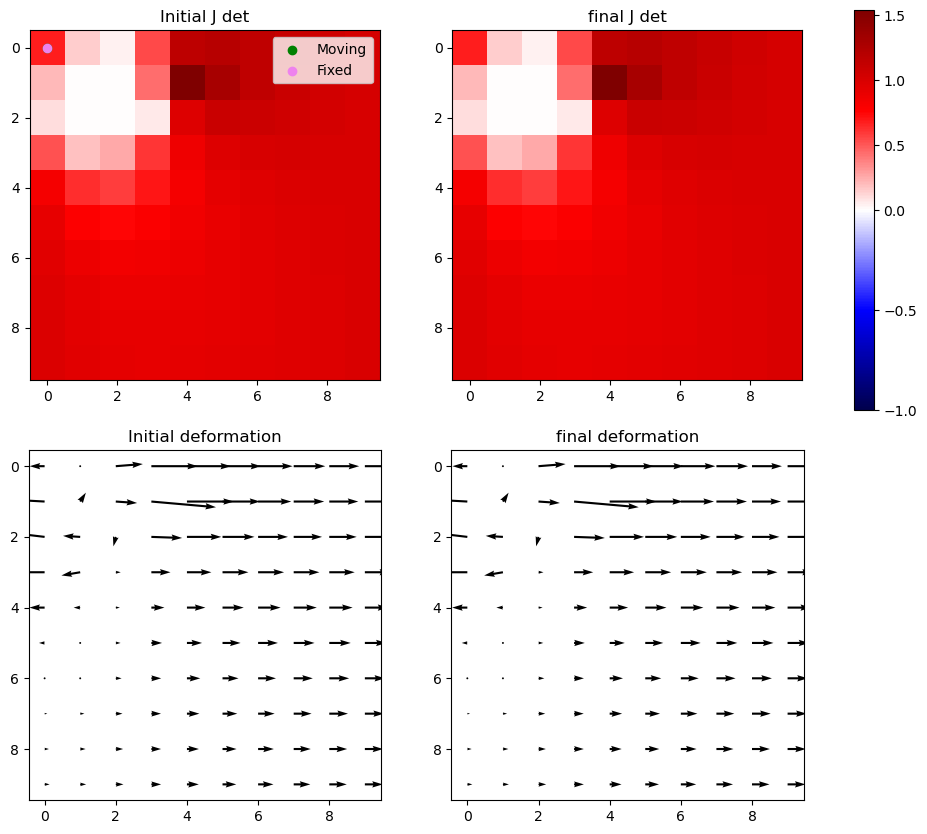

Iter 7: For index (2, 1), window size increased to 9 at iter 3


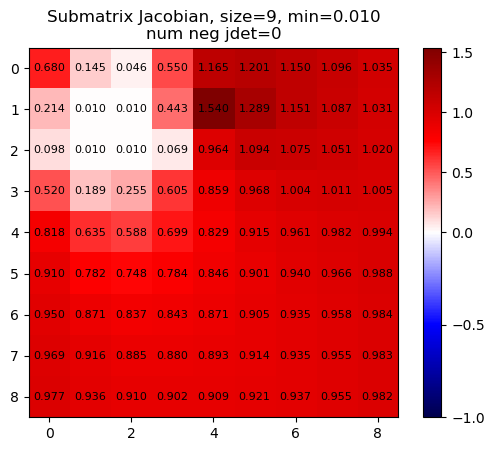

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


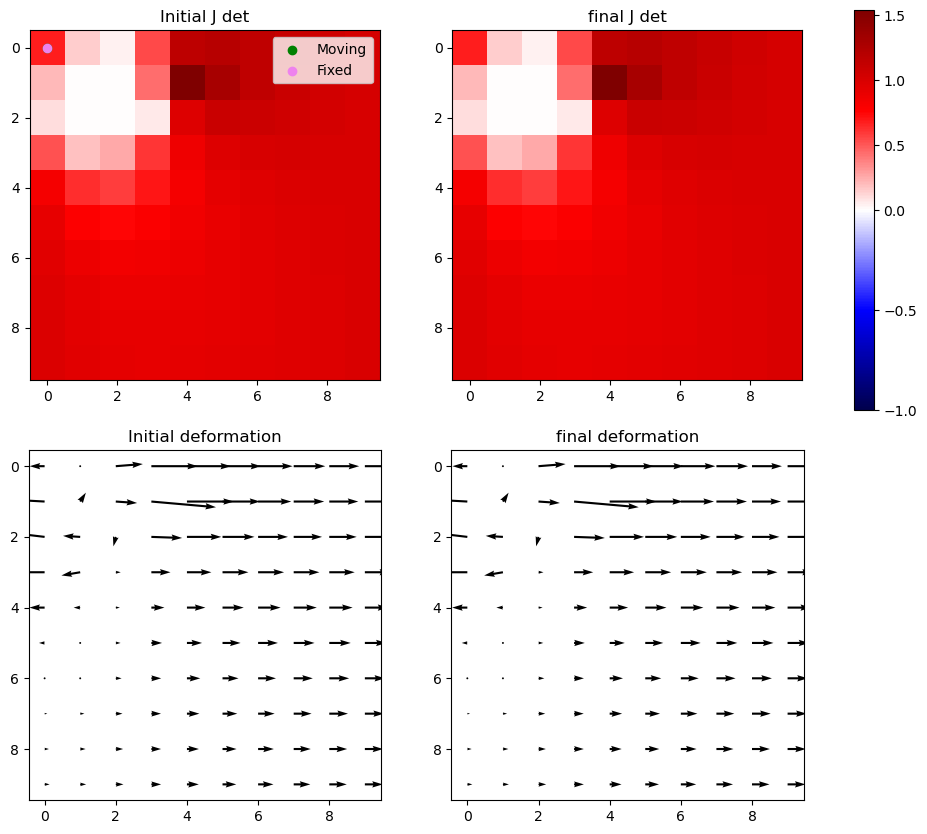

Iter 7 with 0 -ve jacs



Iter 8: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


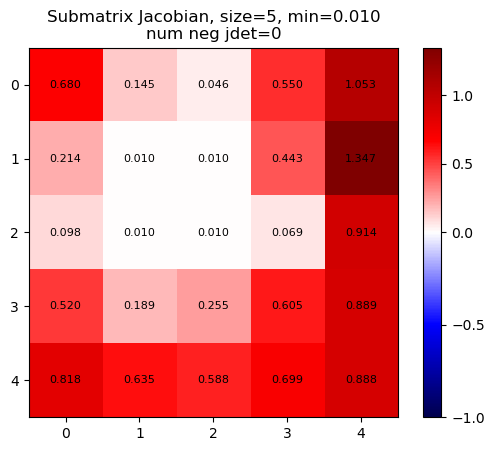

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


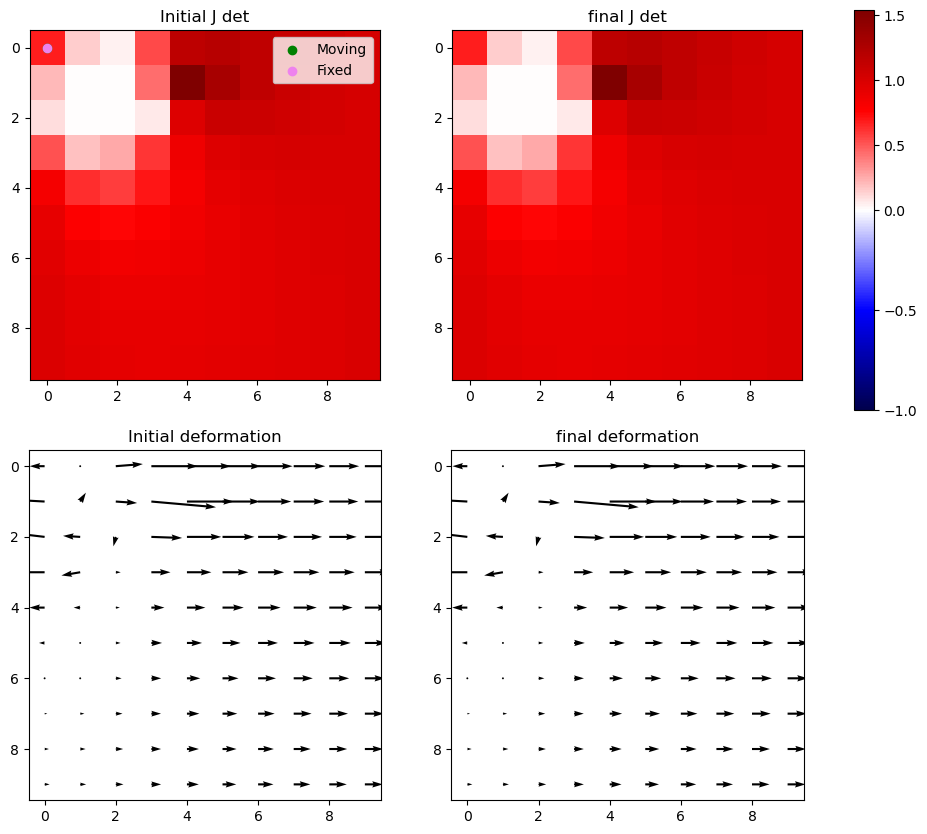

Iter 8: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


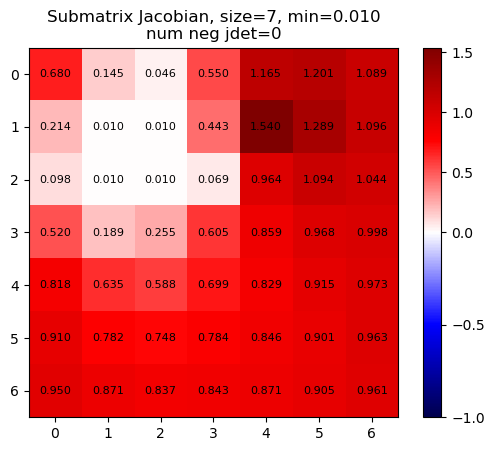

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


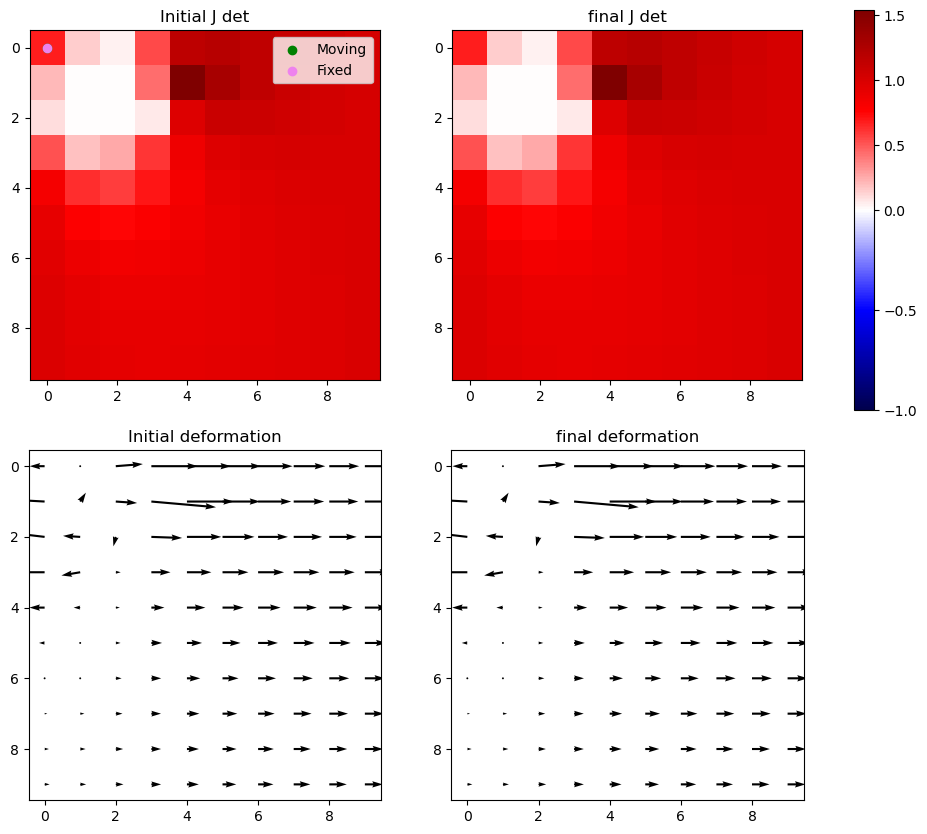

Iter 8: For index (2, 1), window size increased to 9 at iter 3


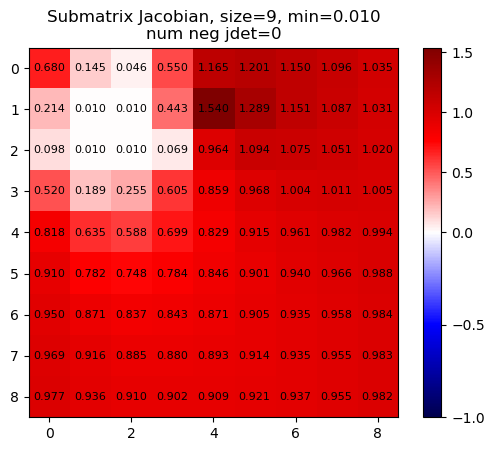

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


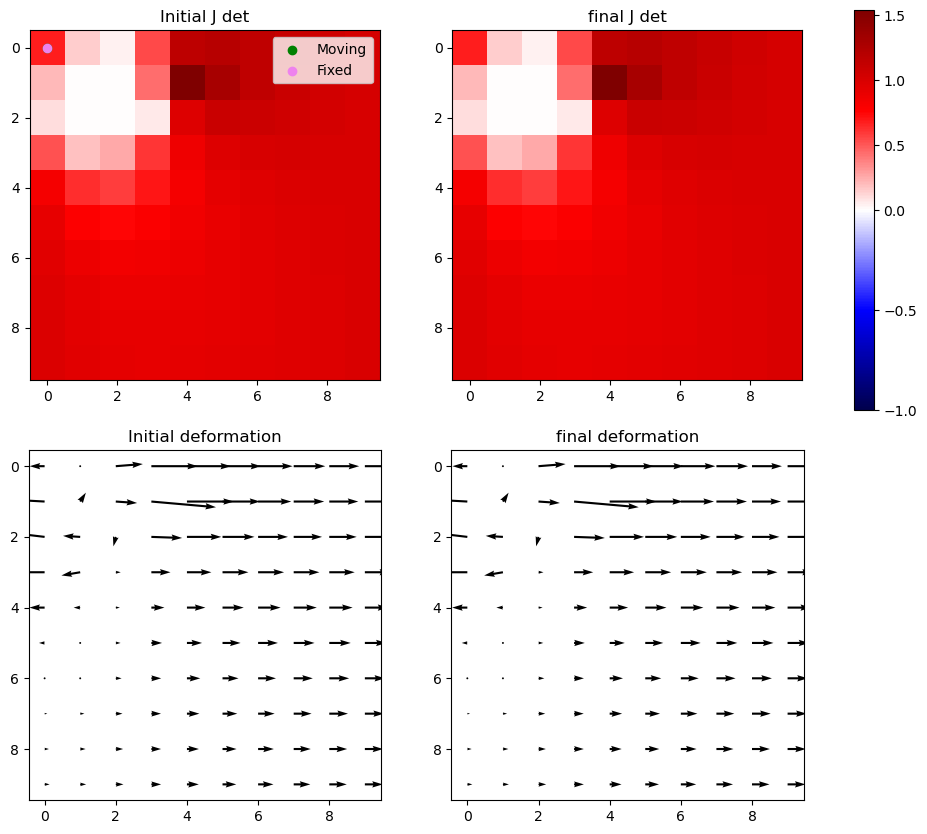

Iter 8 with 0 -ve jacs



Iter 9: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


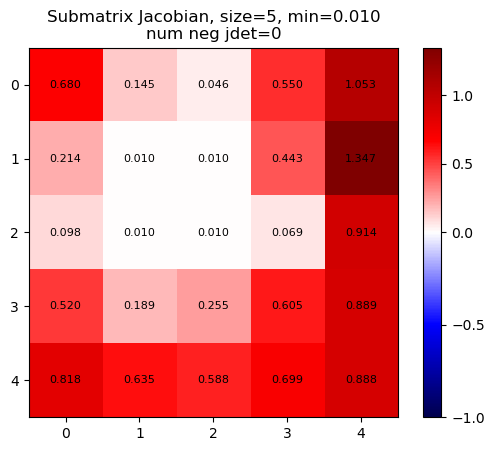

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


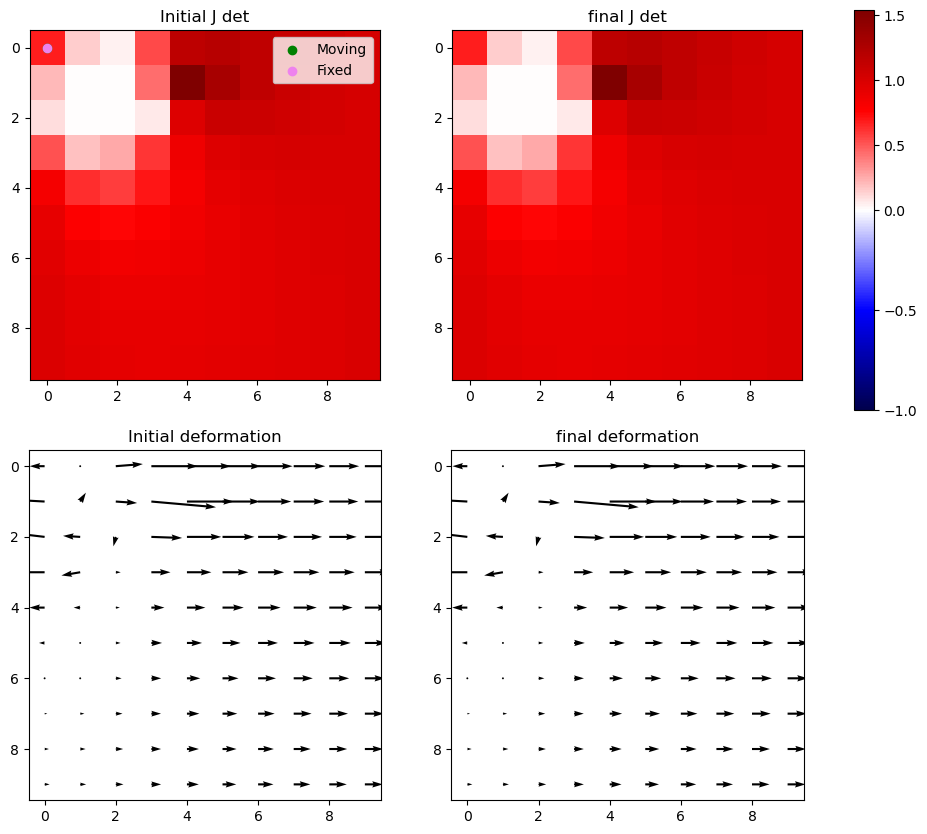

Iter 9: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


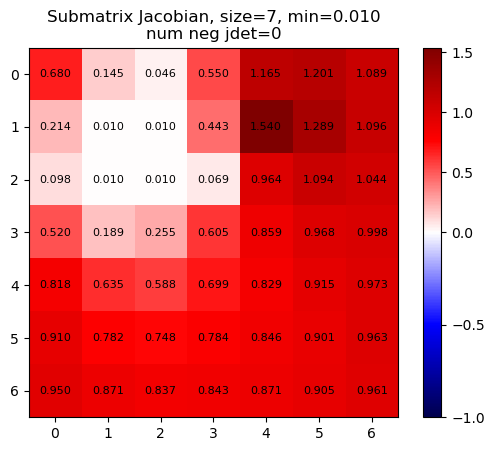

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


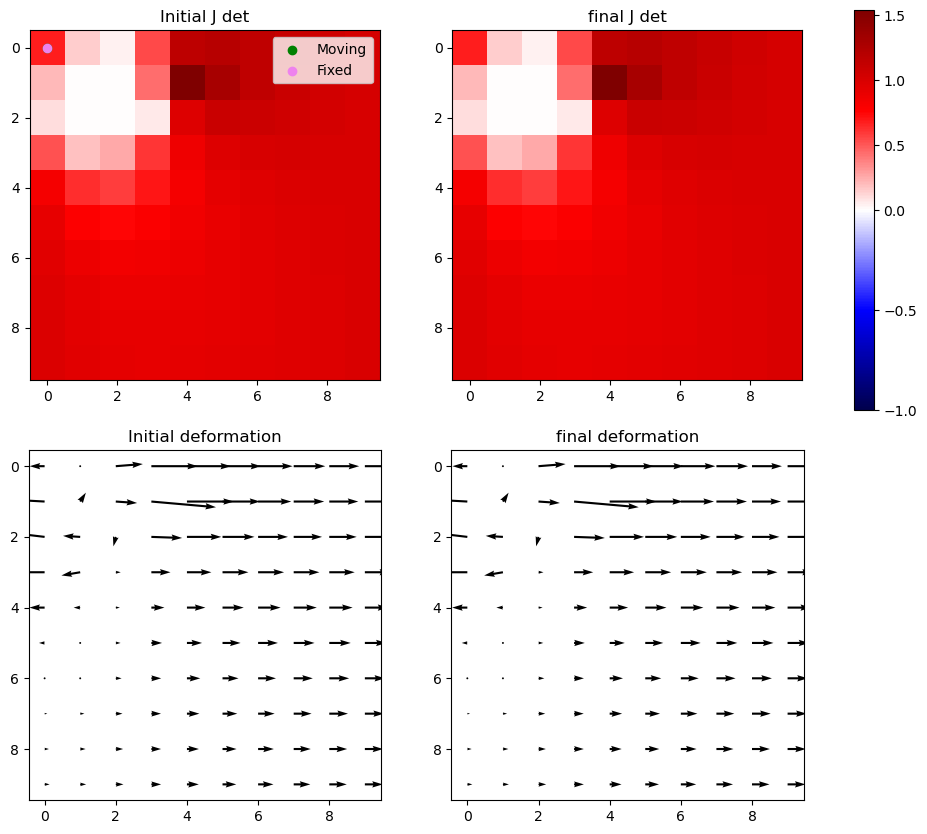

Iter 9: For index (2, 1), window size increased to 9 at iter 3


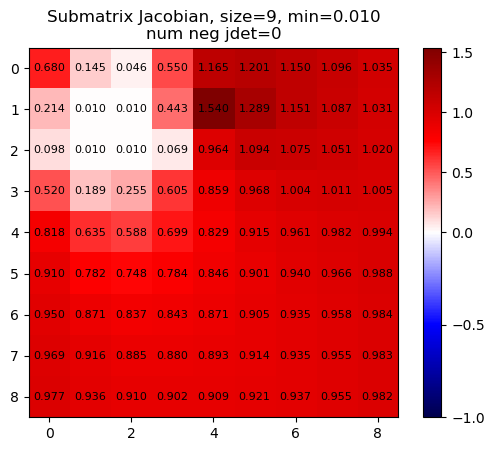

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


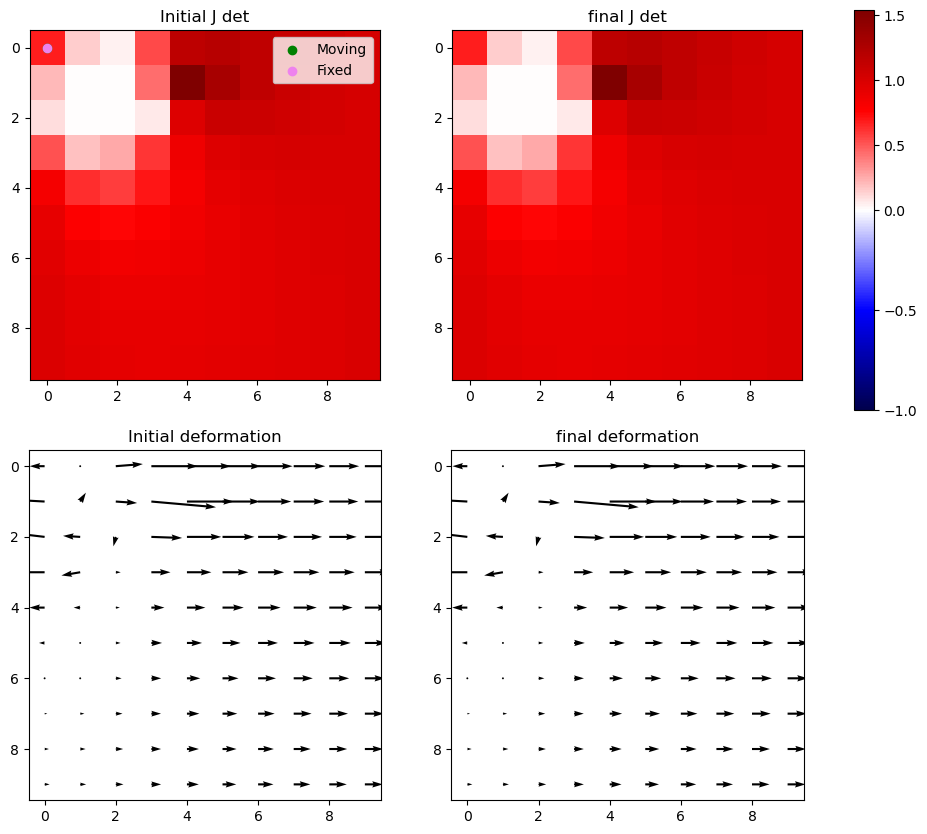

Iter 9 with 0 -ve jacs



Iter 10: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


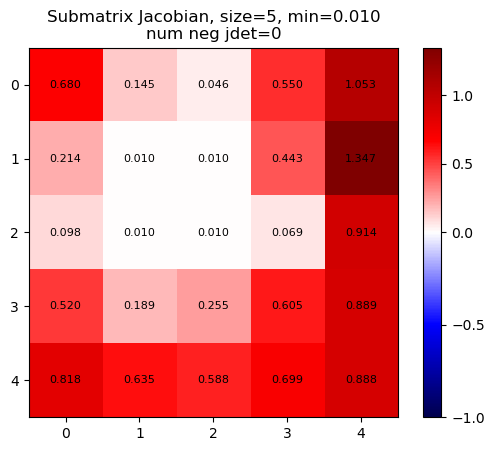

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


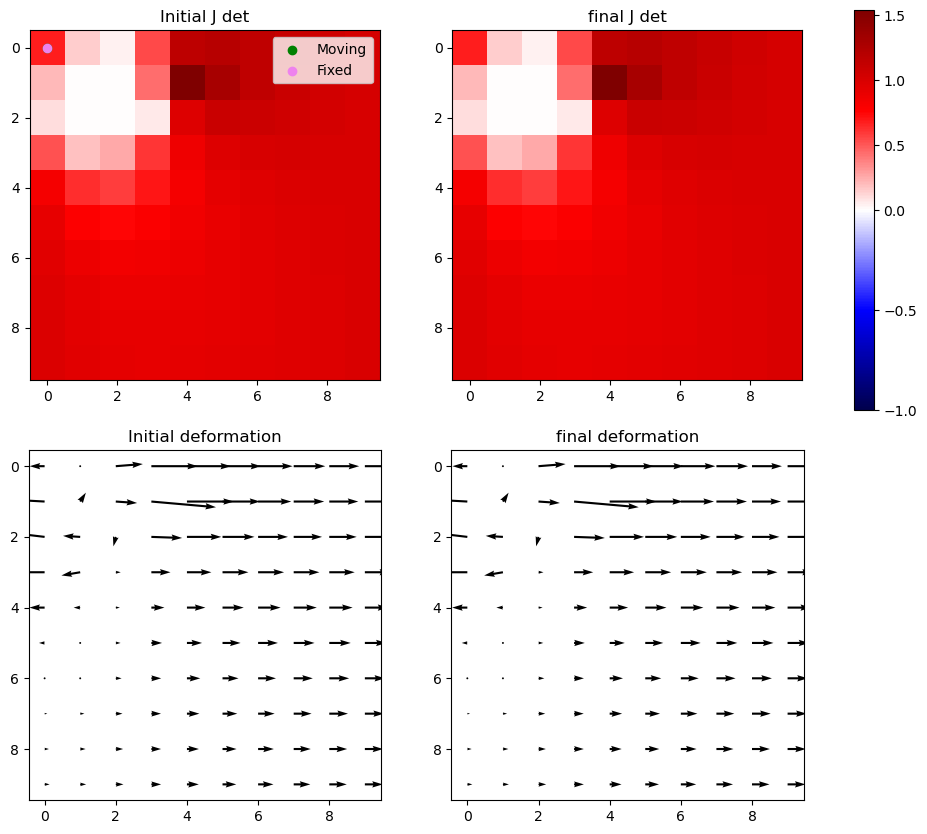

Iter 10: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


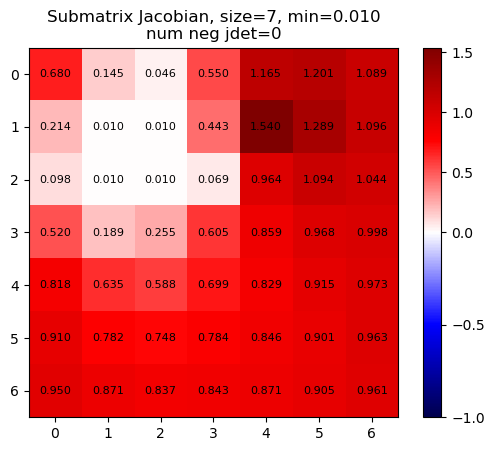

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


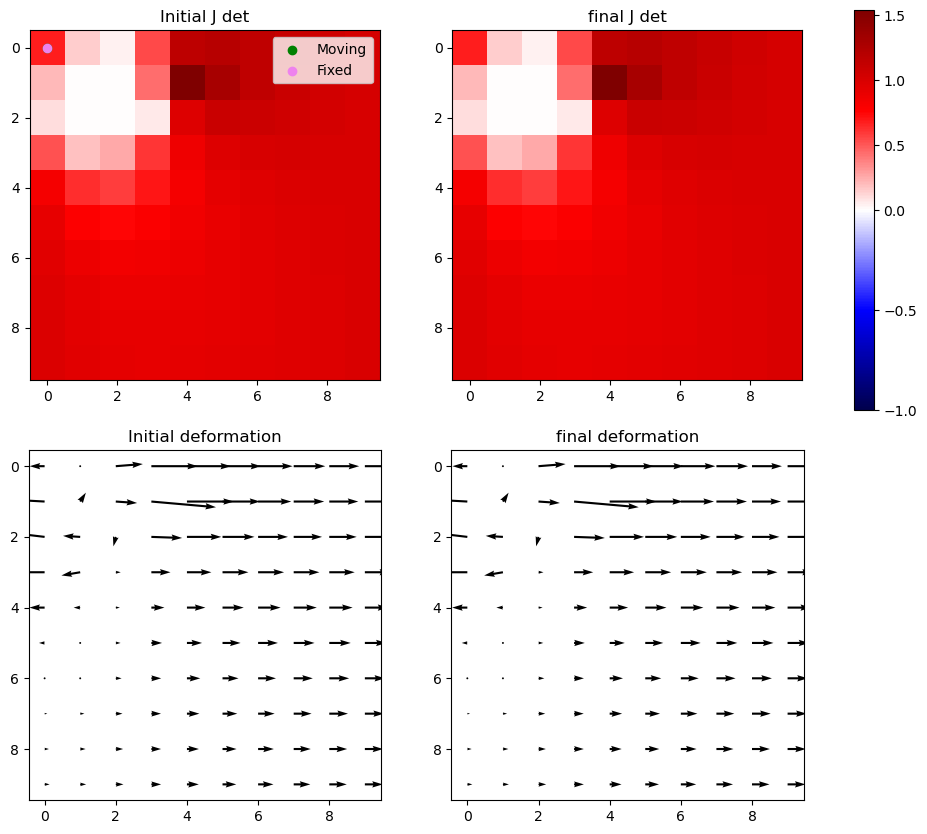

Iter 10: For index (2, 1), window size increased to 9 at iter 3


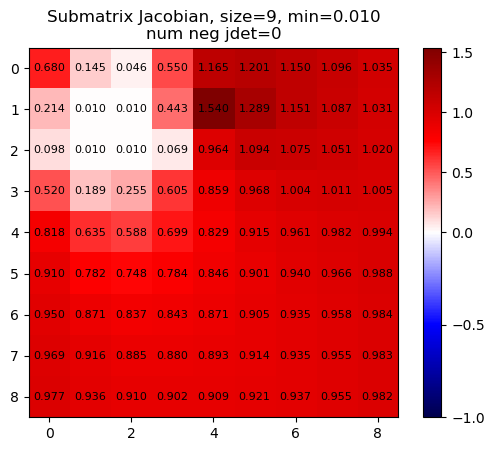

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


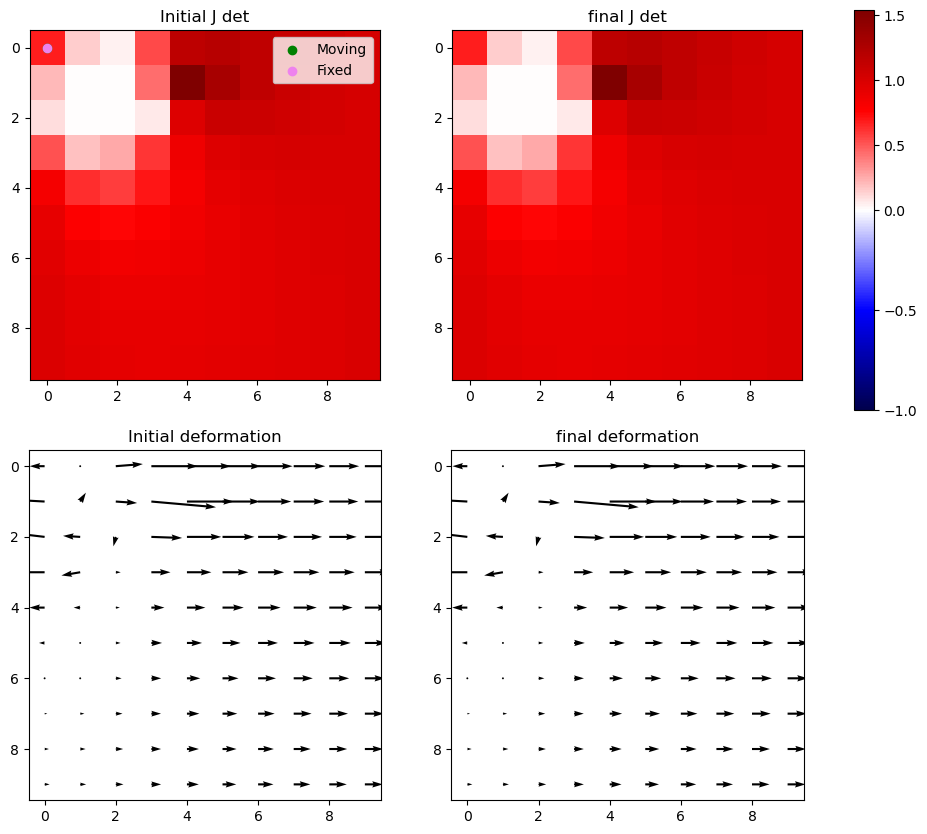

Iter 10 with 0 -ve jacs



Iter 11: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


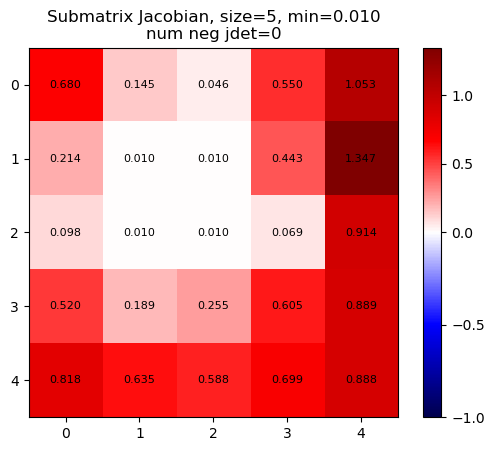

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


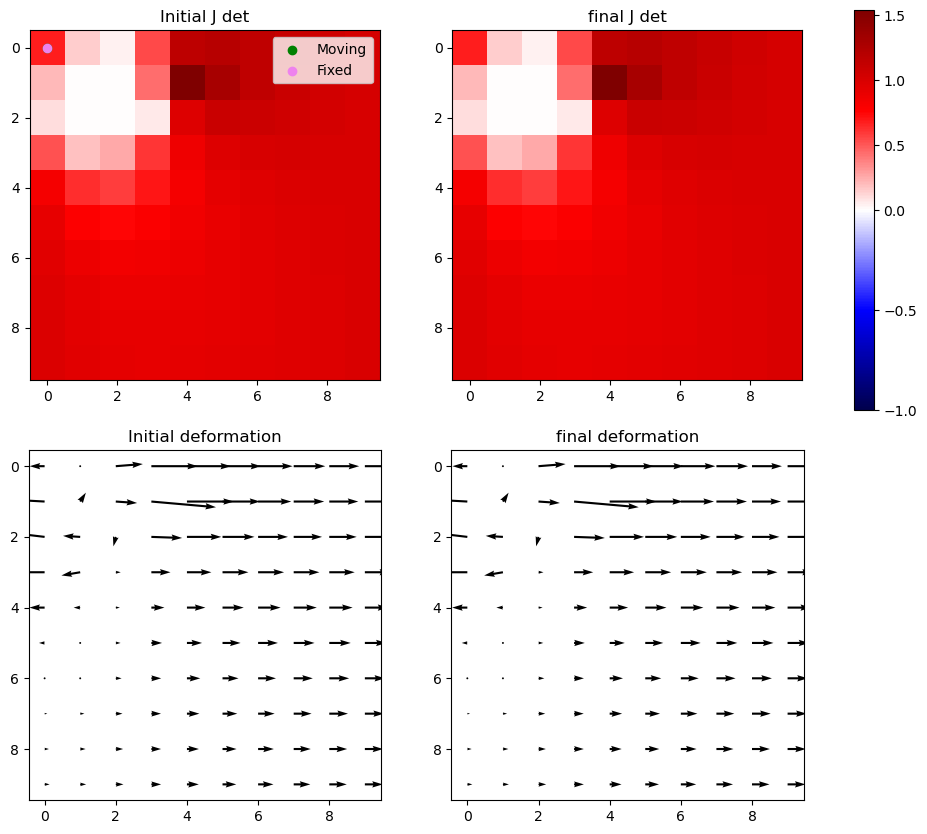

Iter 11: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


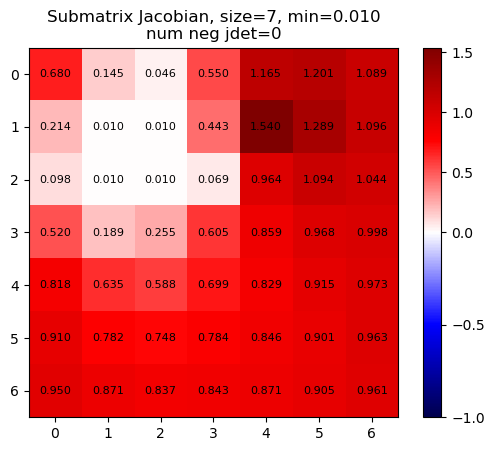

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


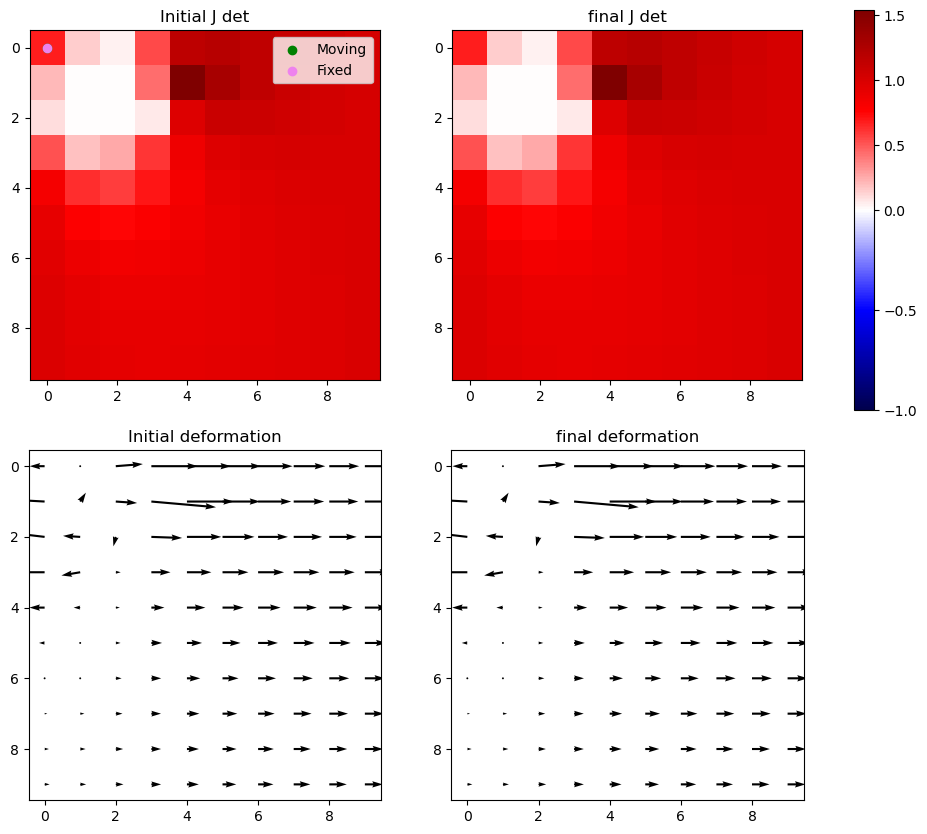

Iter 11: For index (2, 1), window size increased to 9 at iter 3


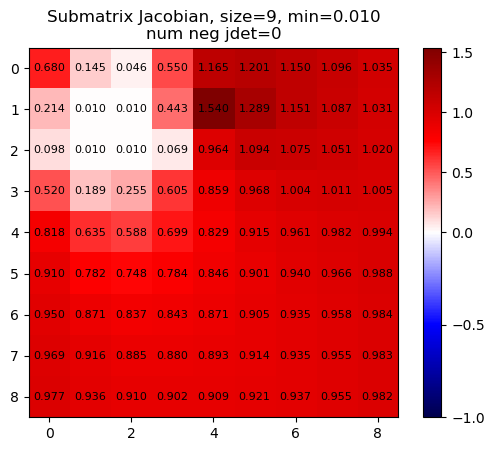

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


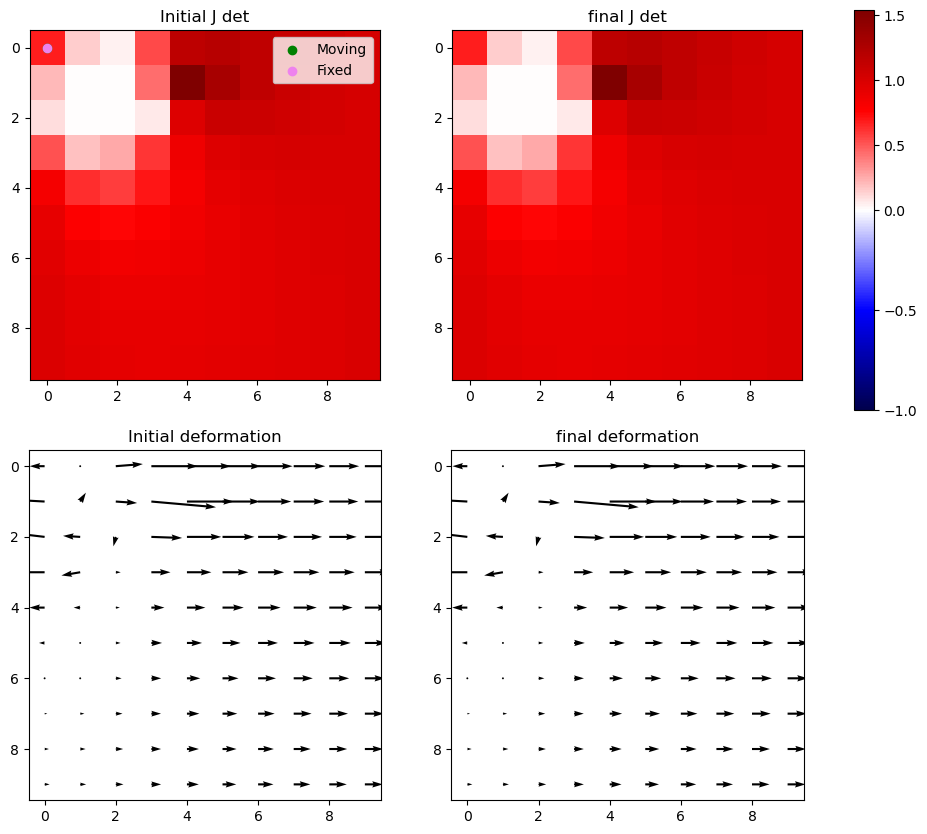

Iter 11 with 0 -ve jacs



Iter 12: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


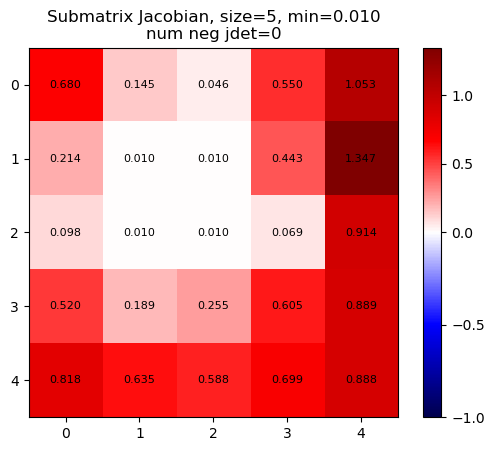

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


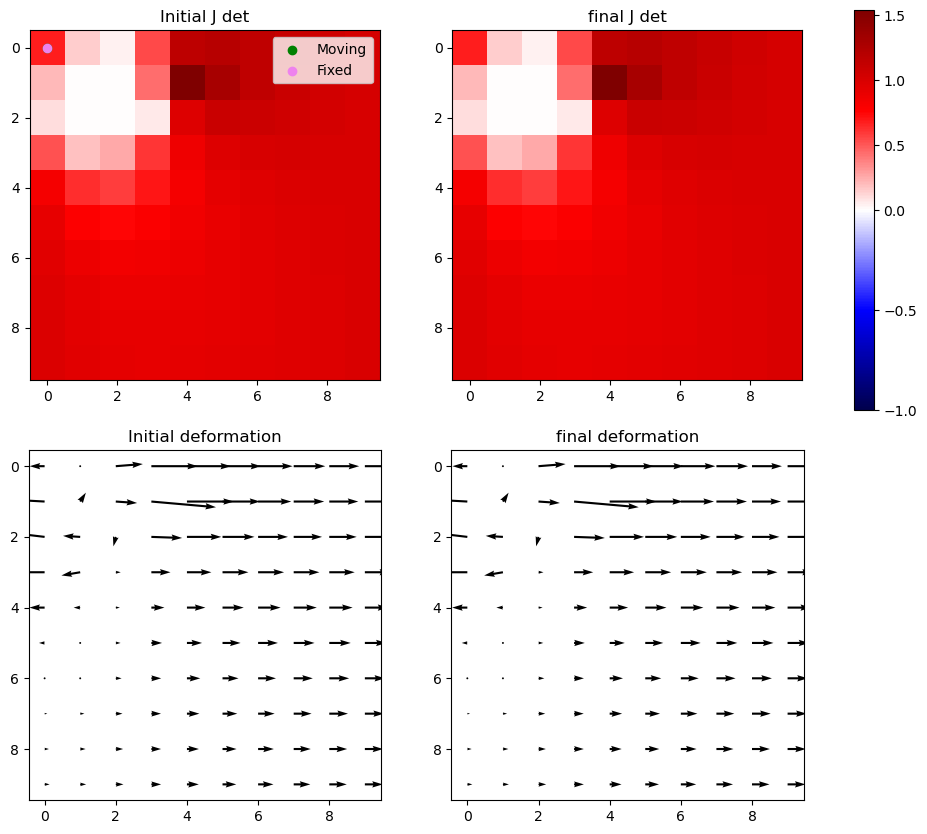

Iter 12: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


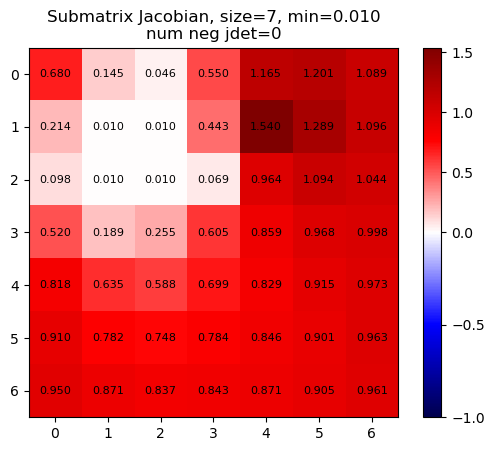

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


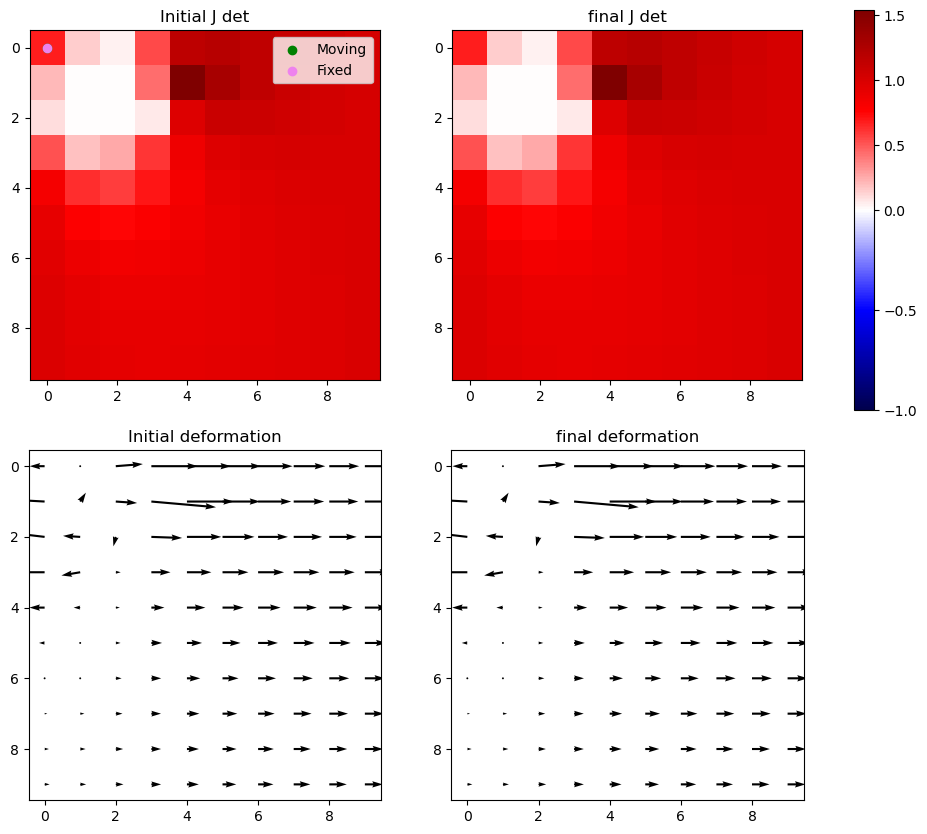

Iter 12: For index (2, 1), window size increased to 9 at iter 3


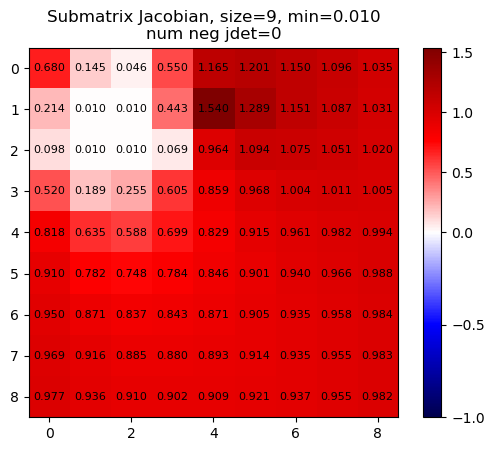

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


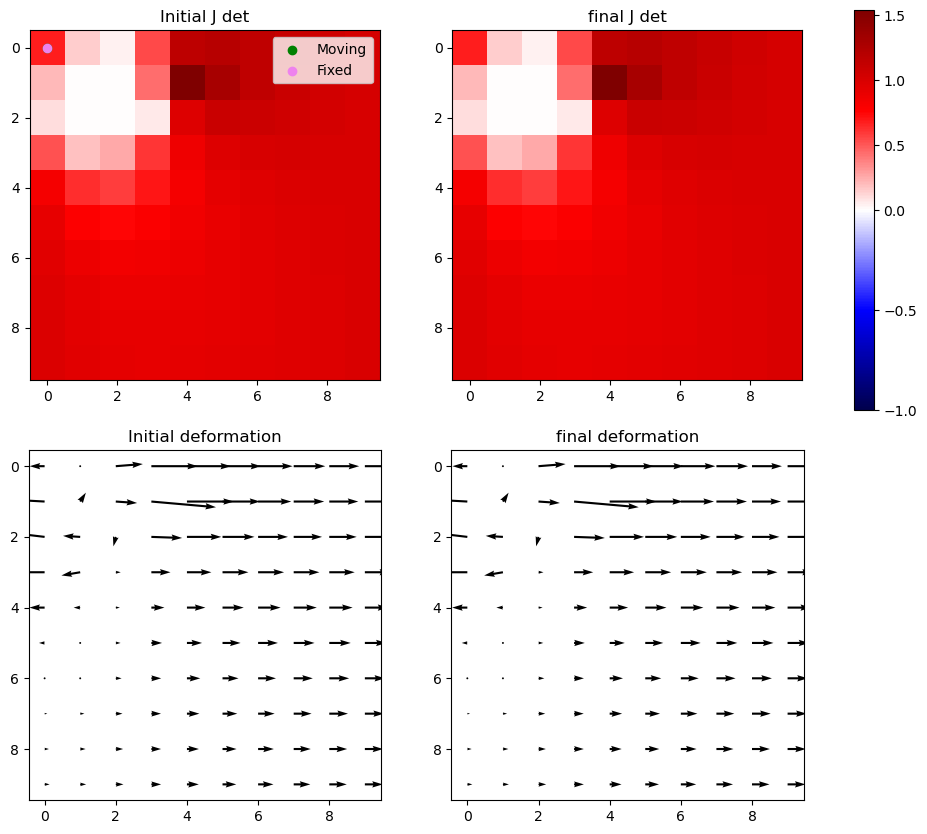

Iter 12 with 0 -ve jacs



Iter 13: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


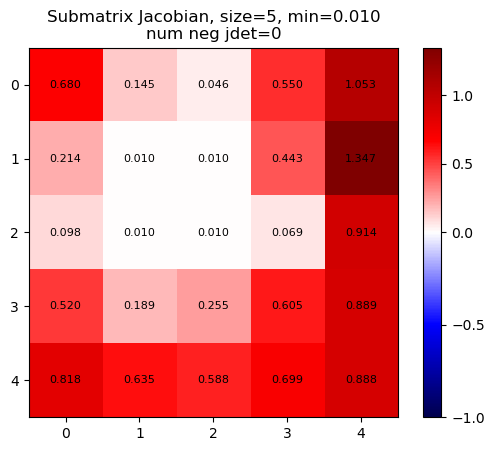

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


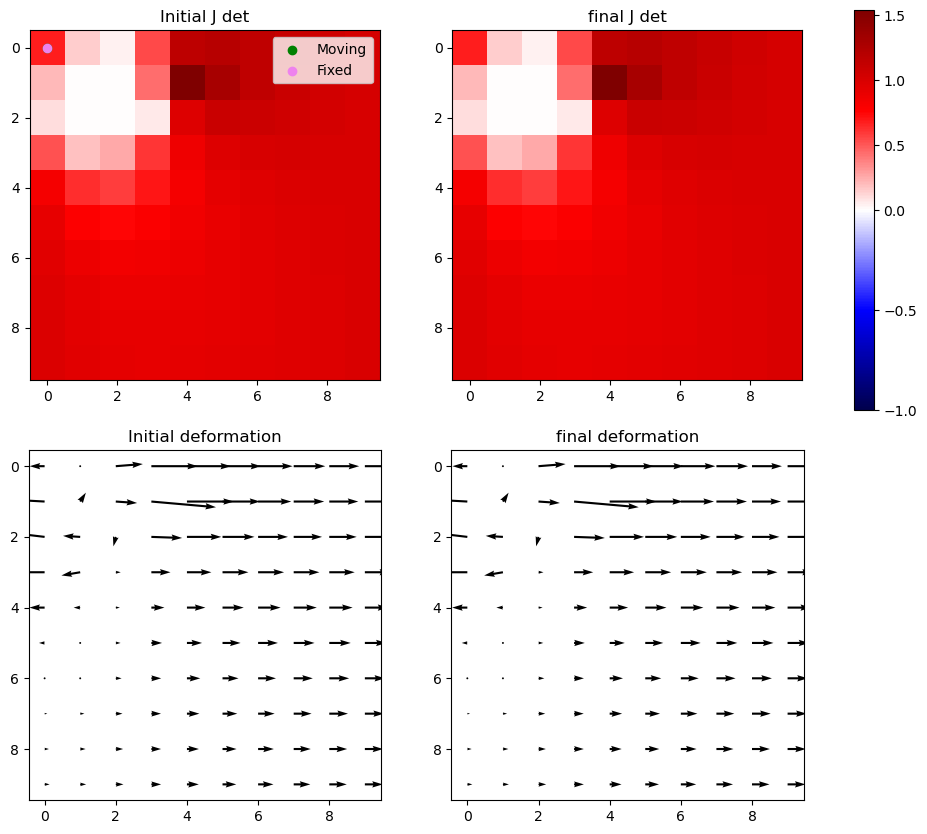

Iter 13: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


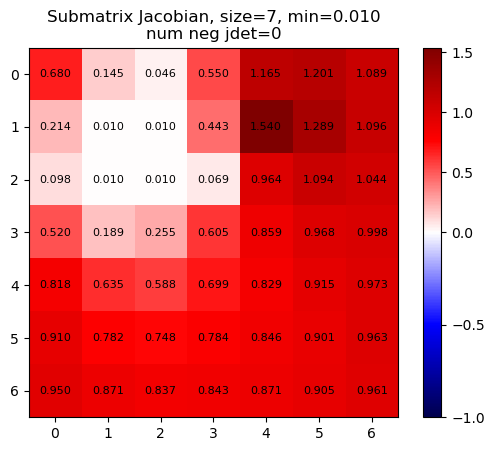

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


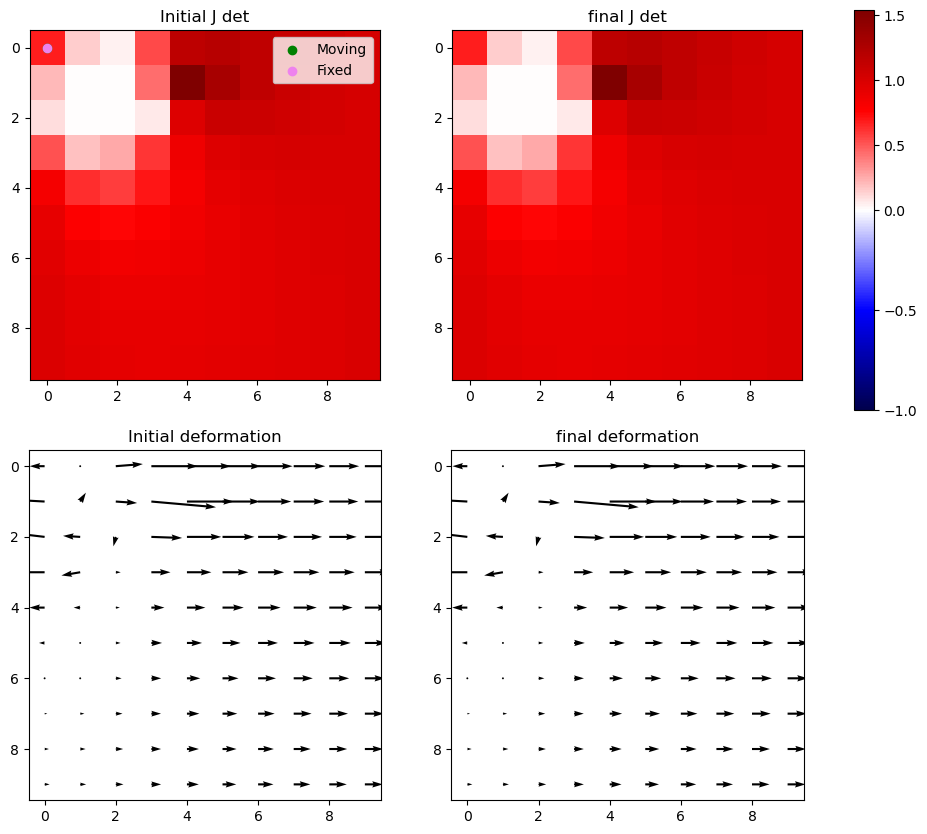

Iter 13: For index (2, 1), window size increased to 9 at iter 3


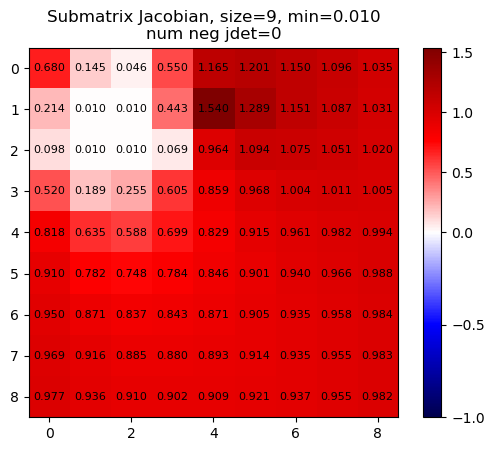

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


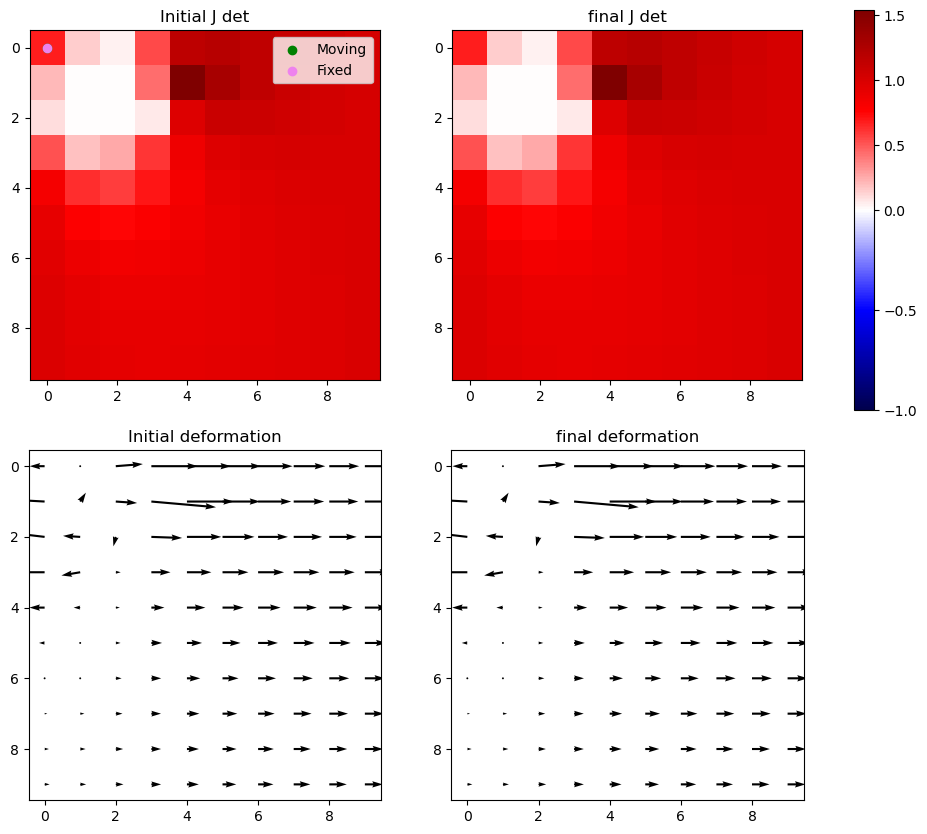

Iter 13 with 0 -ve jacs



Iter 14: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


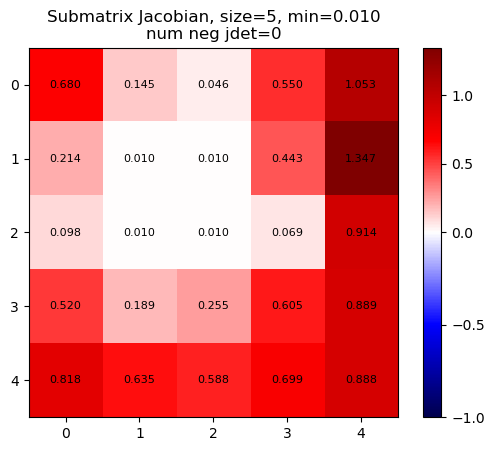

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


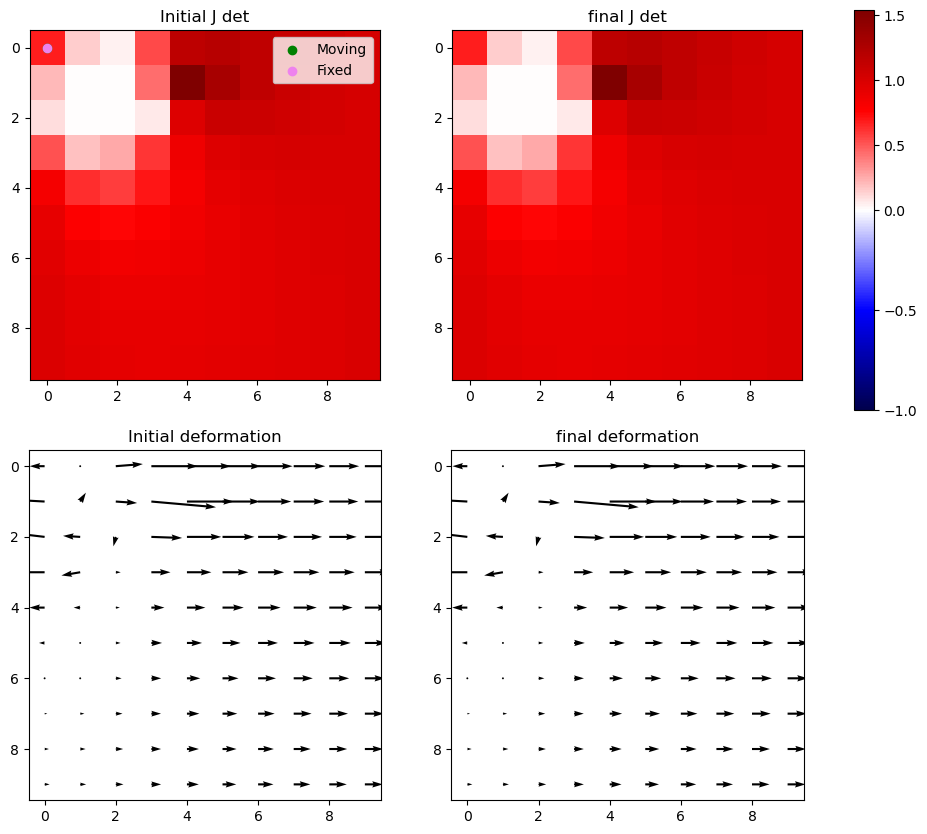

Iter 14: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


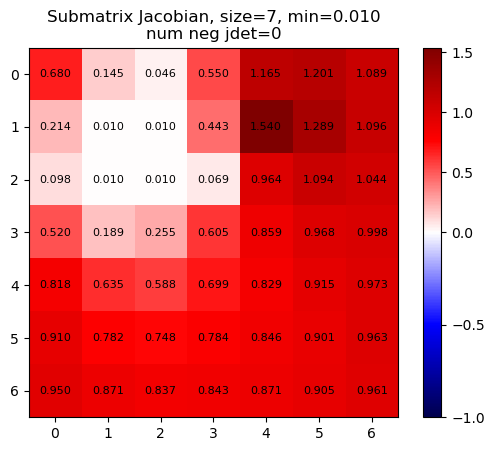

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


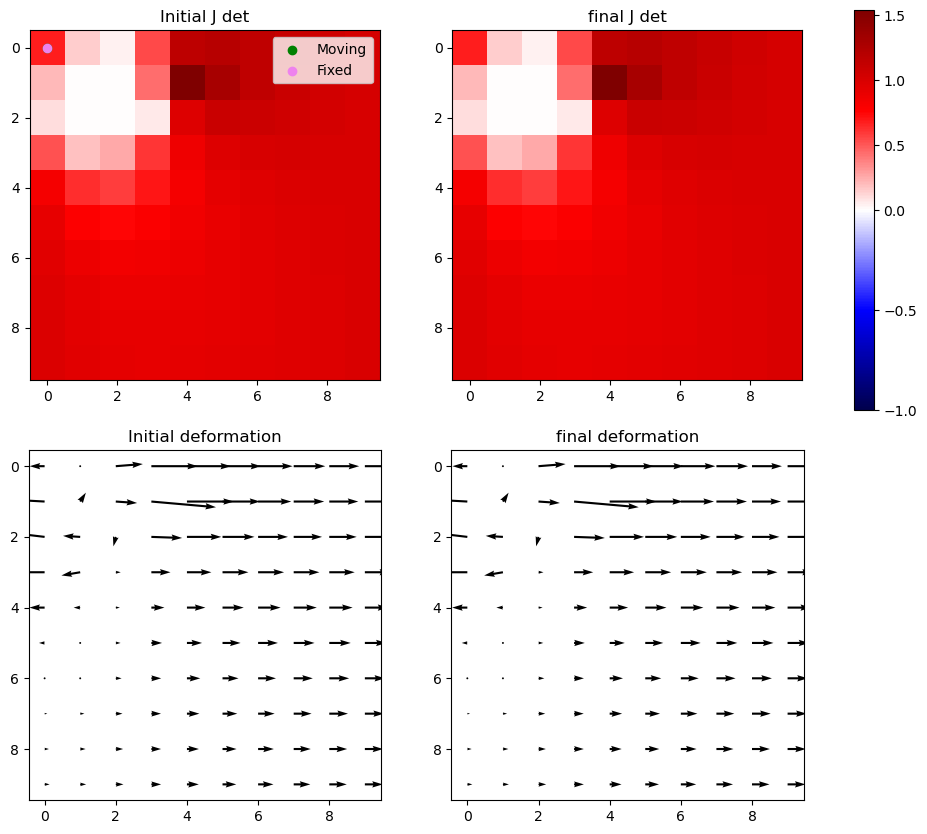

Iter 14: For index (2, 1), window size increased to 9 at iter 3


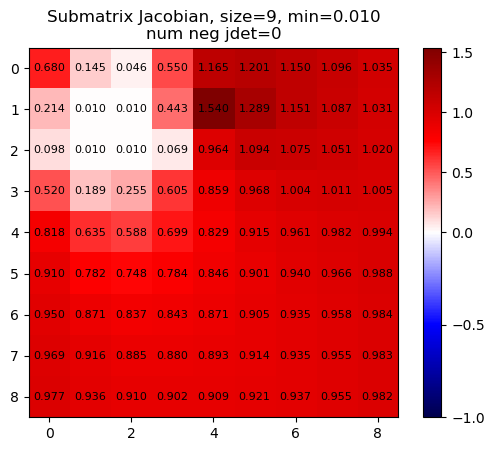

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


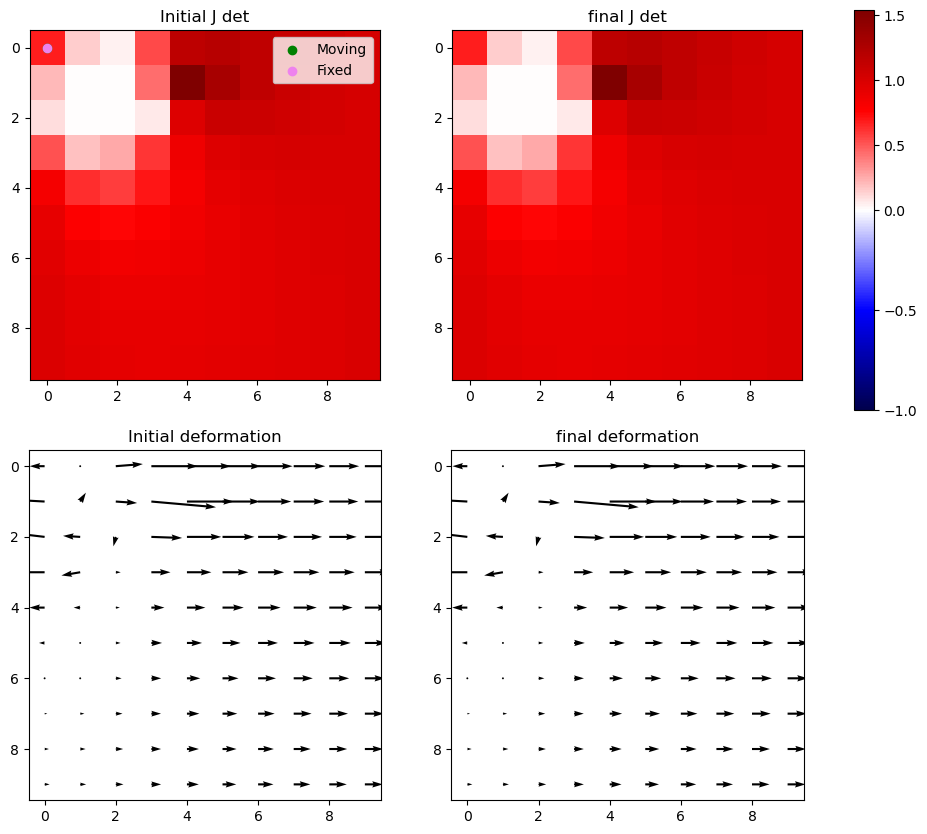

Iter 14 with 0 -ve jacs



Iter 15: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


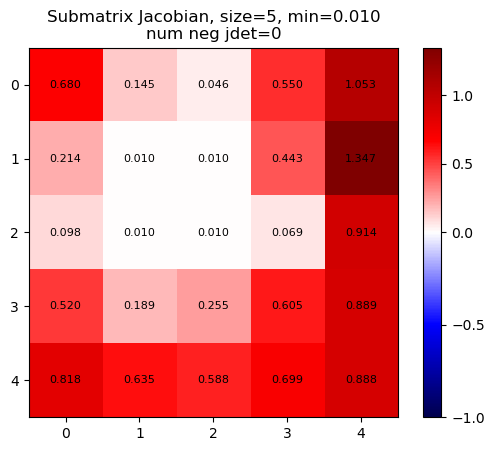

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


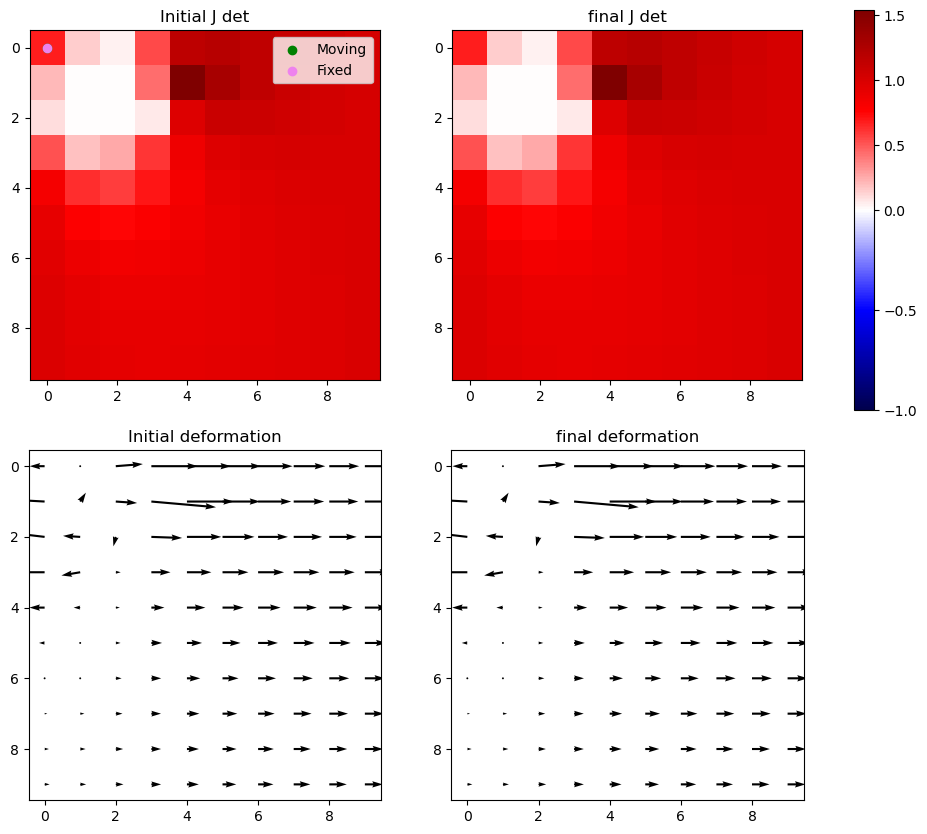

Iter 15: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


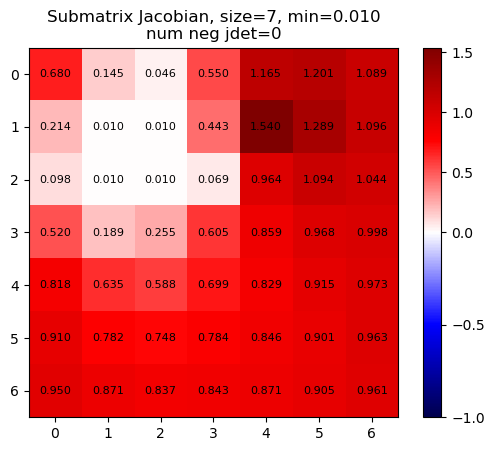

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


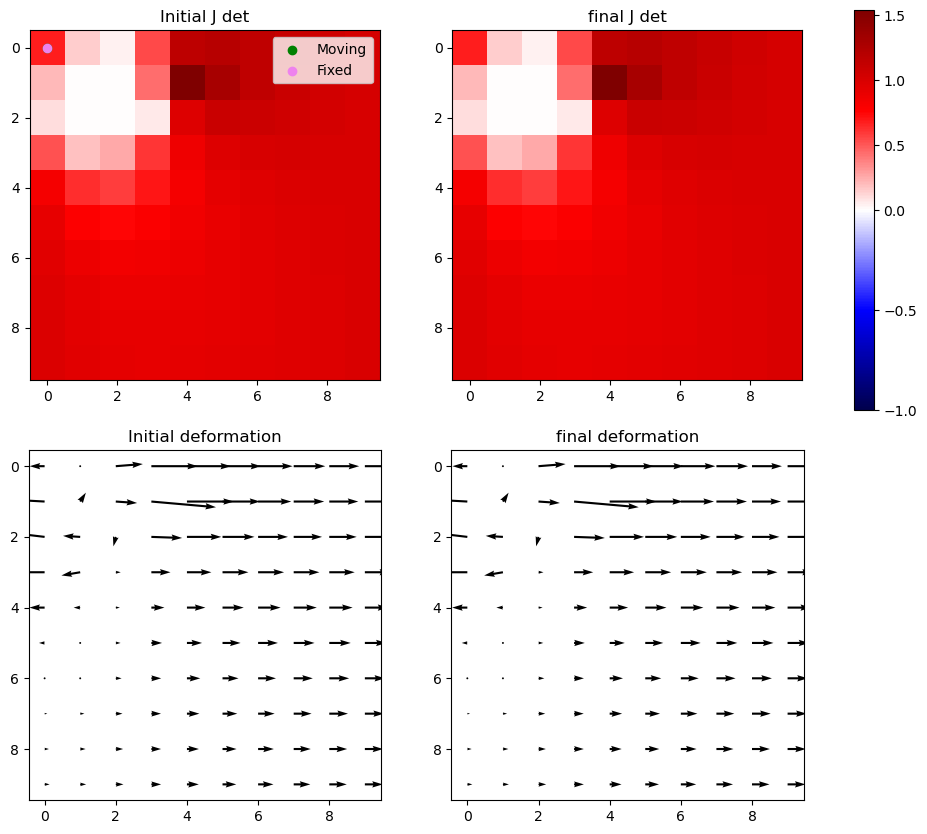

Iter 15: For index (2, 1), window size increased to 9 at iter 3


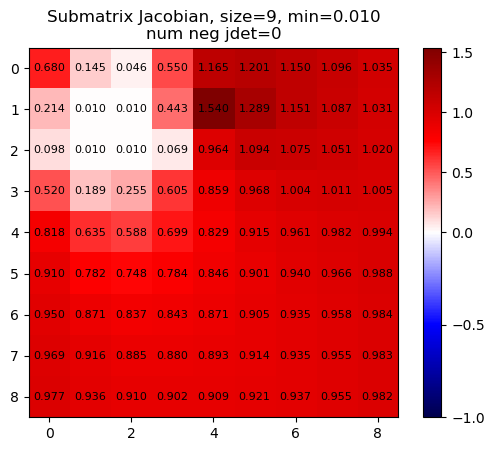

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


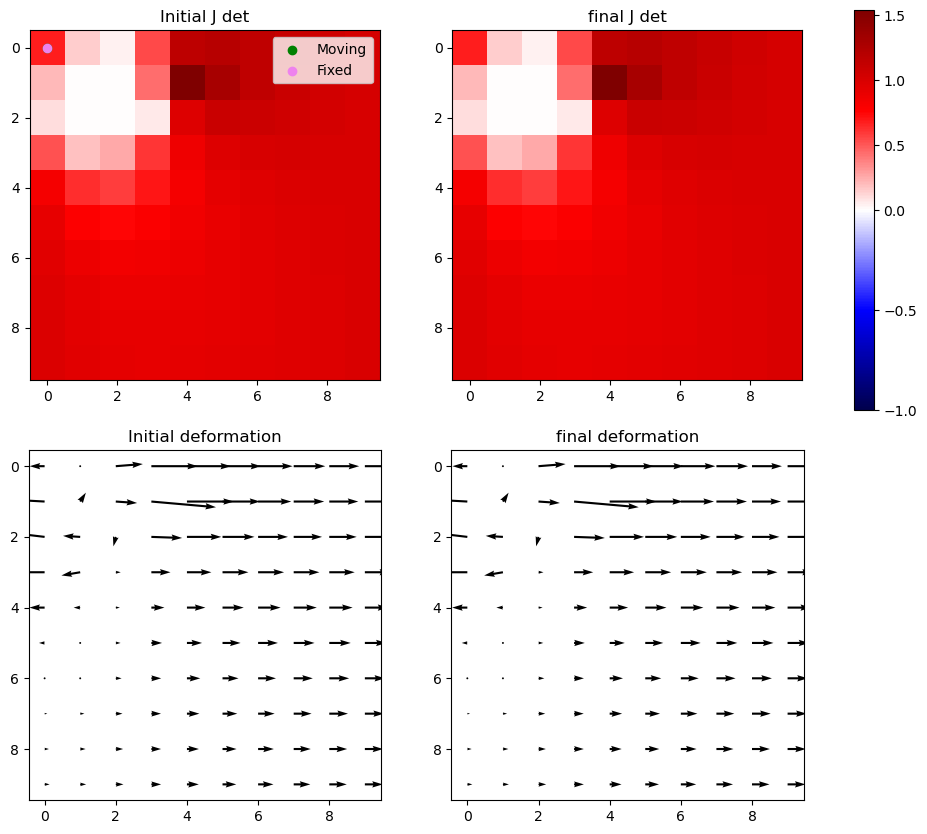

Iter 15 with 0 -ve jacs



Iter 16: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


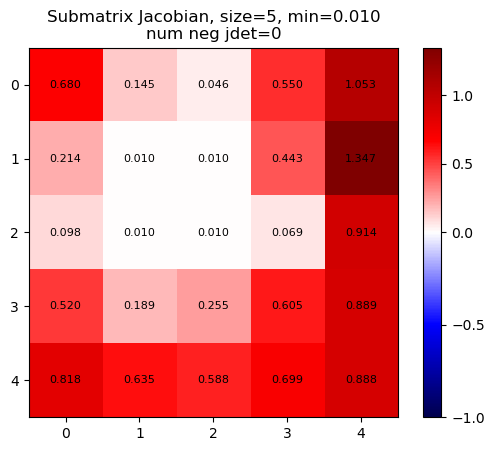

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


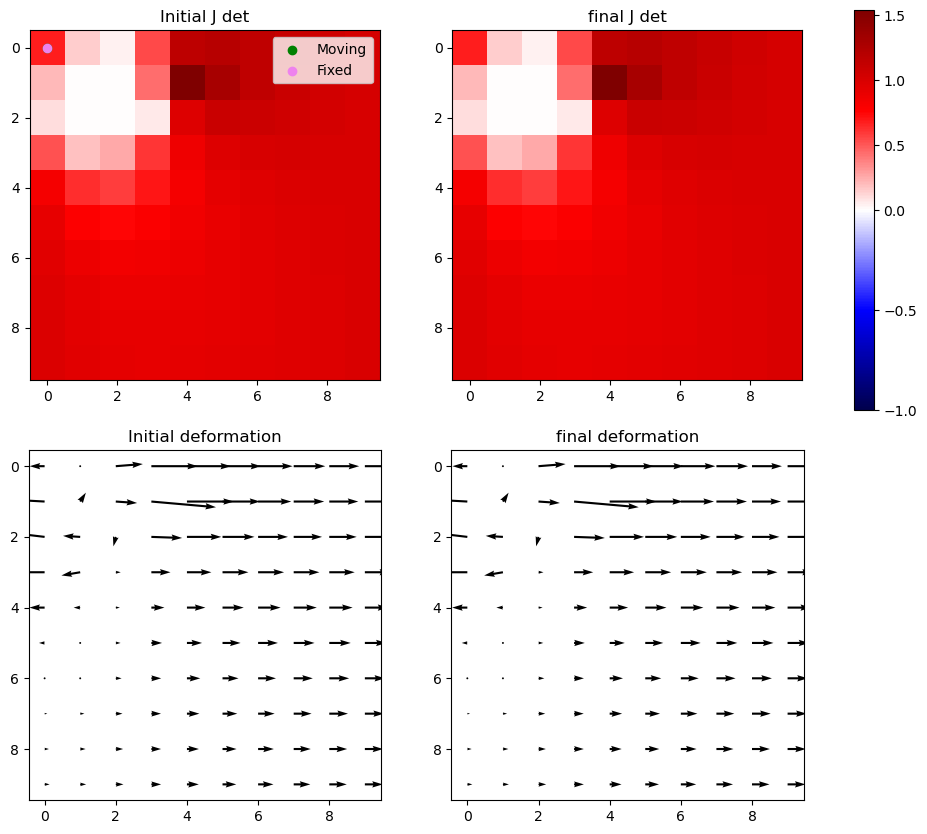

Iter 16: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


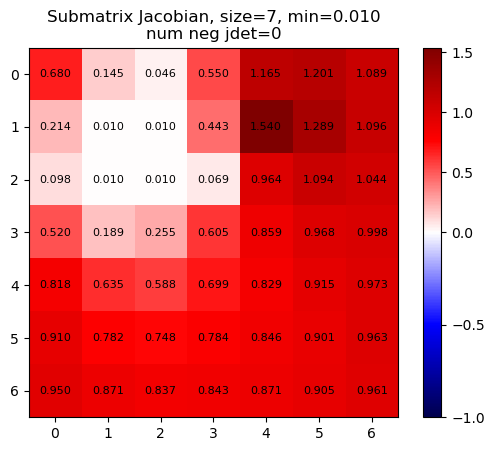

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


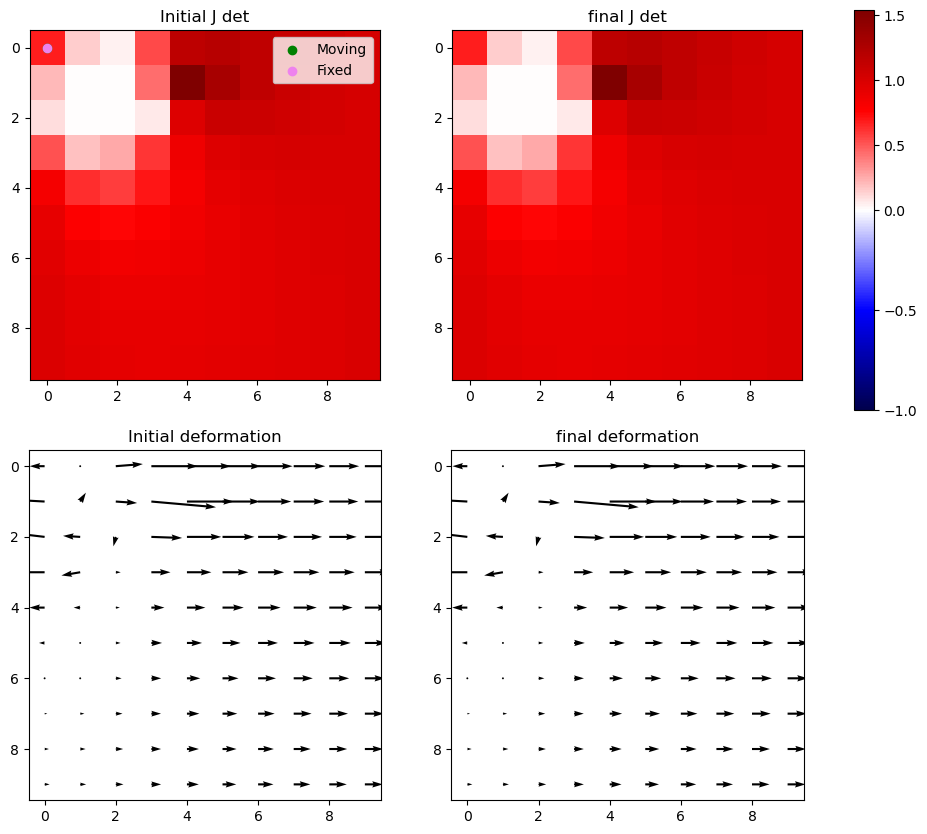

Iter 16: For index (2, 1), window size increased to 9 at iter 3


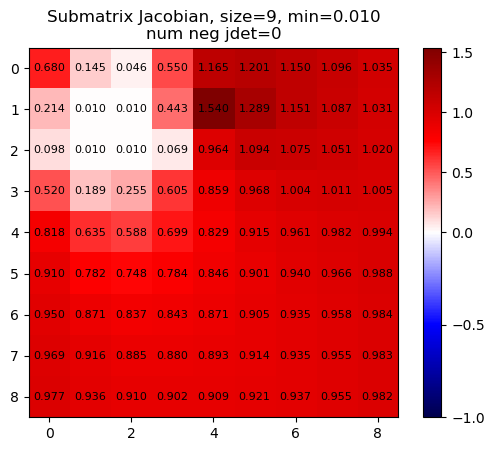

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


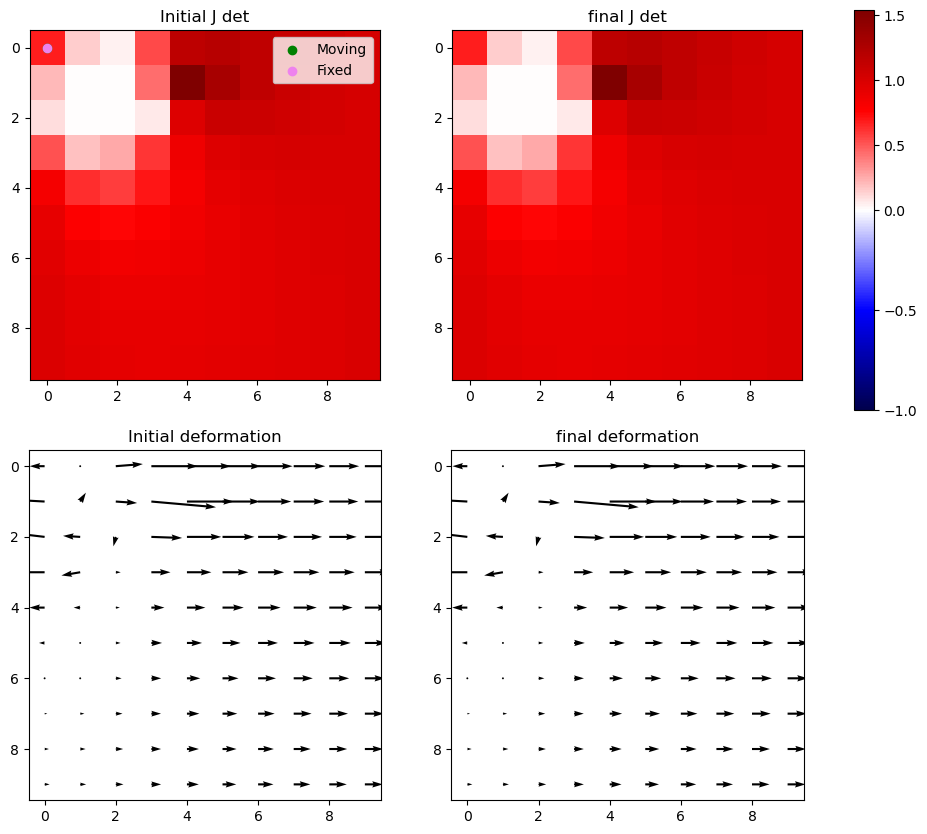

Iter 16 with 0 -ve jacs



Iter 17: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


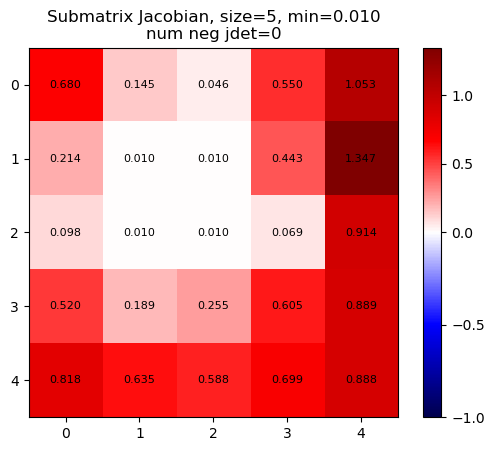

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


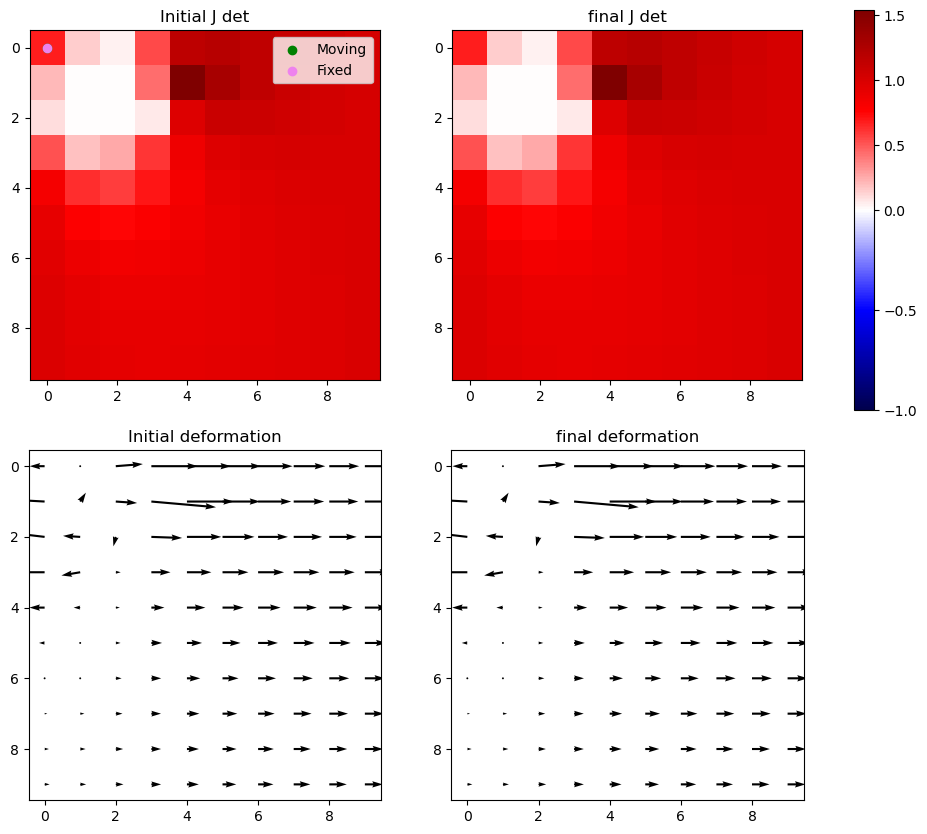

Iter 17: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


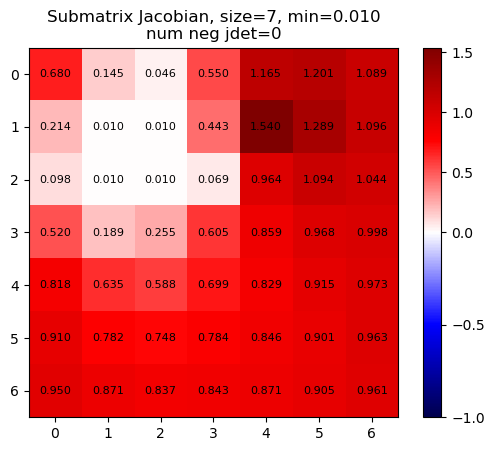

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


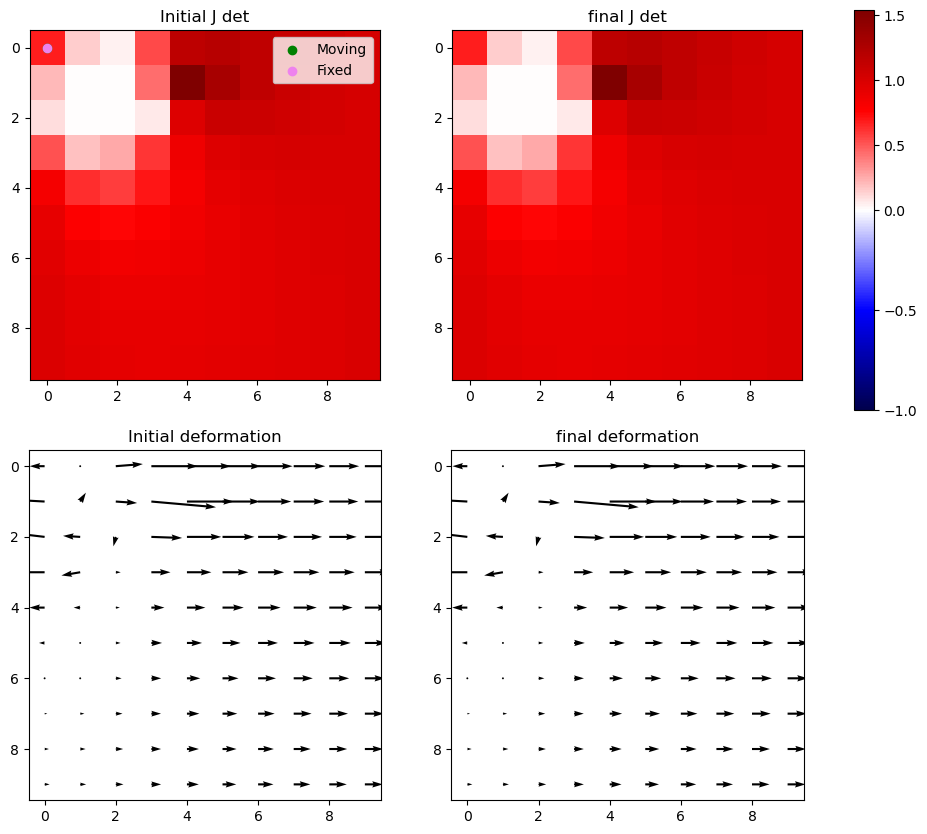

Iter 17: For index (2, 1), window size increased to 9 at iter 3


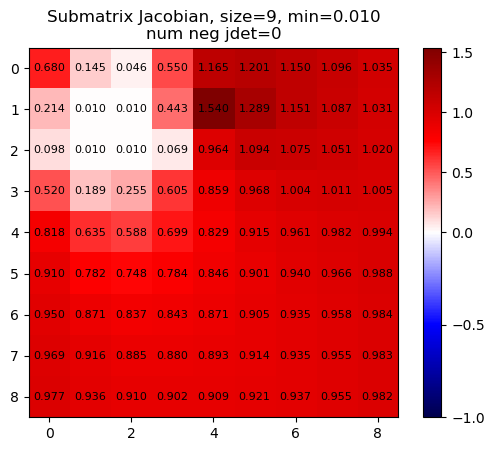

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


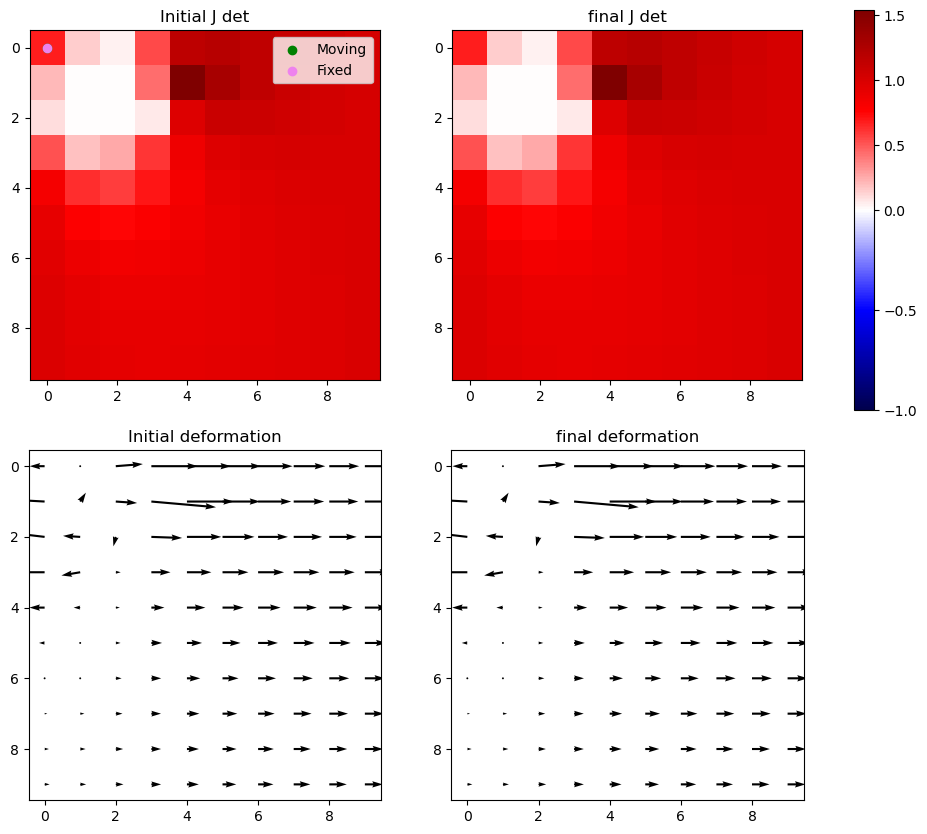

Iter 17 with 0 -ve jacs



Iter 18: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


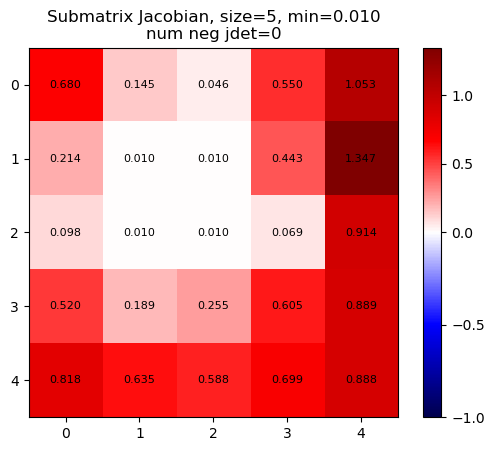

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


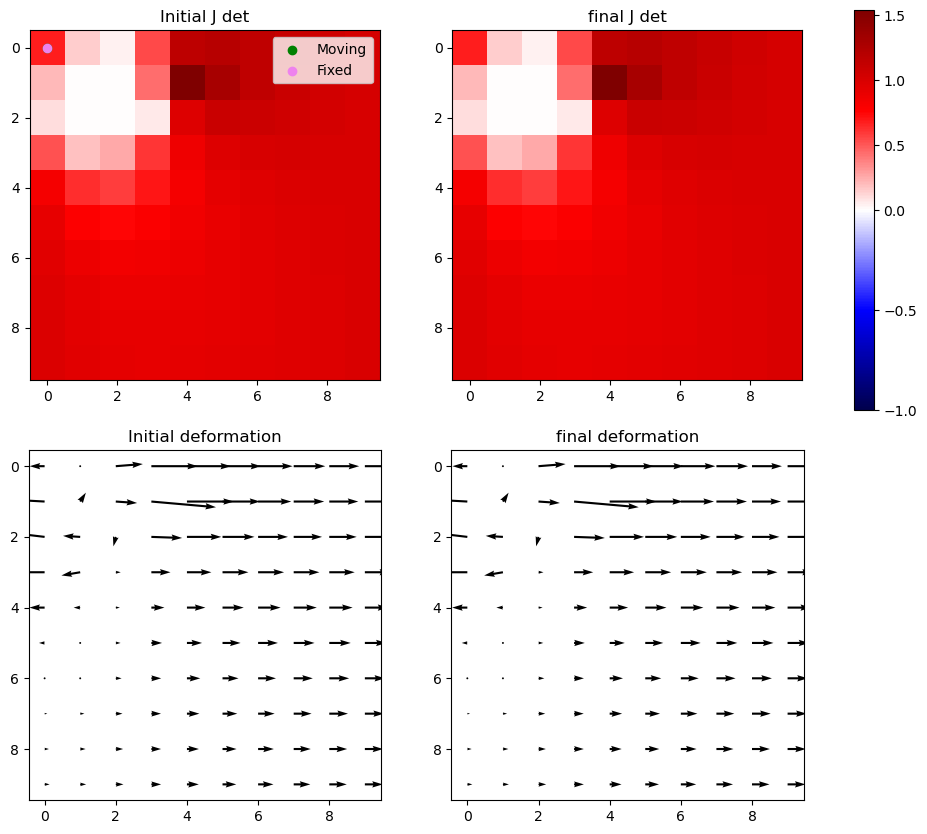

Iter 18: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


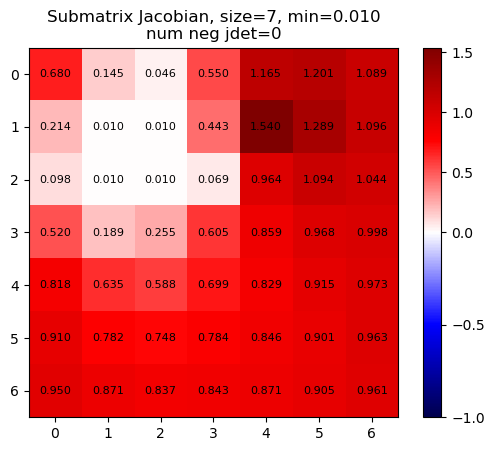

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


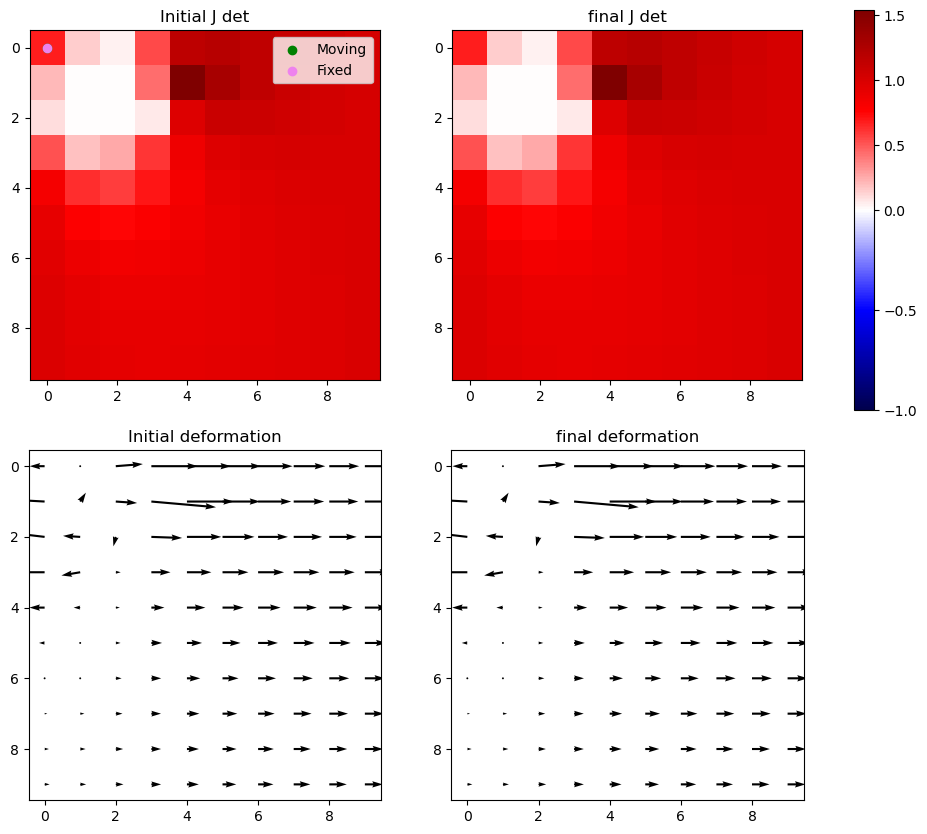

Iter 18: For index (2, 1), window size increased to 9 at iter 3


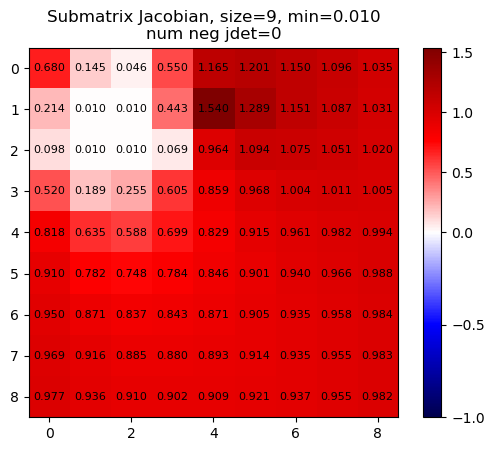

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


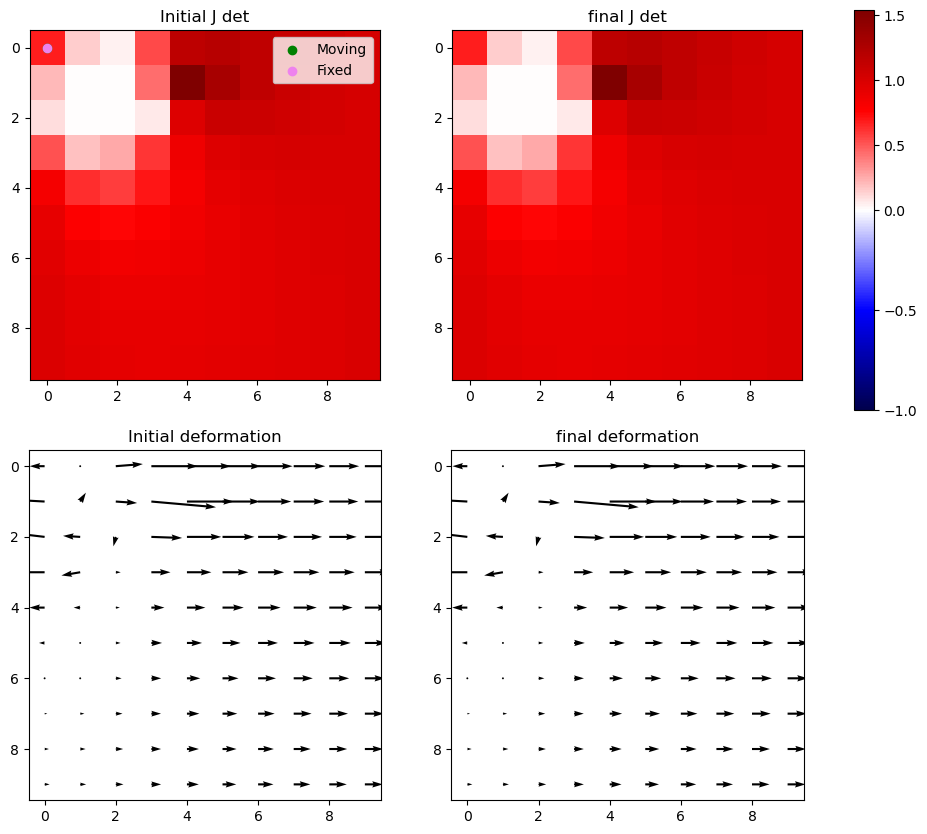

Iter 18 with 0 -ve jacs



Iter 19: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


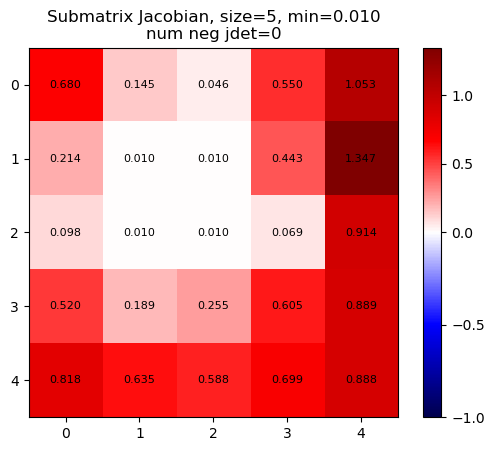

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


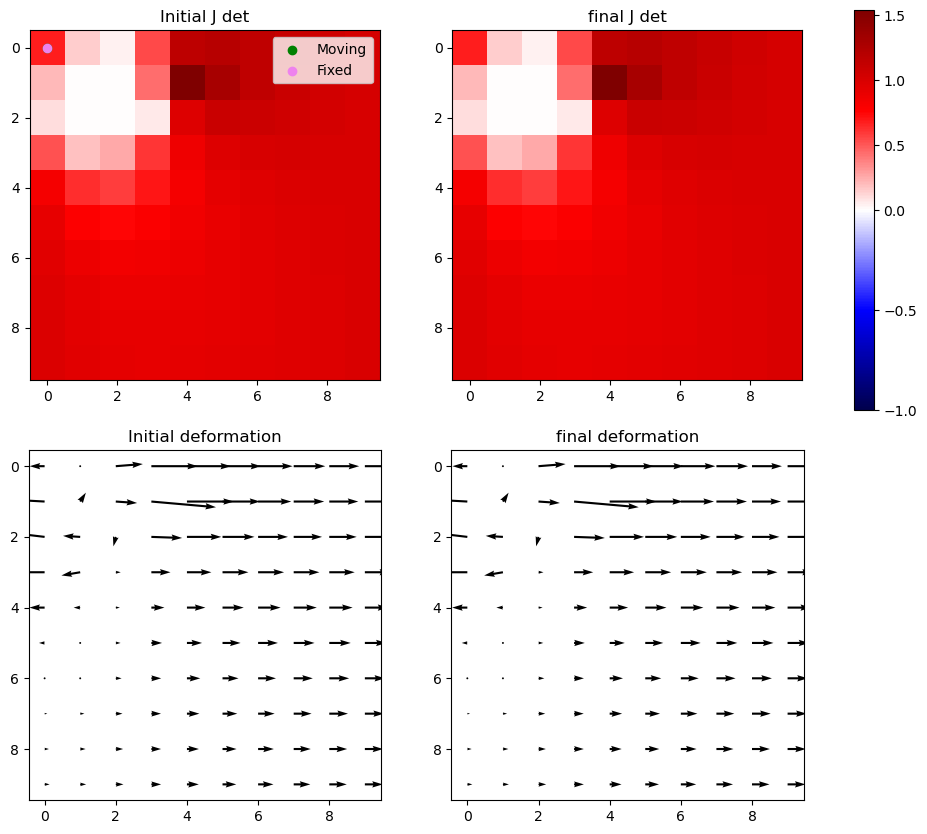

Iter 19: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


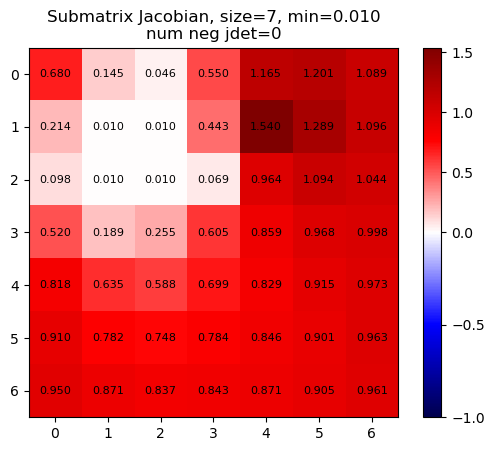

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


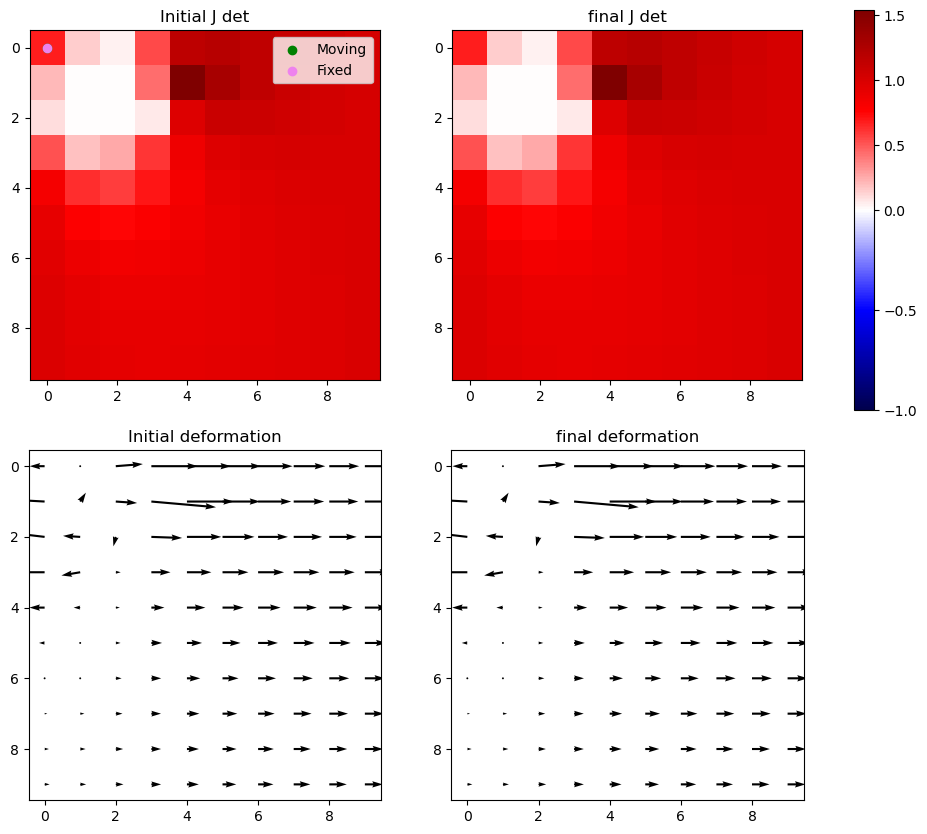

Iter 19: For index (2, 1), window size increased to 9 at iter 3


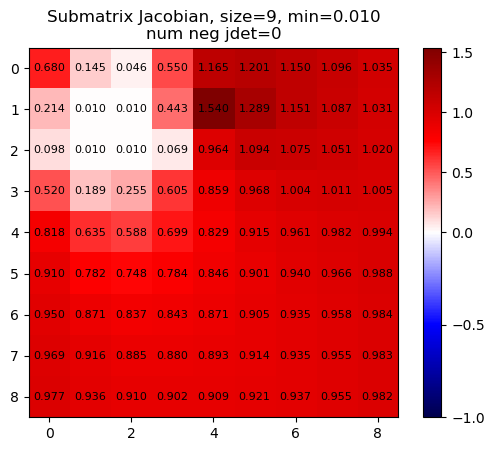

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


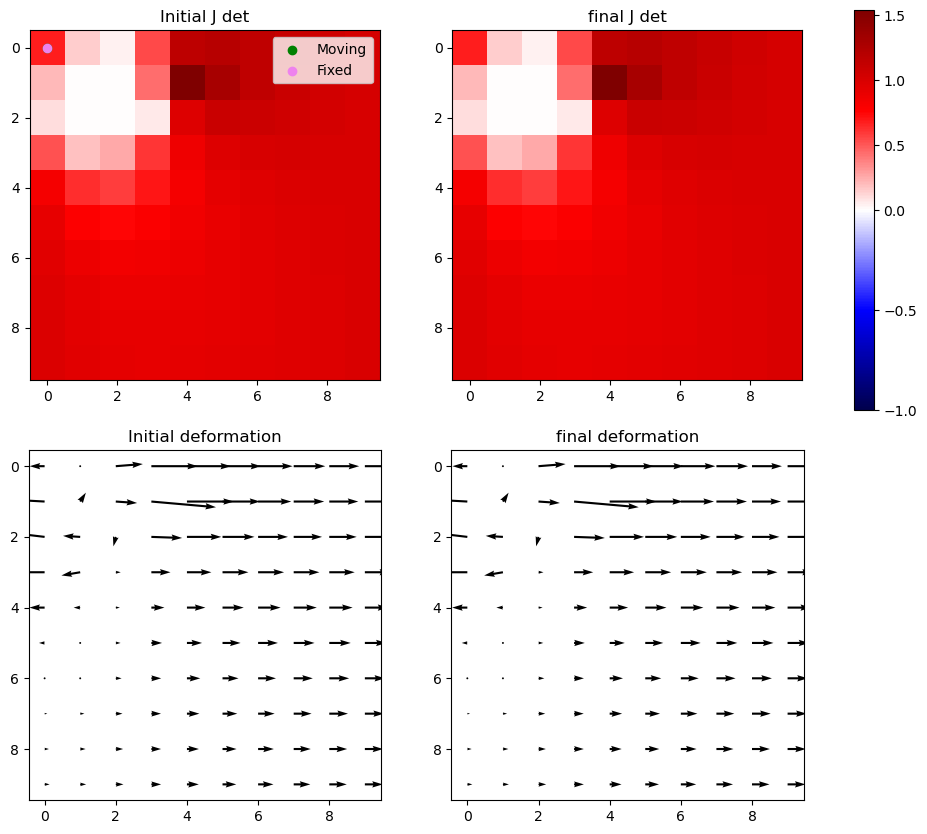

Iter 19 with 0 -ve jacs



Iter 20: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


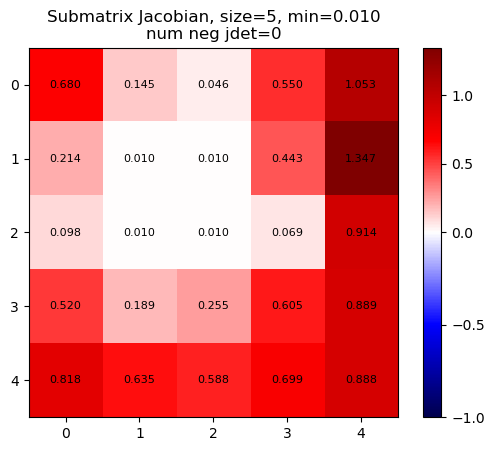

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


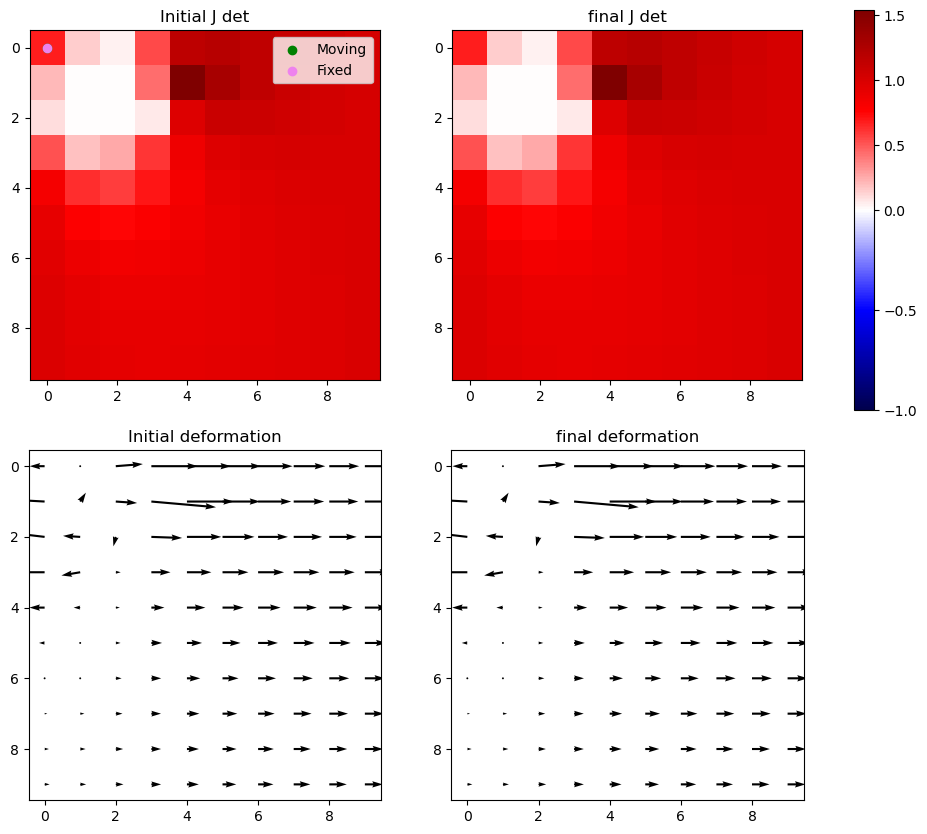

Iter 20: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


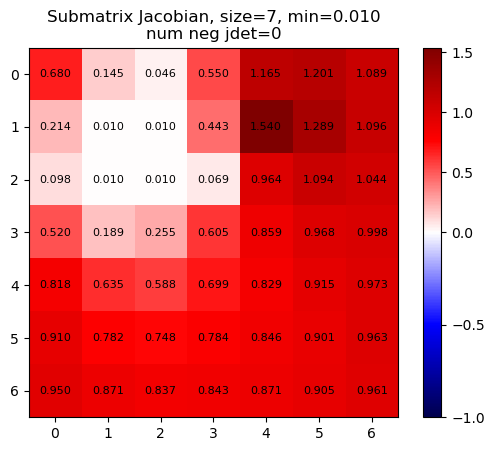

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


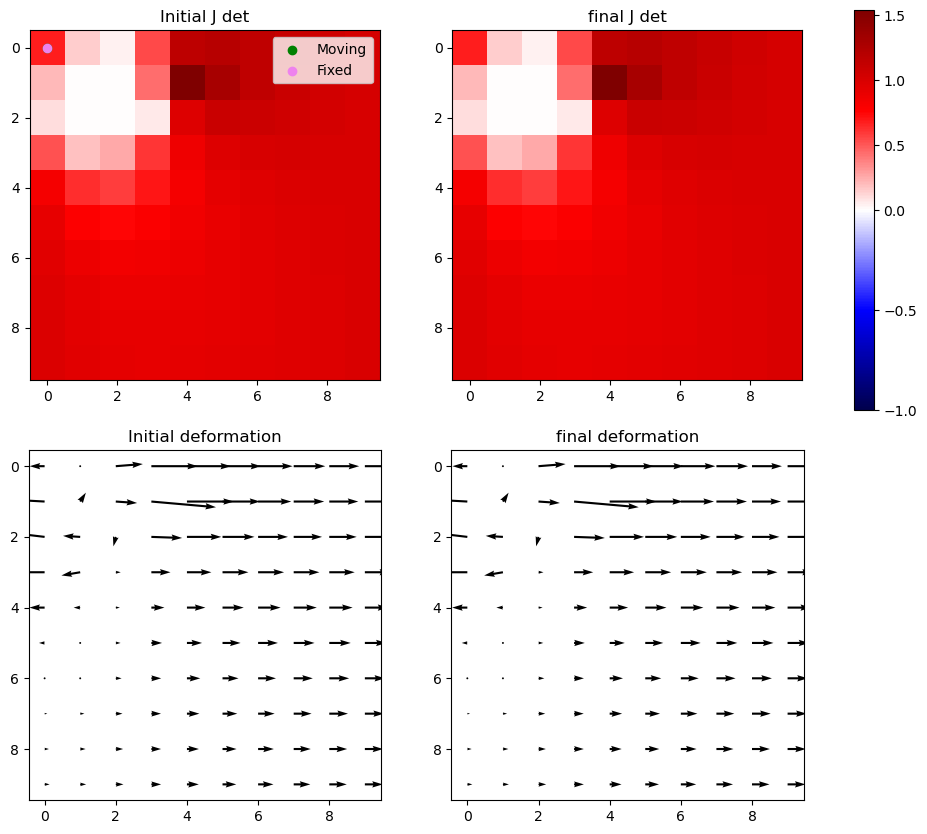

Iter 20: For index (2, 1), window size increased to 9 at iter 3


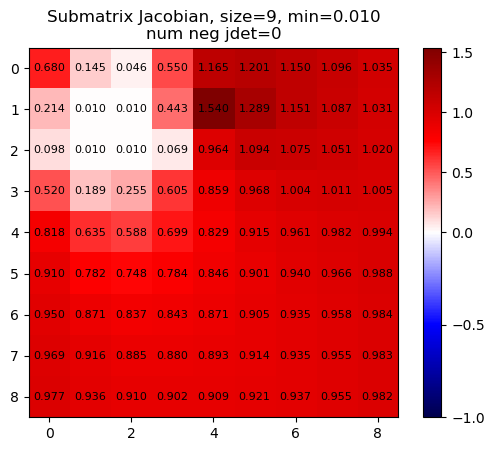

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


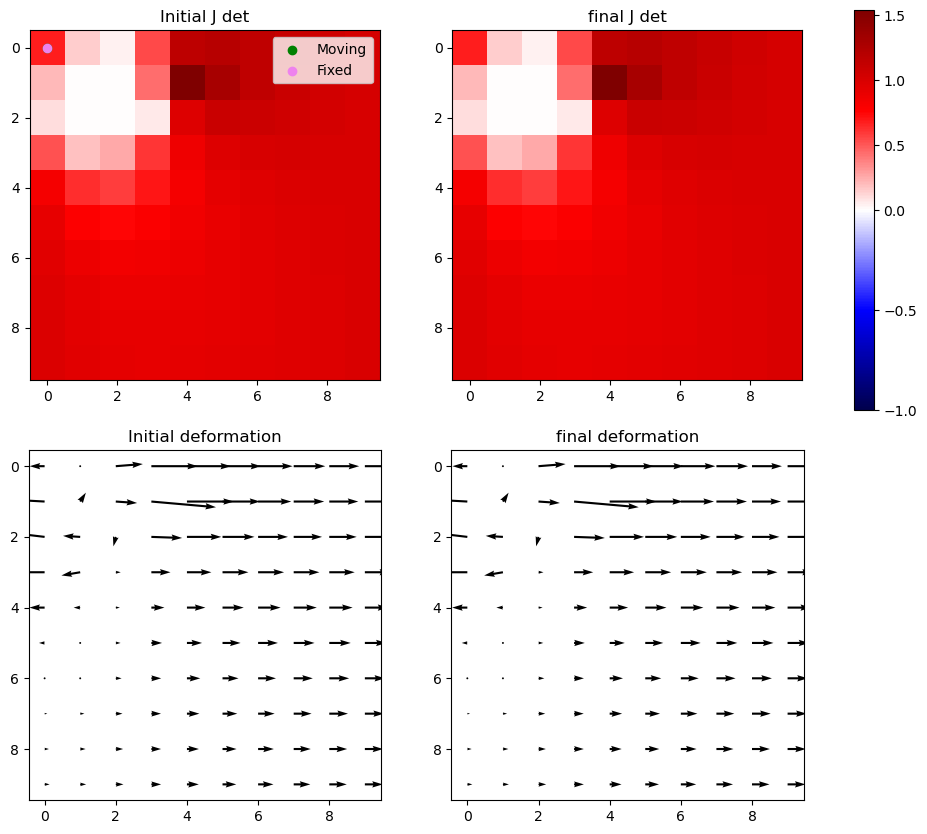

Iter 20 with 0 -ve jacs



Iter 21: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


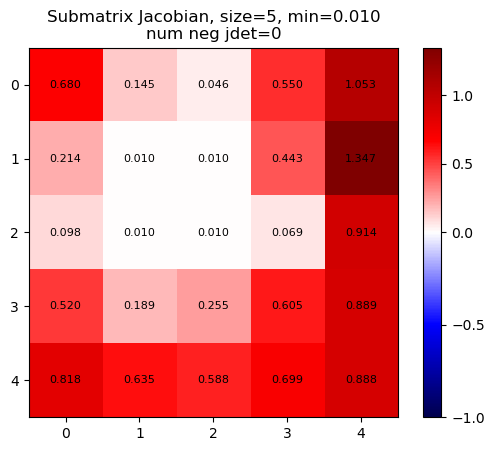

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


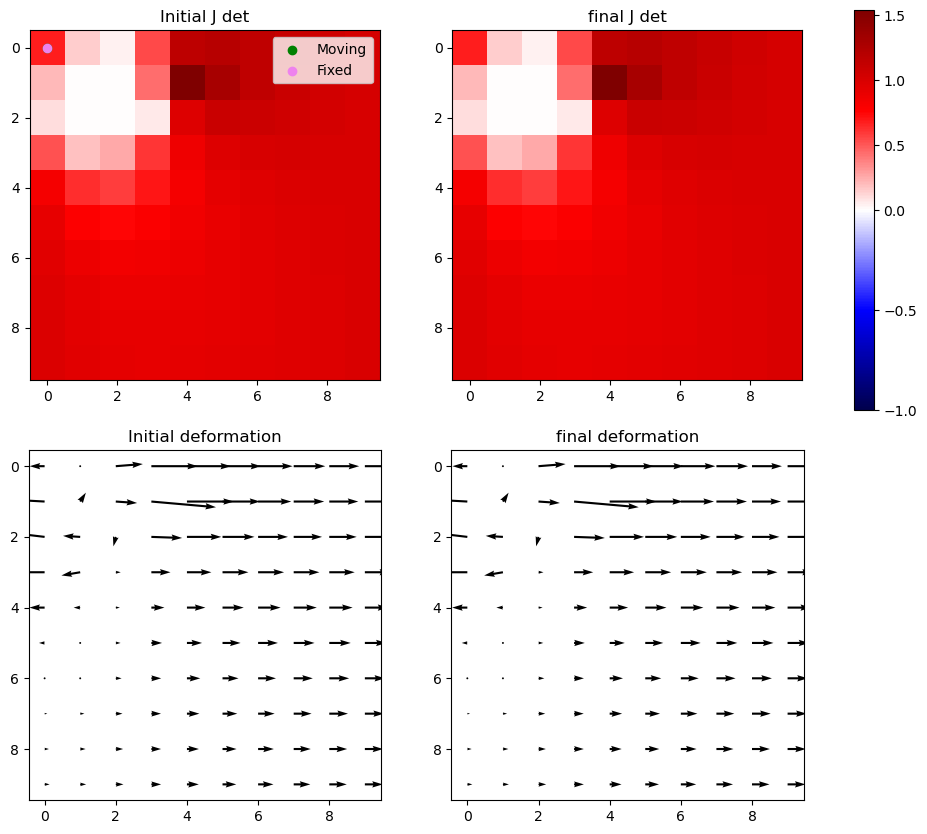

Iter 21: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


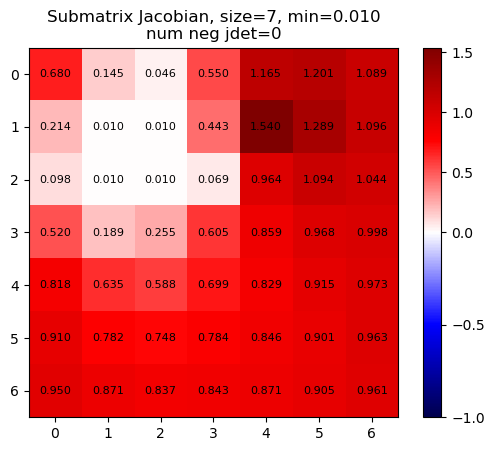

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


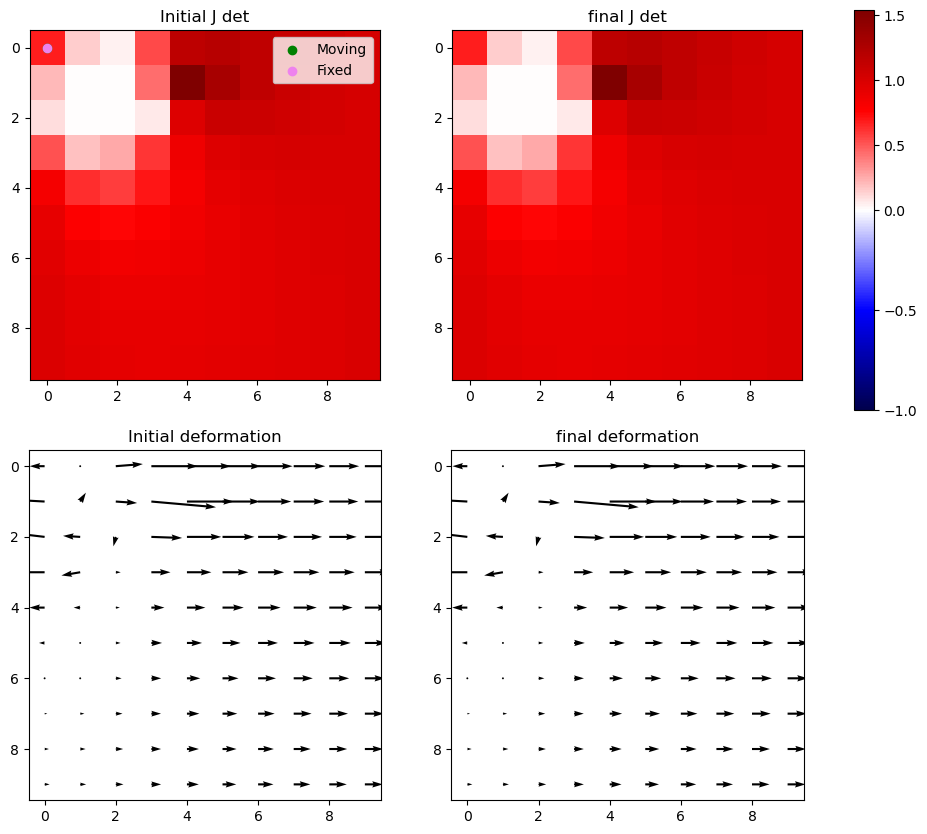

Iter 21: For index (2, 1), window size increased to 9 at iter 3


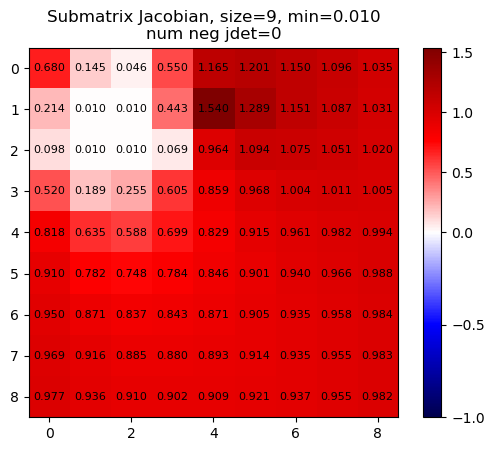

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


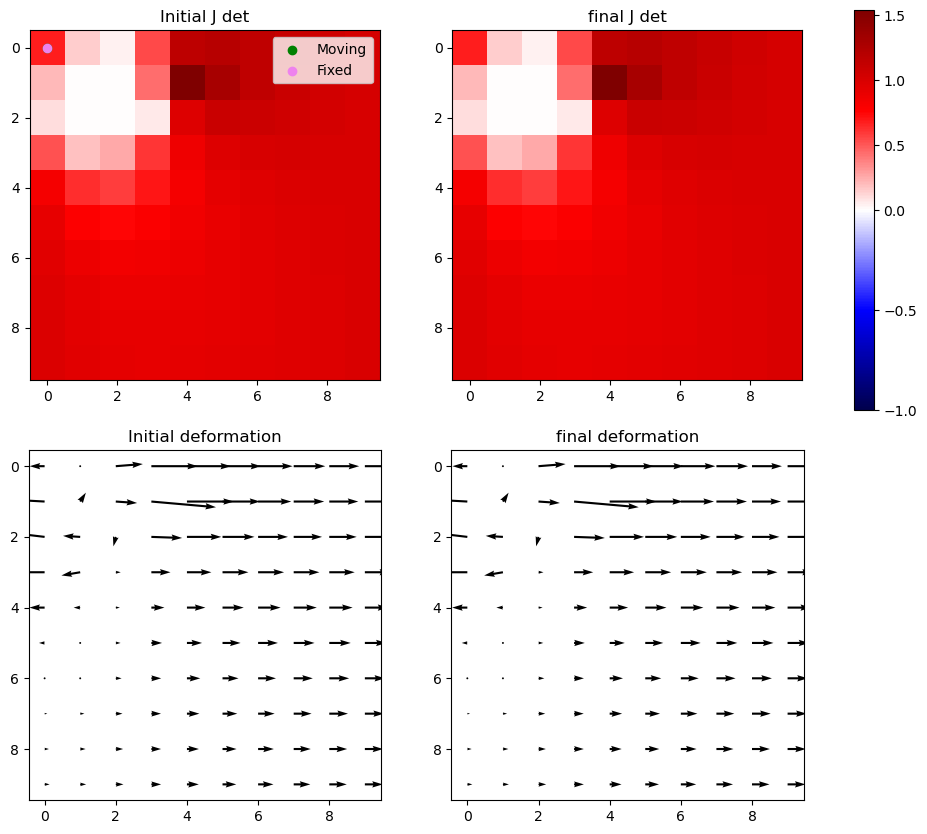

Iter 21 with 0 -ve jacs



Iter 22: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


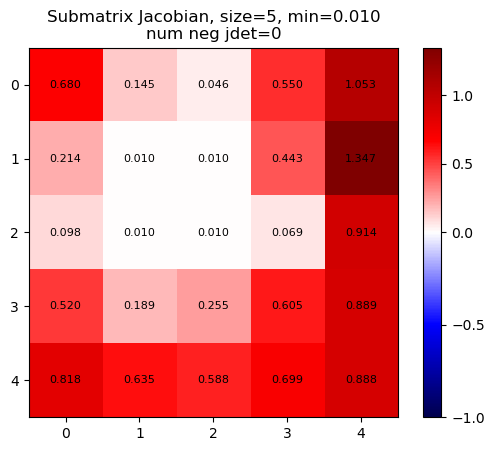

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


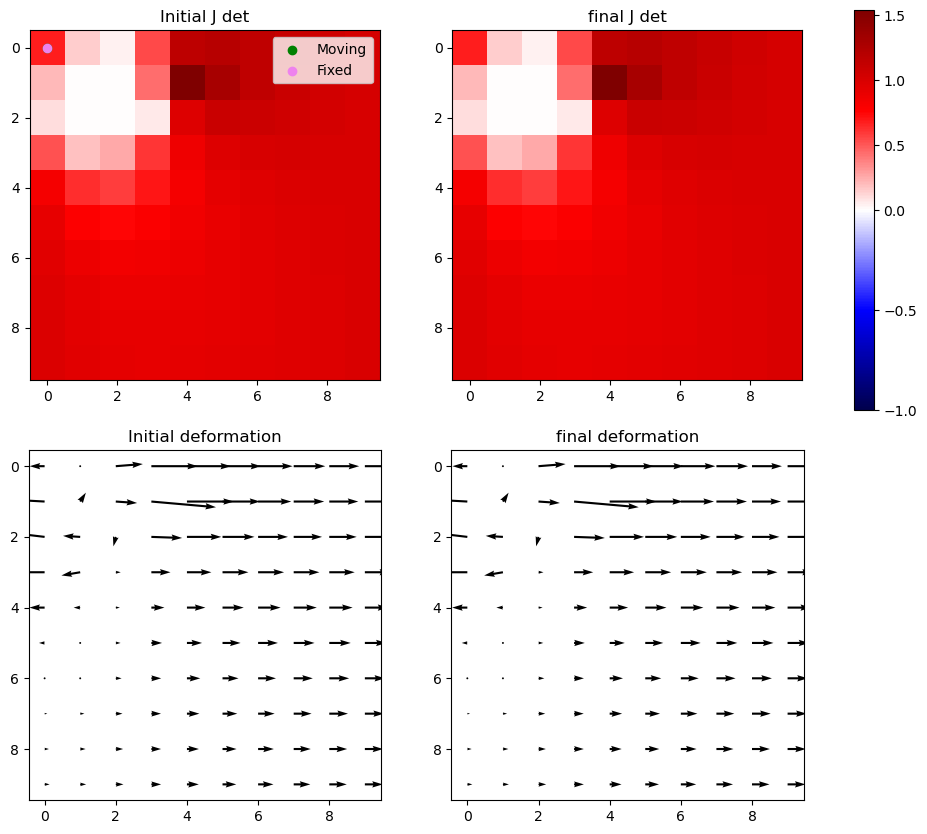

Iter 22: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


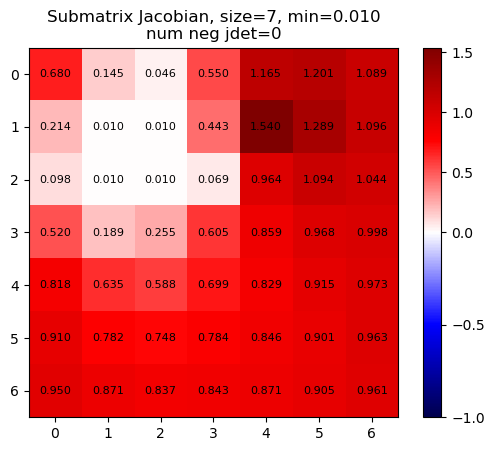

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


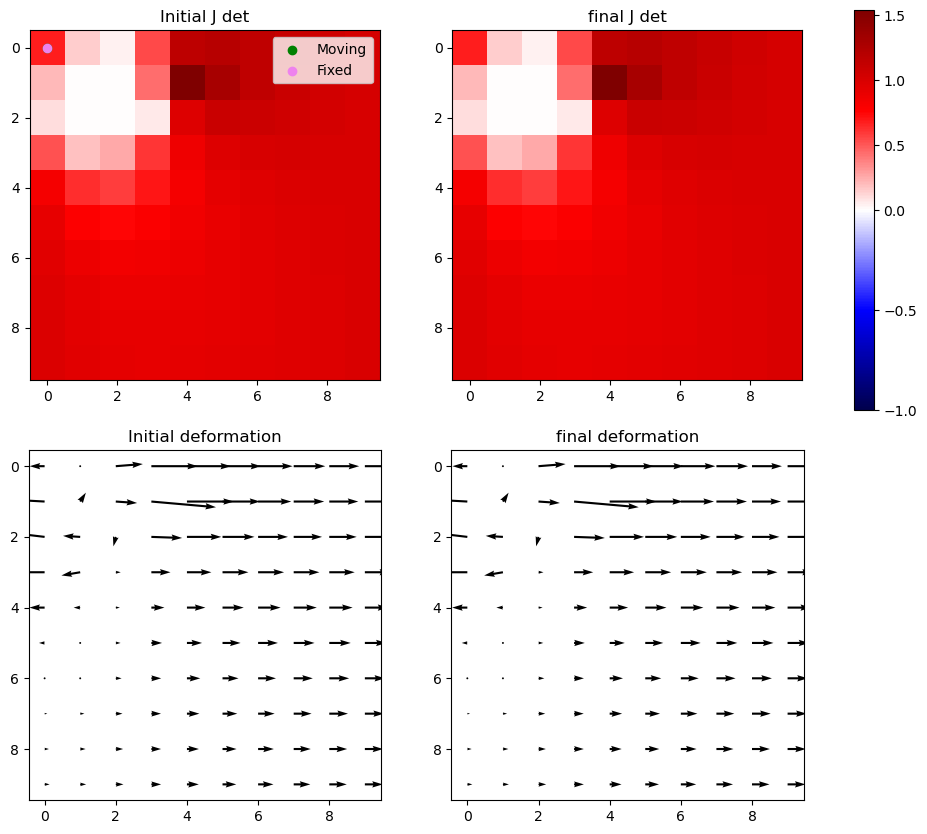

Iter 22: For index (2, 1), window size increased to 9 at iter 3


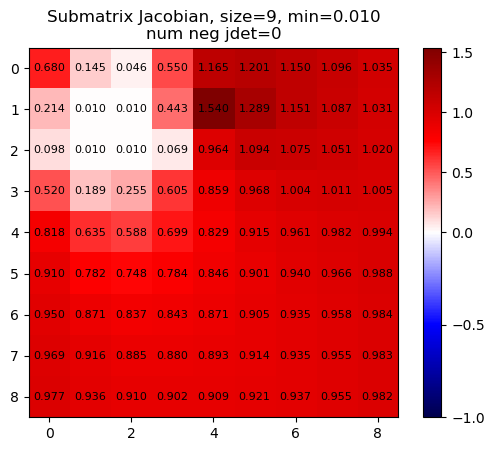

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


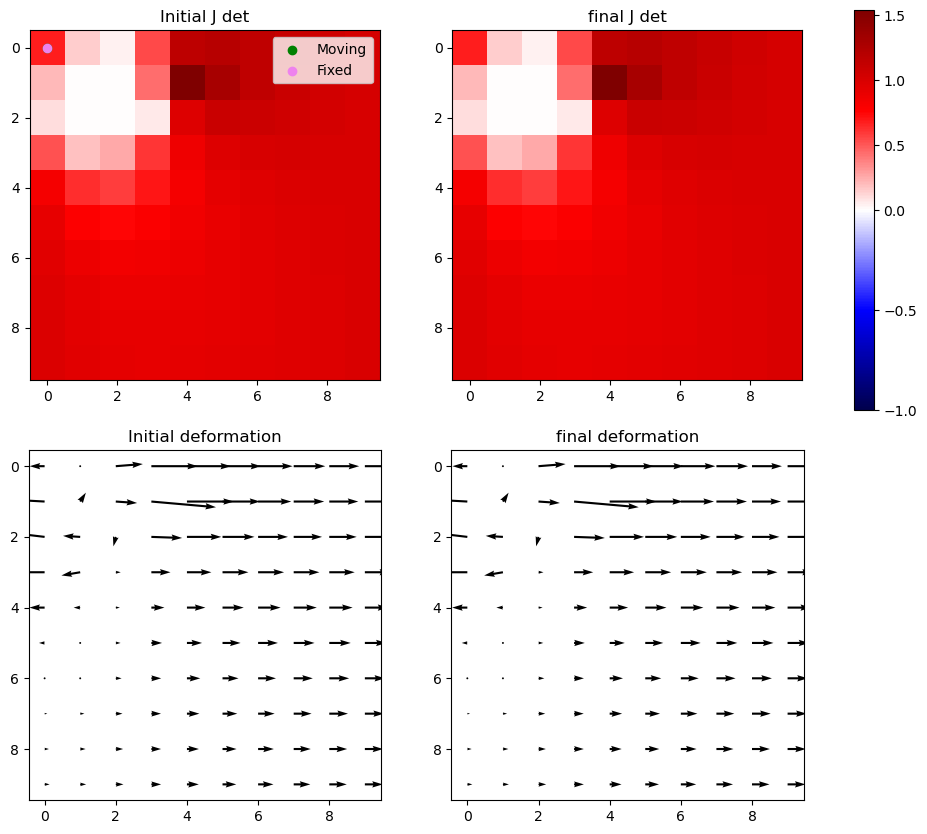

Iter 22 with 0 -ve jacs



Iter 23: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


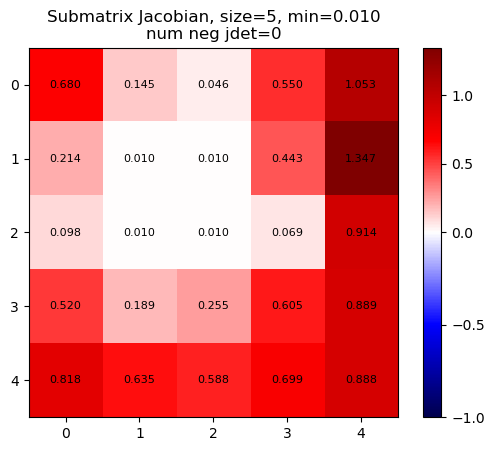

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


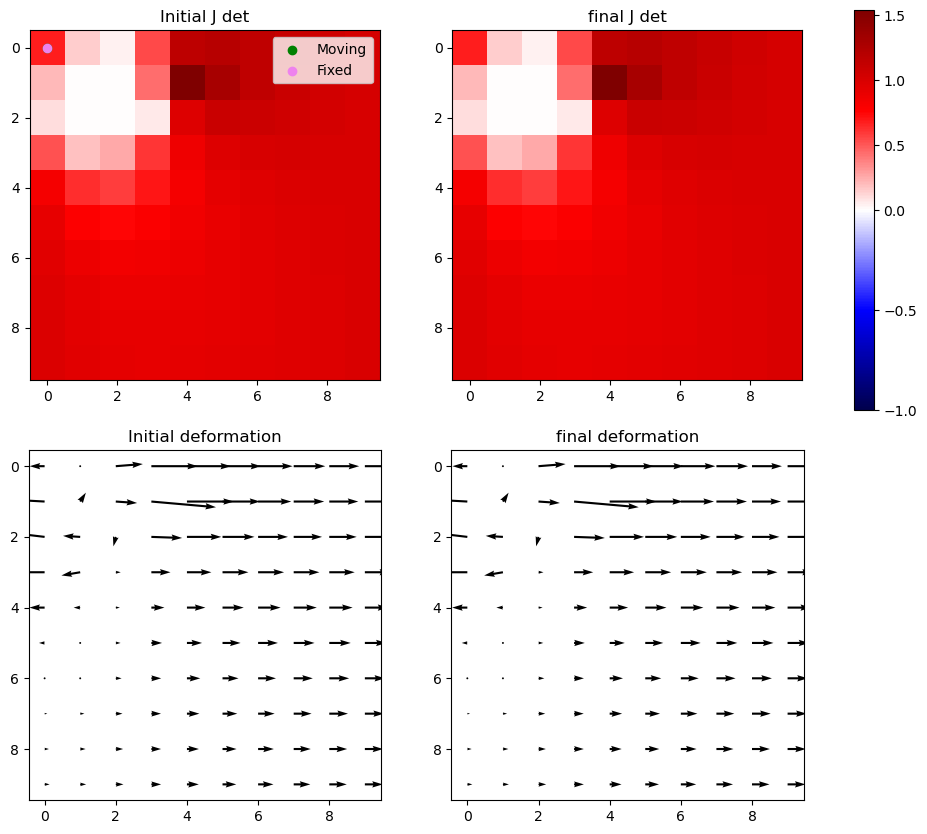

Iter 23: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


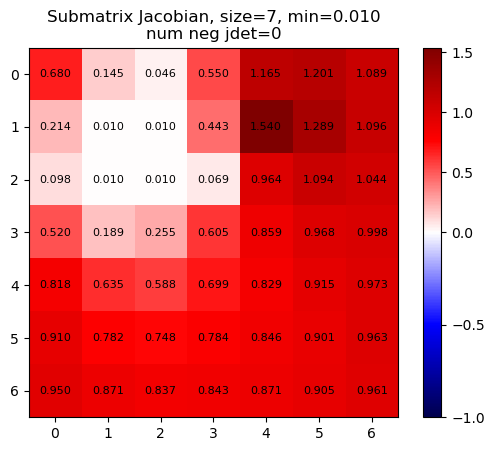

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


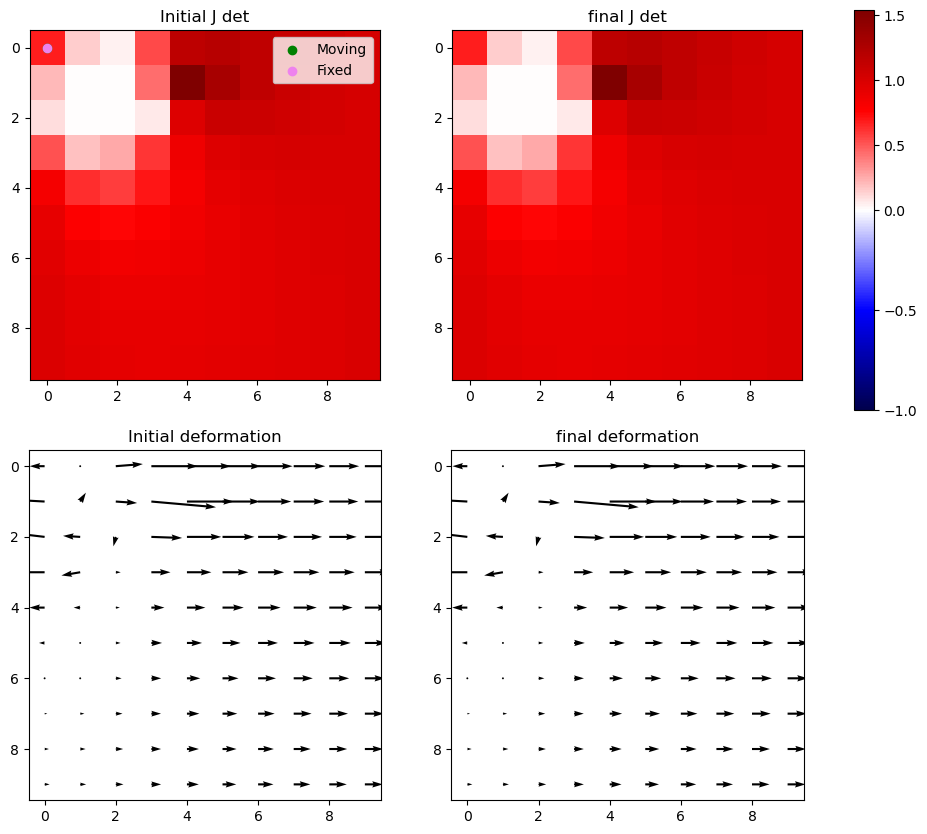

Iter 23: For index (2, 1), window size increased to 9 at iter 3


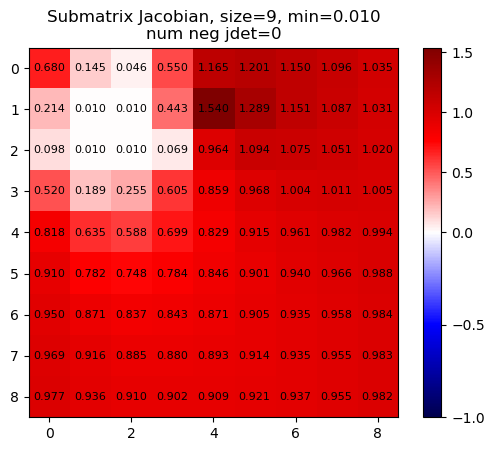

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


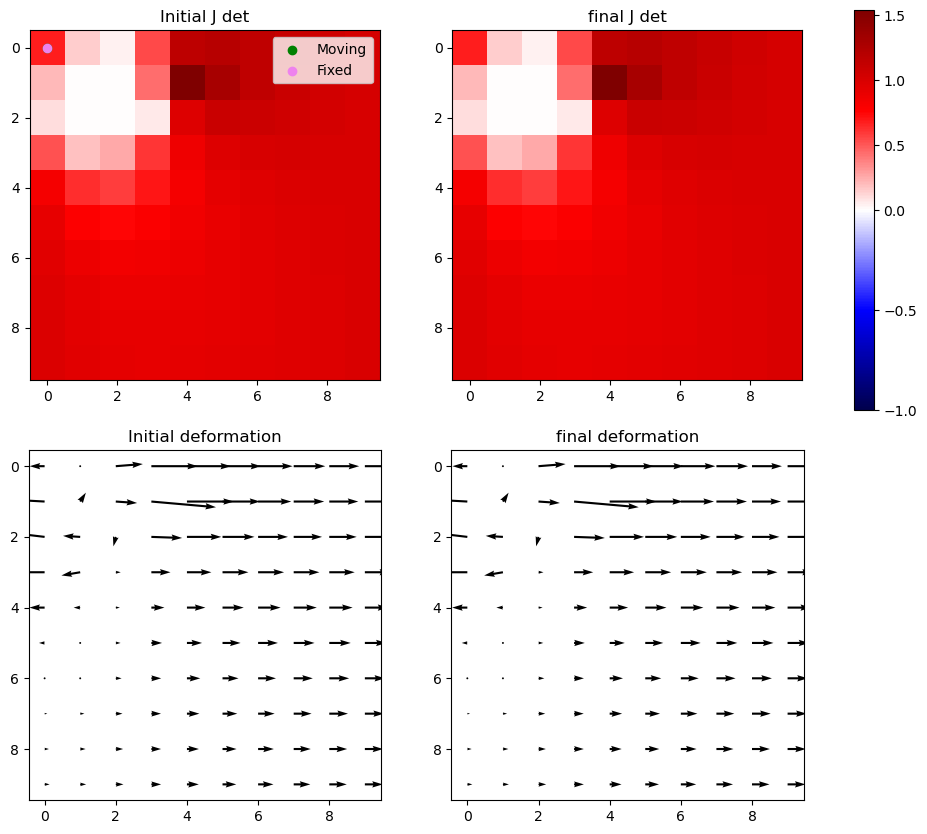

Iter 23 with 0 -ve jacs



Iter 24: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


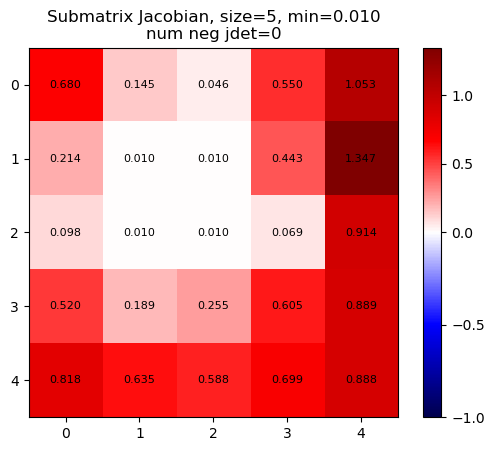

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


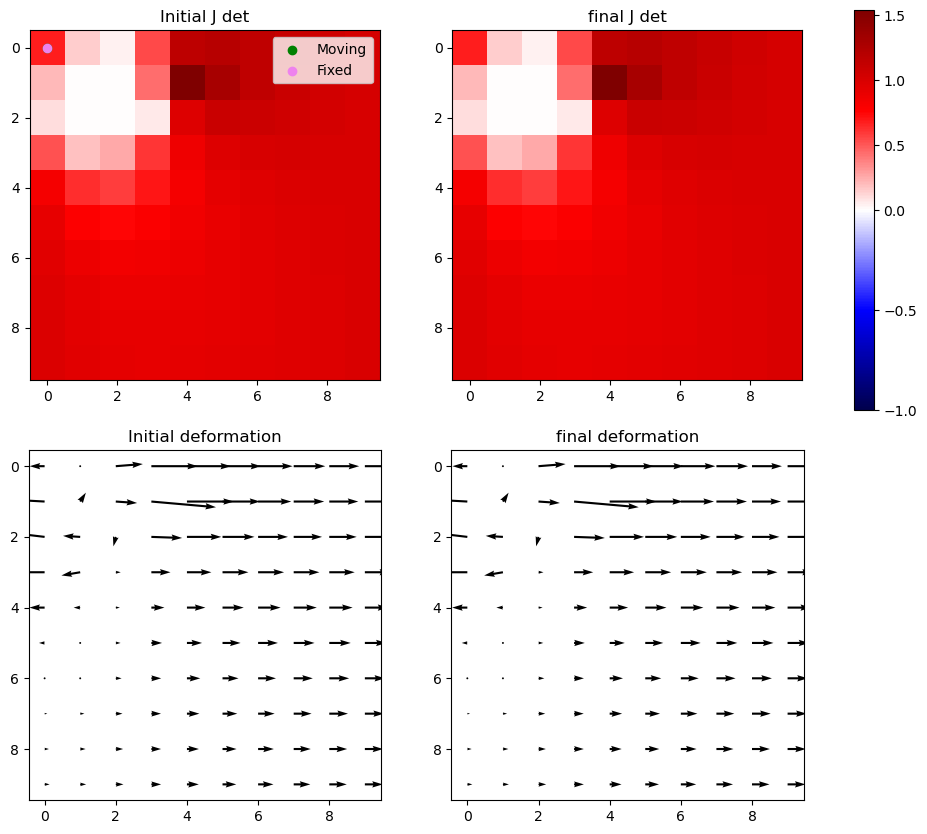

Iter 24: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


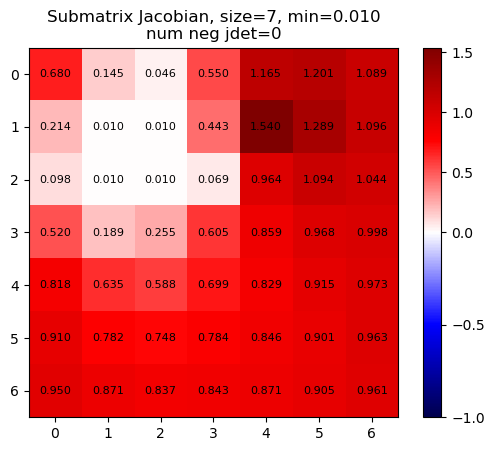

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


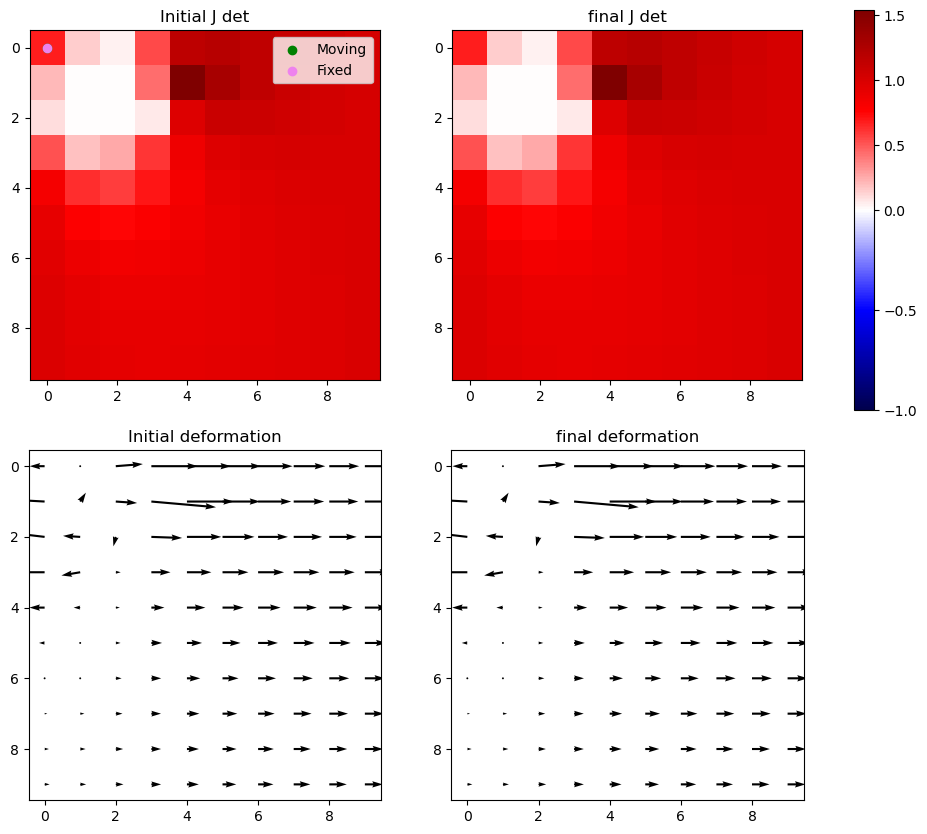

Iter 24: For index (2, 1), window size increased to 9 at iter 3


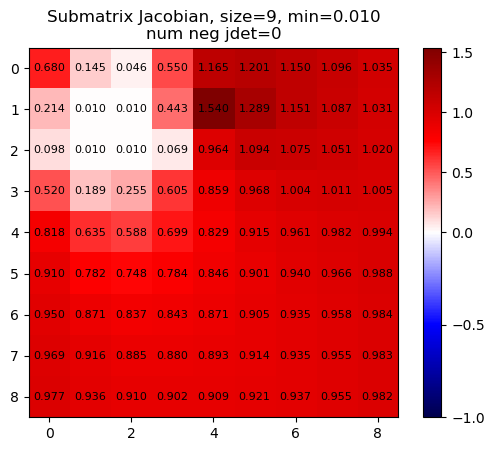

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


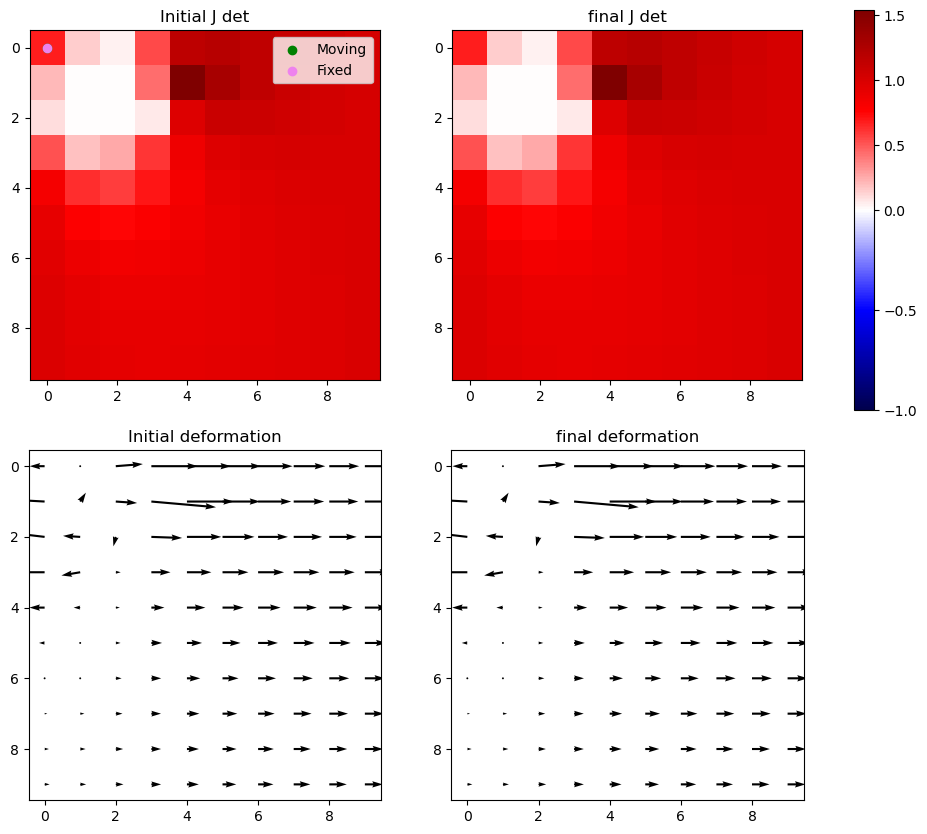

Iter 24 with 0 -ve jacs



Iter 25: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


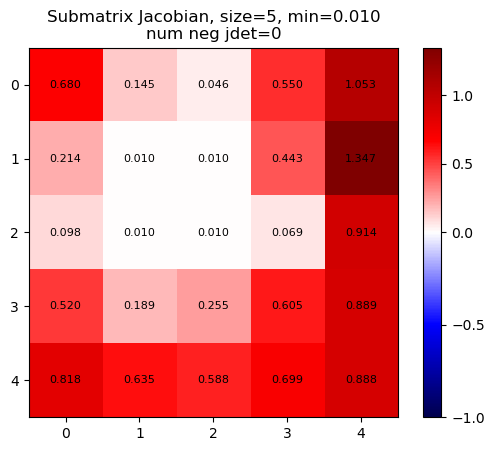

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


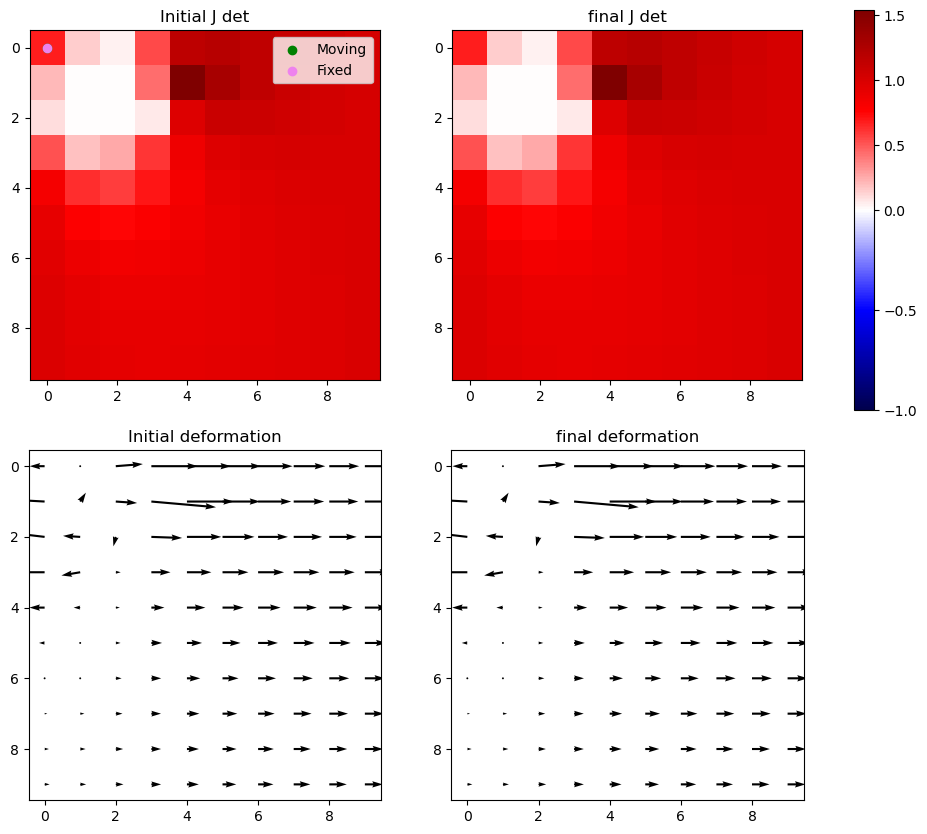

Iter 25: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


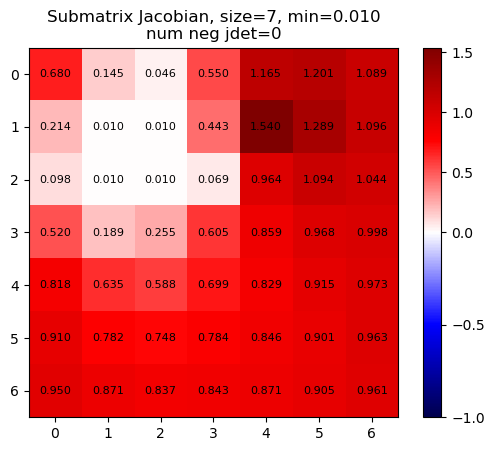

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


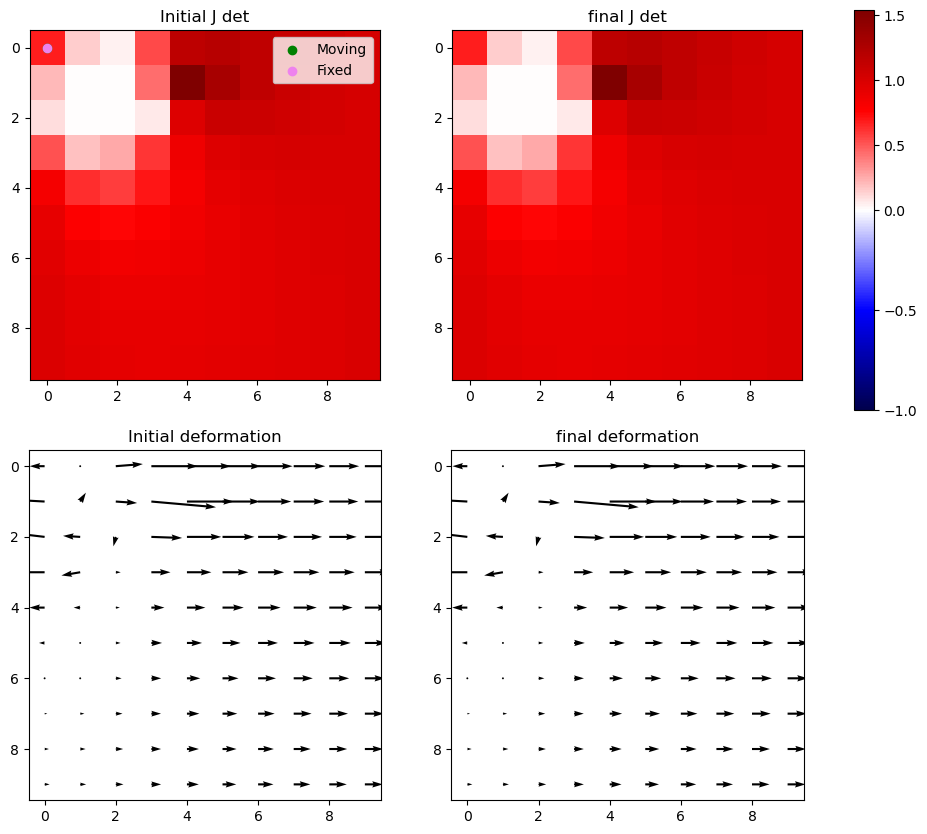

Iter 25: For index (2, 1), window size increased to 9 at iter 3


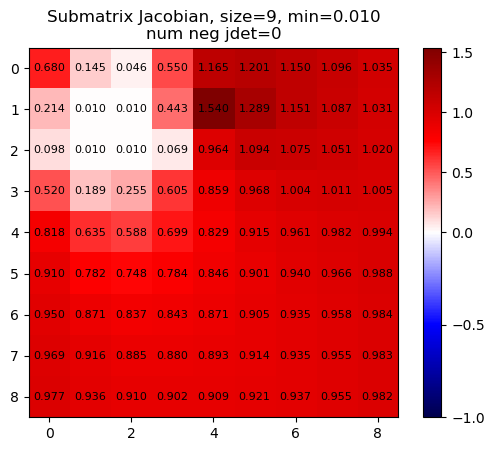

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


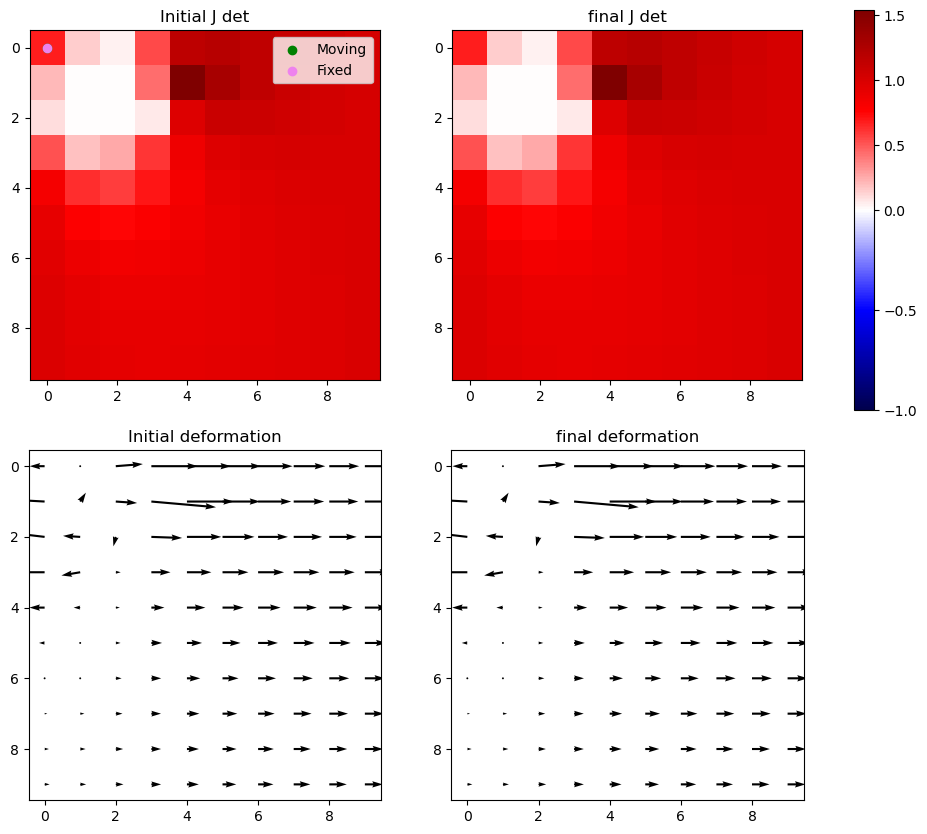

Iter 25 with 0 -ve jacs



Iter 26: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


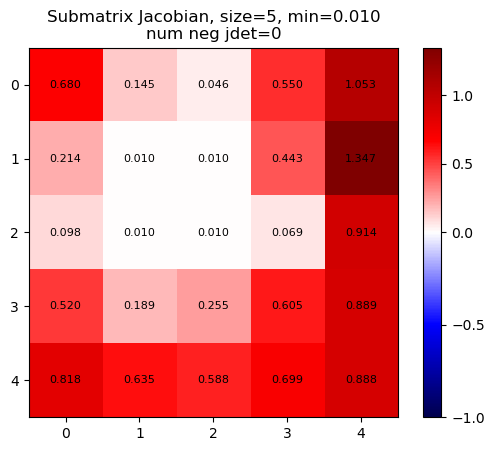

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


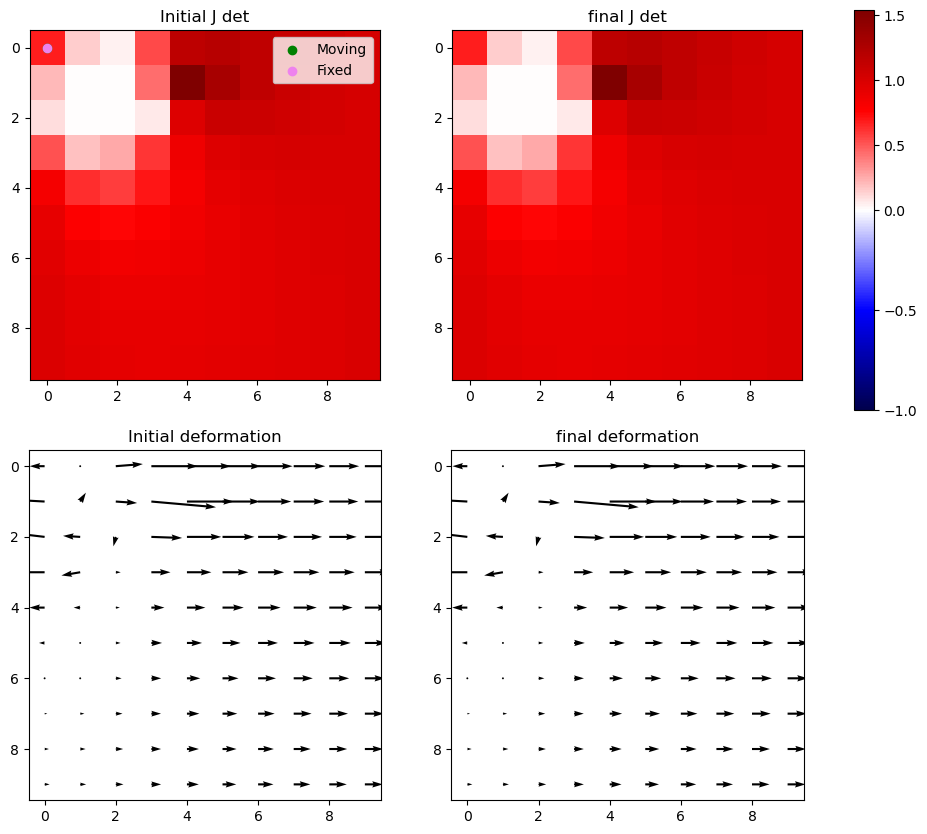

Iter 26: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


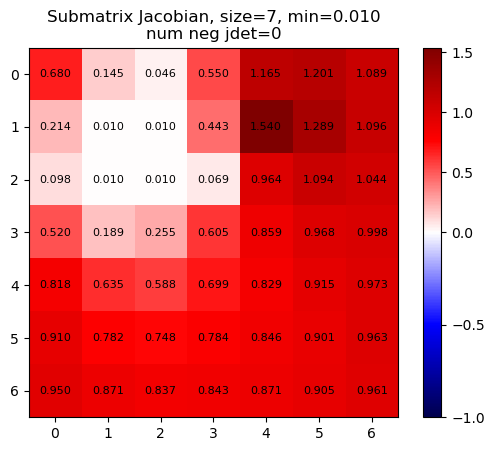

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


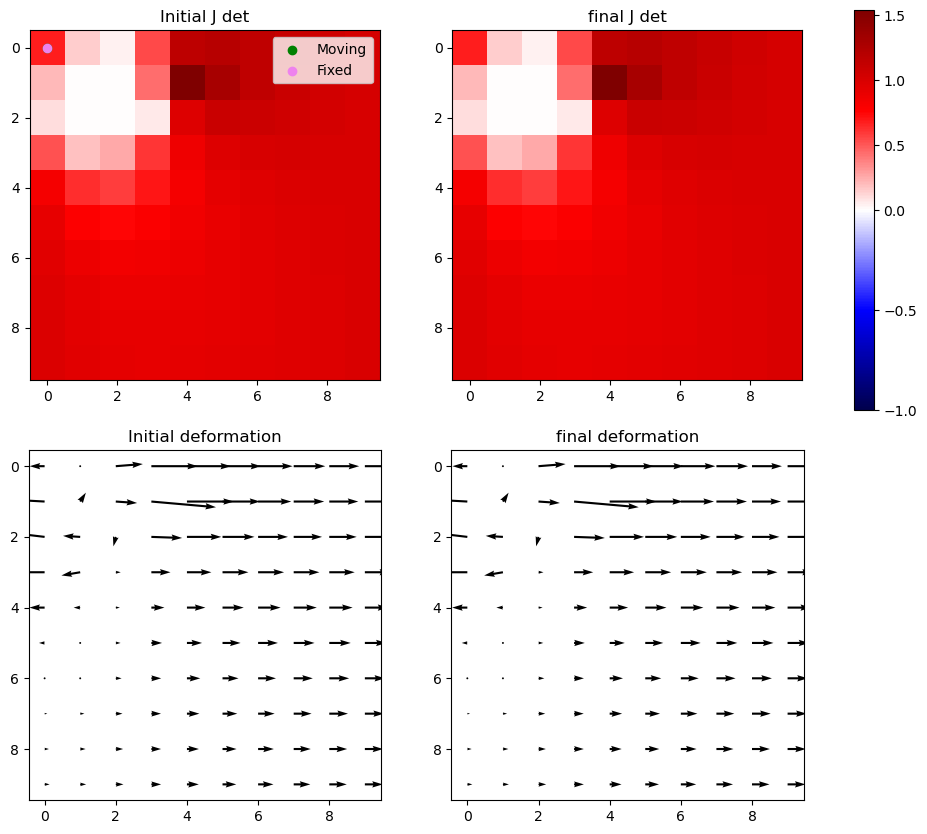

Iter 26: For index (2, 1), window size increased to 9 at iter 3


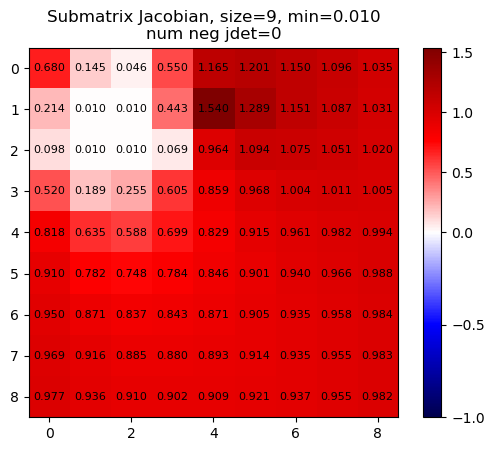

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


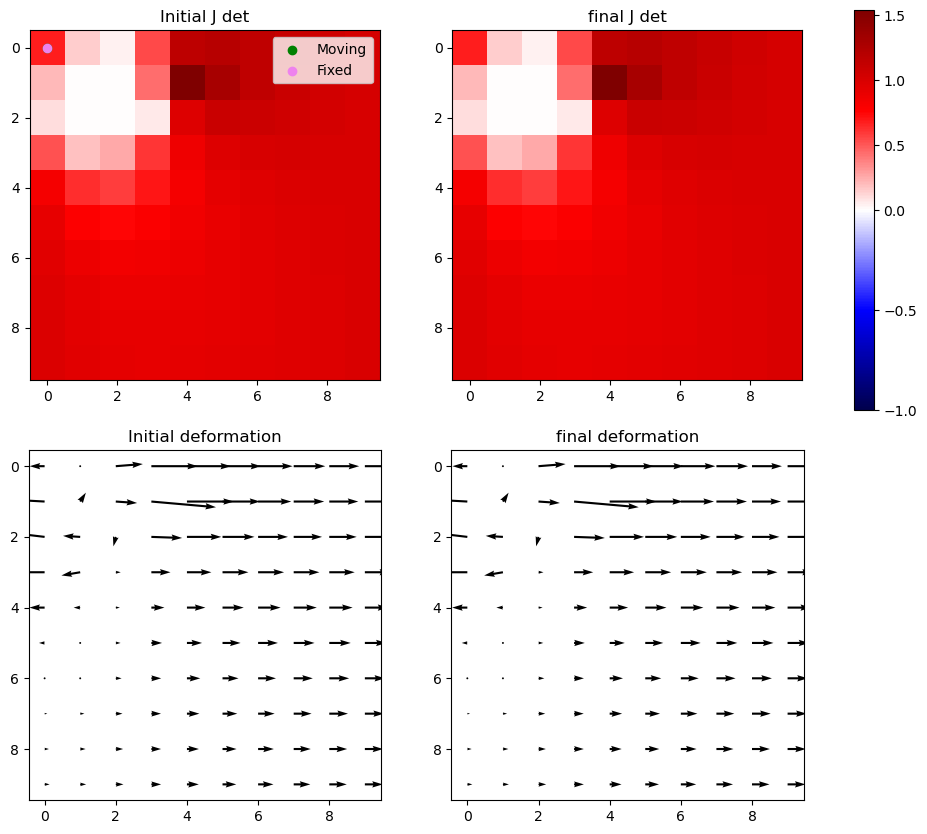

Iter 26 with 0 -ve jacs



Iter 27: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


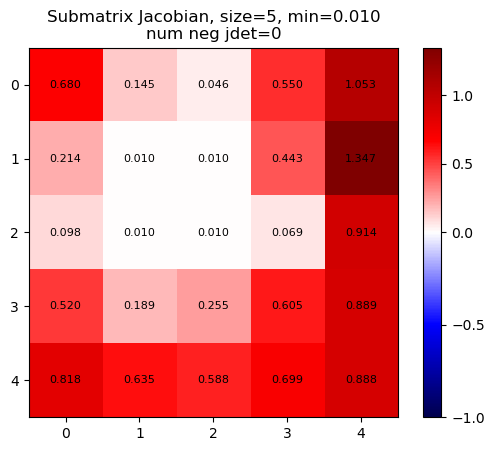

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


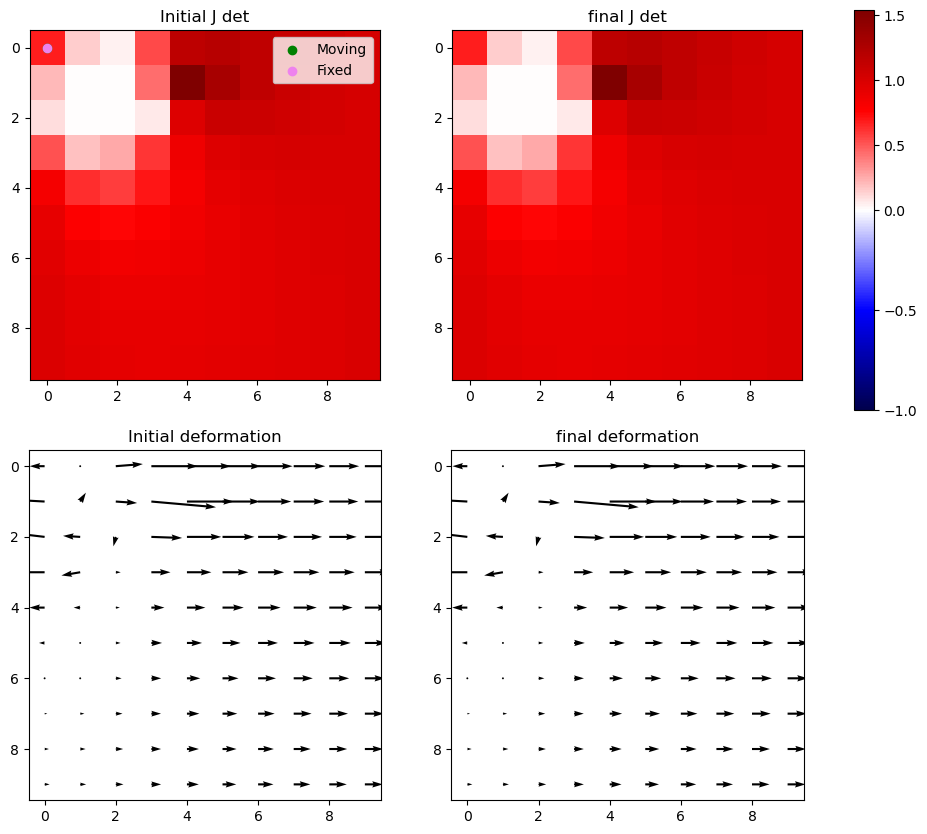

Iter 27: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


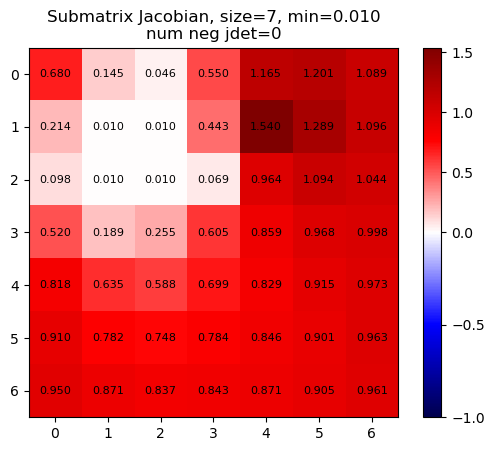

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


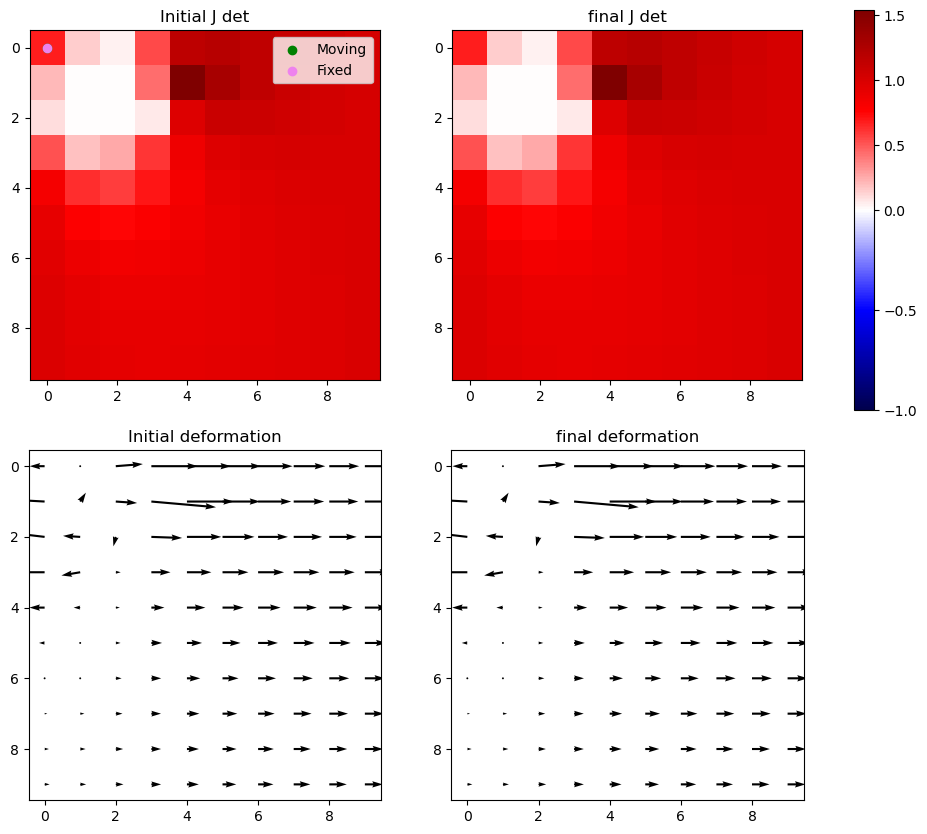

Iter 27: For index (2, 1), window size increased to 9 at iter 3


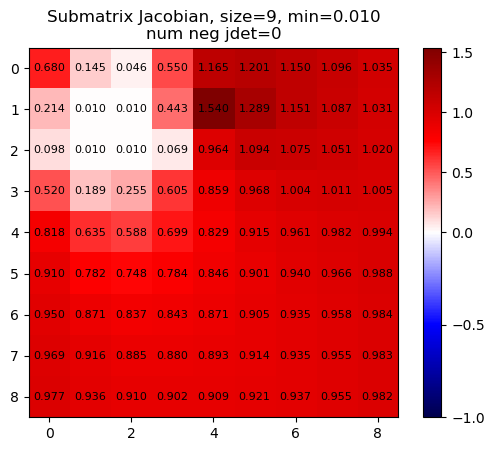

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


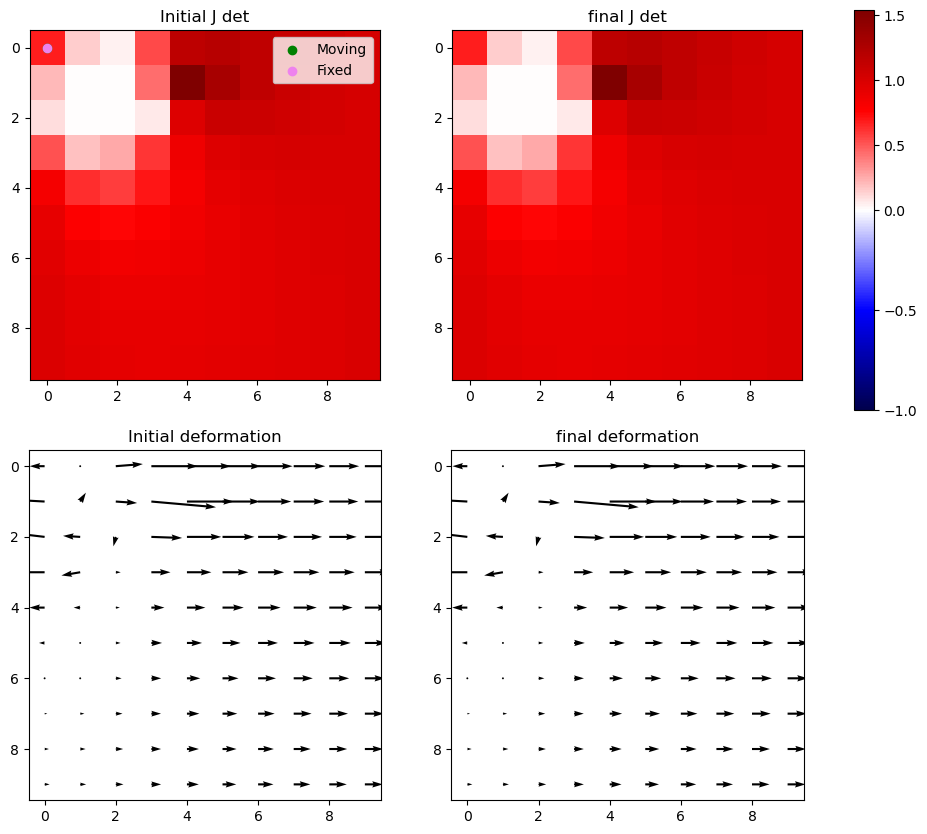

Iter 27 with 0 -ve jacs



Iter 28: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


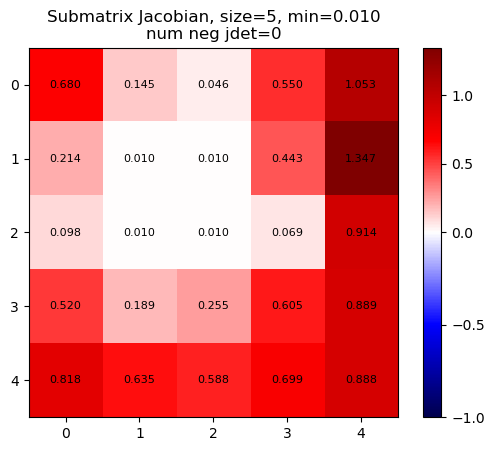

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


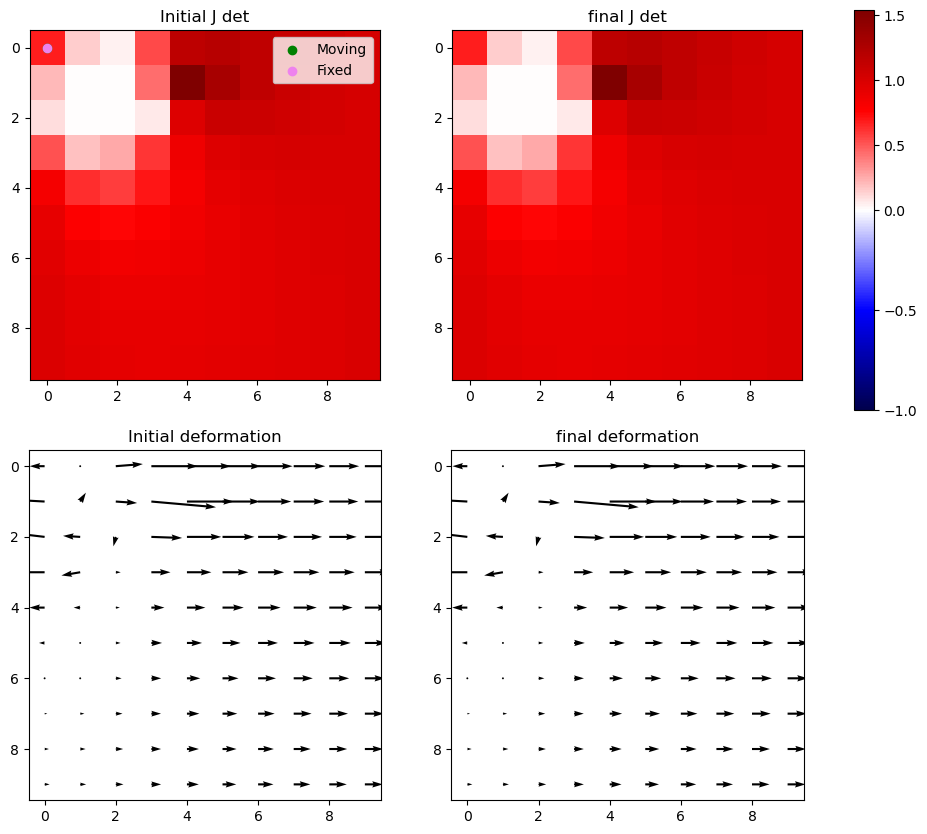

Iter 28: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


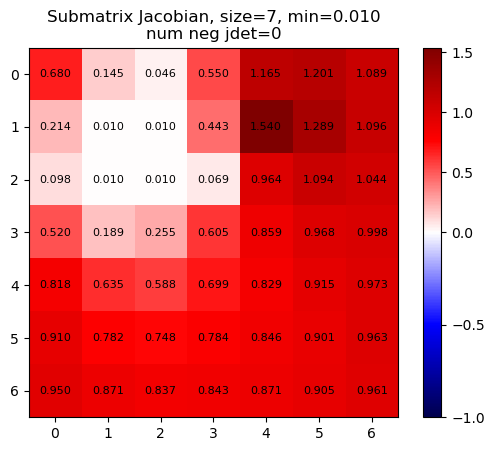

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


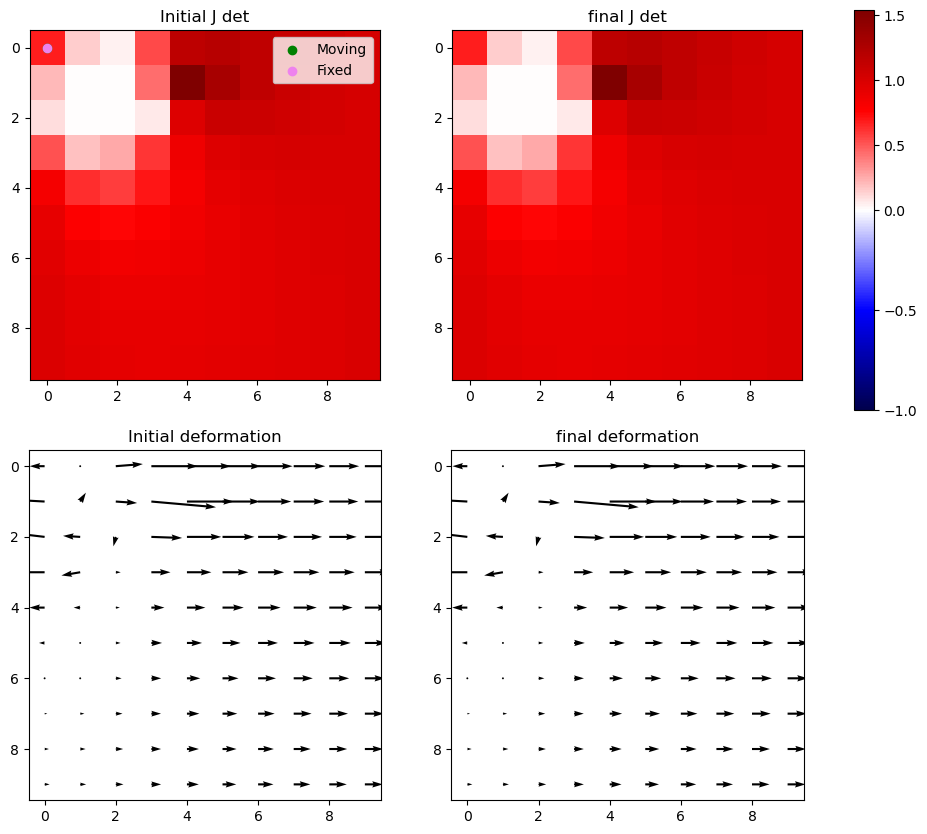

Iter 28: For index (2, 1), window size increased to 9 at iter 3


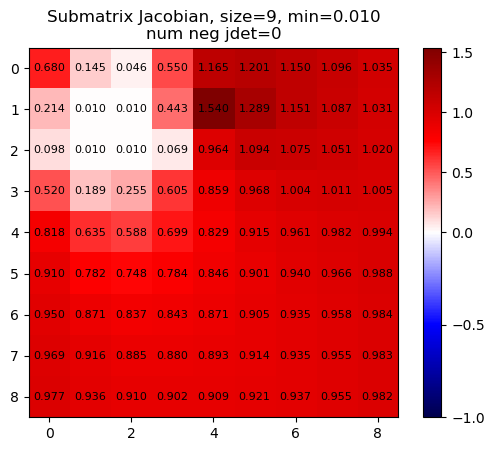

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


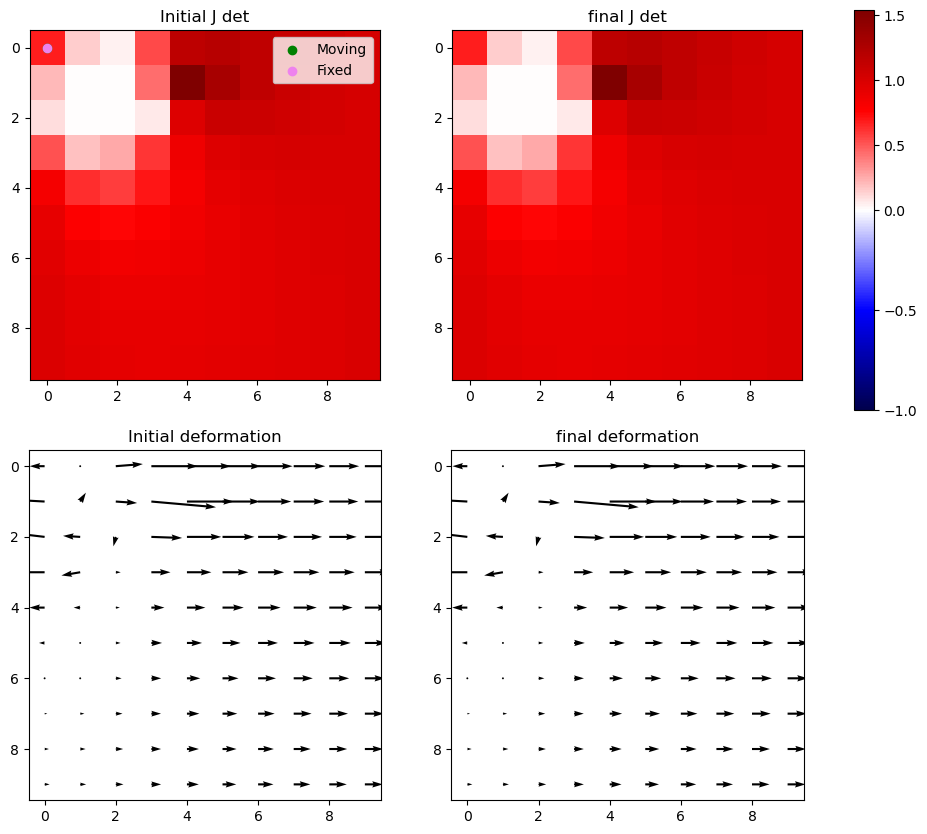

Iter 28 with 0 -ve jacs



Iter 29: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


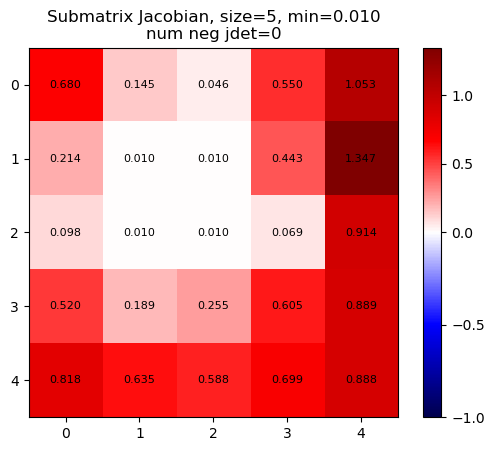

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


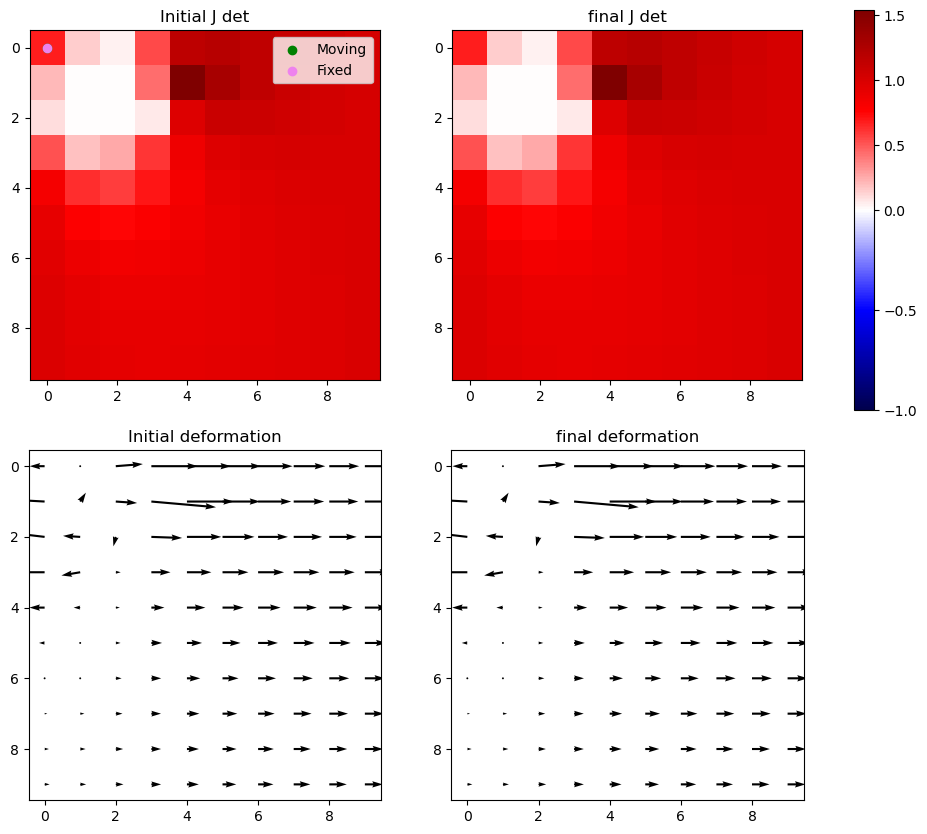

Iter 29: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


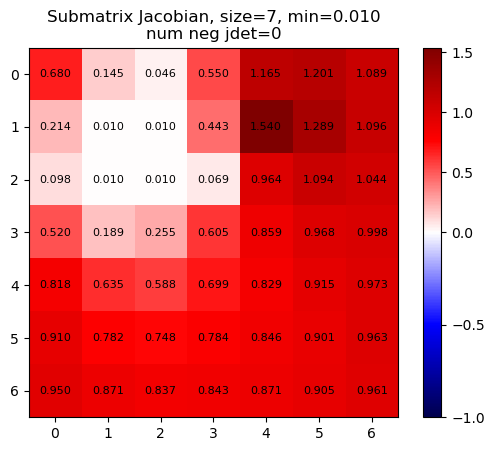

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


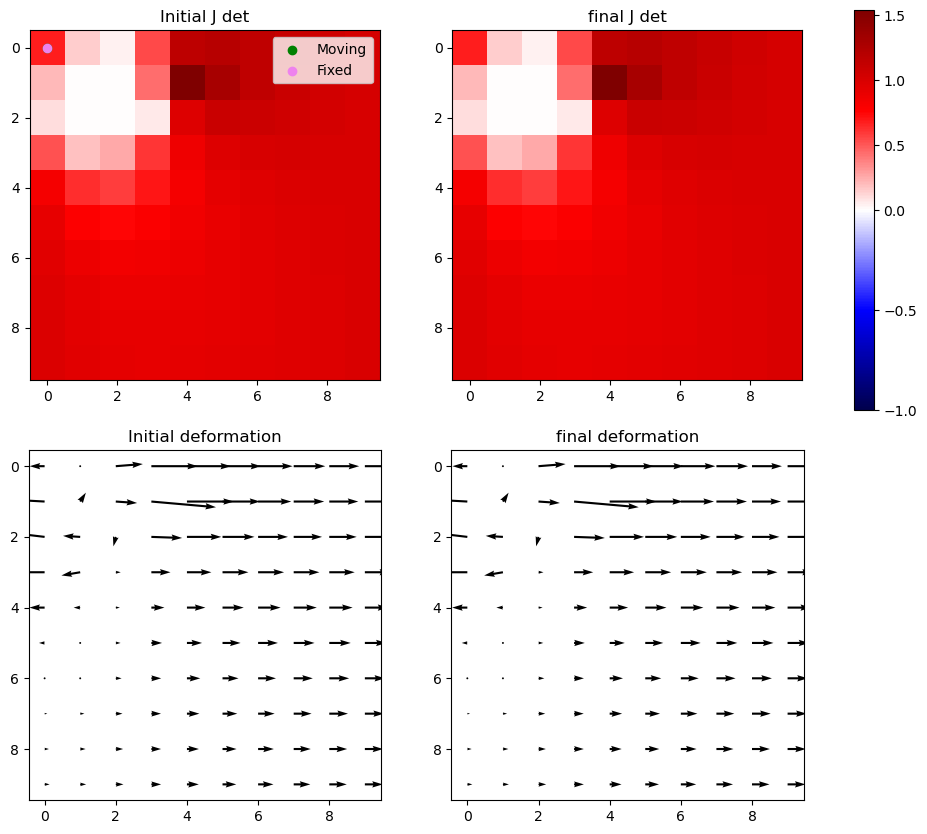

Iter 29: For index (2, 1), window size increased to 9 at iter 3


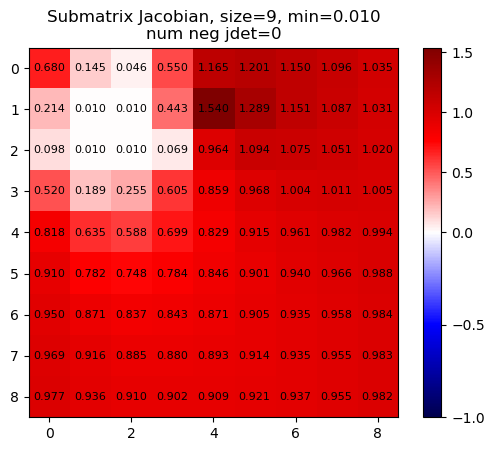

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


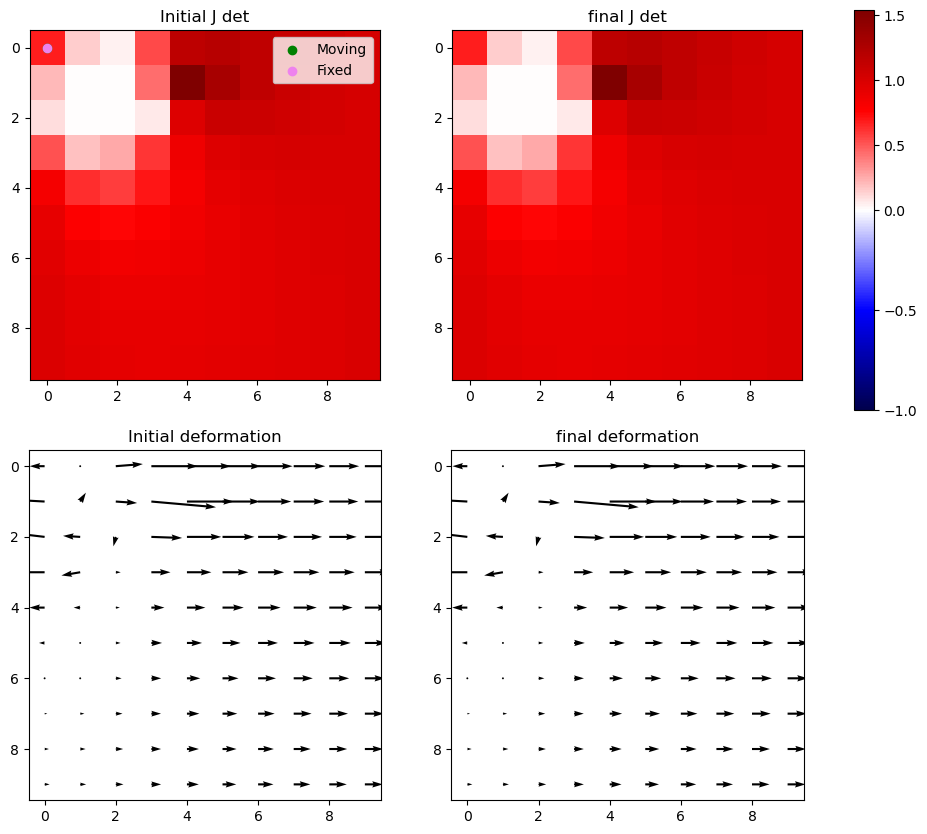

Iter 29 with 0 -ve jacs



Iter 30: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


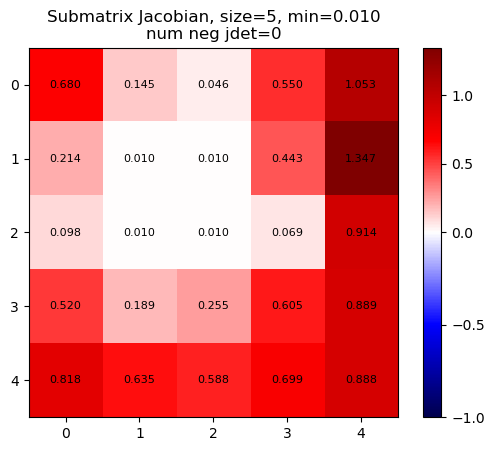

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


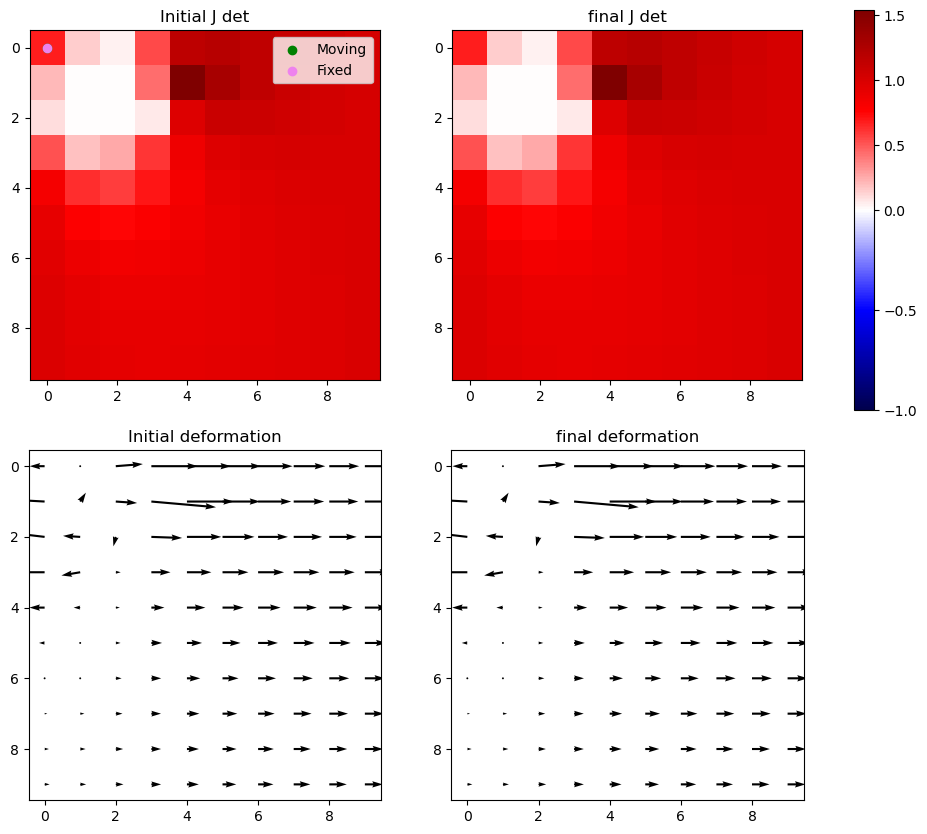

Iter 30: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


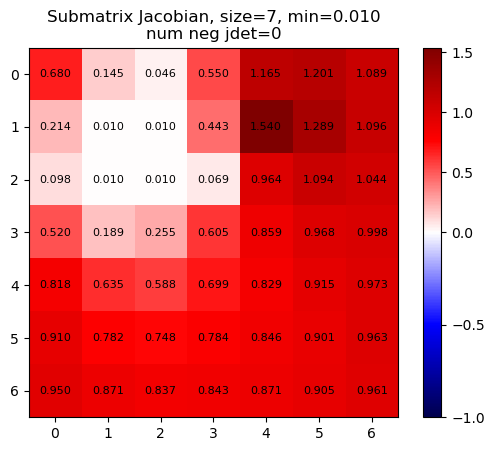

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


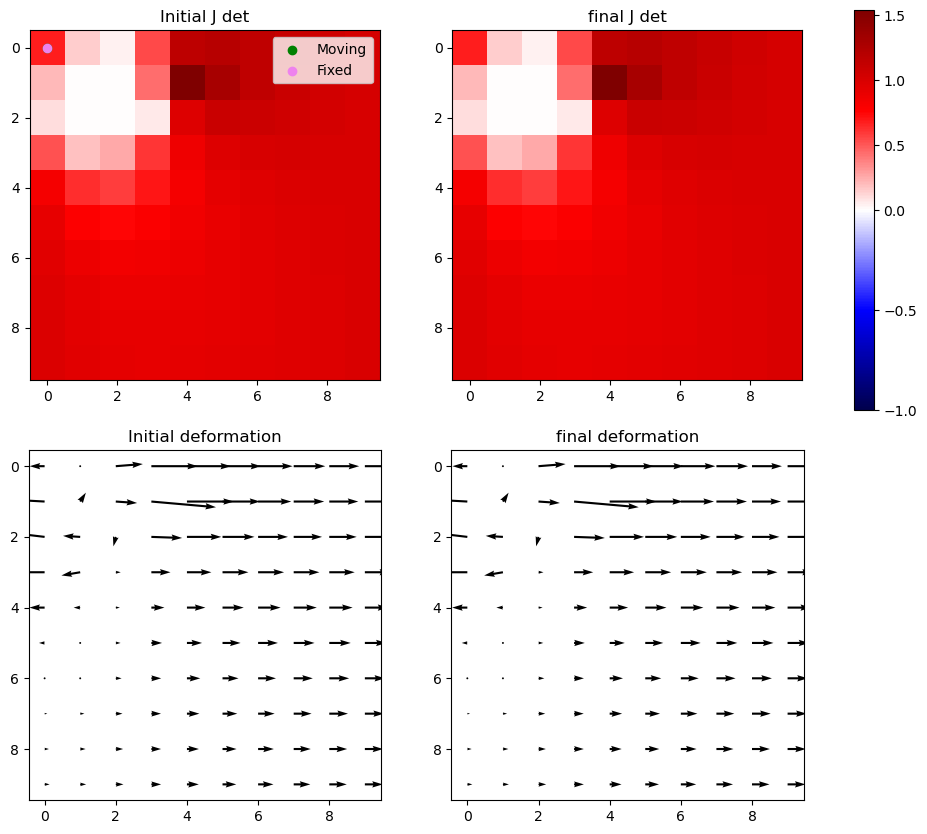

Iter 30: For index (2, 1), window size increased to 9 at iter 3


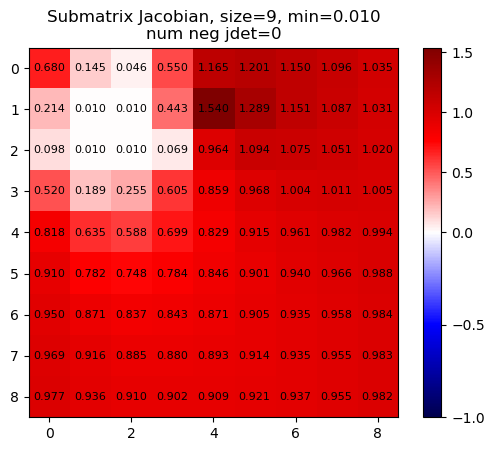

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


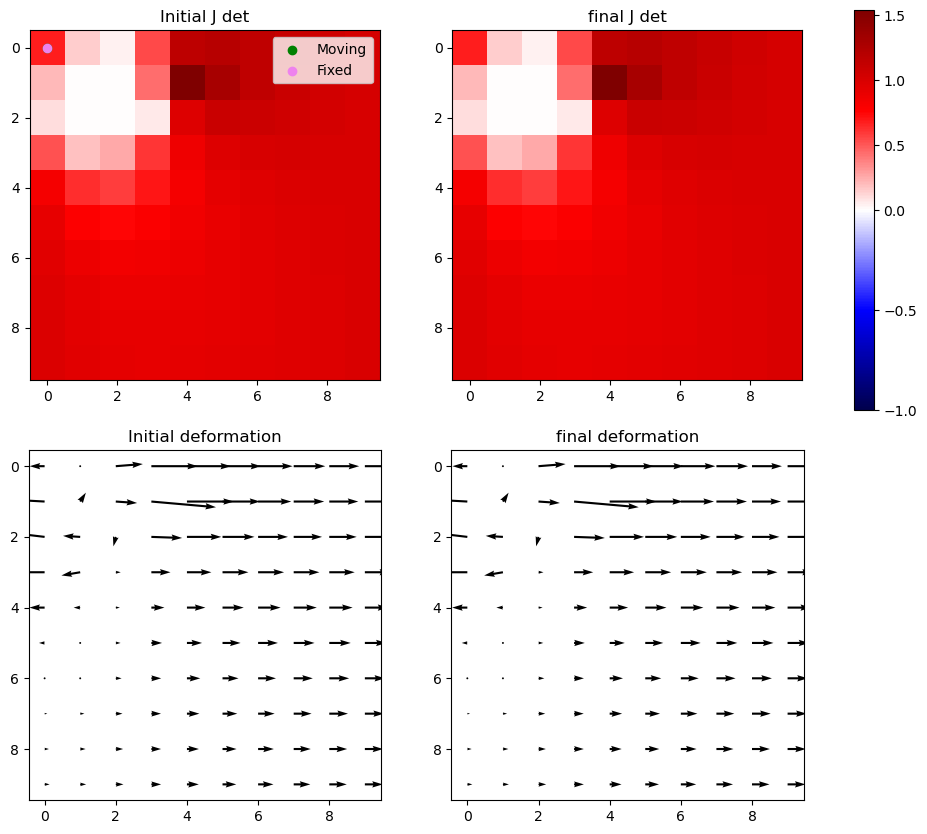

Iter 30 with 0 -ve jacs



Iter 31: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


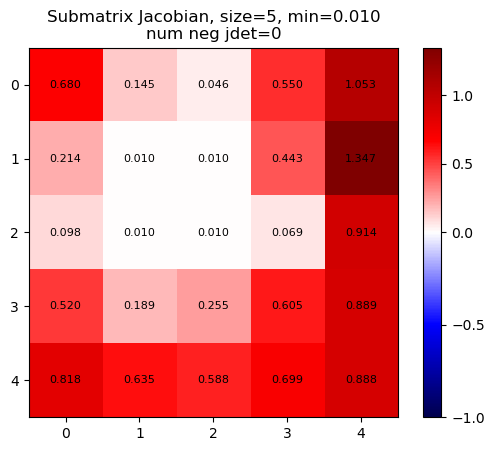

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


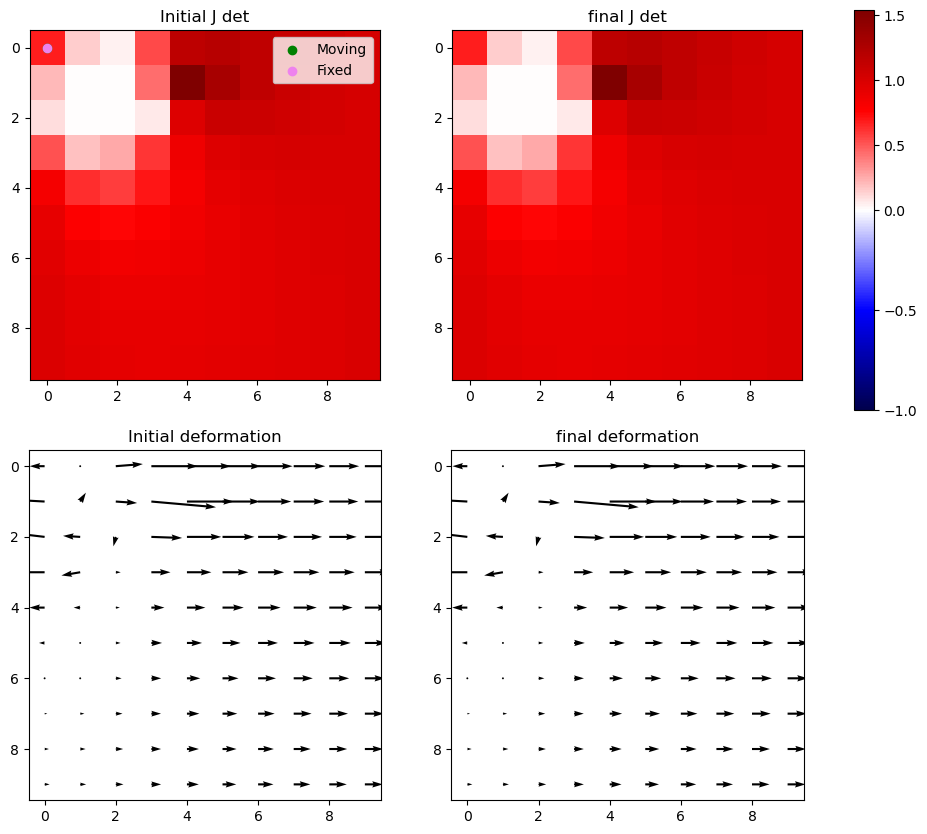

Iter 31: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


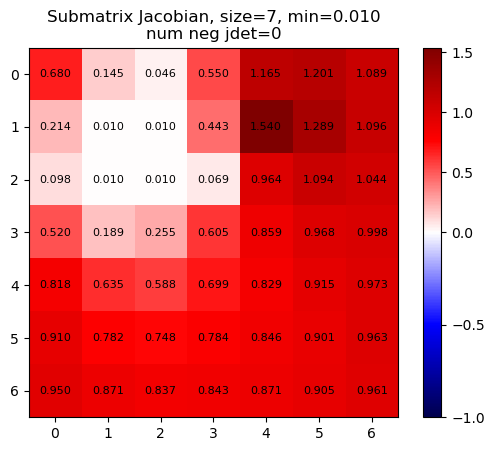

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


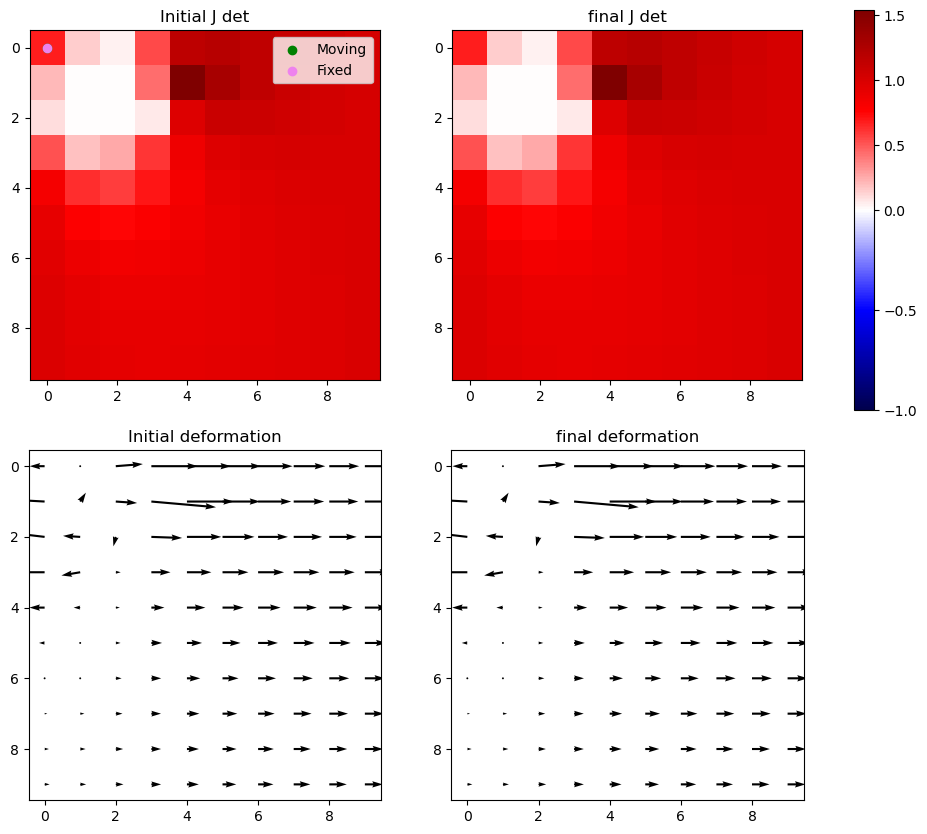

Iter 31: For index (2, 1), window size increased to 9 at iter 3


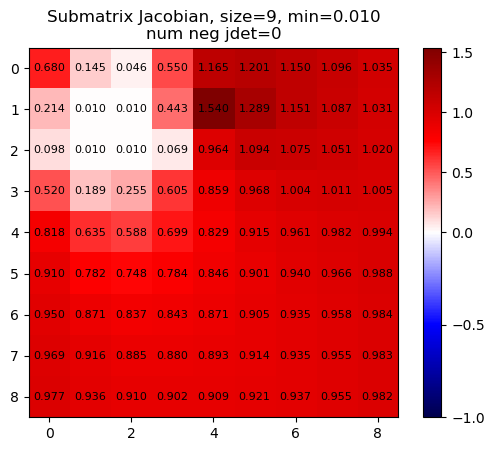

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


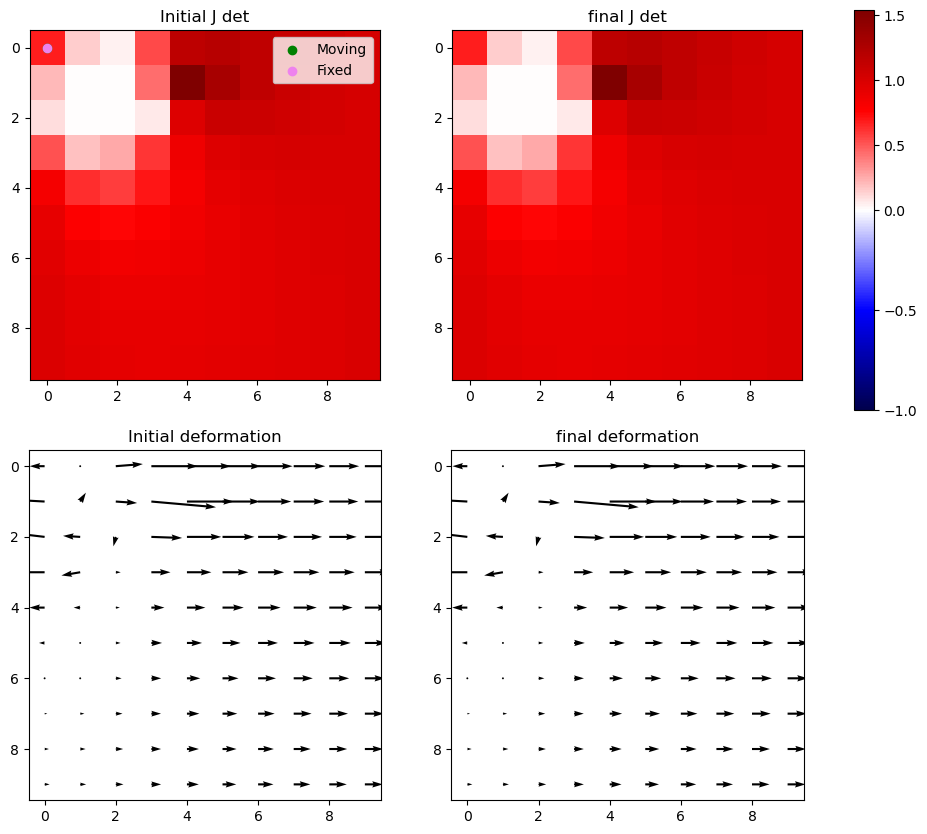

Iter 31 with 0 -ve jacs



Iter 32: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


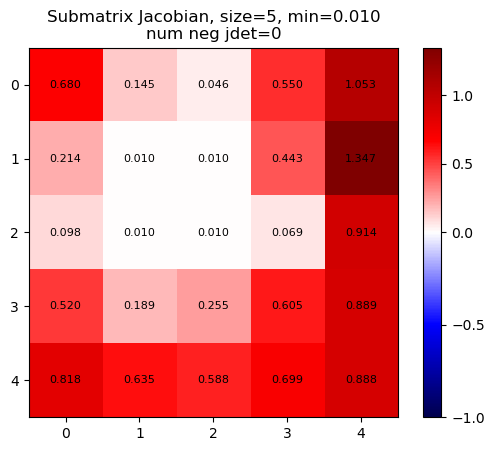

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


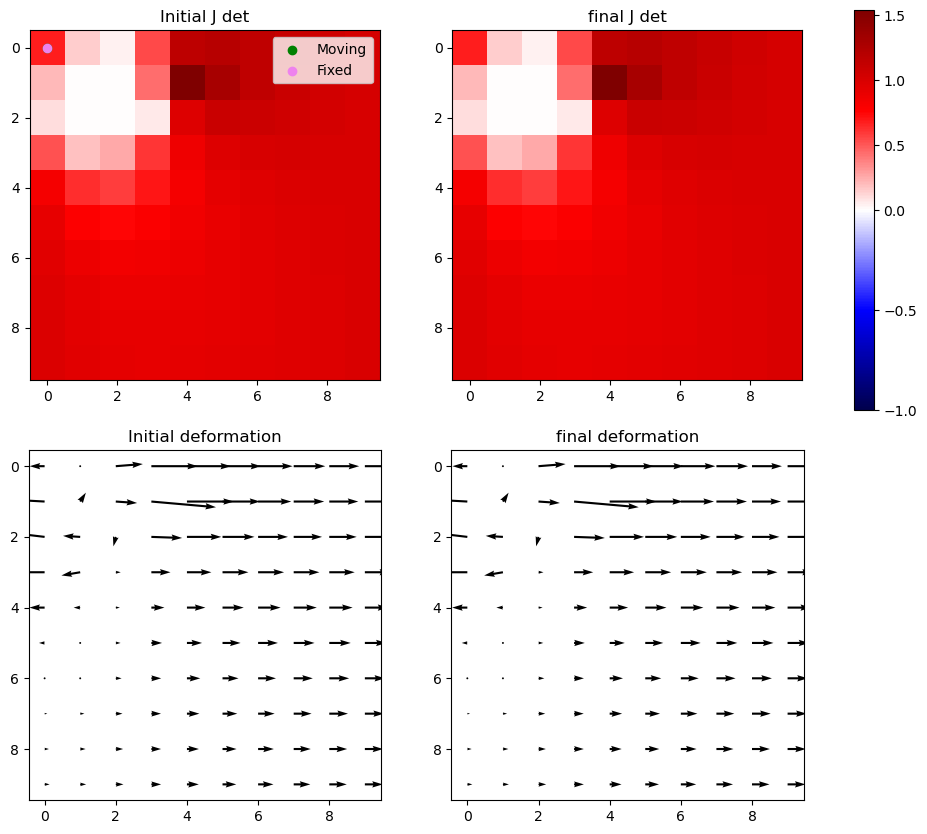

Iter 32: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


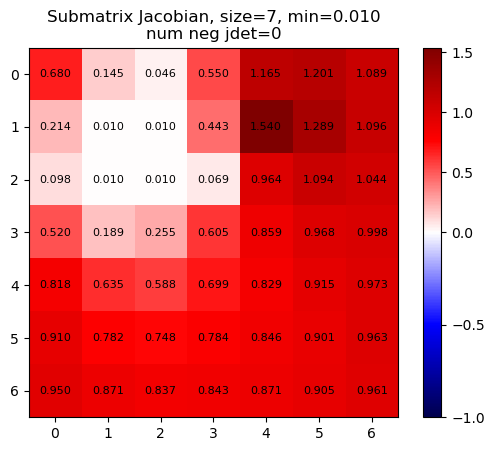

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


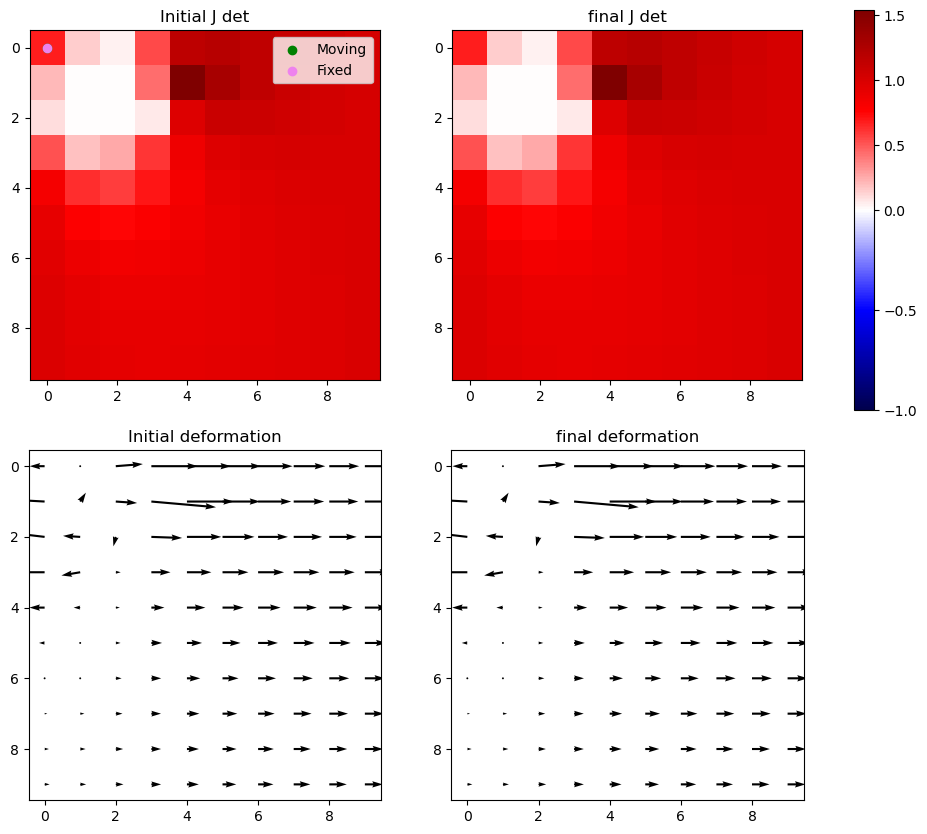

Iter 32: For index (2, 1), window size increased to 9 at iter 3


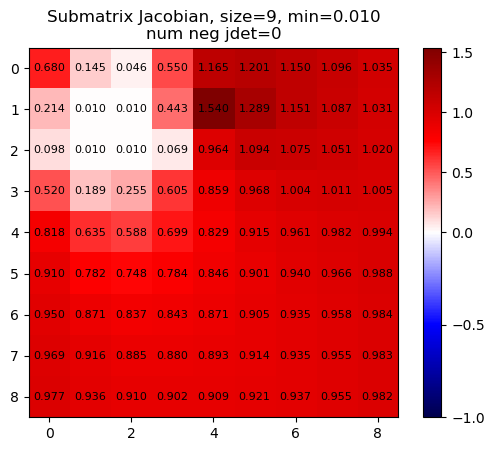

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


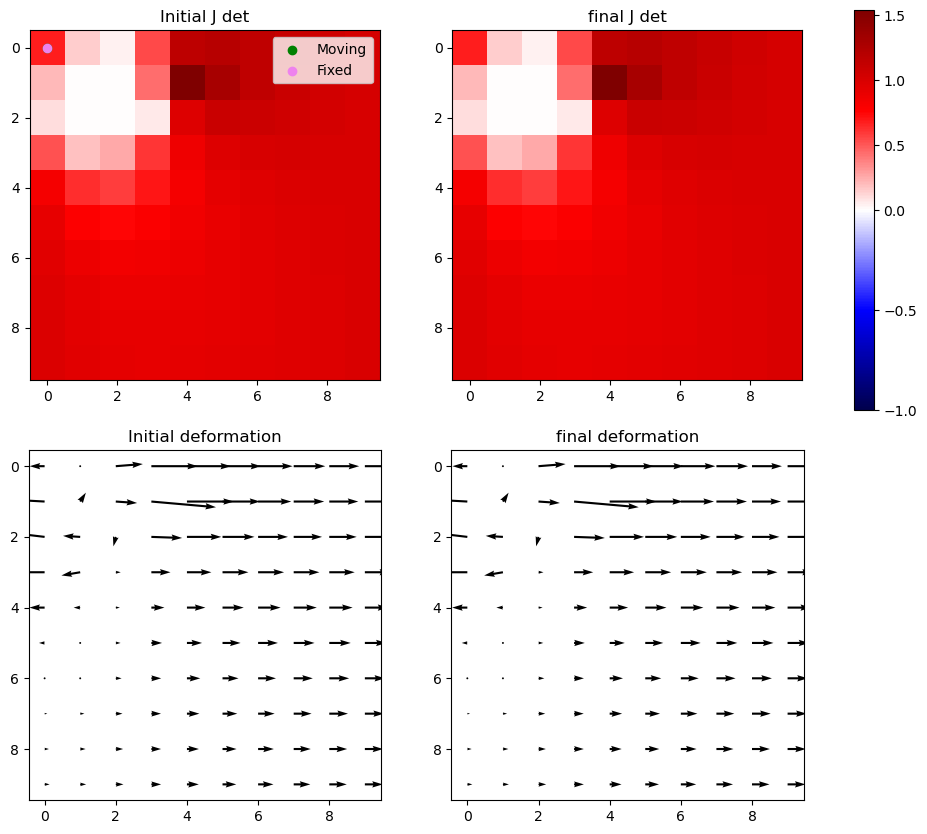

Iter 32 with 0 -ve jacs



Iter 33: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


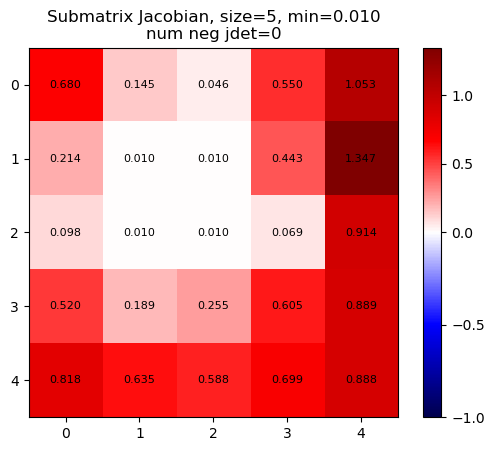

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


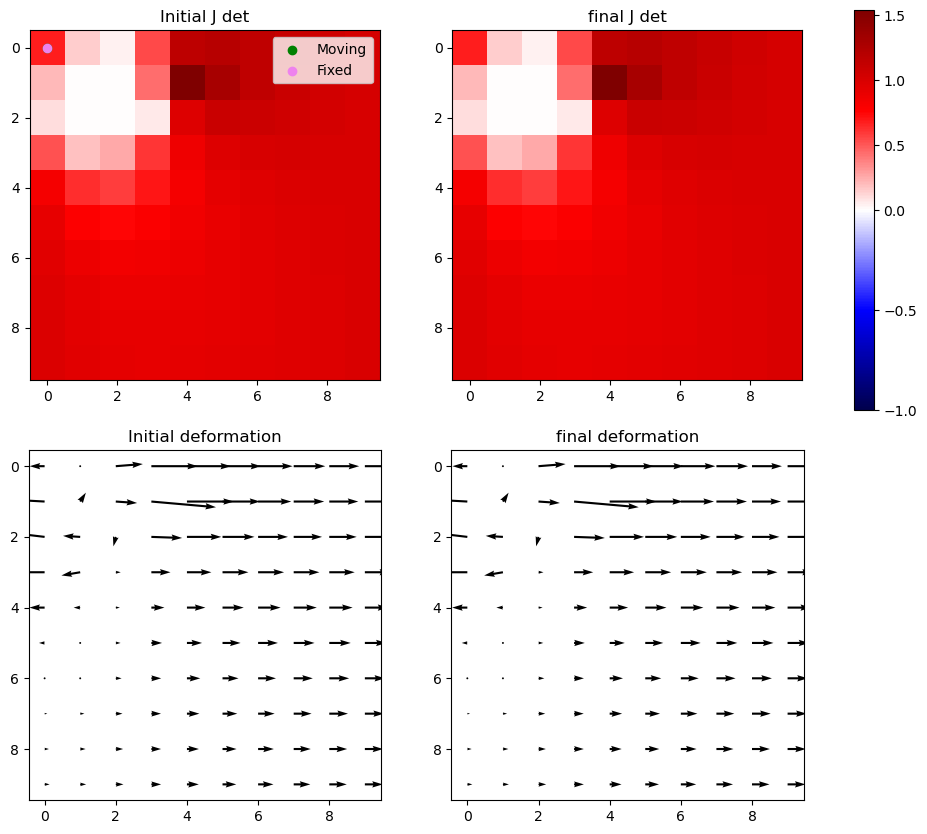

Iter 33: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


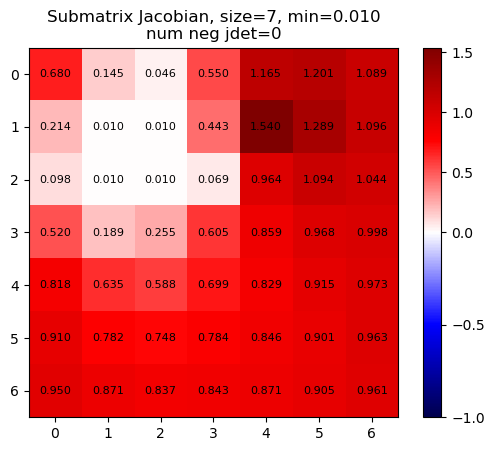

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


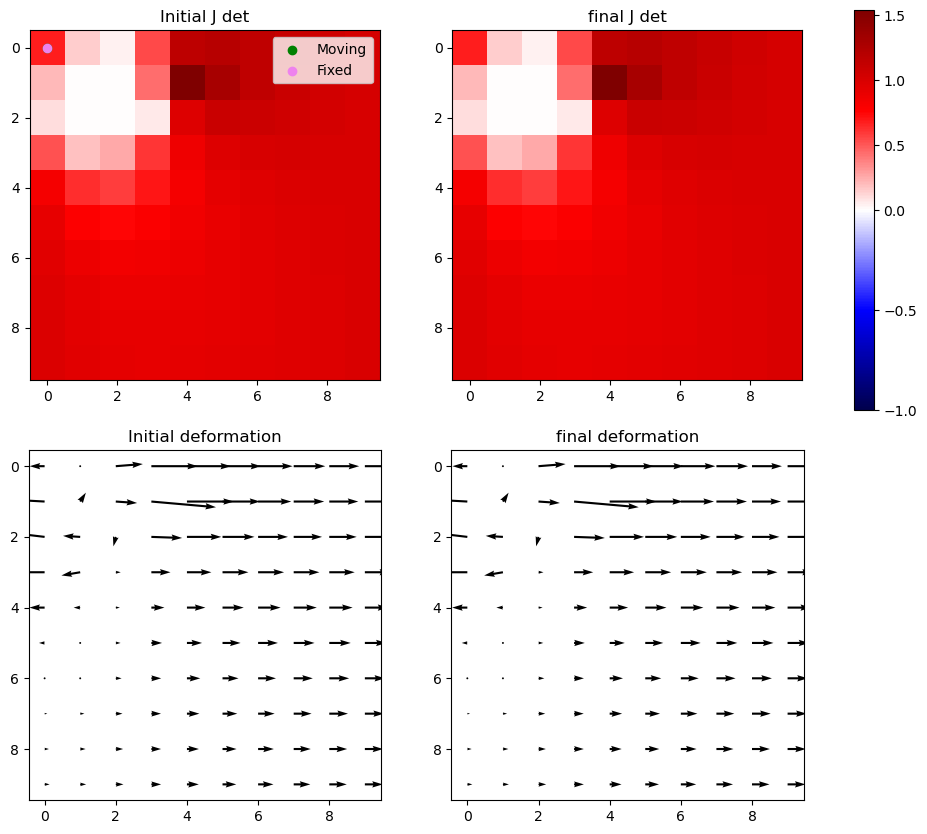

Iter 33: For index (2, 1), window size increased to 9 at iter 3


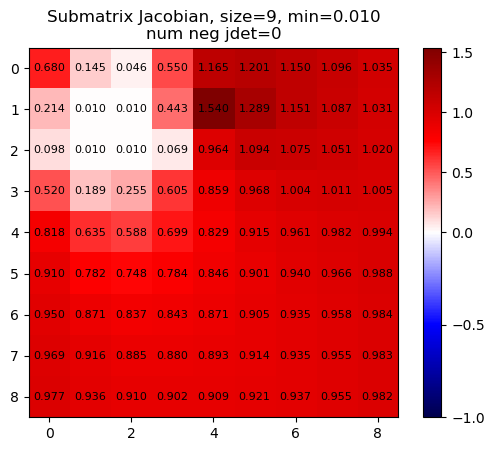

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


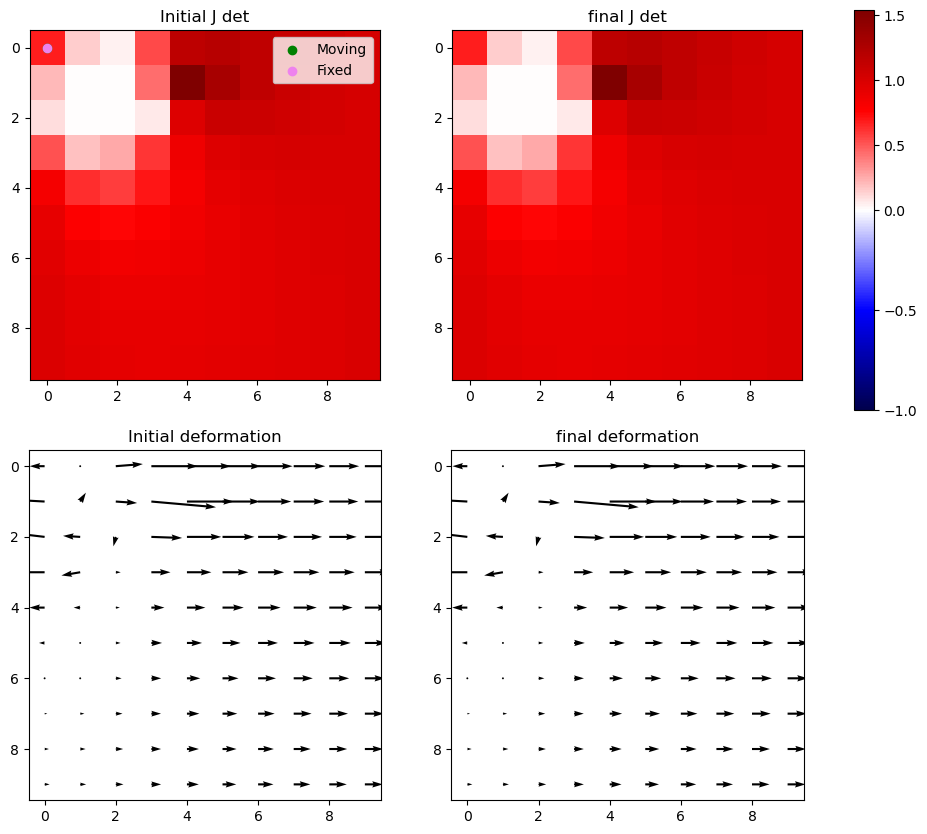

Iter 33 with 0 -ve jacs



Iter 34: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


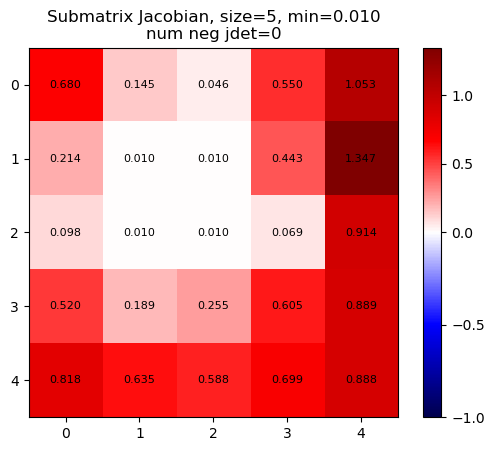

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


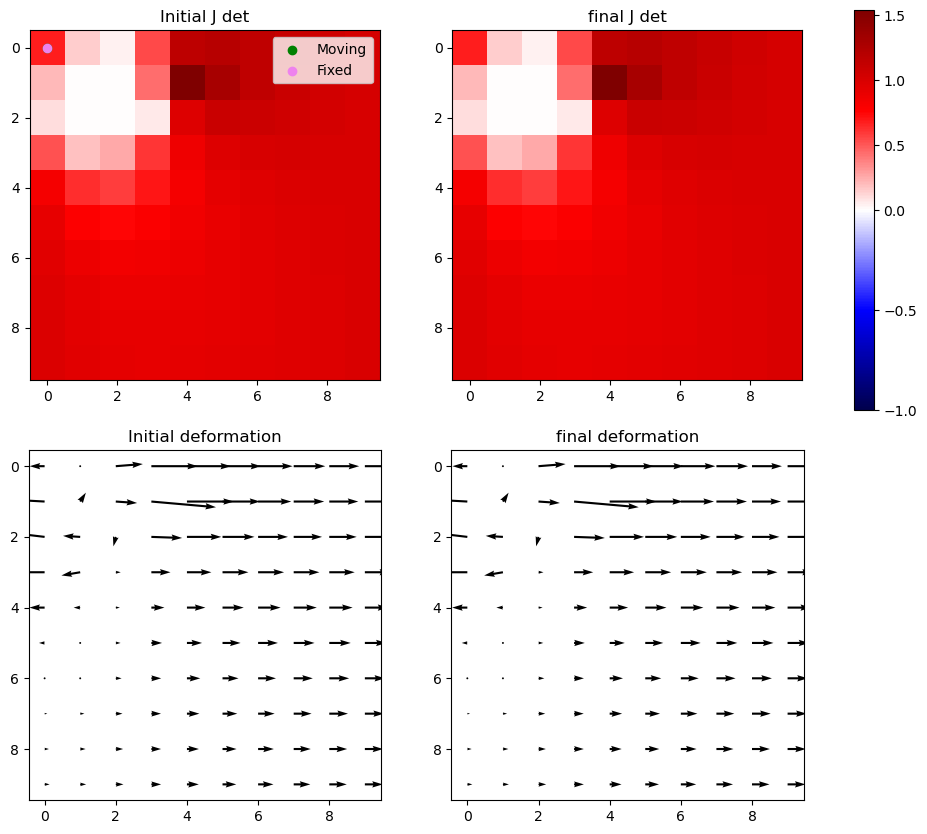

Iter 34: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


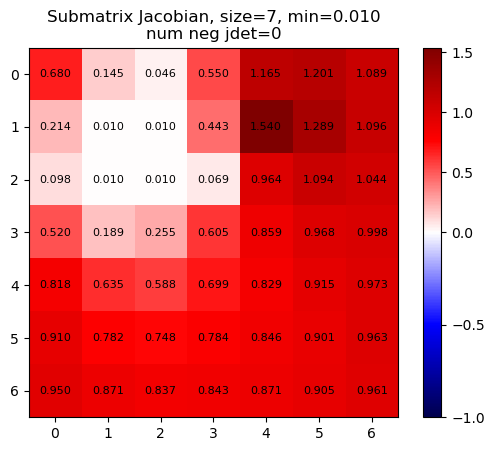

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


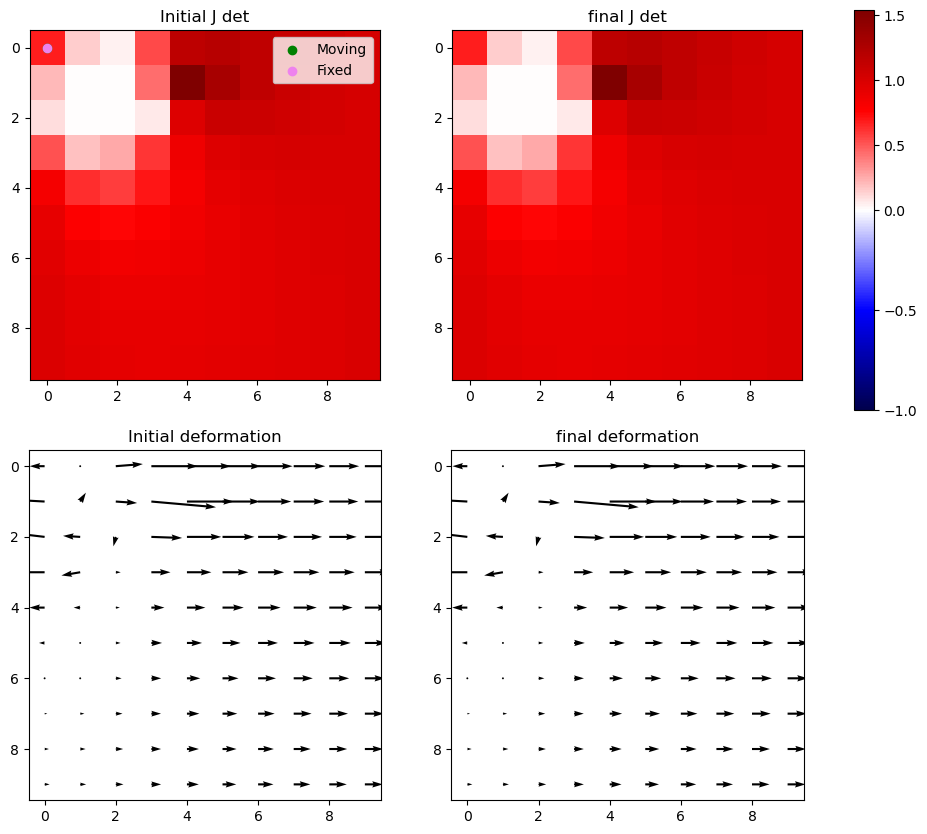

Iter 34: For index (2, 1), window size increased to 9 at iter 3


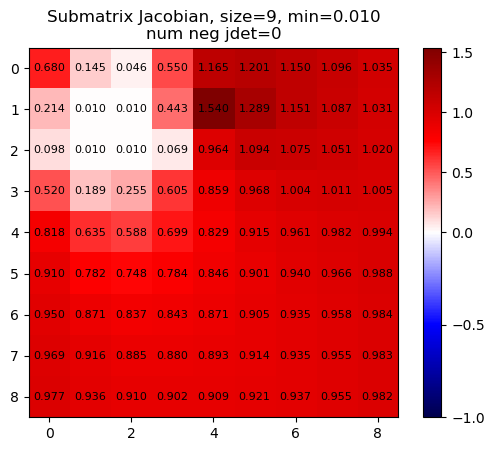

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


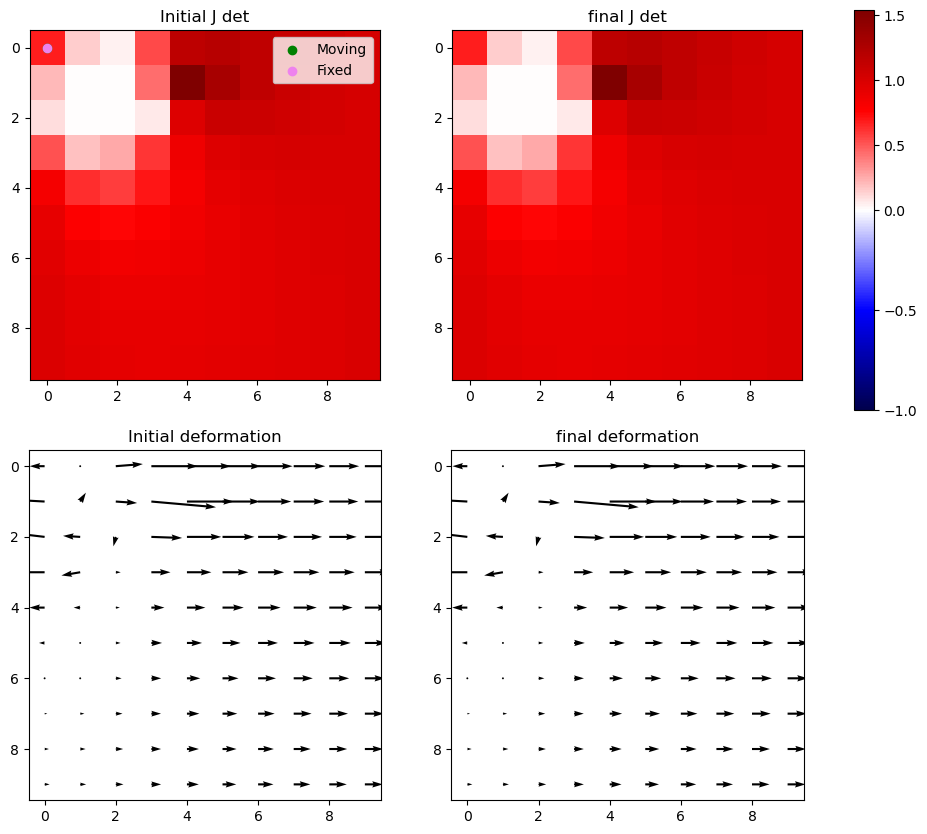

Iter 34 with 0 -ve jacs



Iter 35: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


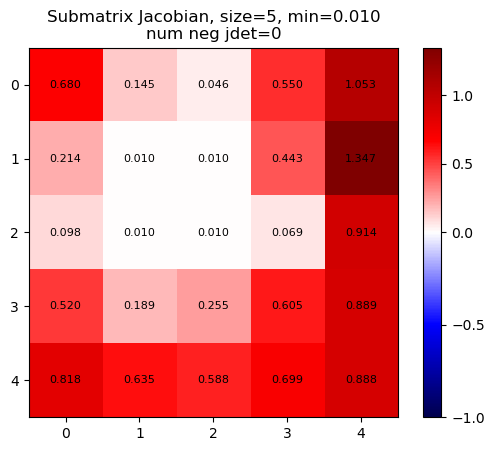

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


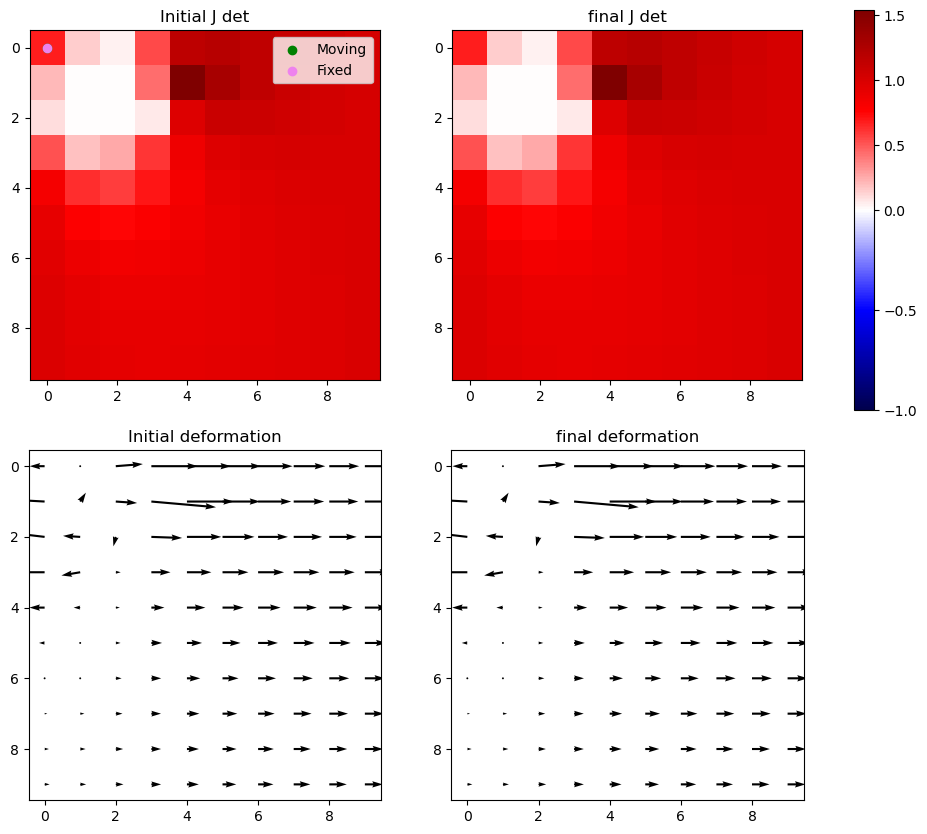

Iter 35: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


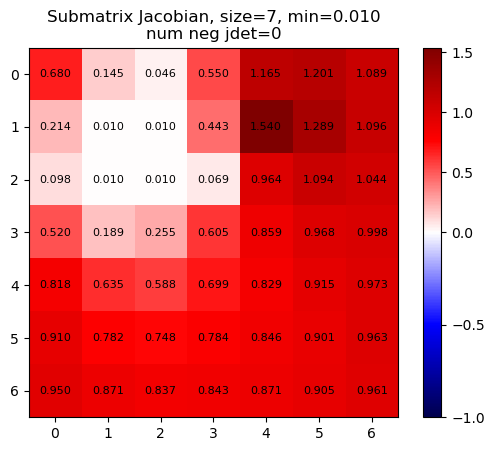

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


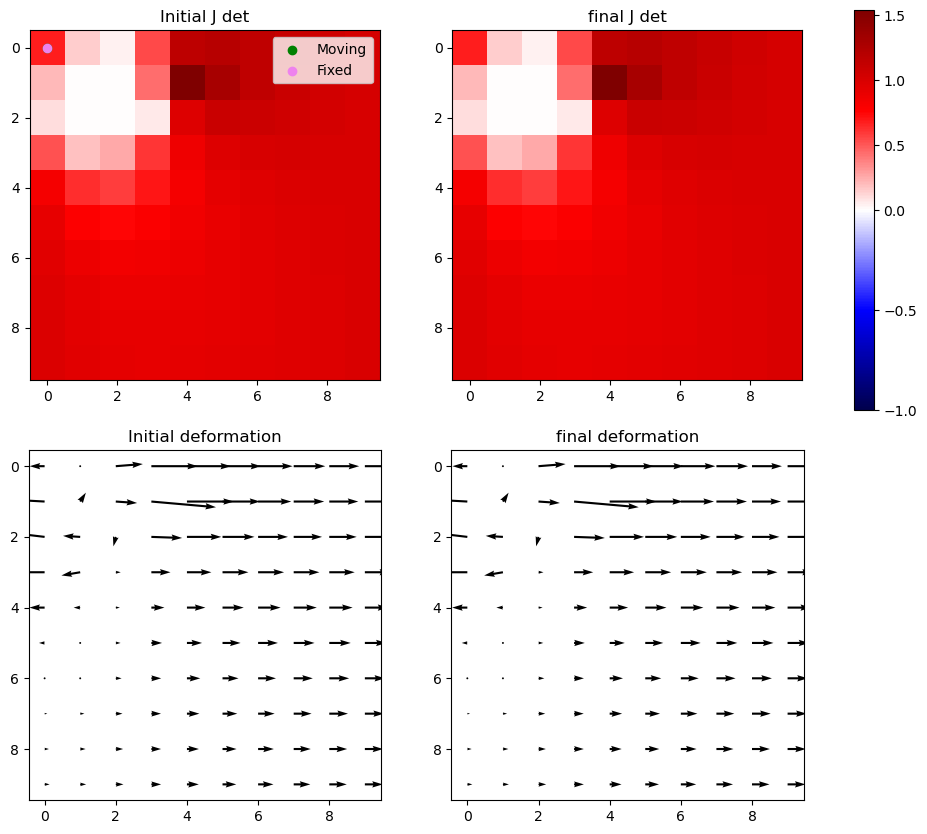

Iter 35: For index (2, 1), window size increased to 9 at iter 3


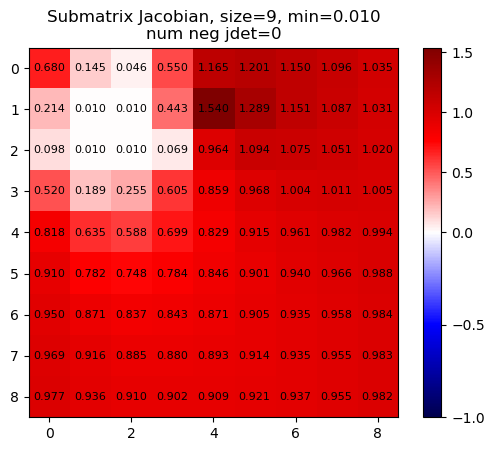

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


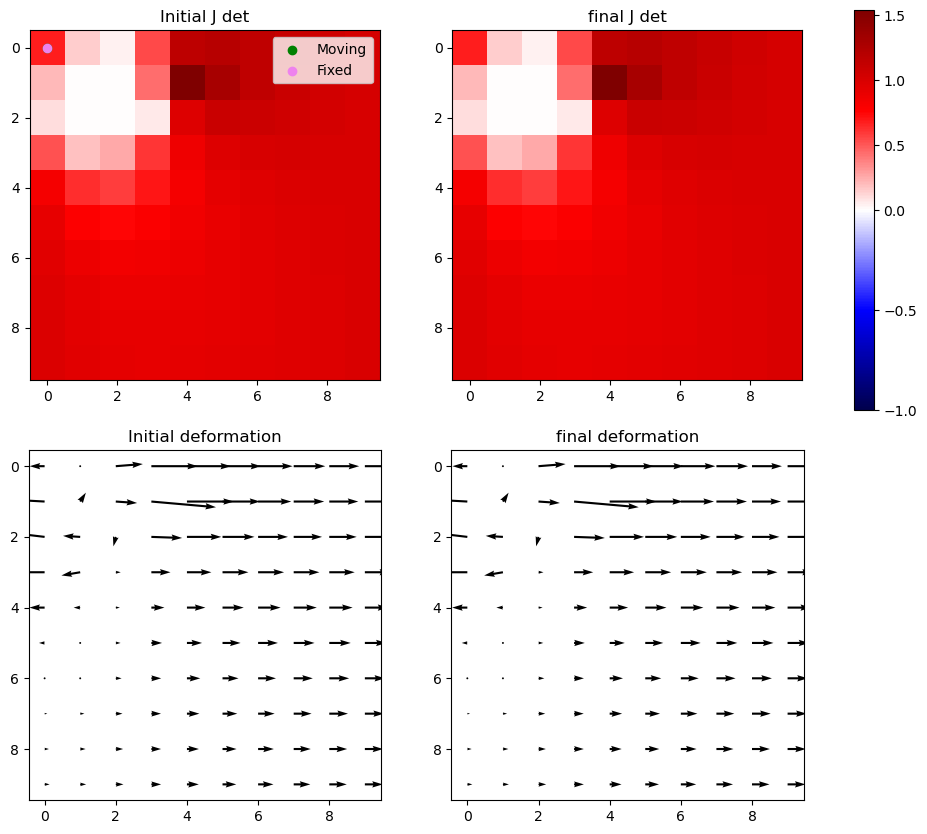

Iter 35 with 0 -ve jacs



Iter 36: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


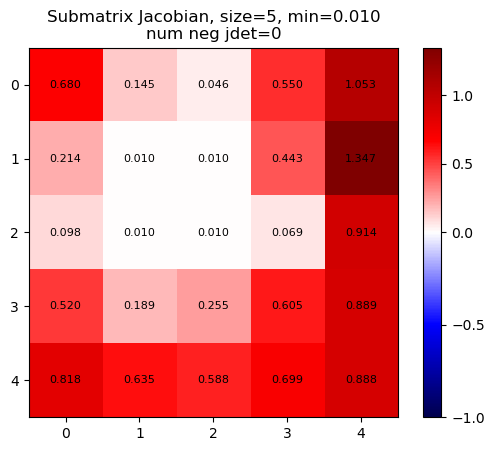

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


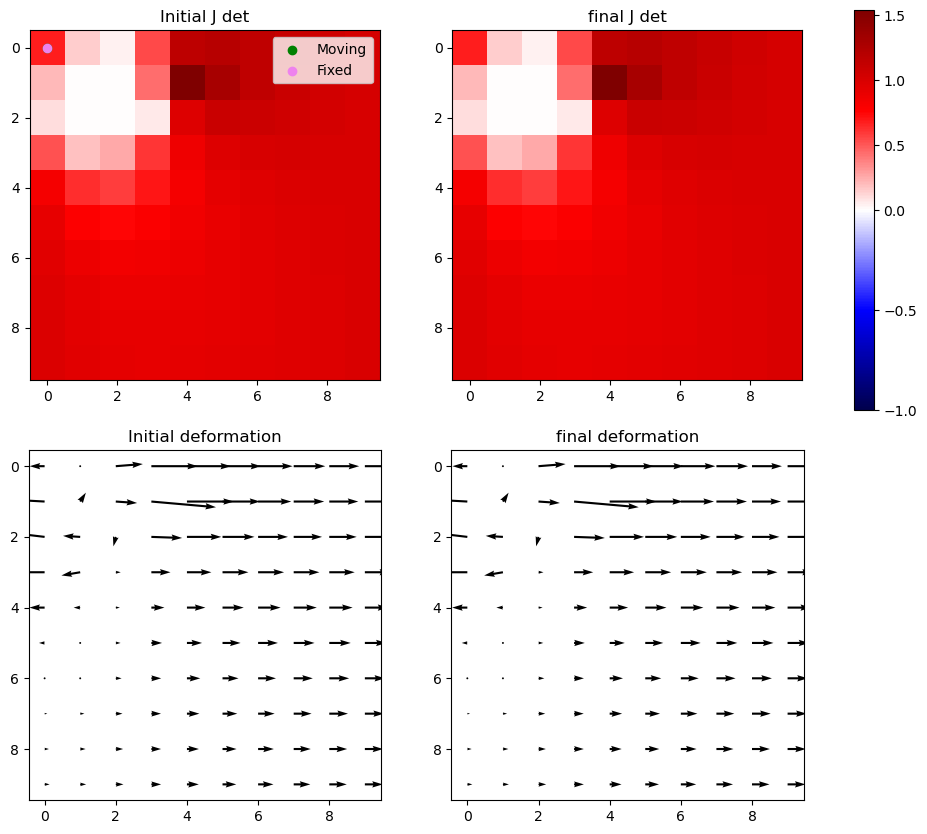

Iter 36: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


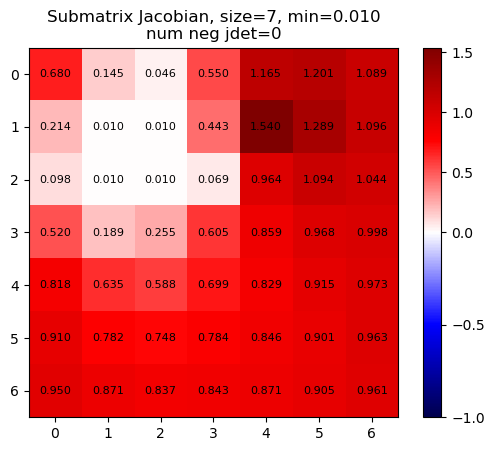

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


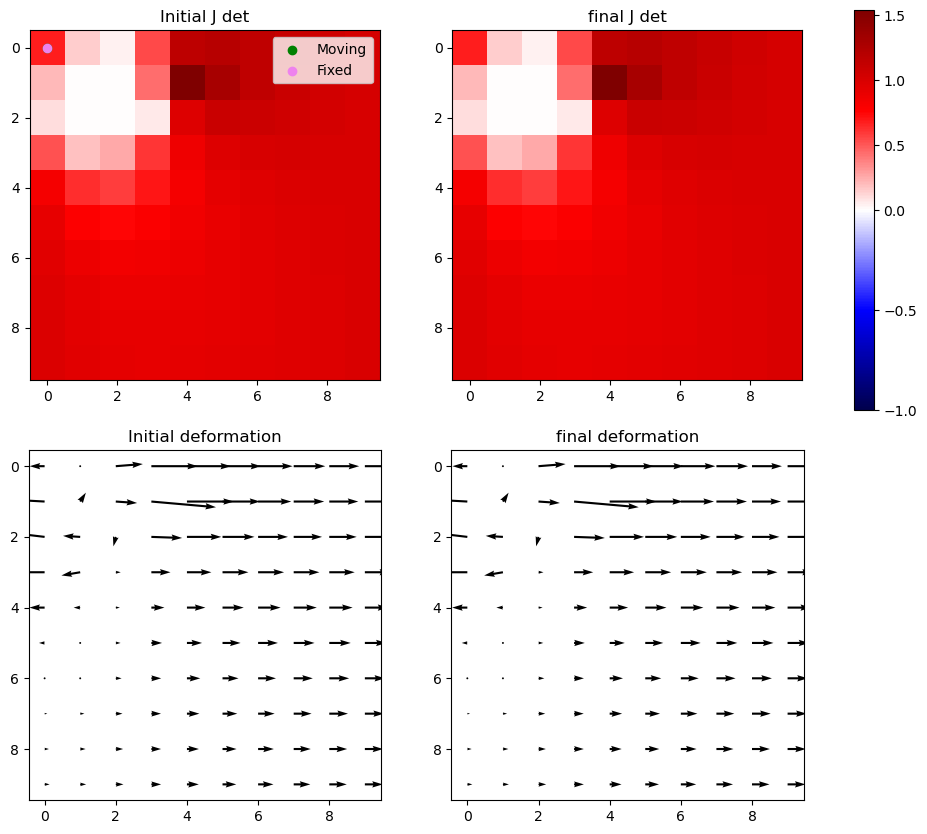

Iter 36: For index (2, 1), window size increased to 9 at iter 3


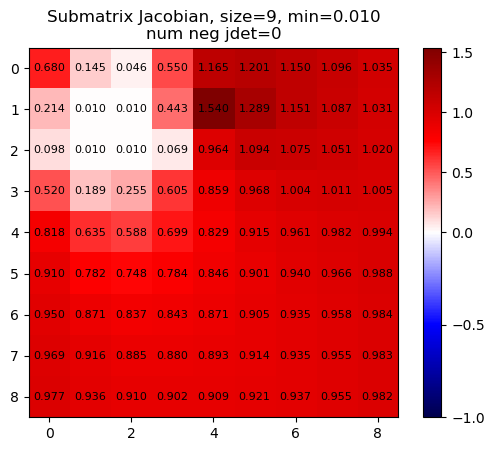

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


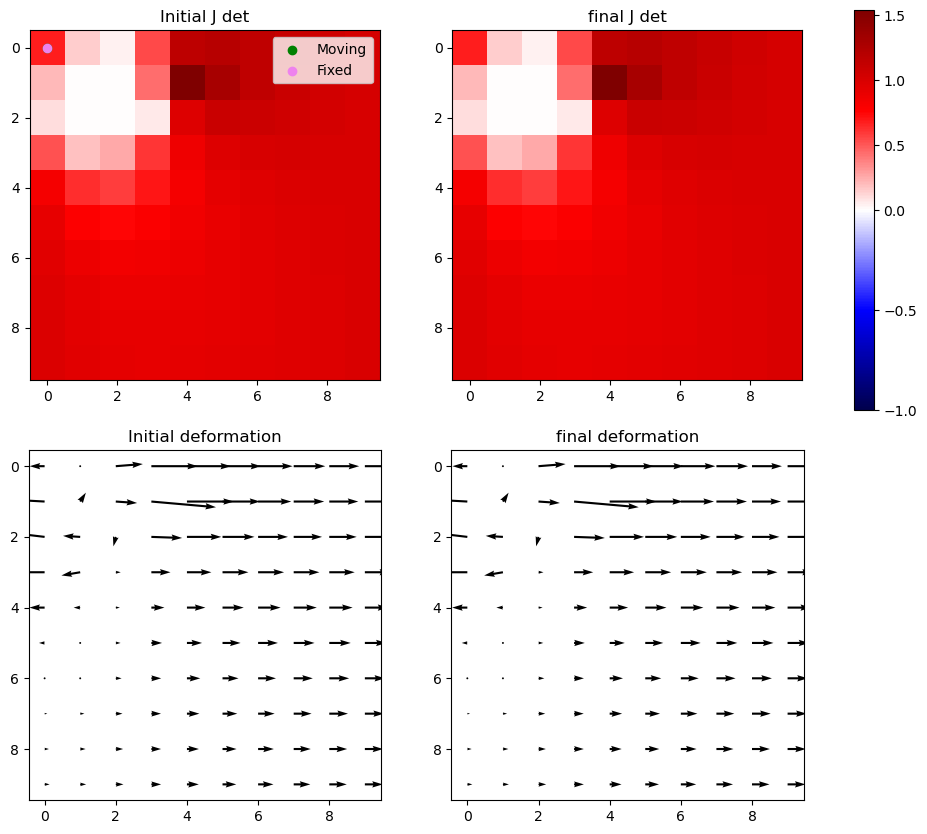

Iter 36 with 0 -ve jacs



Iter 37: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


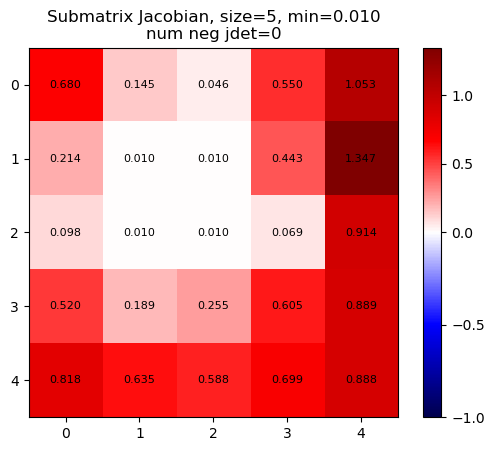

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


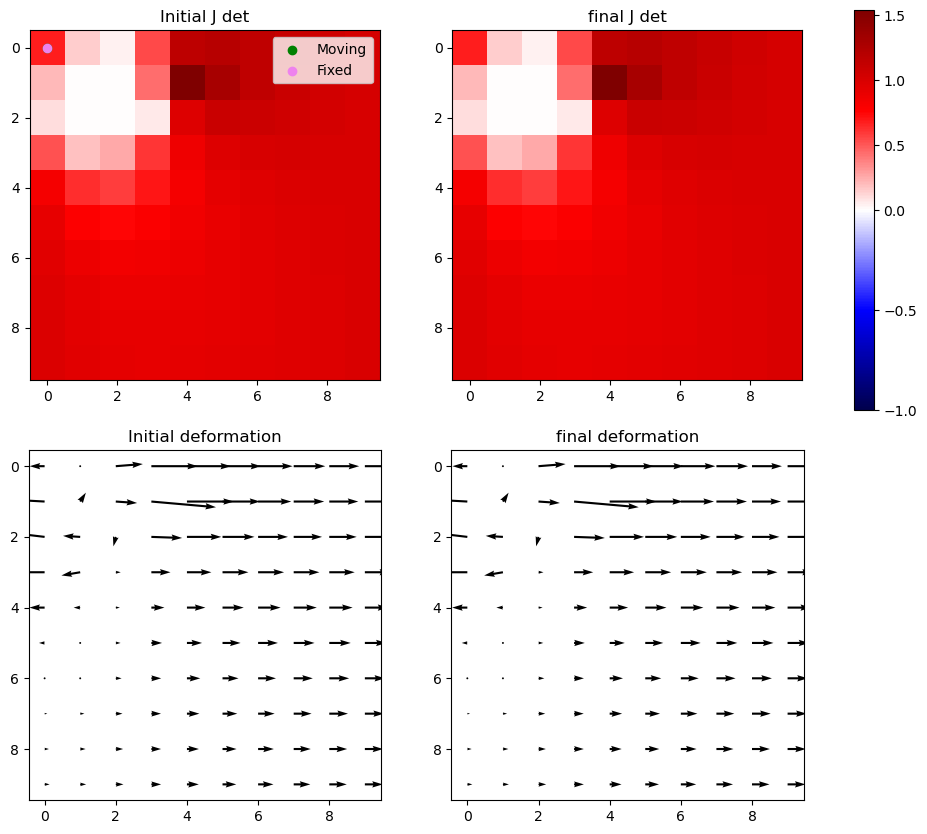

Iter 37: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


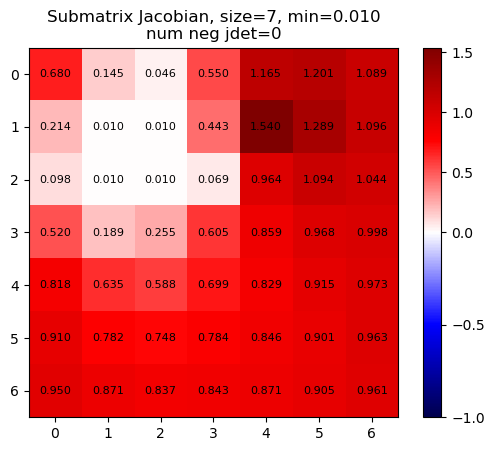

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


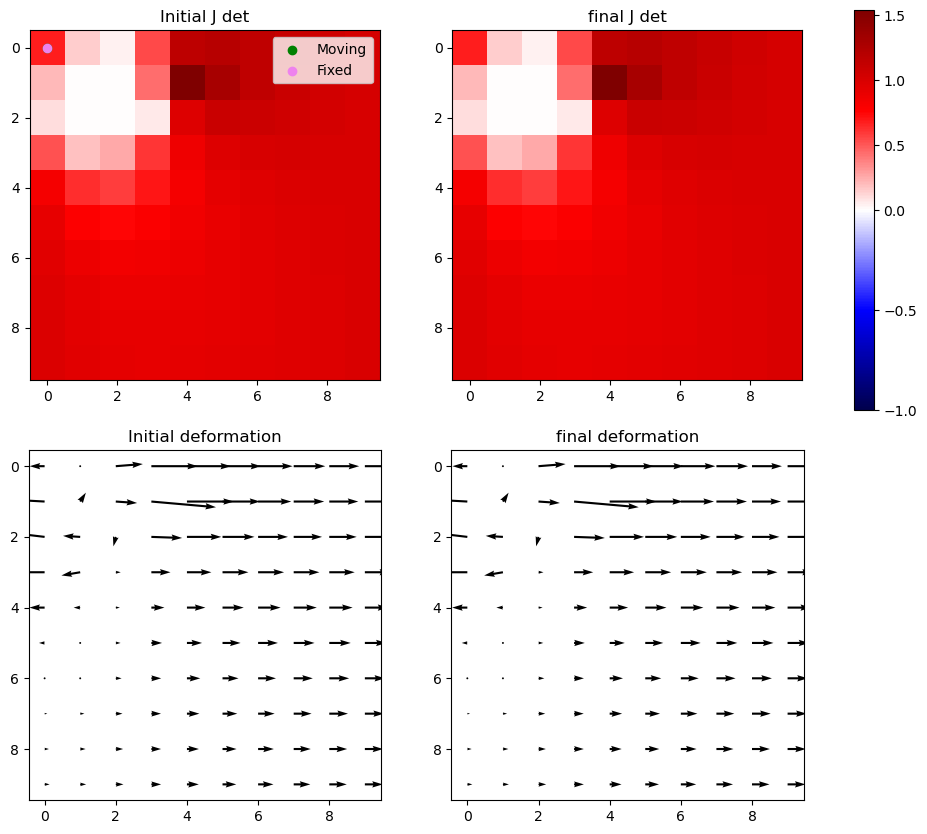

Iter 37: For index (2, 1), window size increased to 9 at iter 3


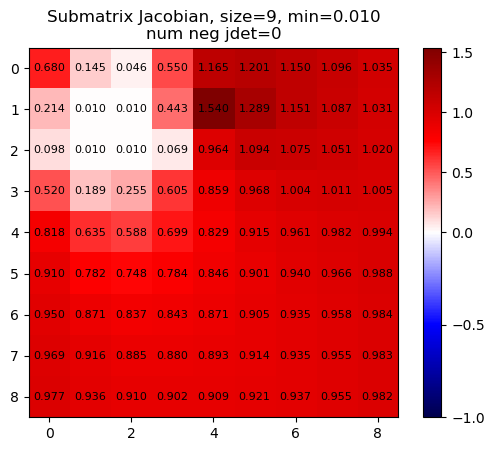

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


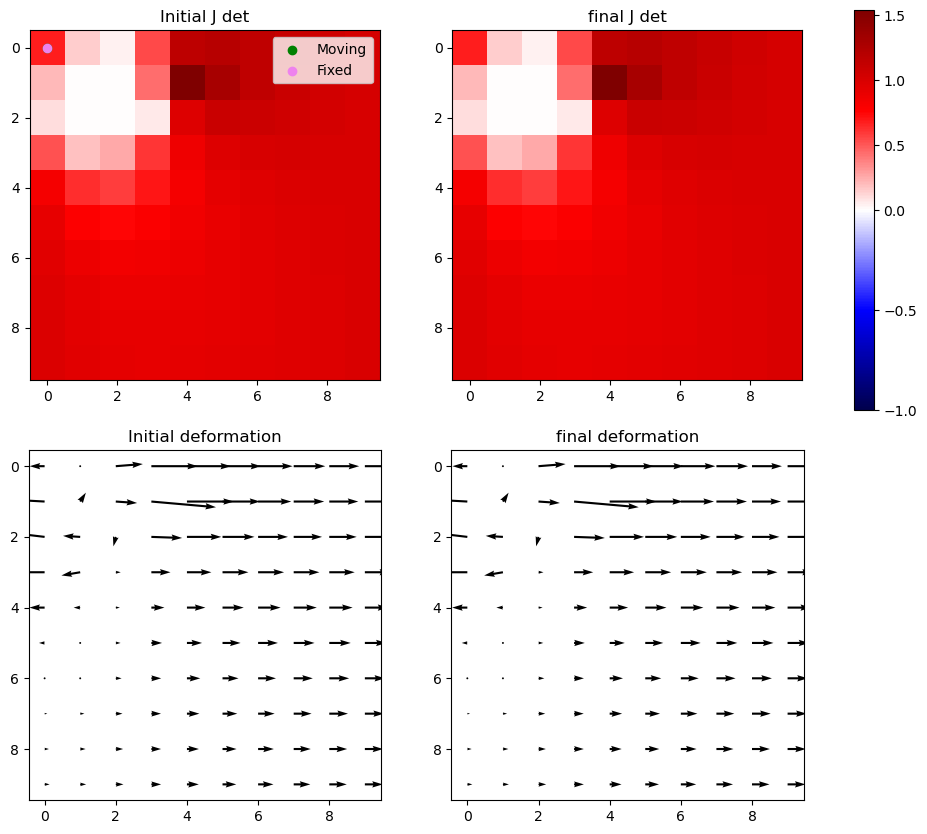

Iter 37 with 0 -ve jacs



Iter 38: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


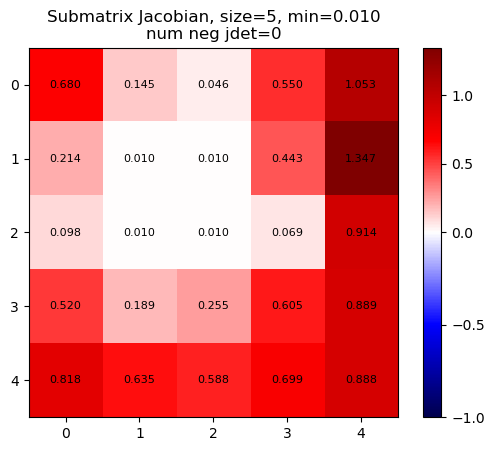

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


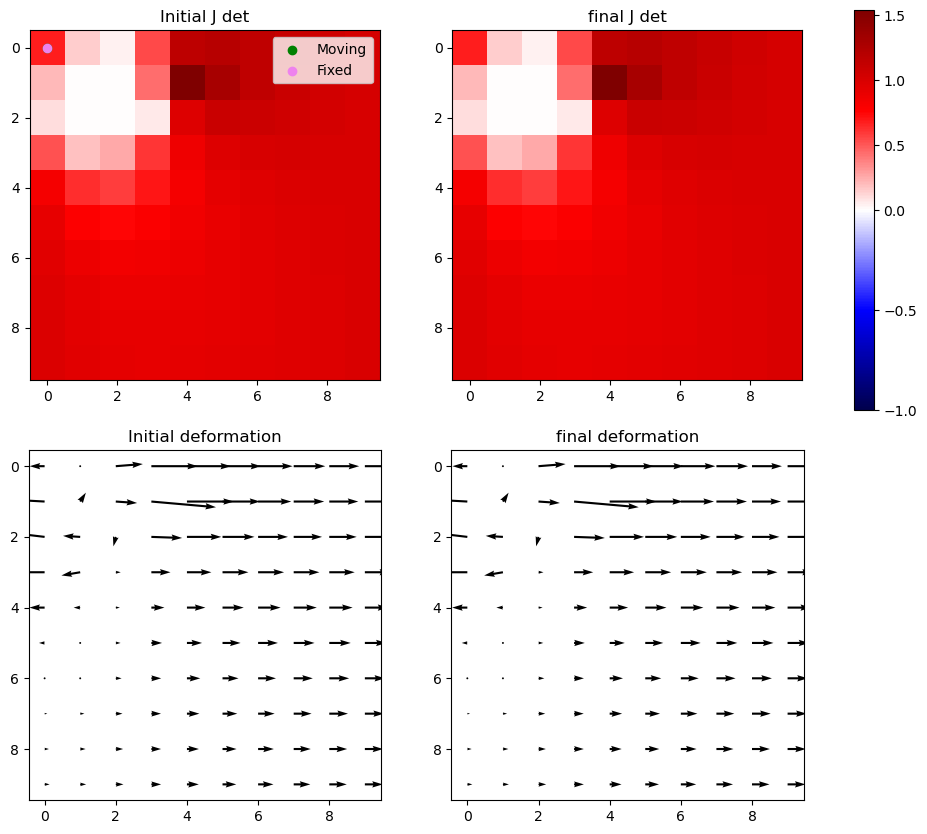

Iter 38: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


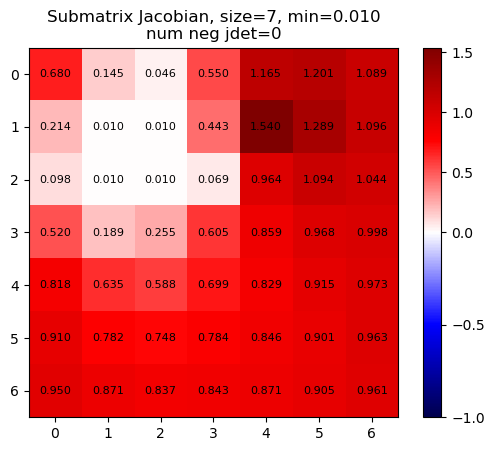

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


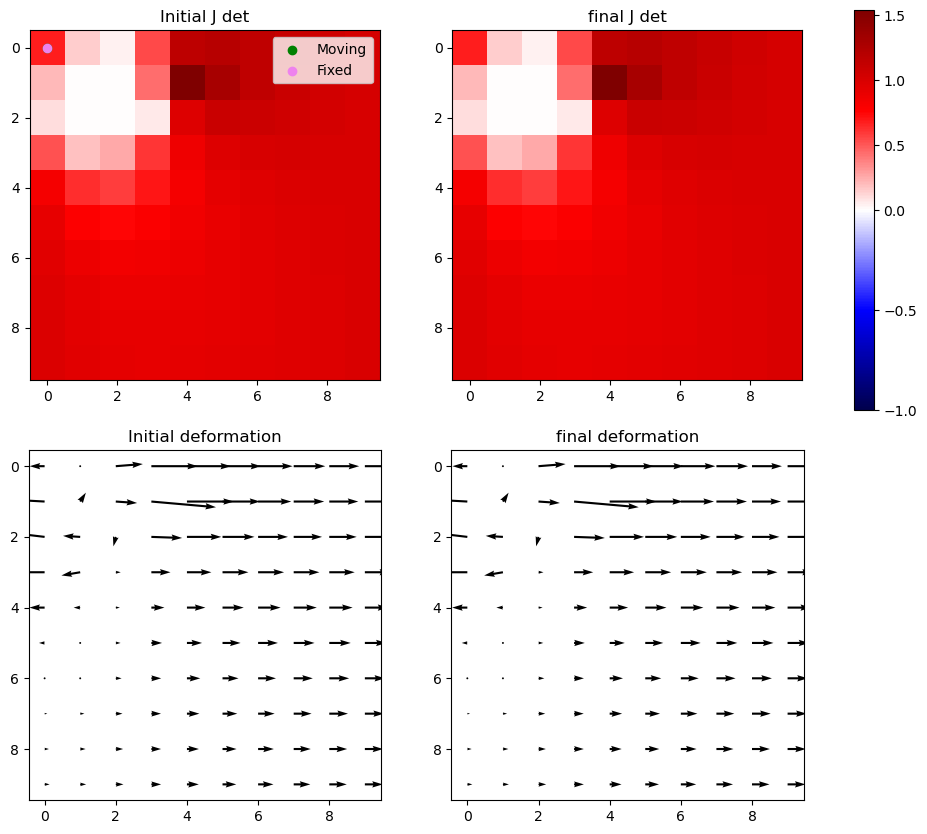

Iter 38: For index (2, 1), window size increased to 9 at iter 3


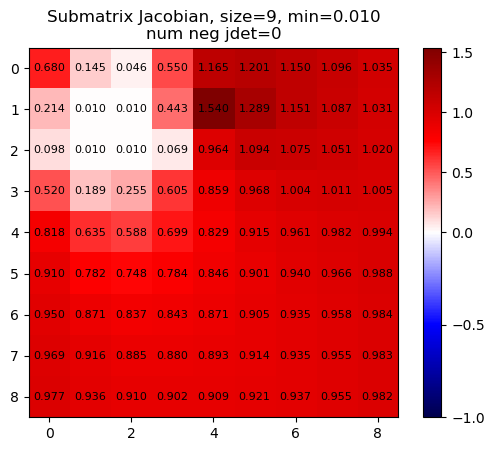

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


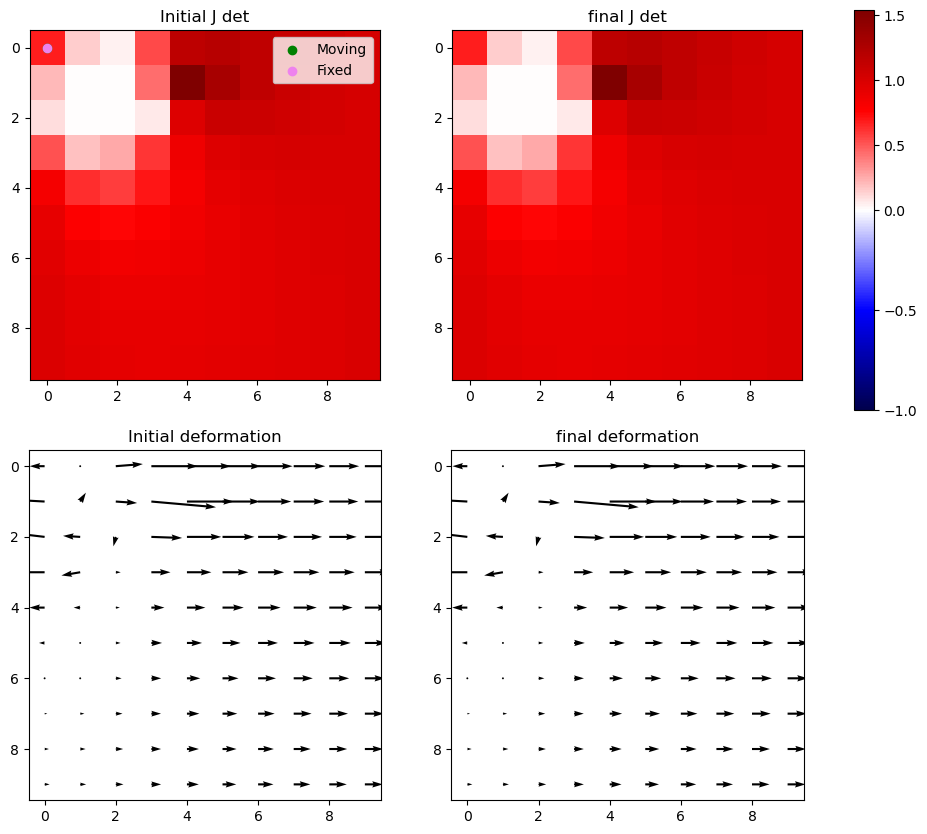

Iter 38 with 0 -ve jacs



Iter 39: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


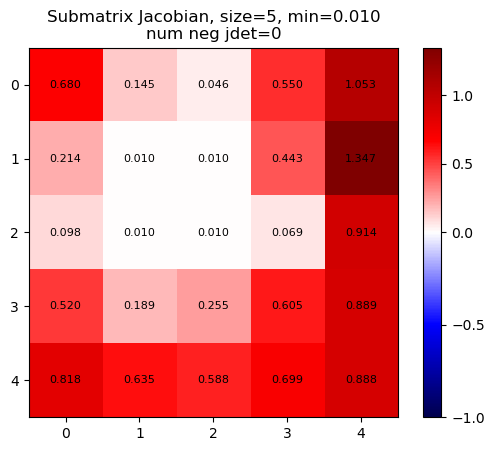

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


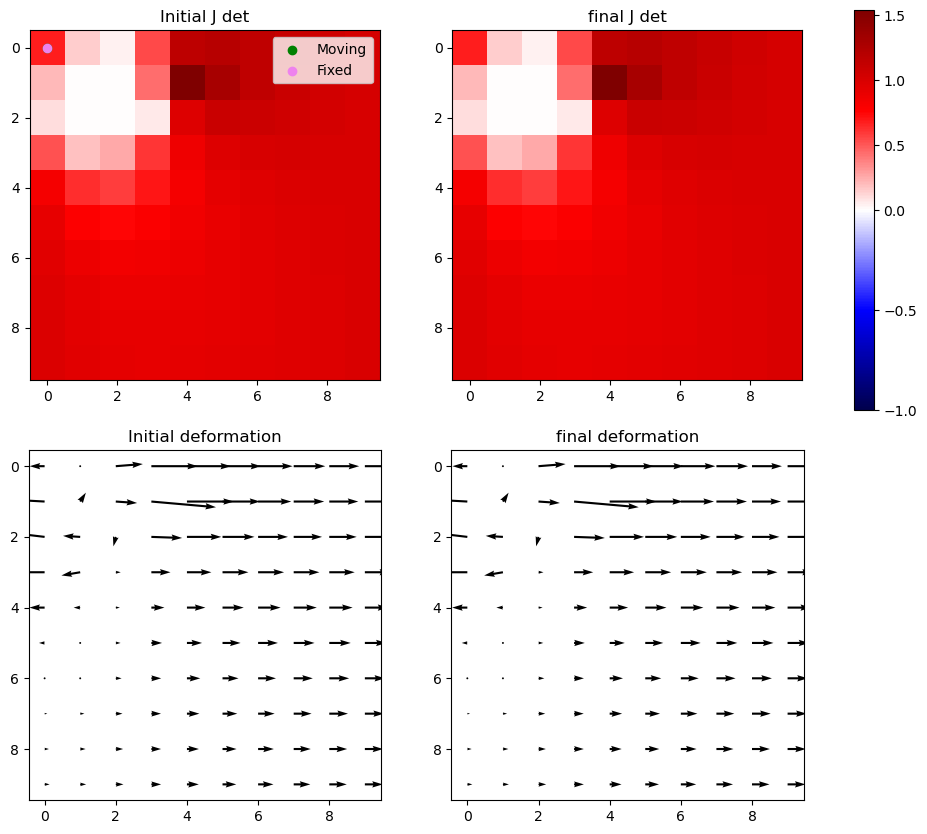

Iter 39: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


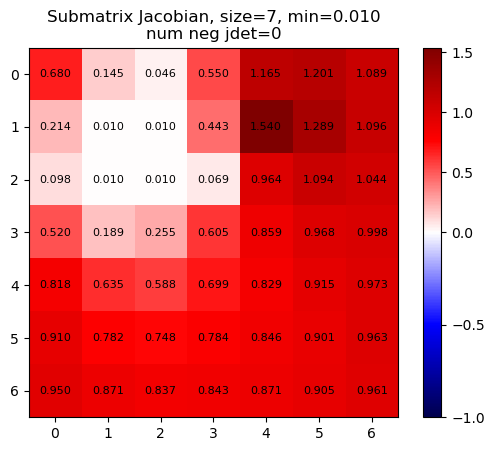

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


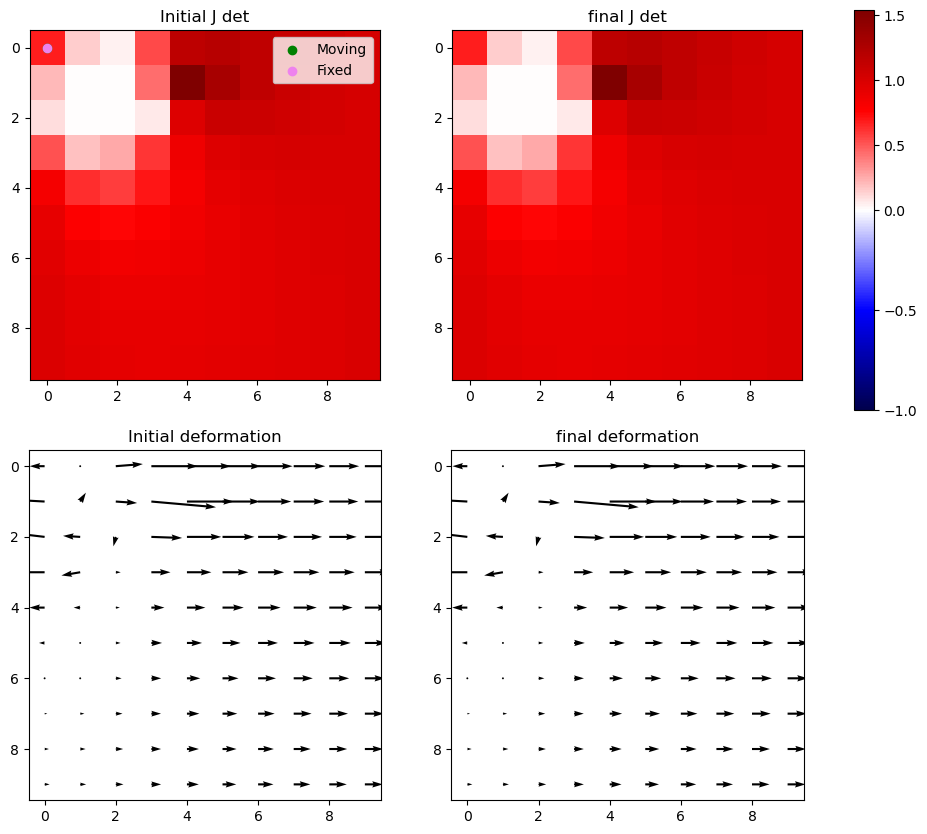

Iter 39: For index (2, 1), window size increased to 9 at iter 3


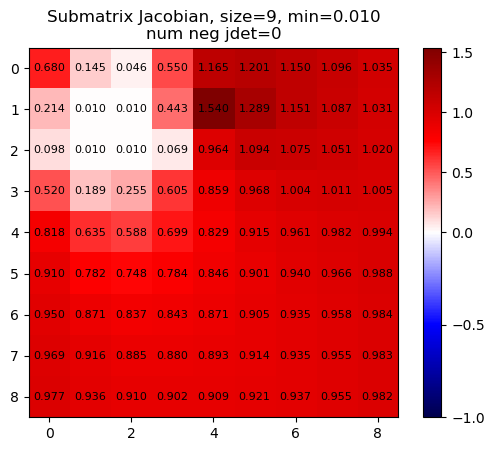

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


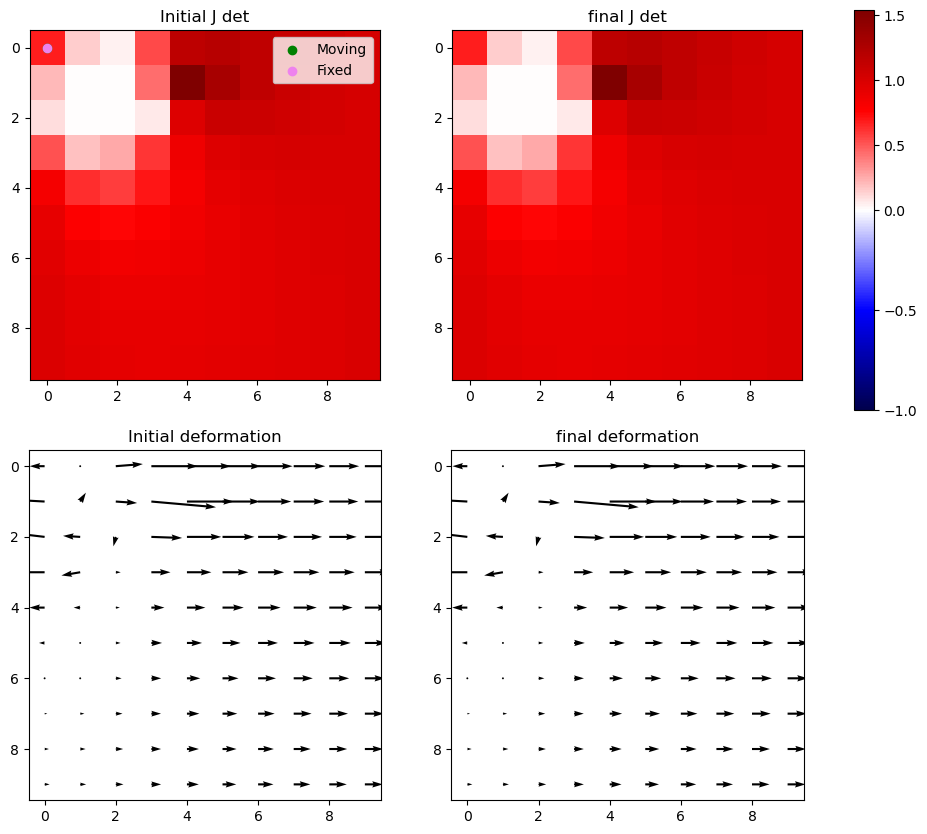

Iter 39 with 0 -ve jacs



Iter 40: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


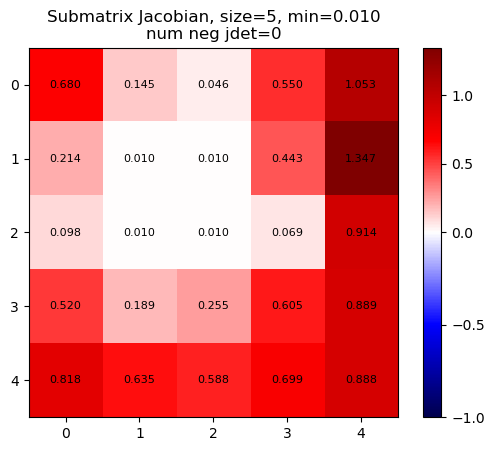

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


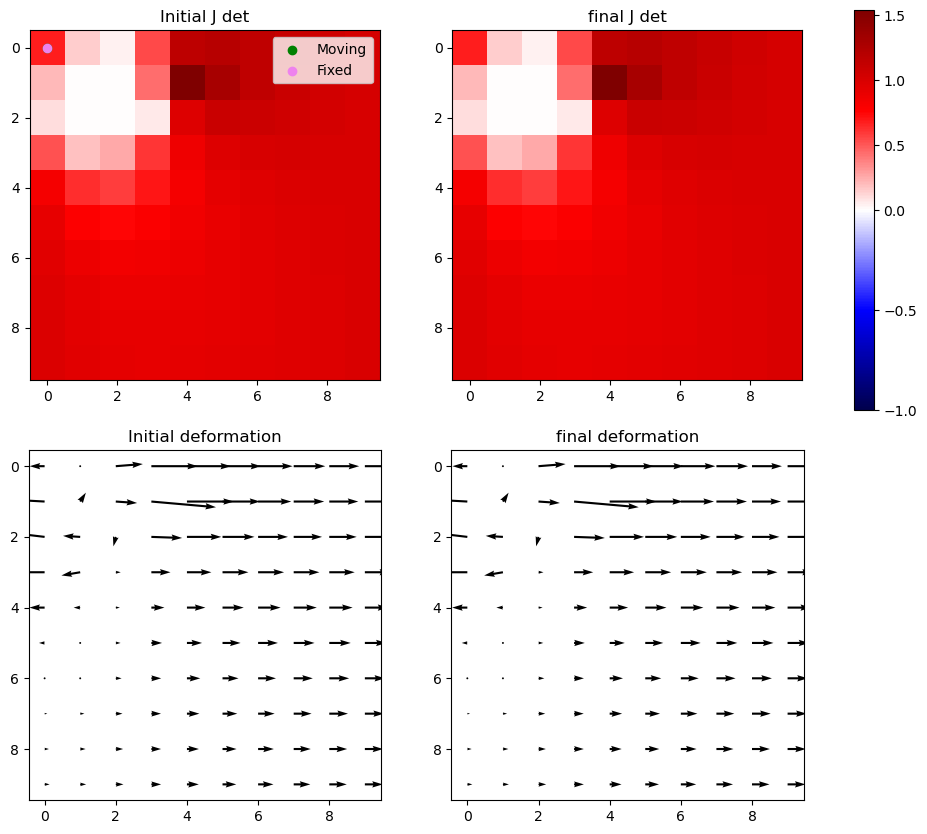

Iter 40: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


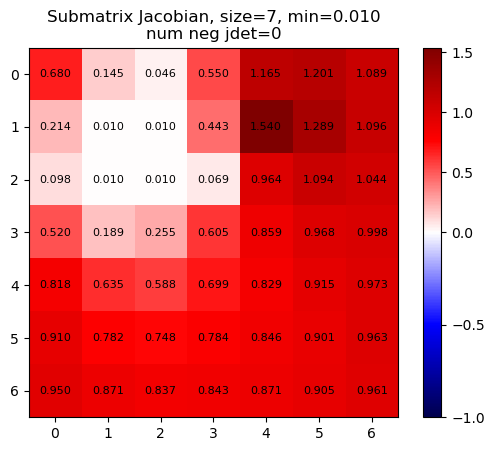

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


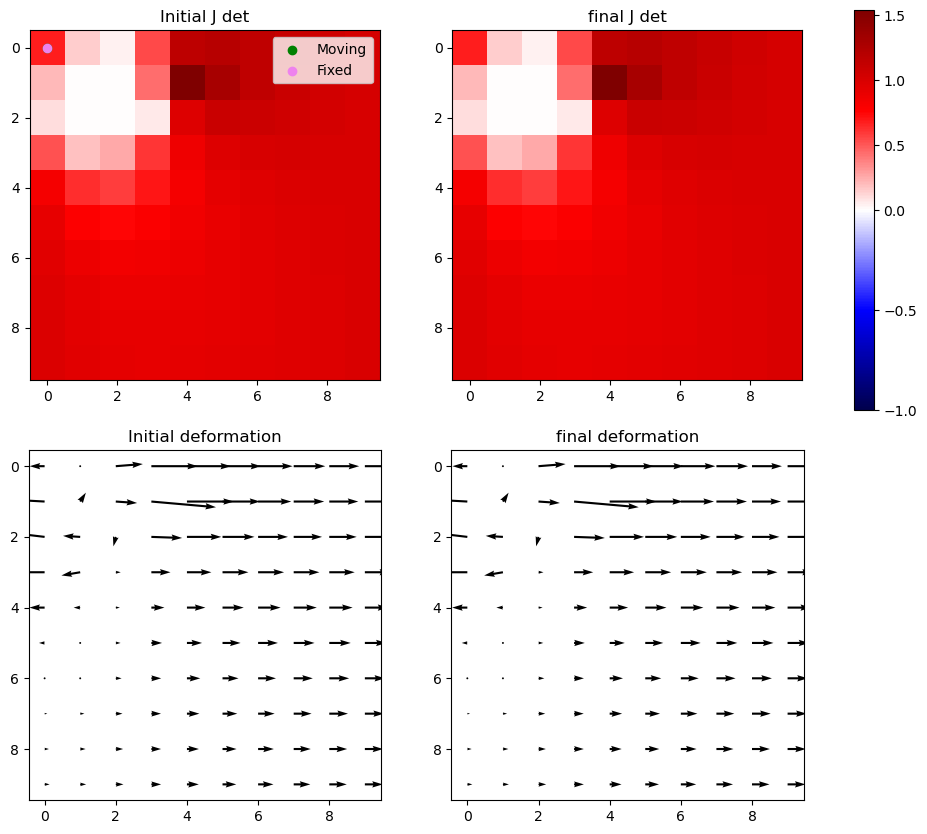

Iter 40: For index (2, 1), window size increased to 9 at iter 3


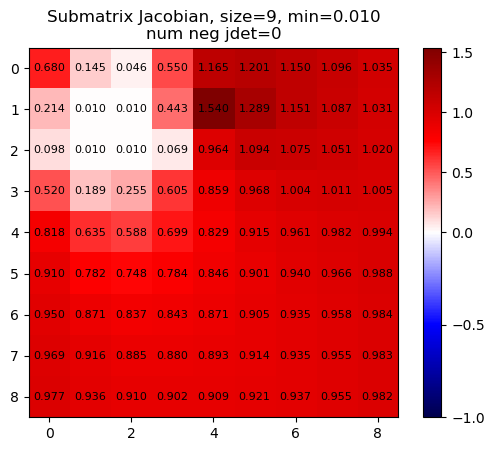

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


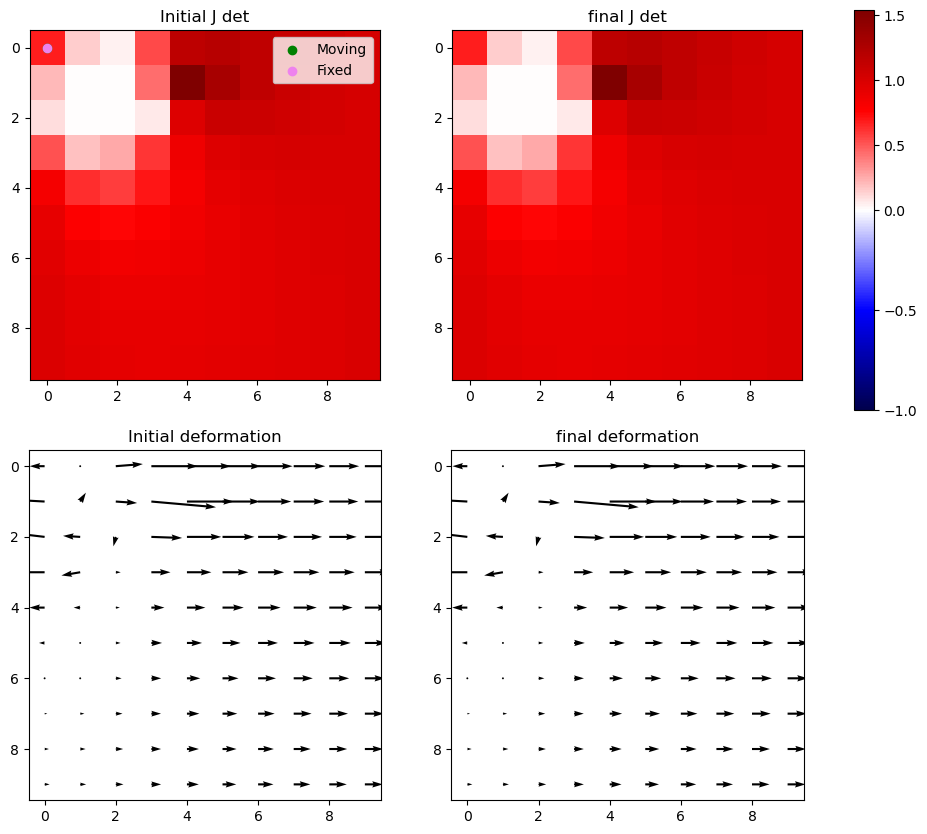

Iter 40 with 0 -ve jacs



Iter 41: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


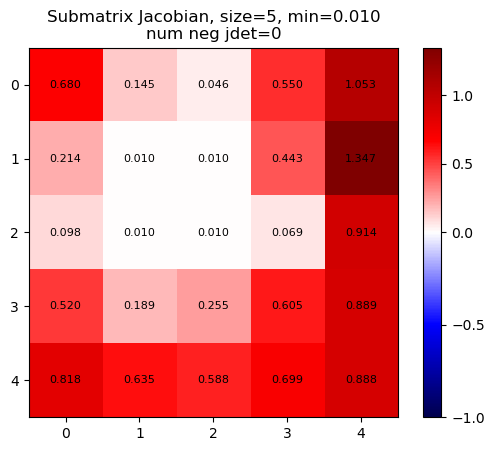

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


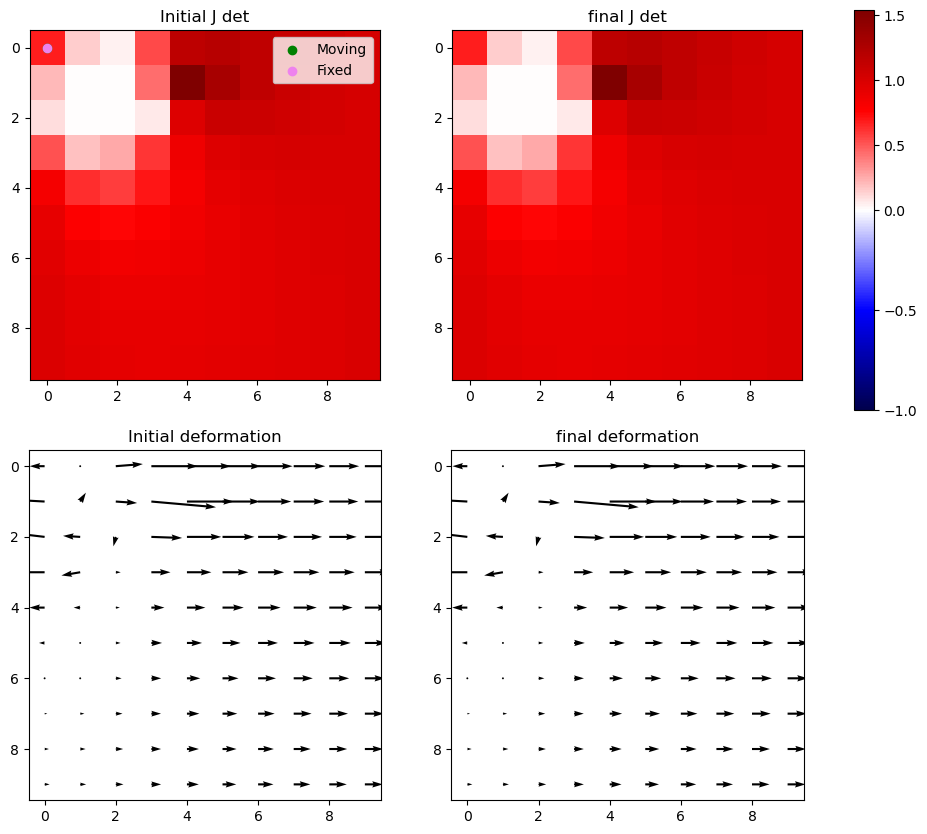

Iter 41: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


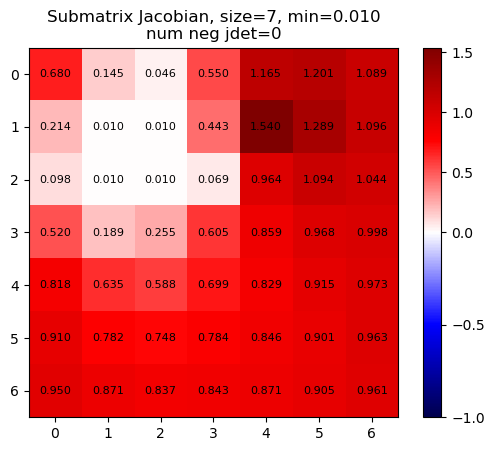

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


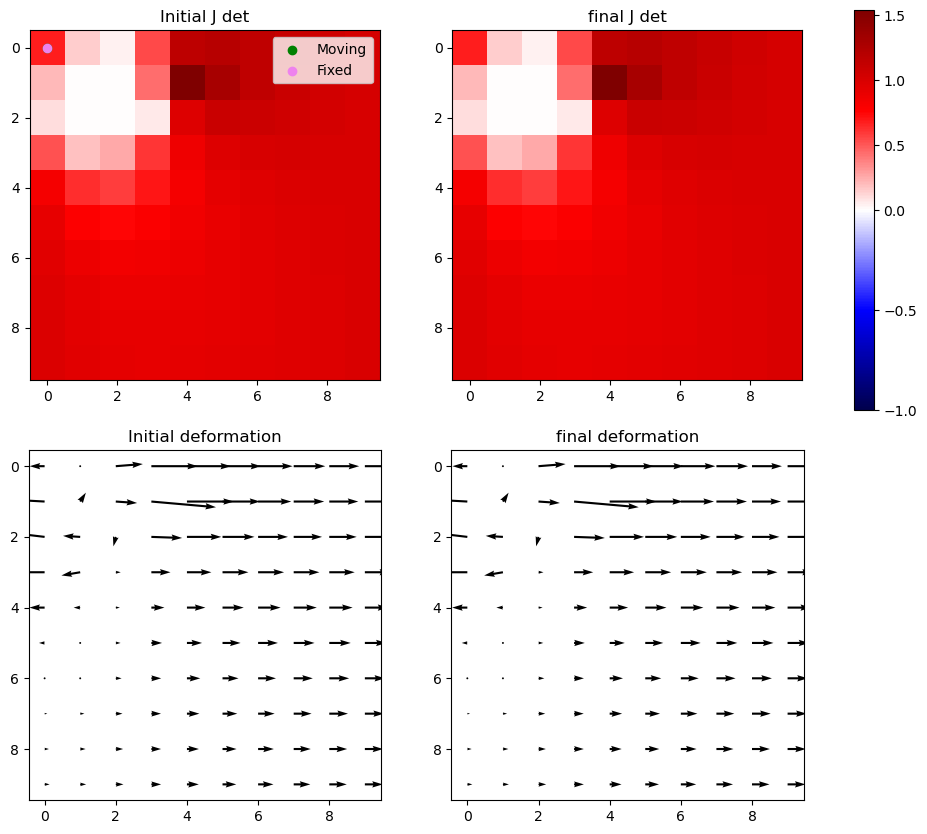

Iter 41: For index (2, 1), window size increased to 9 at iter 3


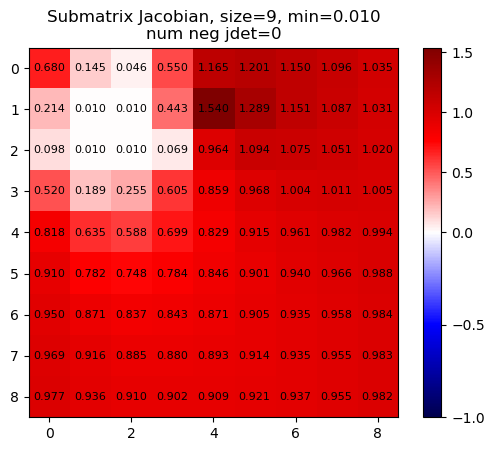

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


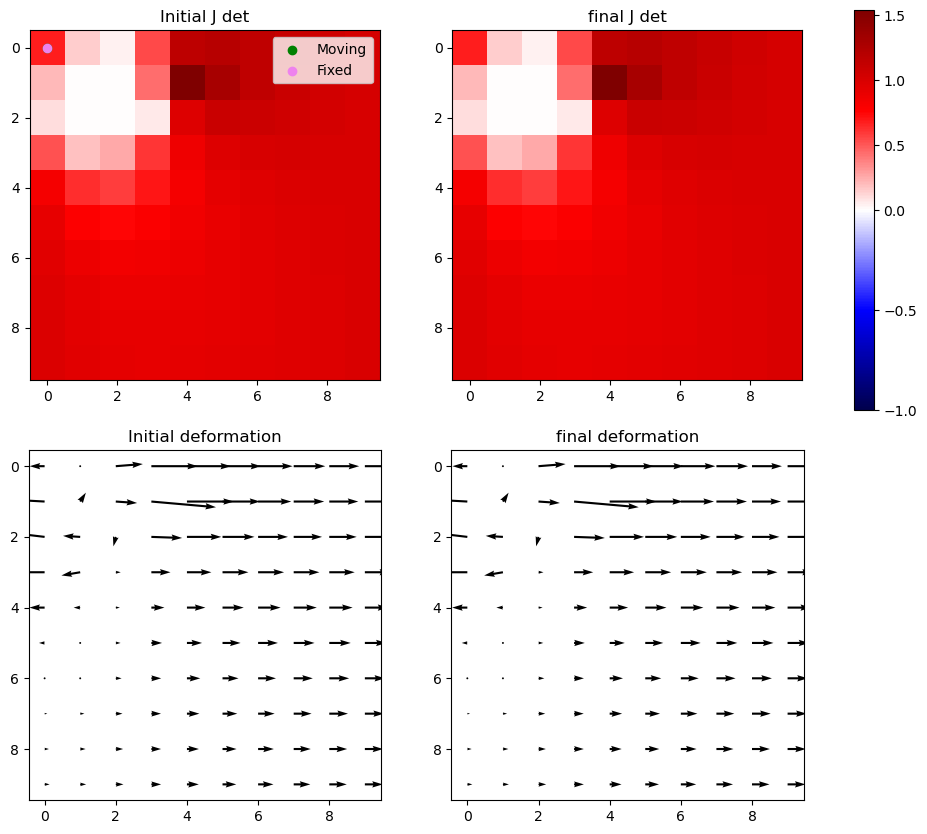

Iter 41 with 0 -ve jacs



Iter 42: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


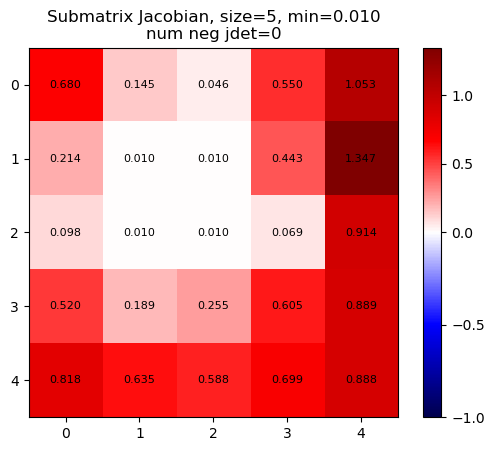

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


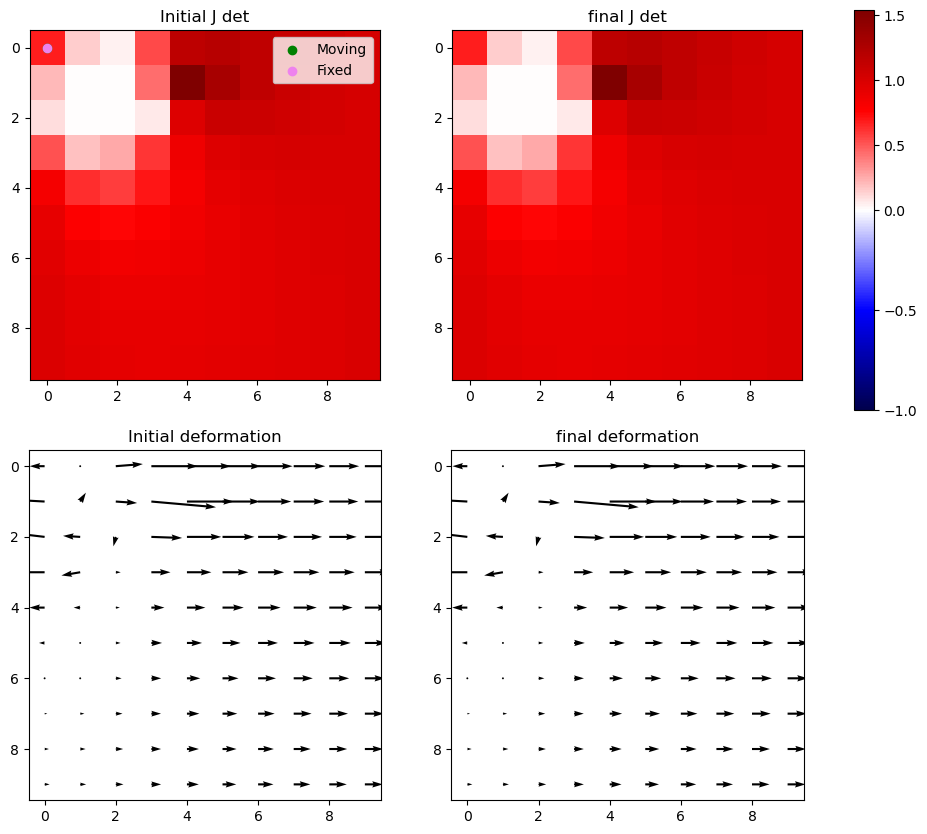

Iter 42: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


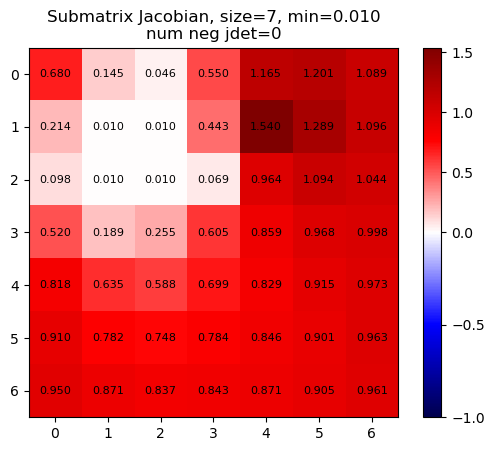

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


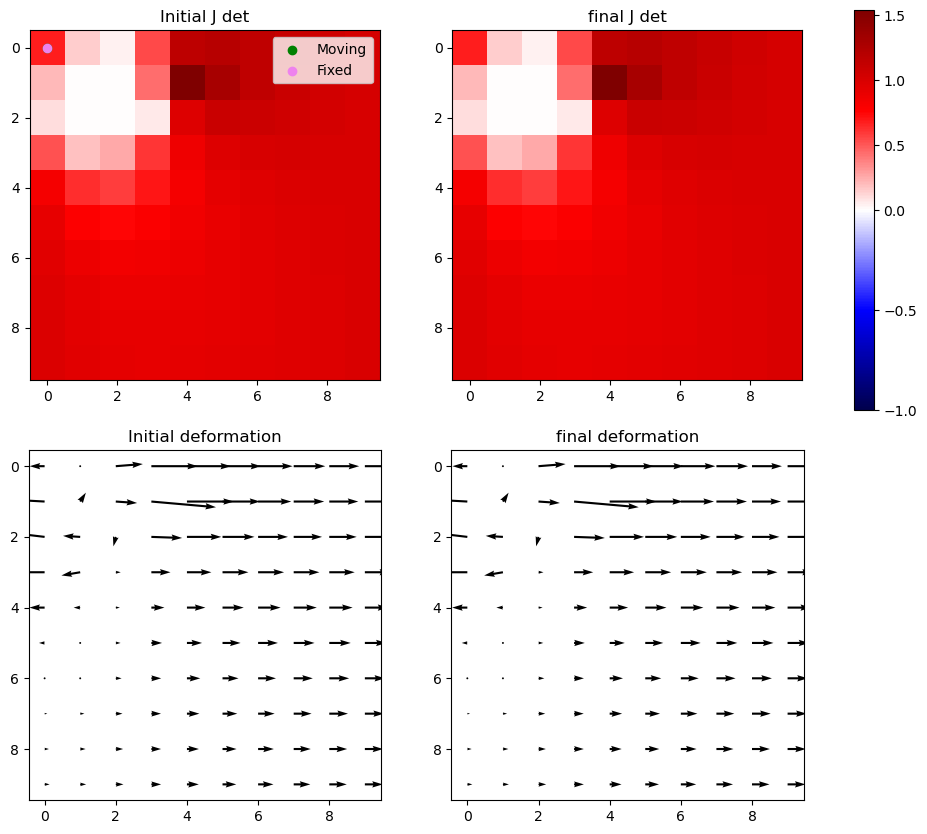

Iter 42: For index (2, 1), window size increased to 9 at iter 3


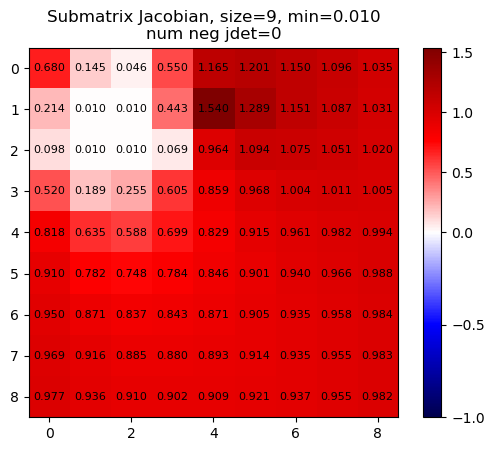

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


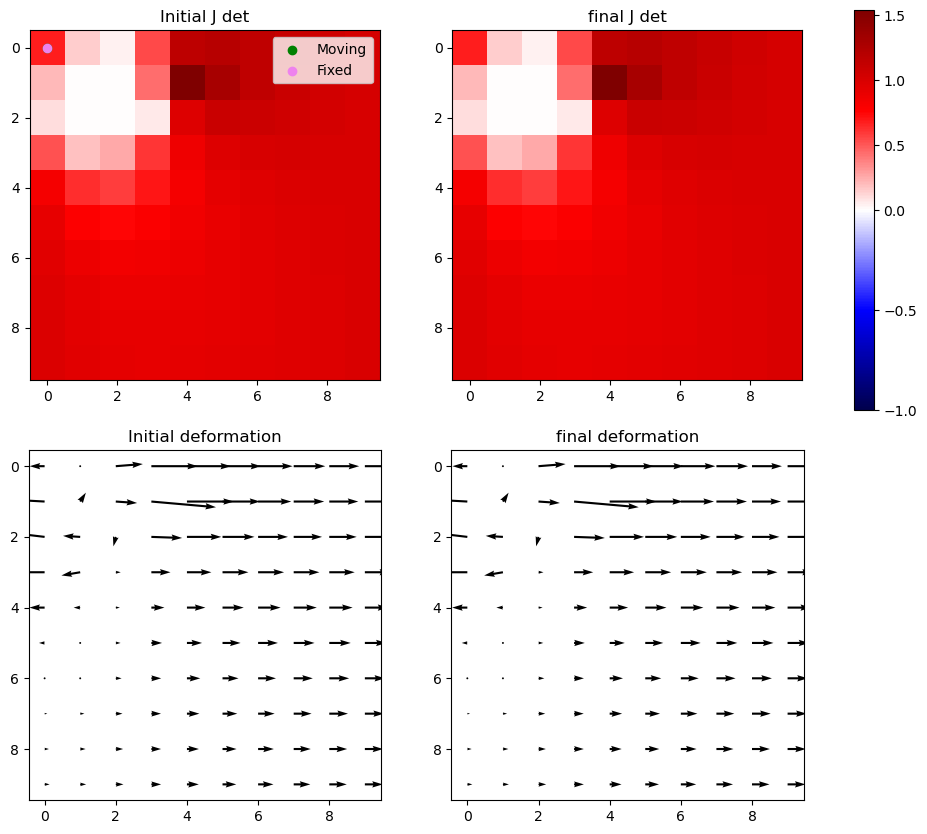

Iter 42 with 0 -ve jacs



Iter 43: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


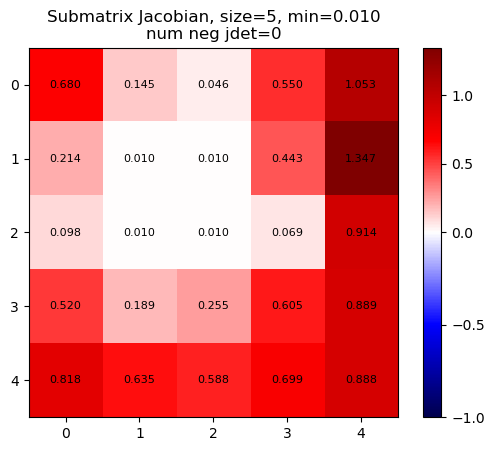

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


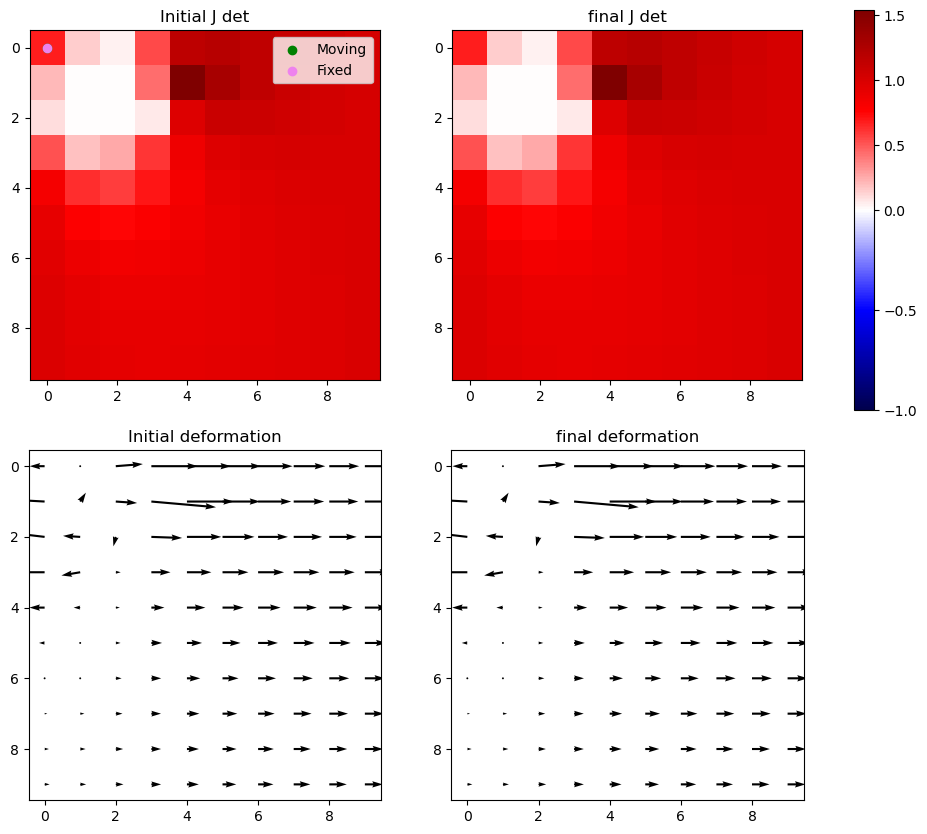

Iter 43: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


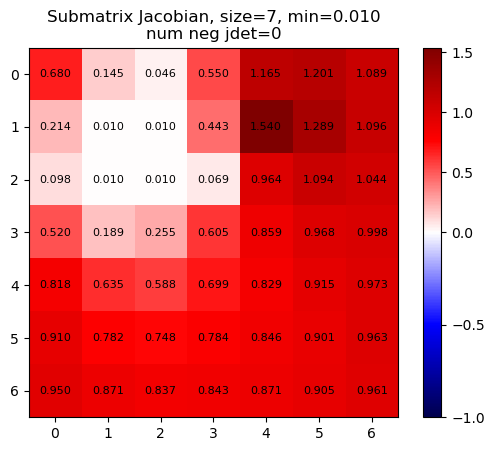

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


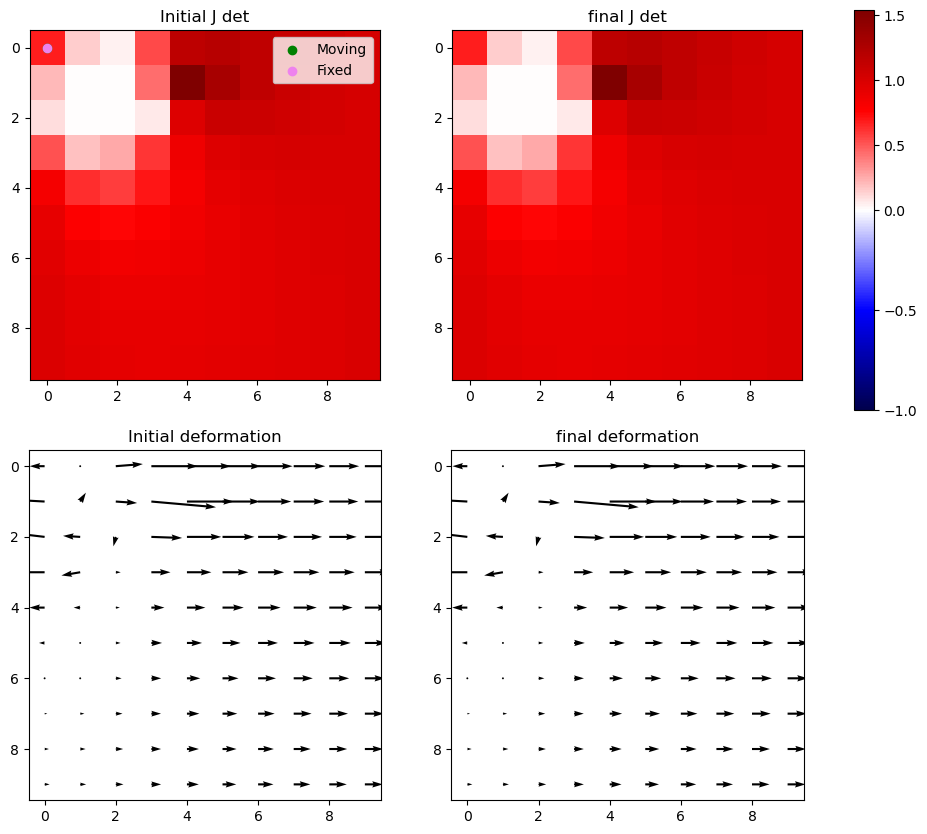

Iter 43: For index (2, 1), window size increased to 9 at iter 3


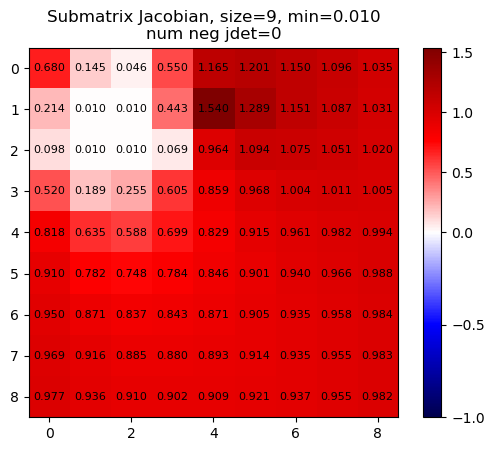

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


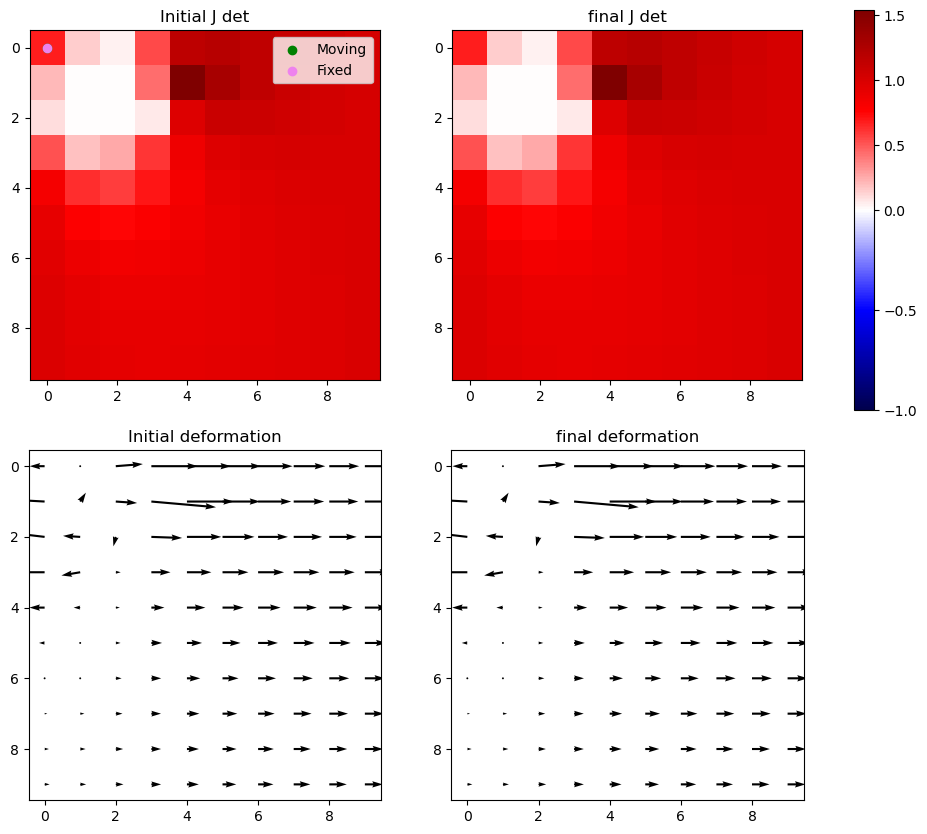

Iter 43 with 0 -ve jacs



Iter 44: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


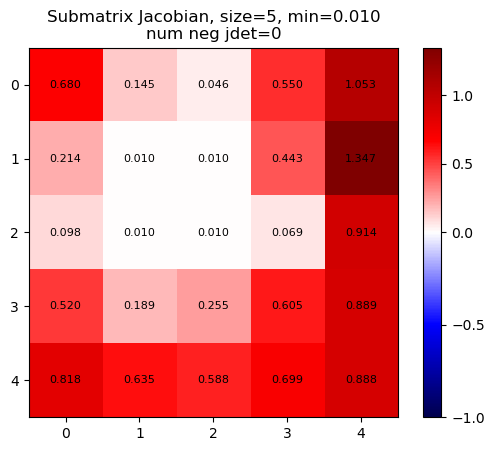

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


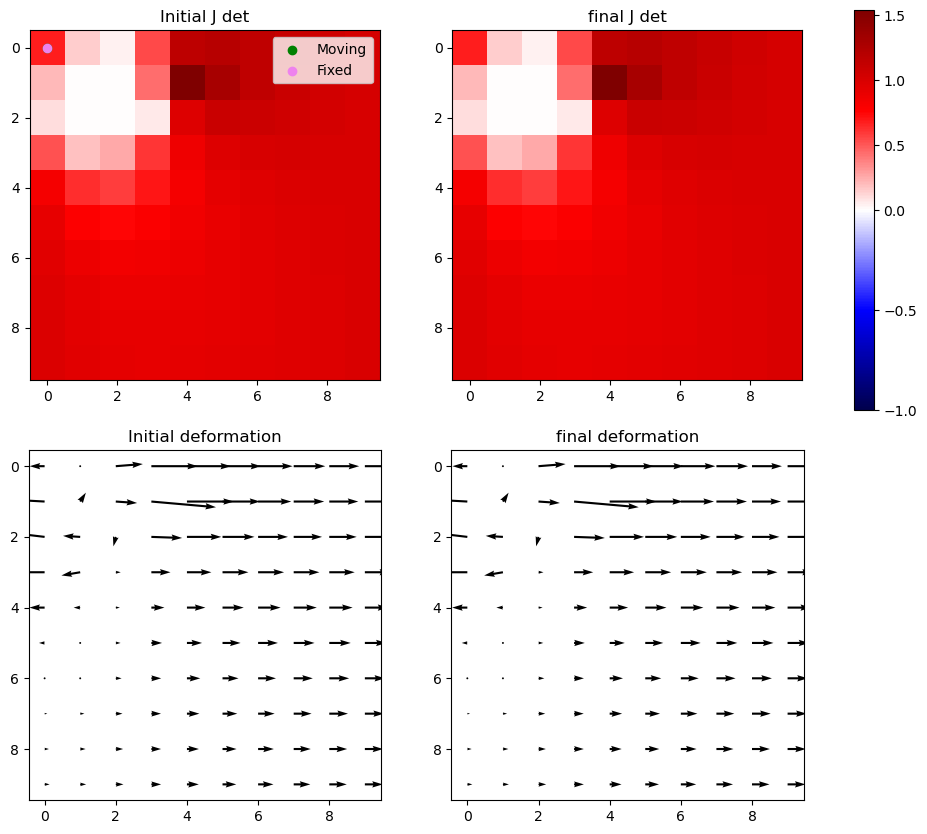

Iter 44: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


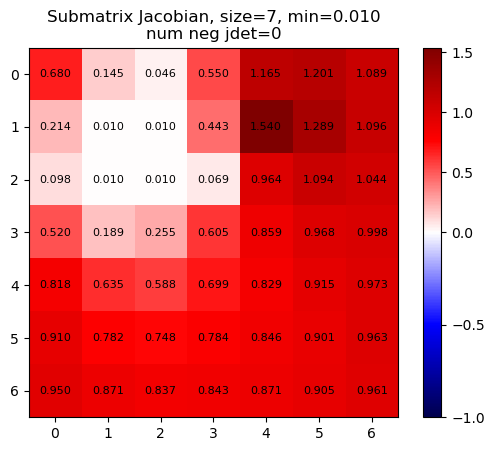

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


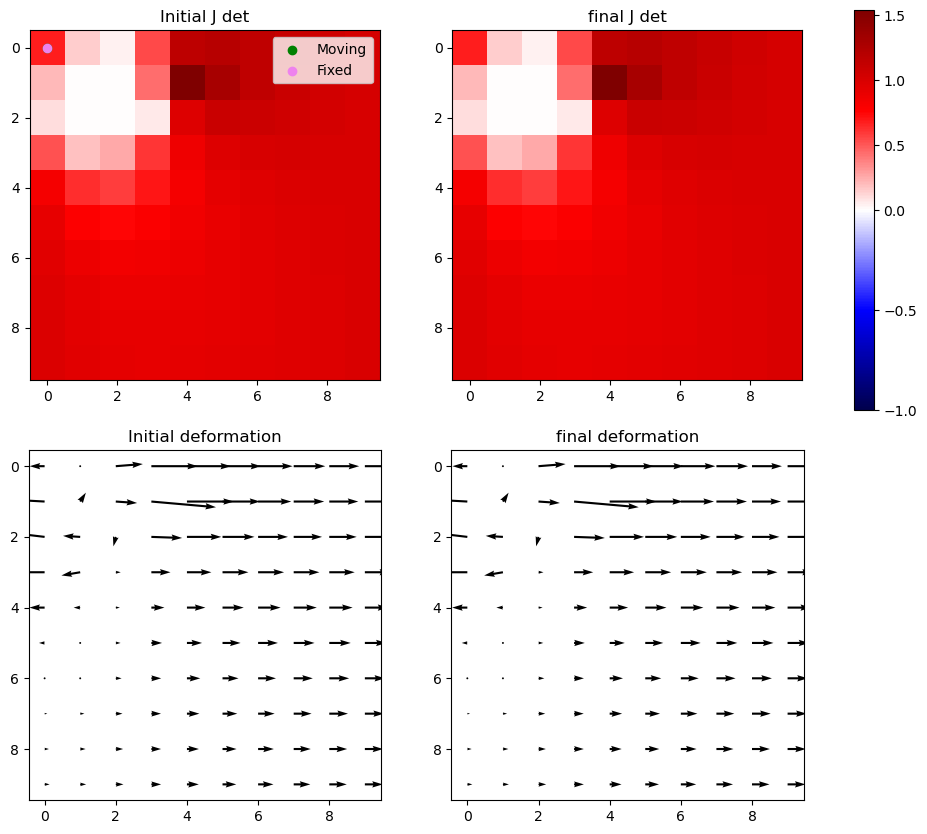

Iter 44: For index (2, 1), window size increased to 9 at iter 3


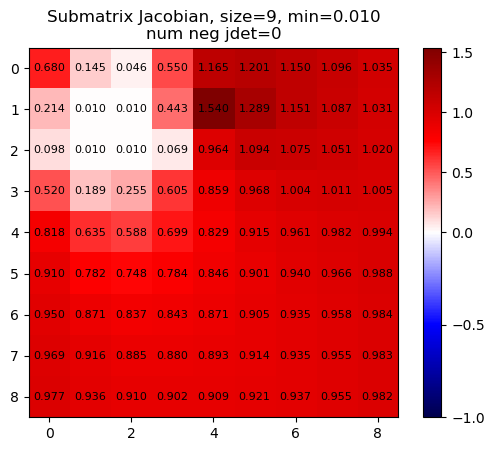

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


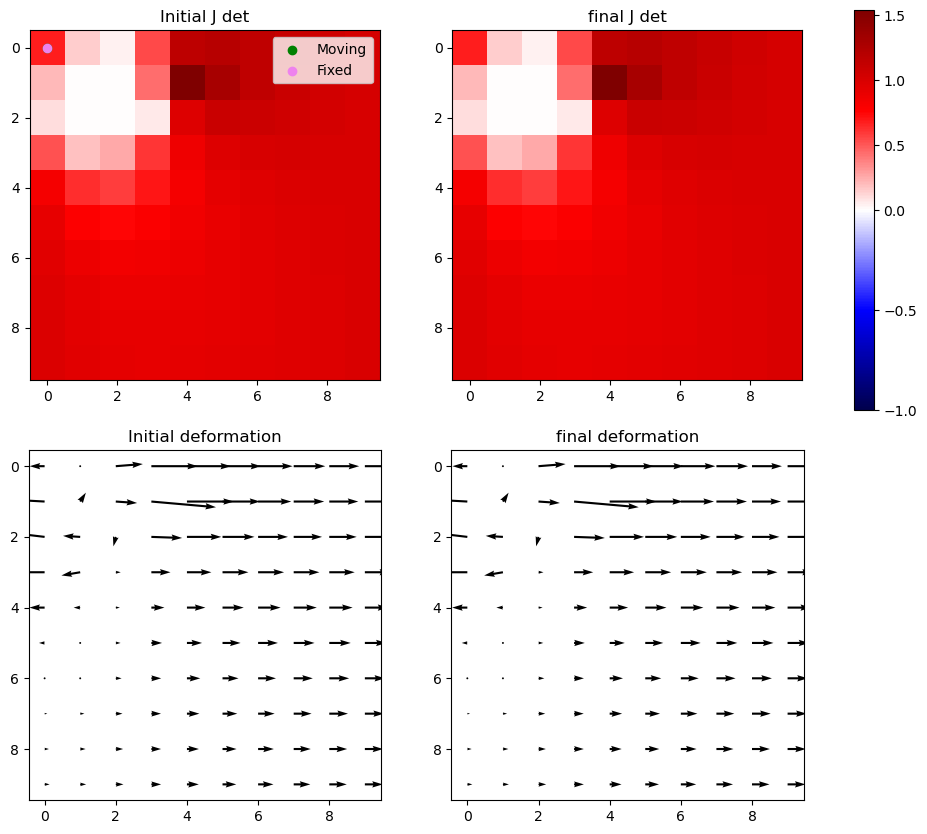

Iter 44 with 0 -ve jacs



Iter 45: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


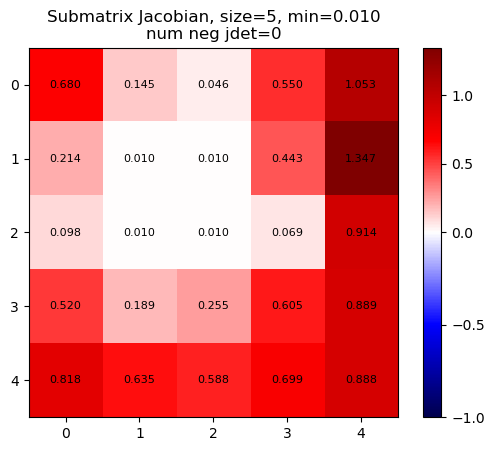

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


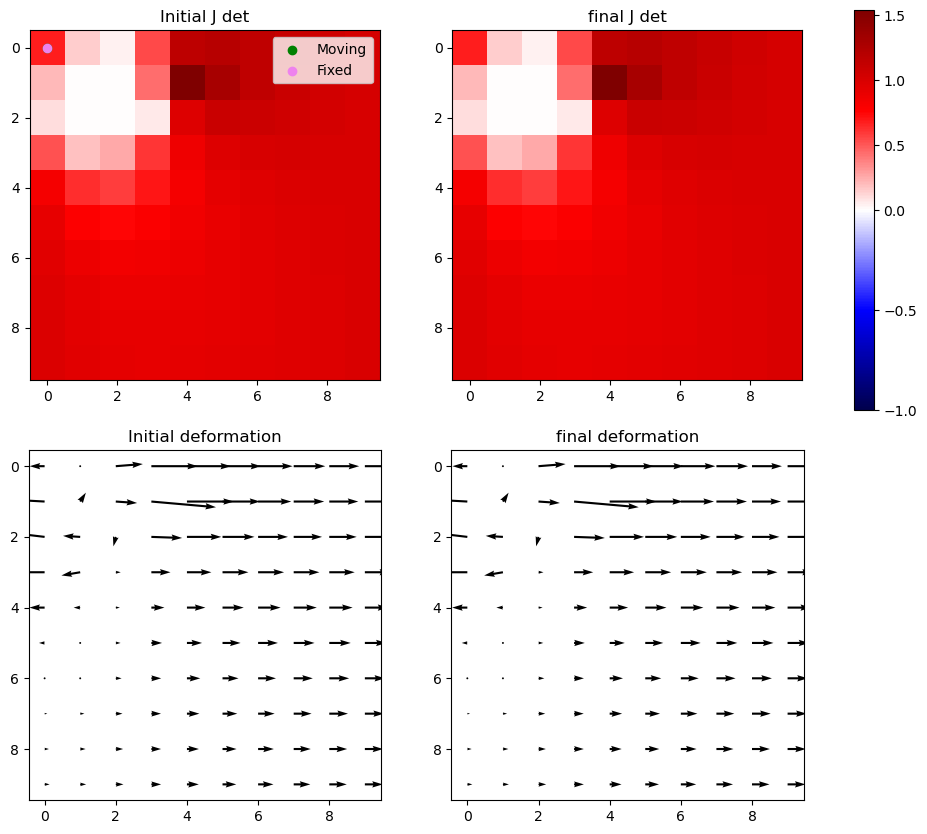

Iter 45: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


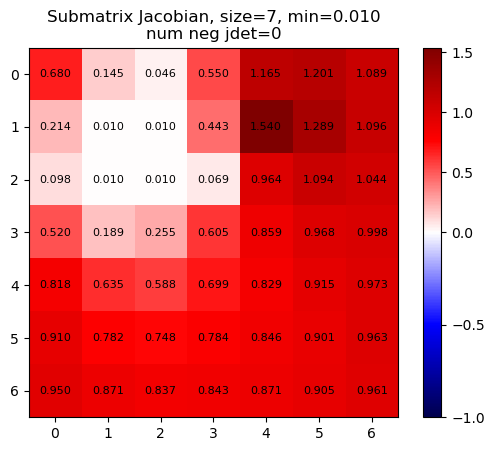

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


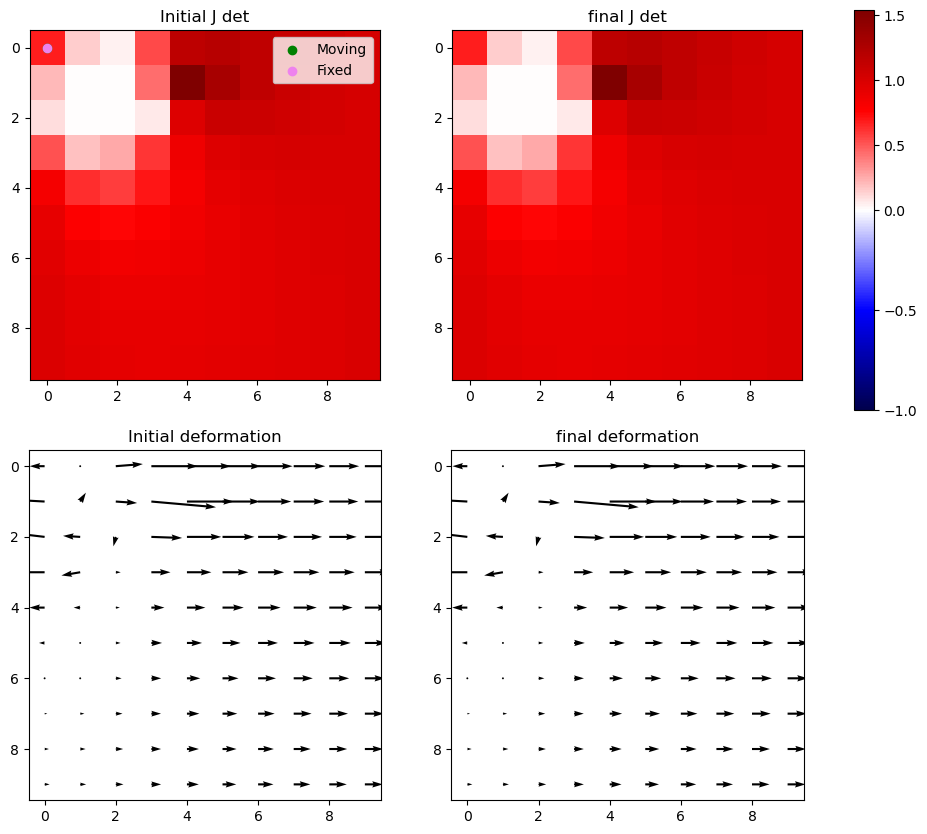

Iter 45: For index (2, 1), window size increased to 9 at iter 3


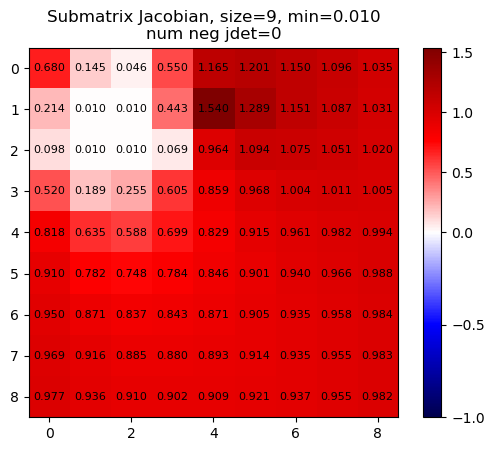

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


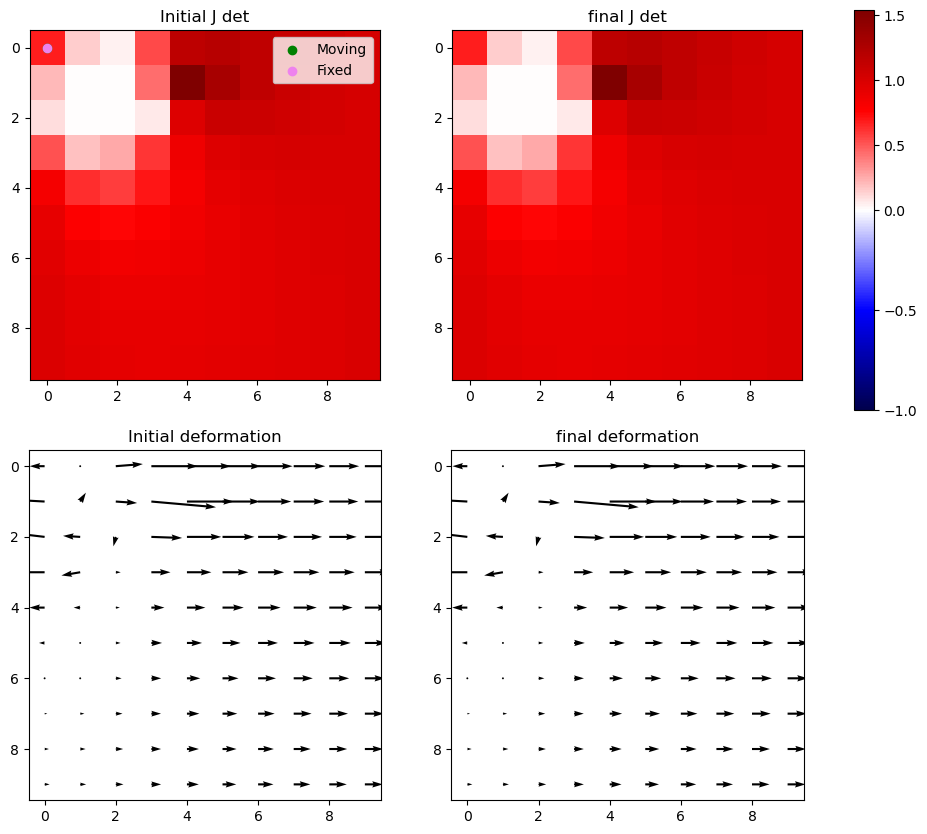

Iter 45 with 0 -ve jacs



Iter 46: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


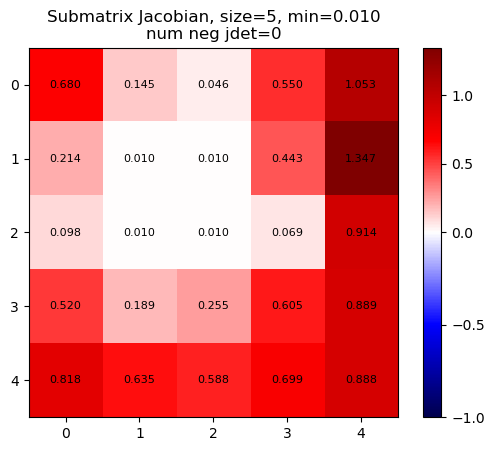

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


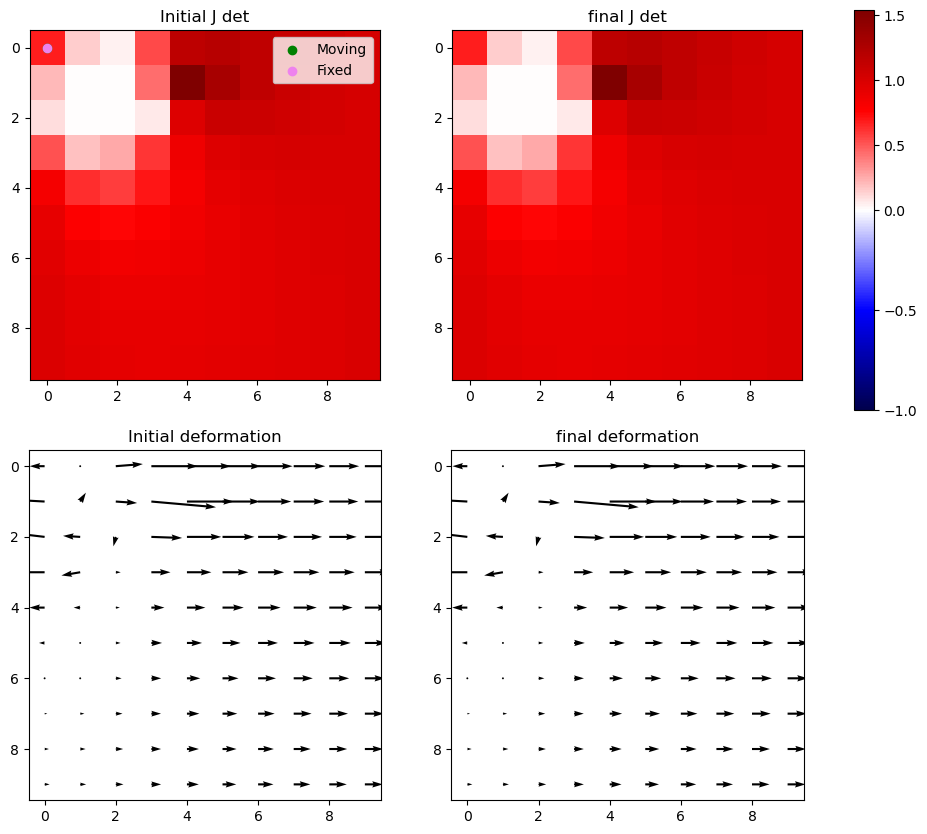

Iter 46: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


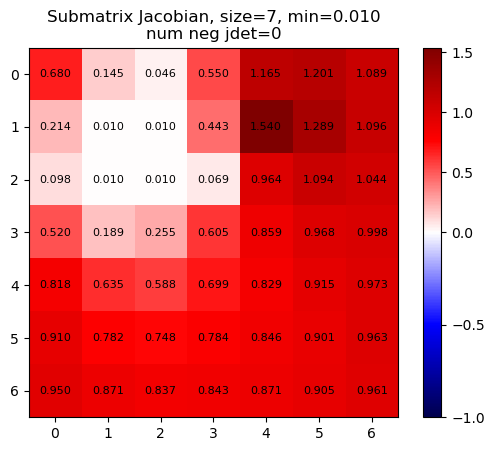

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


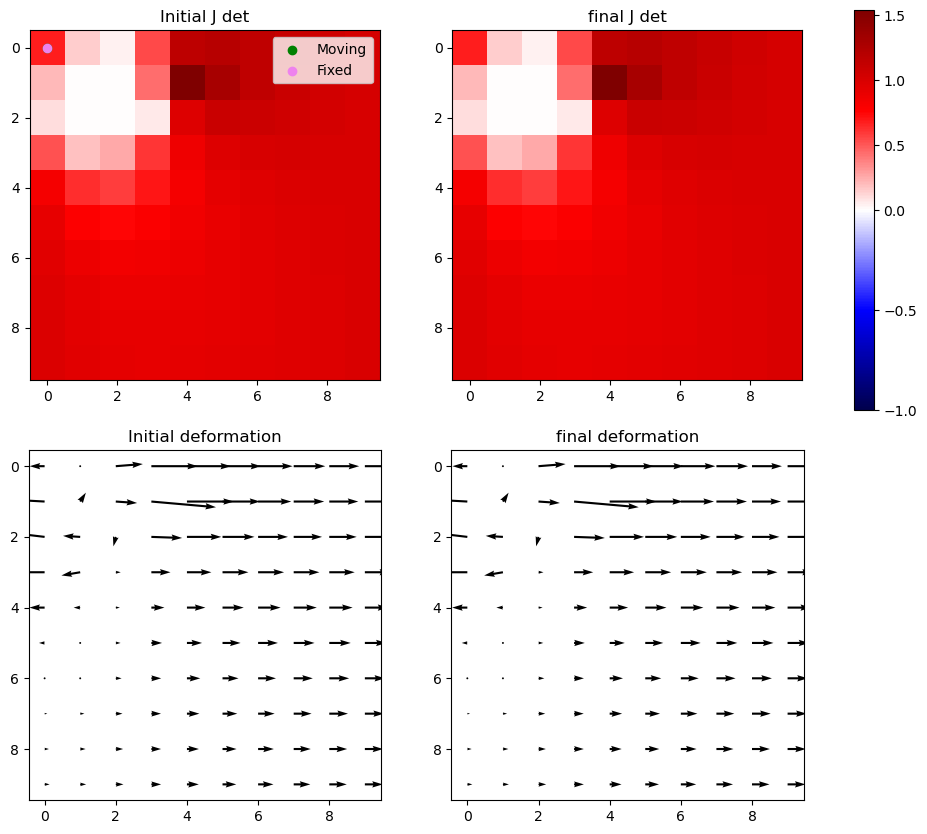

Iter 46: For index (2, 1), window size increased to 9 at iter 3


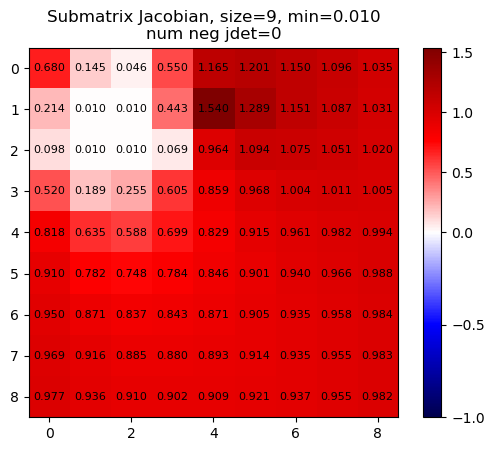

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


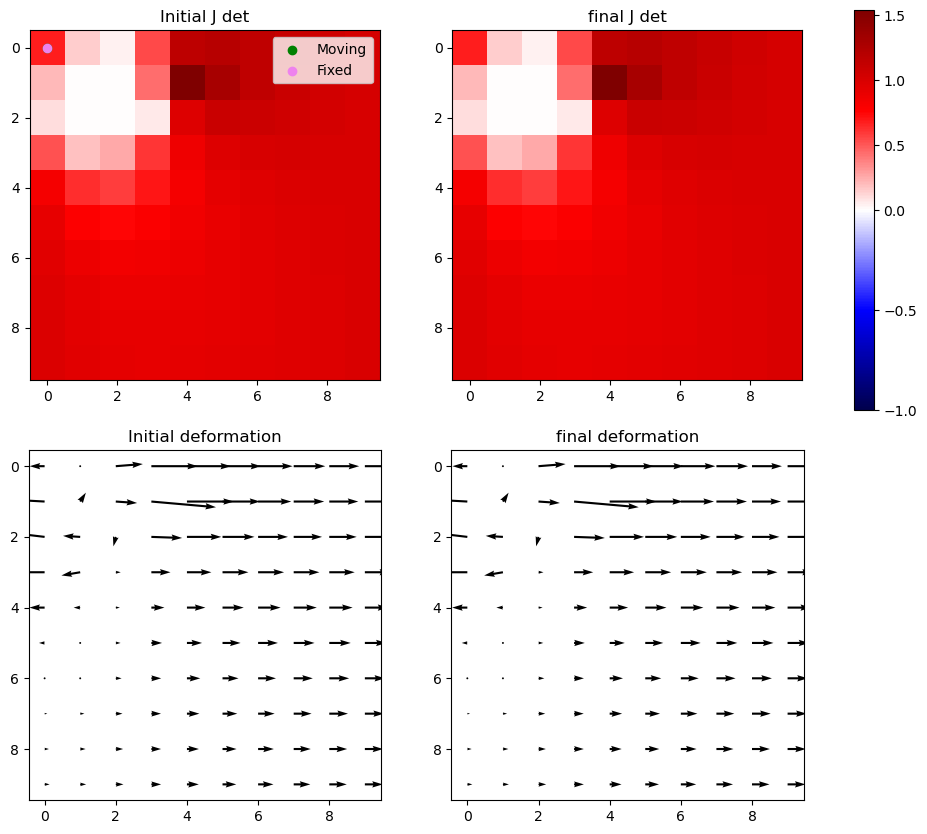

Iter 46 with 0 -ve jacs



Iter 47: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


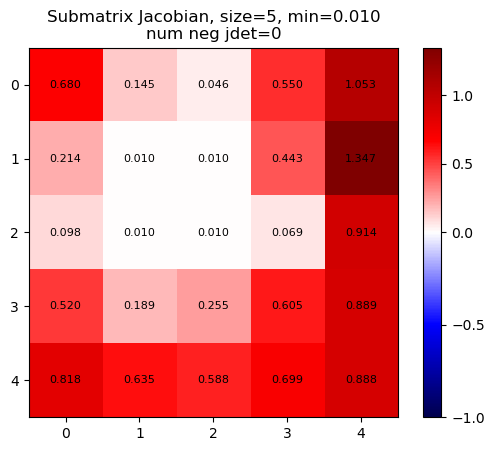

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


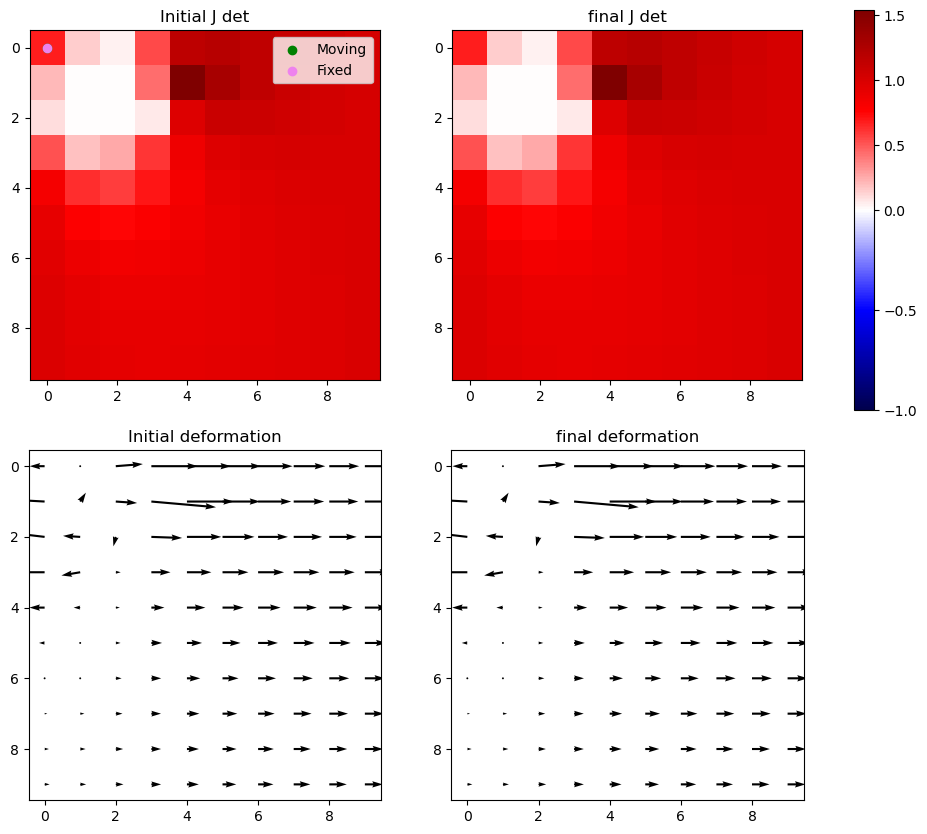

Iter 47: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


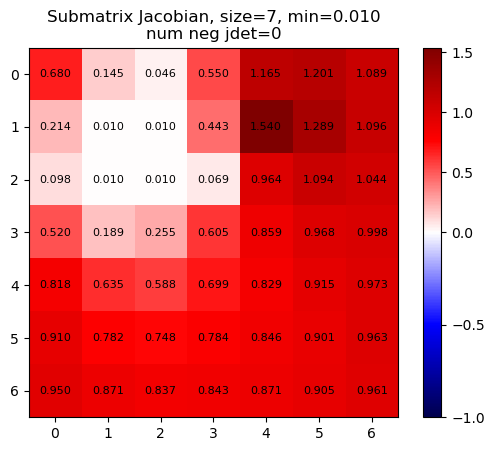

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


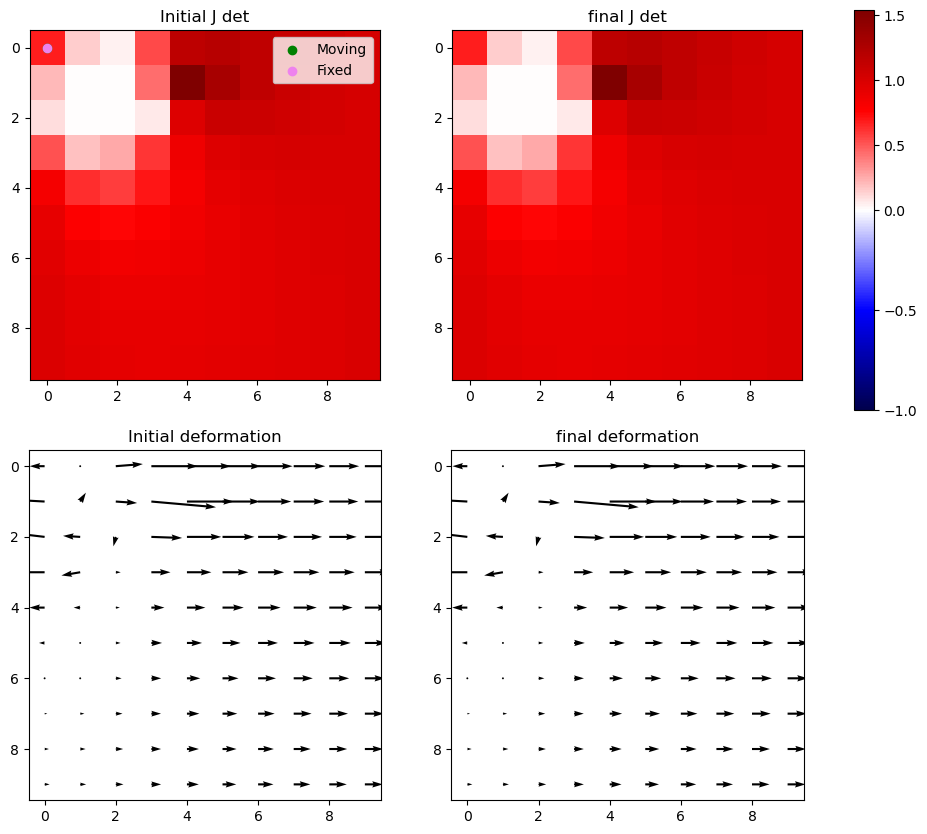

Iter 47: For index (2, 1), window size increased to 9 at iter 3


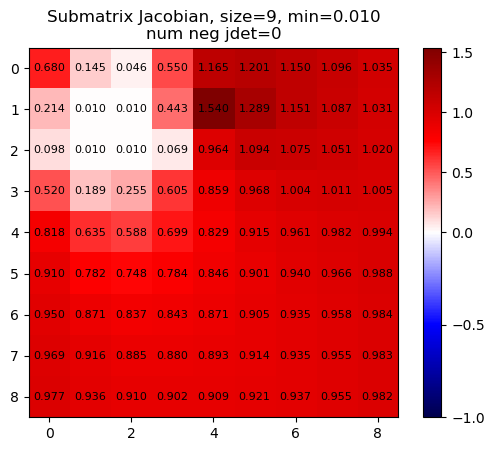

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


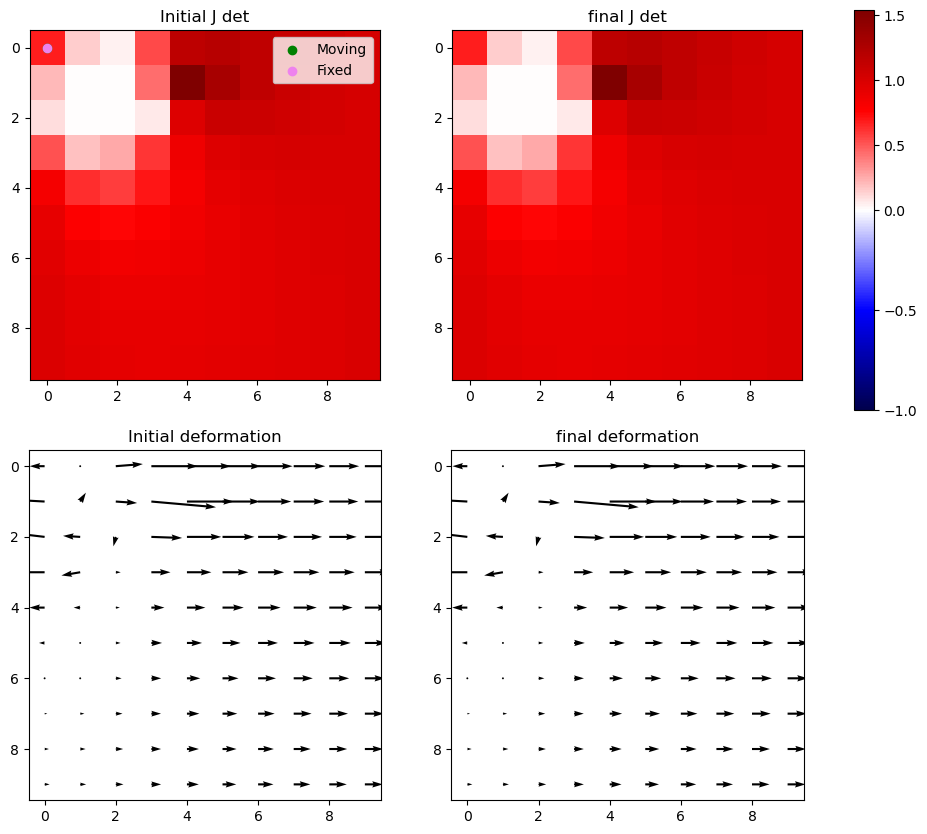

Iter 47 with 0 -ve jacs



Iter 48: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


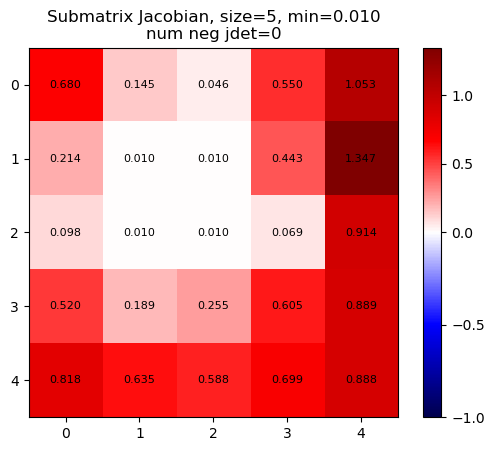

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


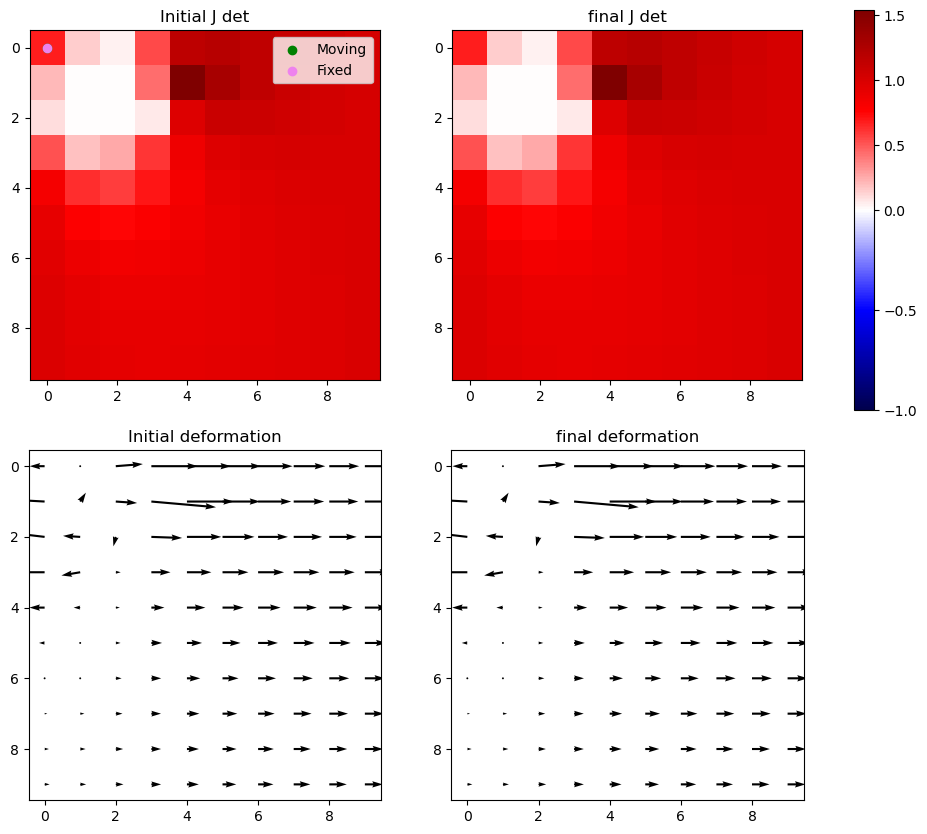

Iter 48: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


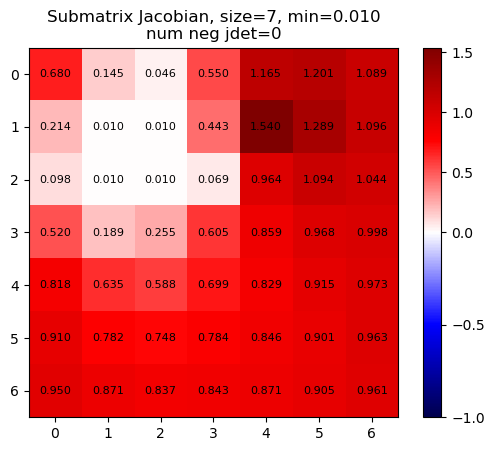

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


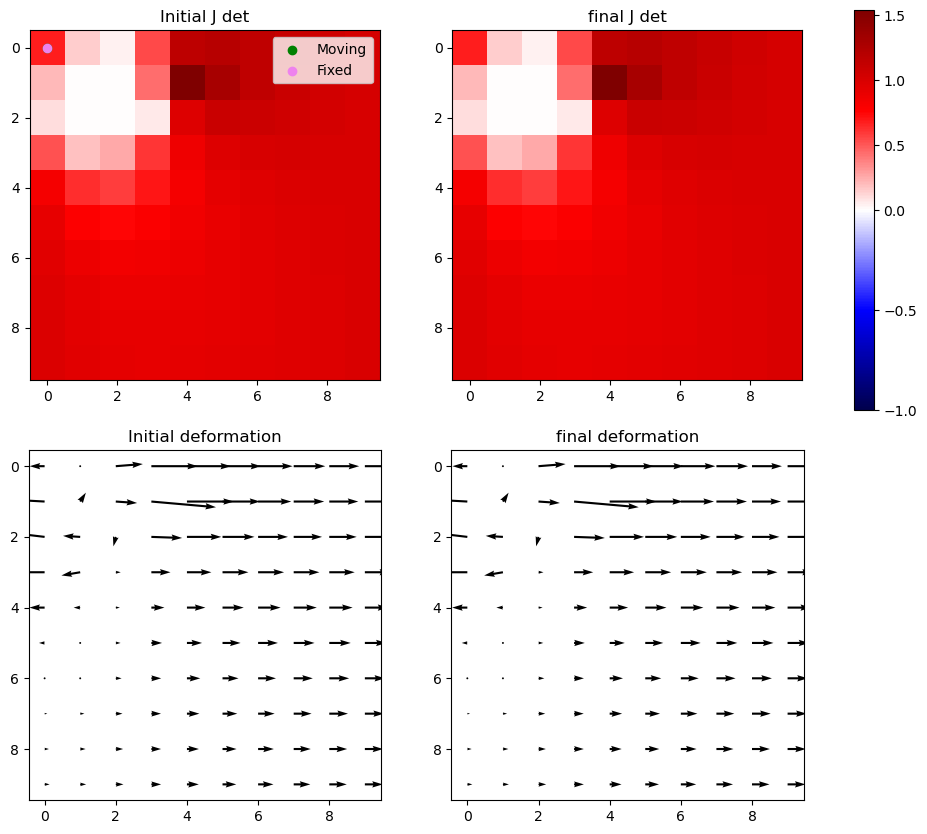

Iter 48: For index (2, 1), window size increased to 9 at iter 3


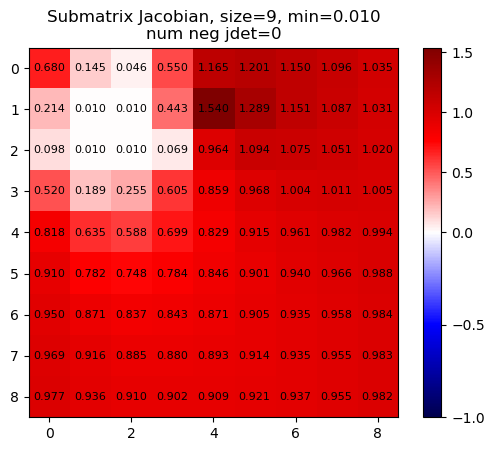

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


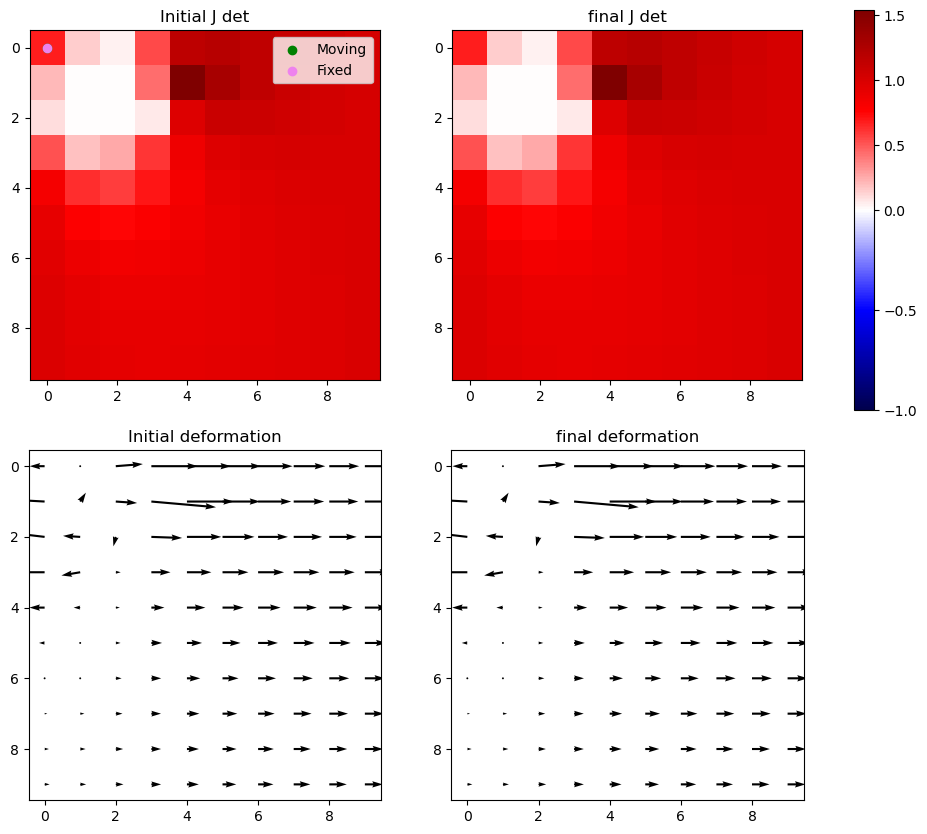

Iter 48 with 0 -ve jacs



Iter 49: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


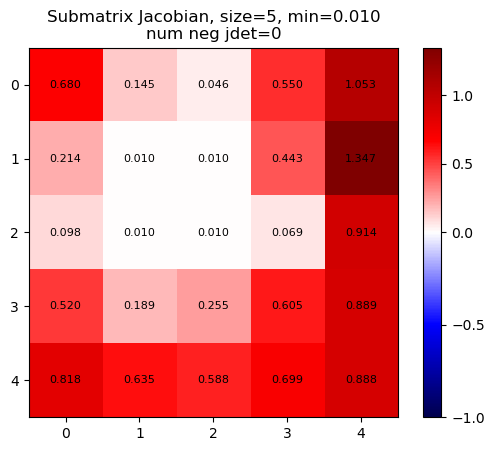

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


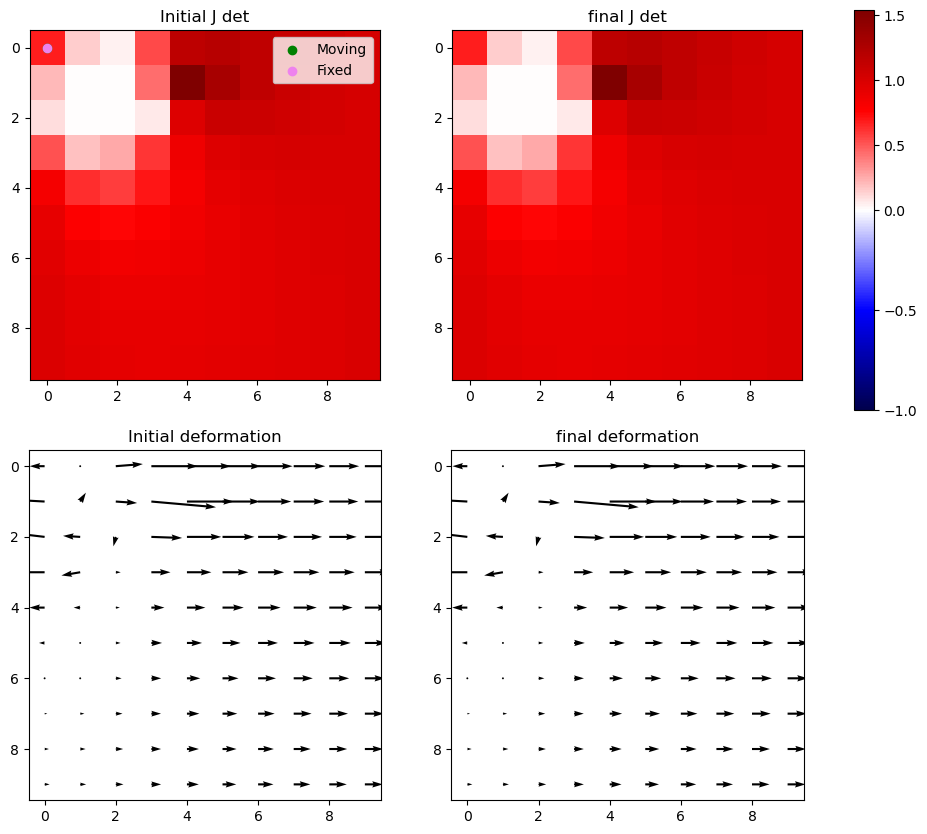

Iter 49: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


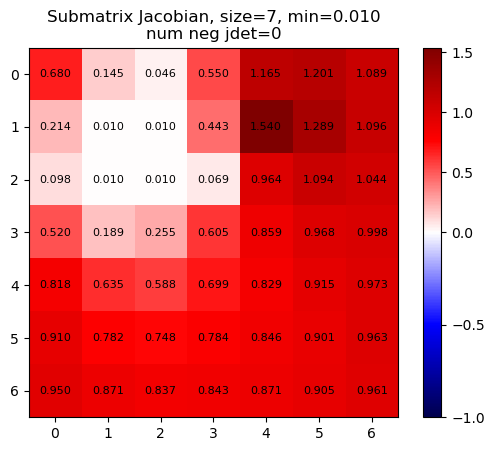

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


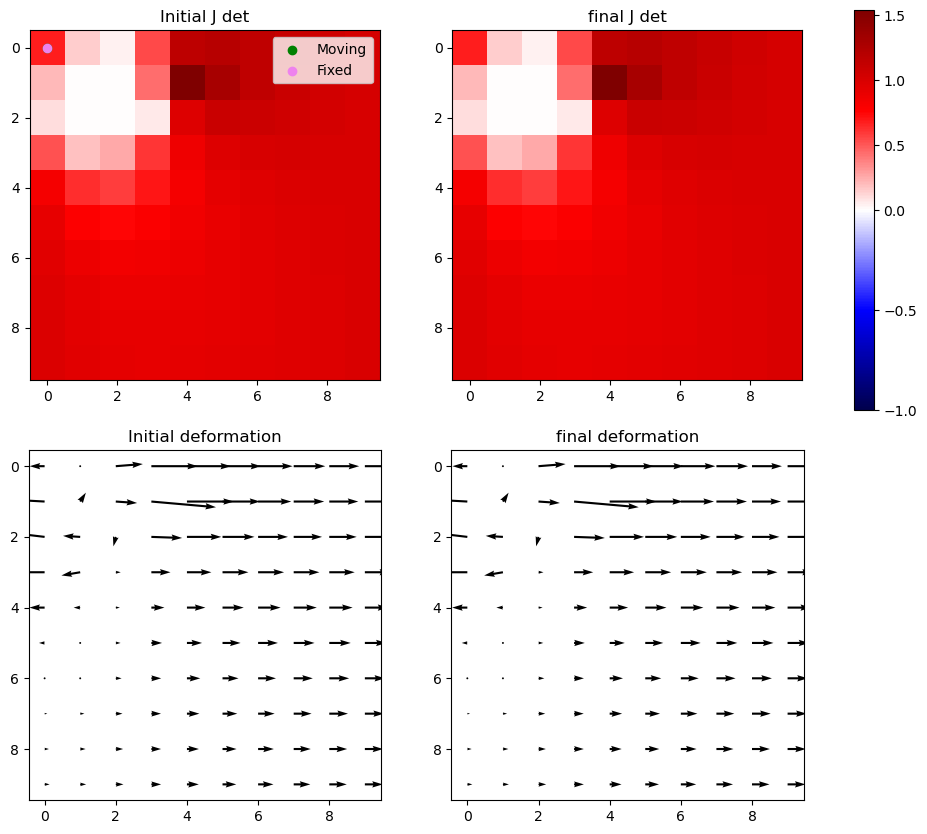

Iter 49: For index (2, 1), window size increased to 9 at iter 3


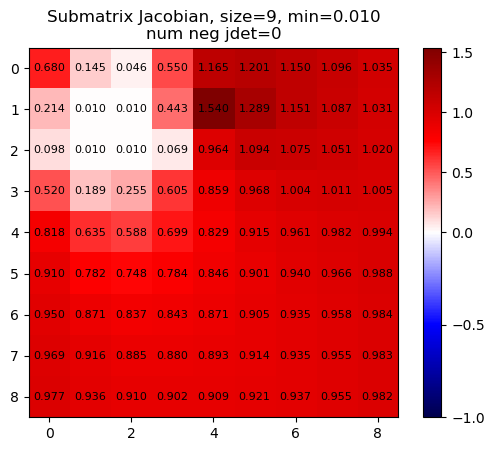

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


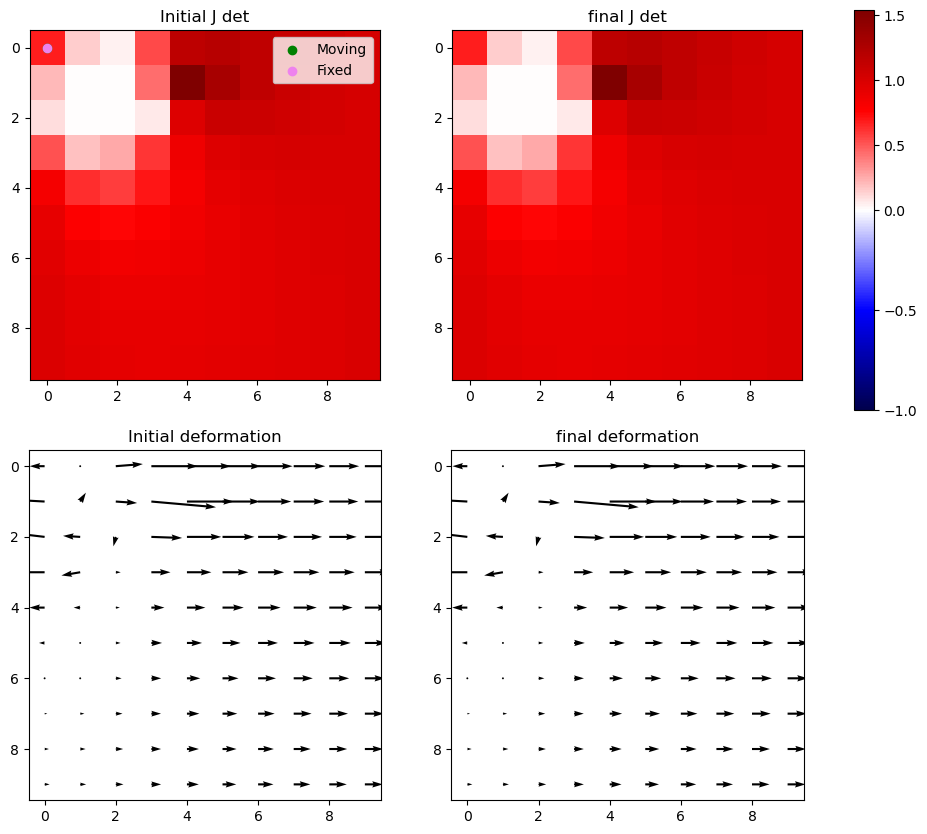

Iter 49 with 0 -ve jacs



Iter 50: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


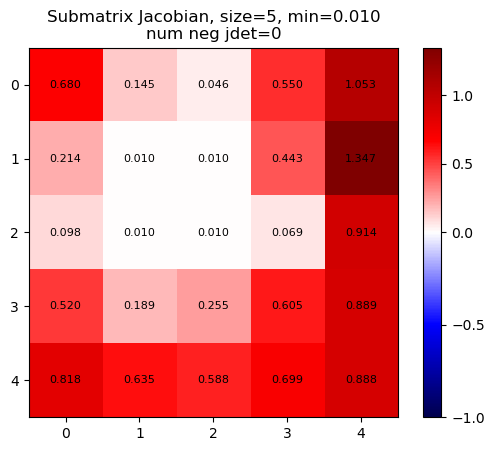

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


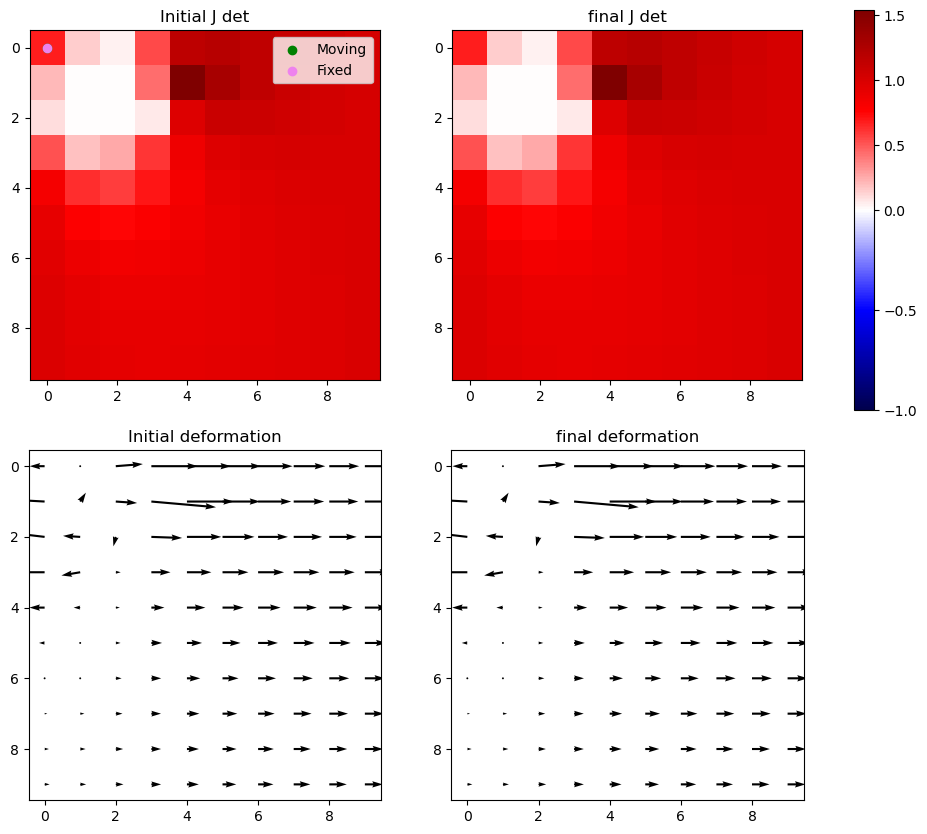

Iter 50: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


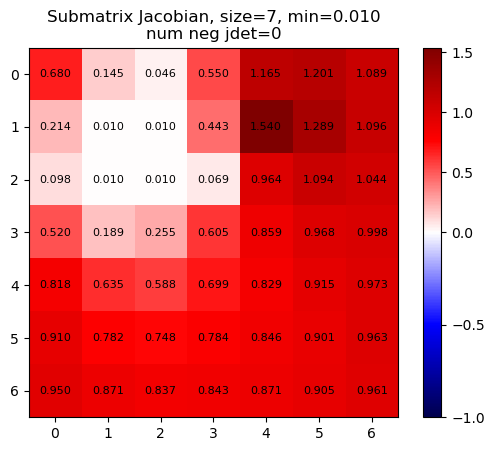

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


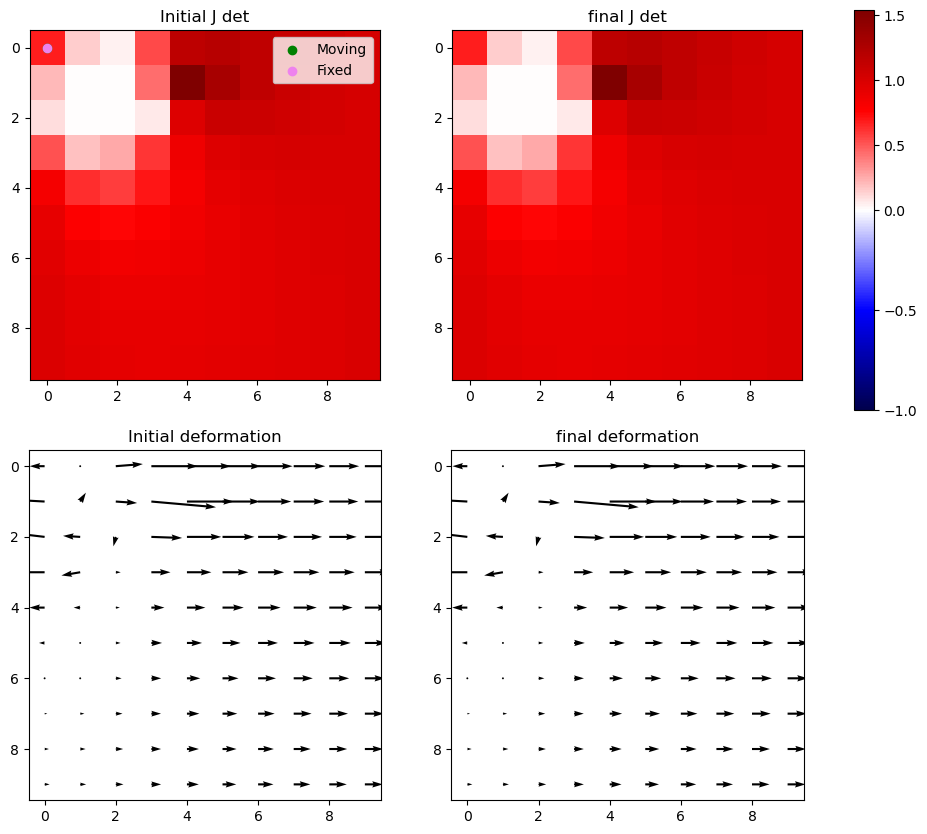

Iter 50: For index (2, 1), window size increased to 9 at iter 3


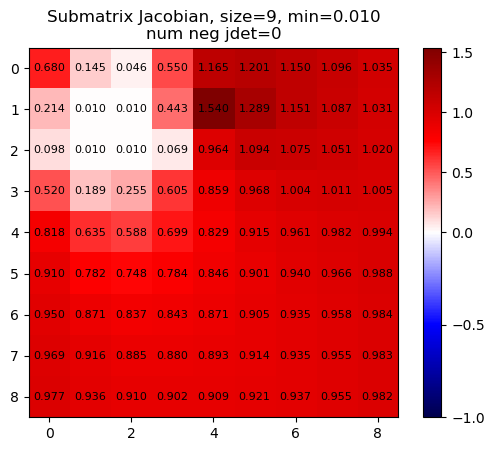

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


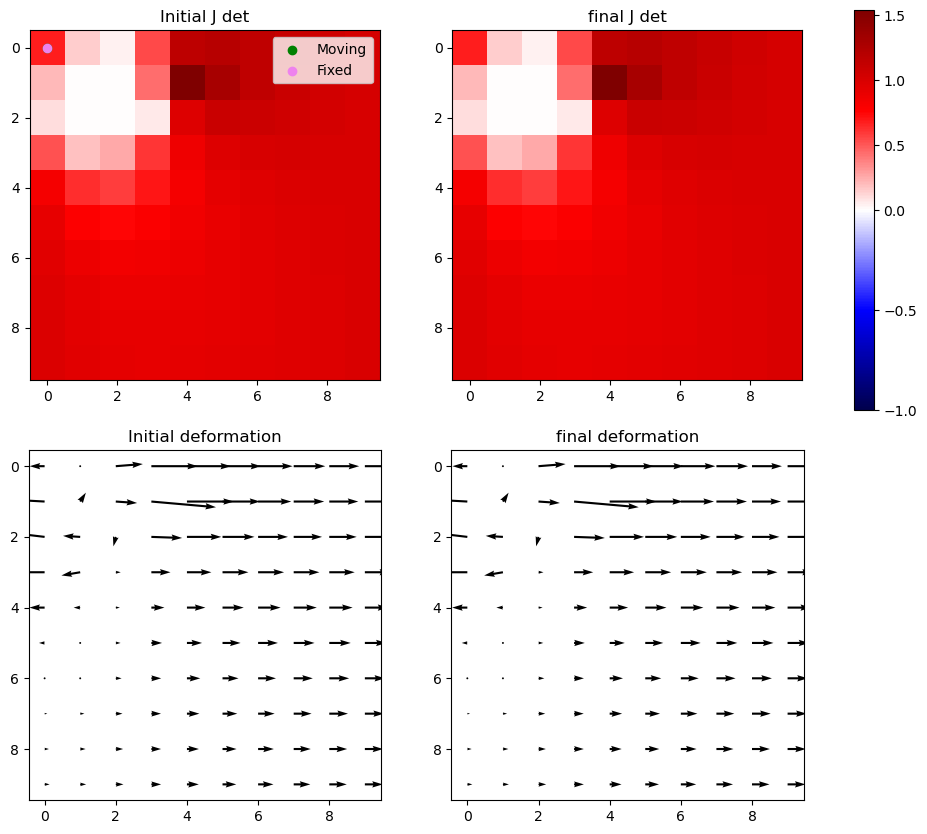

Iter 50 with 0 -ve jacs
Deviation from initial = 1.2134565775005344
Changed number of -ve jacobians from 5 to 0
Time taken for iter SLSQP optimisation: 168.2640552520752s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.999822  2.999822  0.000000  0.000000 -0.730373  1.709059
final   -2.709375  2.555239 -0.395733  0.372456  0.010000  1.539590
meshgrid shape for plot: (10, 10)


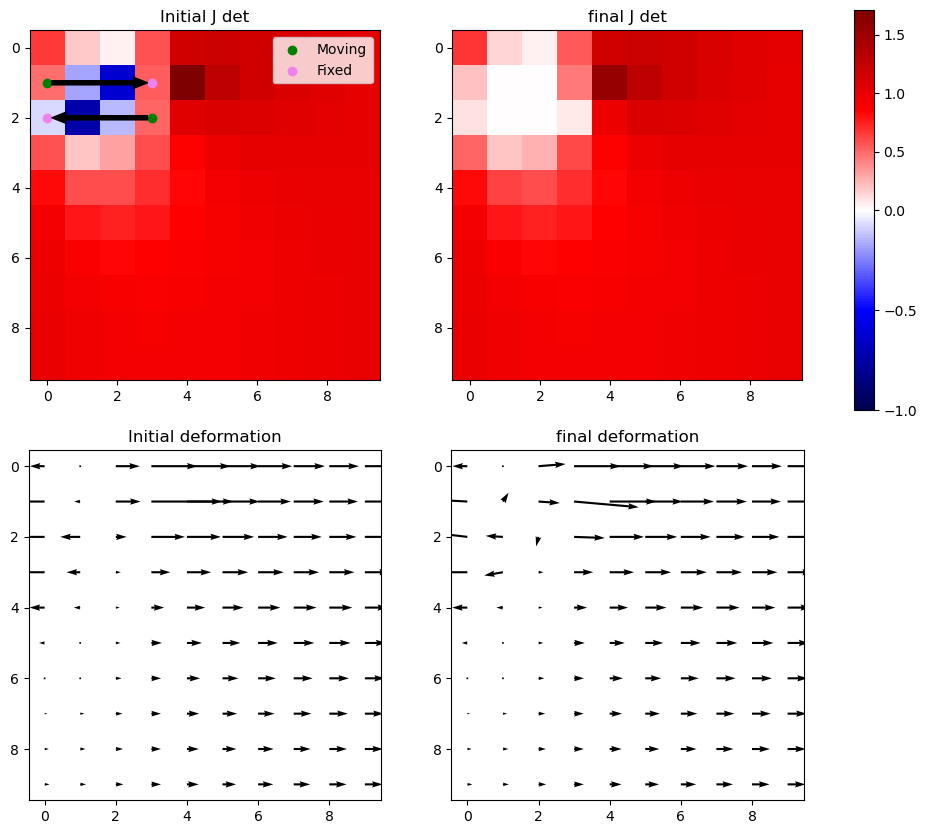

In [115]:
msample = np.array([
    [0, 1, 0],
    [0, 2, 3],
])
fsample = np.array([
    [0, 1, 3],
    [0, 2, 0],
])

fixed_sample = np.zeros((1, 10, 10)) # depth, rows, cols

run_lapl_and_correction(fixed_sample, msample, fsample)

# takes 15 mins and does not conclude on full 20x40 constraints
# 1.5mins on 10x10 constraints
# reduce constraints
# (10,5) - 50 vs 5 - 3.9s vs 0.15s
# (5,5) - 25 vs 5 - 0.35s vs 0.0645s
# (10, 10) - 100 vs 5 - 50s vs 0.46s
# (20, 20) - 400 vs 5 - waited for full one to run for 20min vs 1.5min

# 20x40 with 5 random constraints - 10.5 mins
# 20x40 run over the full thing - 174 min does not finish

deformation shape: (3, 1, 10, 10)
[[[[ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.

C:\Users\Andy\AppData\Local\Temp\ipykernel_9292\3501370654.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


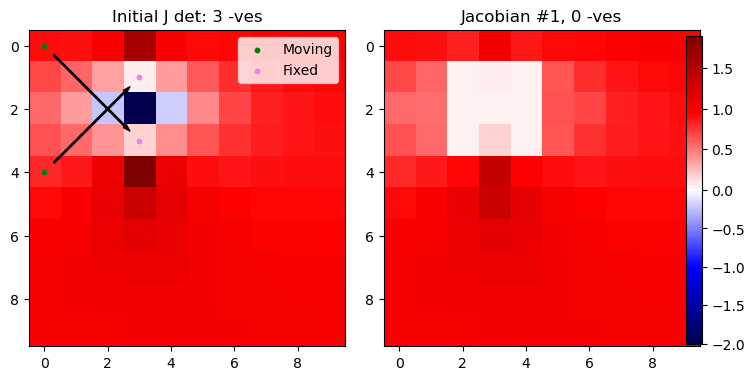

            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -3.013711 -2.977314 -2.999803  2.999803 -2.003395  1.893126
final   -3.940395 -2.072205 -1.939688  1.864271  0.050000  1.366055
meshgrid shape for plot: (10, 10)
[[[ 0.89126076  0.88649201  0.96400756  1.58394211  0.97360102  0.9065901   0.92879864  0.95207293  0.96609706  0.97211199]
  [ 0.67434955  0.56825474  0.34437072  0.07246907  0.36555203  0.62007237  0.77637465  0.86184539  0.90500563  0.9221917 ]
  [ 0.56162551  0.36726659 -0.22374717 -2.0033955  -0.19642219  0.43519678  0.69436959  0.81377889  0.86940417  0.89126523]
  [ 0.64182308  0.56192132  0.39110896  0.17568873  0.42200789  0.62541714  0.75434954  0.82965913  0.86984911  0.88682344]
  [ 0.79774359  0.84437209  1.05607877  1.8931261   1.08067768  0.891393    0.86707284  0.88018585  0.89376049  0.90111237]
  [ 0.90823824  0.96275502  1.09845439  1.31025733  1.11602031  0.99152123

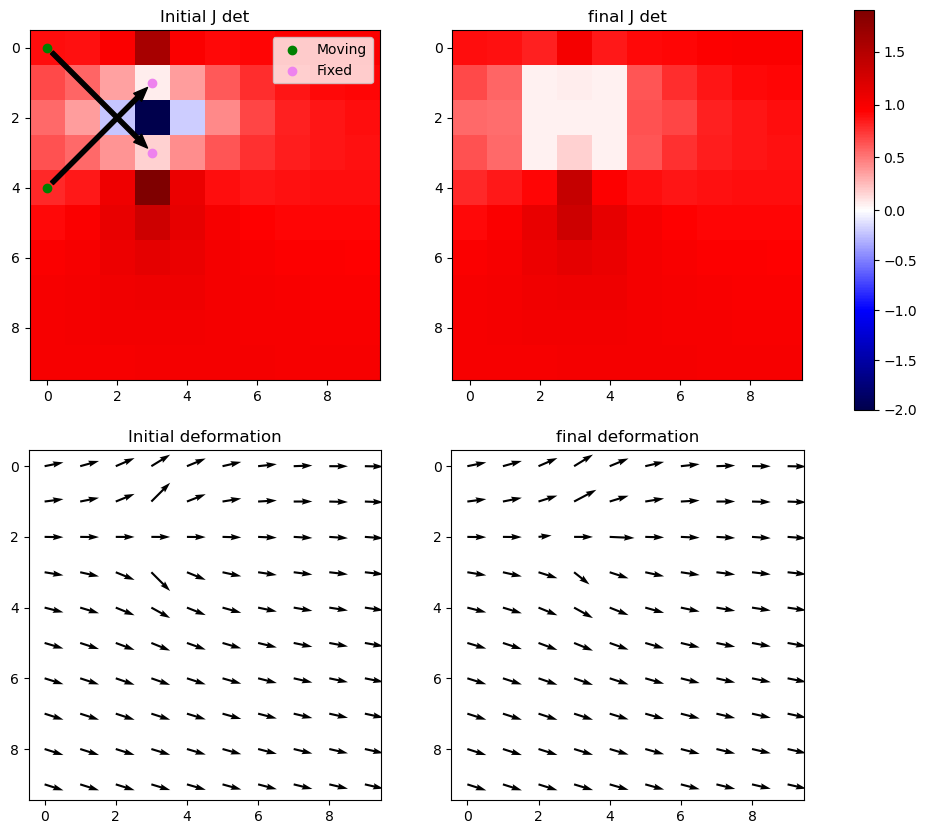

In [12]:
msample = np.array([
    [0, 0, 0],
    [0, 4, 0],
])
fsample = np.array([
    [0, 3, 3],
    [0, 1, 3],
])

fixed_sample = np.zeros((1, 10, 10))
#run_lapl_and_correction(fixed_sample, msample, fsample)
deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, msample, fsample)
print(f'deformation shape: {deformation_i.shape}')
print(deformation_i)
phi_corrected, jacobians = iterative_with_jacobians2(deformation_i, methodName='SLSQP')
plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
print(jacobian_det2D(deformation_i[1:]))

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)
Iter 1: Fixing index (1, 3)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.8589860005543305
            Iterations: 13
            Function evaluations: 676
            Gradient evaluations: 13
Iter 1: For index (1, 3), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.9043351246327849
            Iterations: 7
            Function evaluations: 693
            Gradient evaluations: 7
Iter 1 with 0 -ve jacs
Deviation from initial = 0.904335124632785
Chang

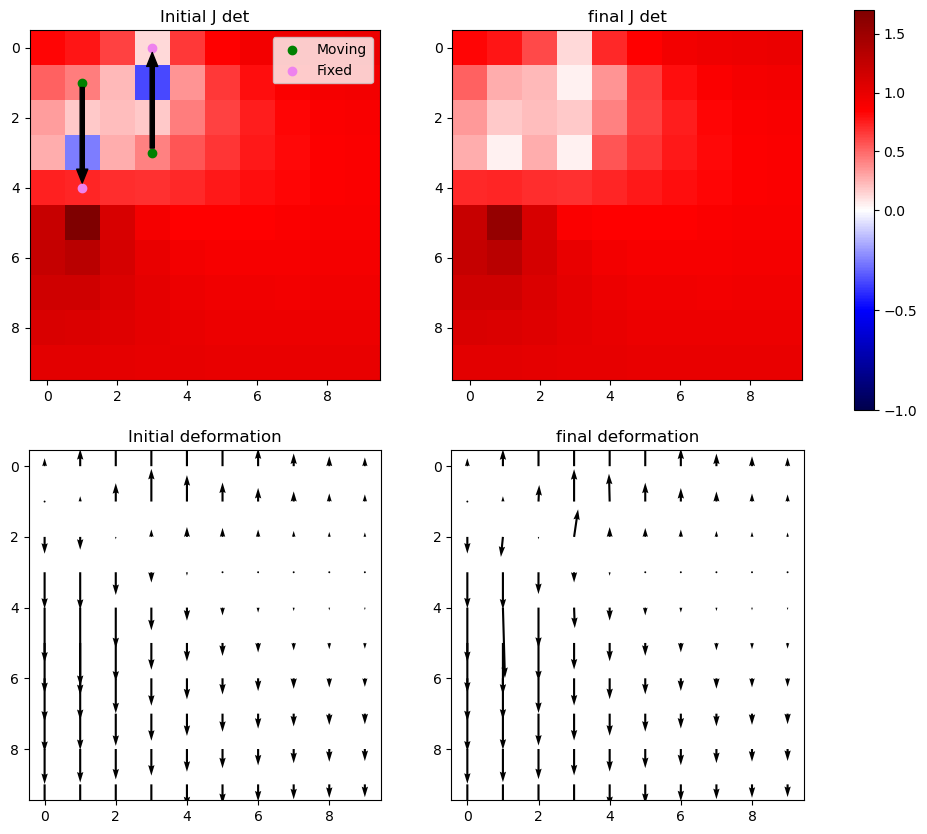

In [13]:
msample = np.array([
    [0, 1, 1],
    [0, 3, 3],
])
fsample = np.array([
    [0, 4, 1],
    [0, 0, 3],
])

fixed_sample = np.zeros((1, 10, 10))
#test_grad(fixed_sample, msample, fsample)
#test_scipy(fixed_sample, msample, fsample)
run_lapl_and_correction(fixed_sample, msample, fsample)

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)
Deviation from initial = 0.0
Changed number of -ve jacobians from 0 to 0
Time taken for iter SLSQP optimisation: 0.003998279571533203s
            x-def          y-def       jacobian          
              min      max   min  max       min       max
initial -3.999719 -0.99993   0.0  0.0  0.008381  1.445456
final   -3.999719 -0.99993   0.0  0.0  0.008381  1.445456
meshgrid shape for plot: (10, 10)


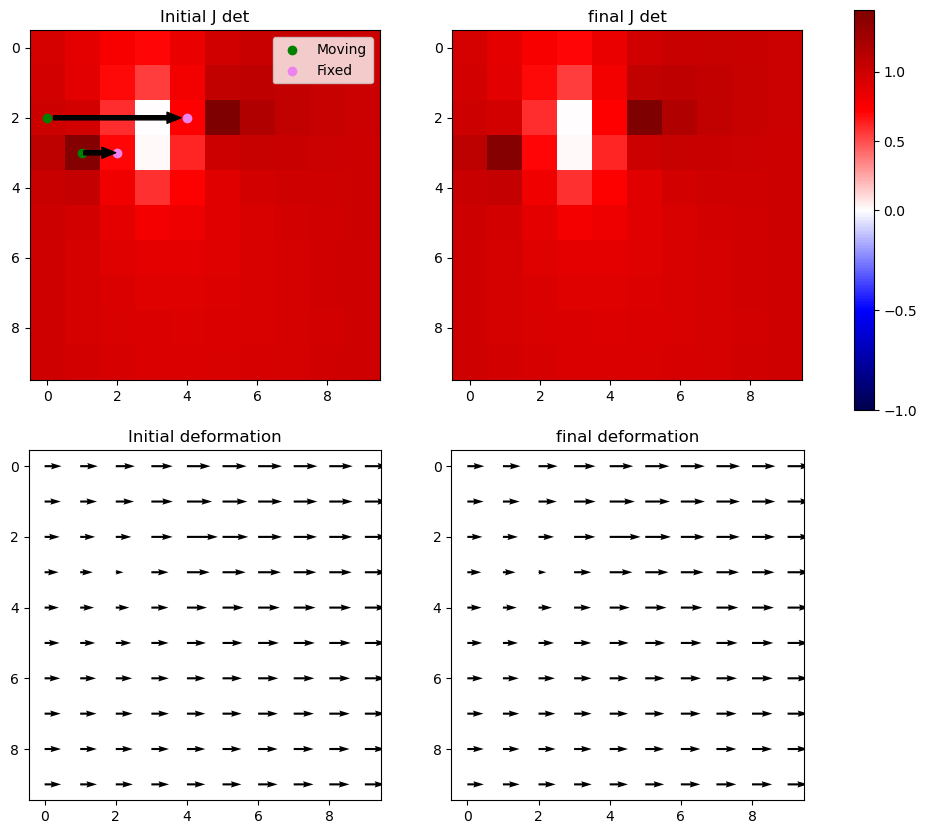

In [14]:
msample = np.array([
    [0, 2, 0],
    [0, 3, 1],
])
fsample = np.array([
    [0, 2, 4],
    [0, 3, 2],
])

fixed_sample = np.zeros((1, 10, 10))
#test_grad(fixed_sample, msample, fsample)
#test_scipy(fixed_sample, msample, fsample)
#red_test_scipy(fixed_sample, msample, fsample)
run_lapl_and_correction(fixed_sample, msample, fsample)

## Some more testcases

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Iter 1: Fixing index (10, 36)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.53923038414589
            Iterations: 18
            Function evaluations: 929
            Gradient evaluations: 18
Iter 1: For index (10, 36), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.3746802993778986
            Iterations: 7
            Function evaluations: 693
            Gradient evaluations: 7
Iter 1 with 7 -ve jacs
Iter 2: Fixing index (11, 5)
(50,) [0, 25, 1, 

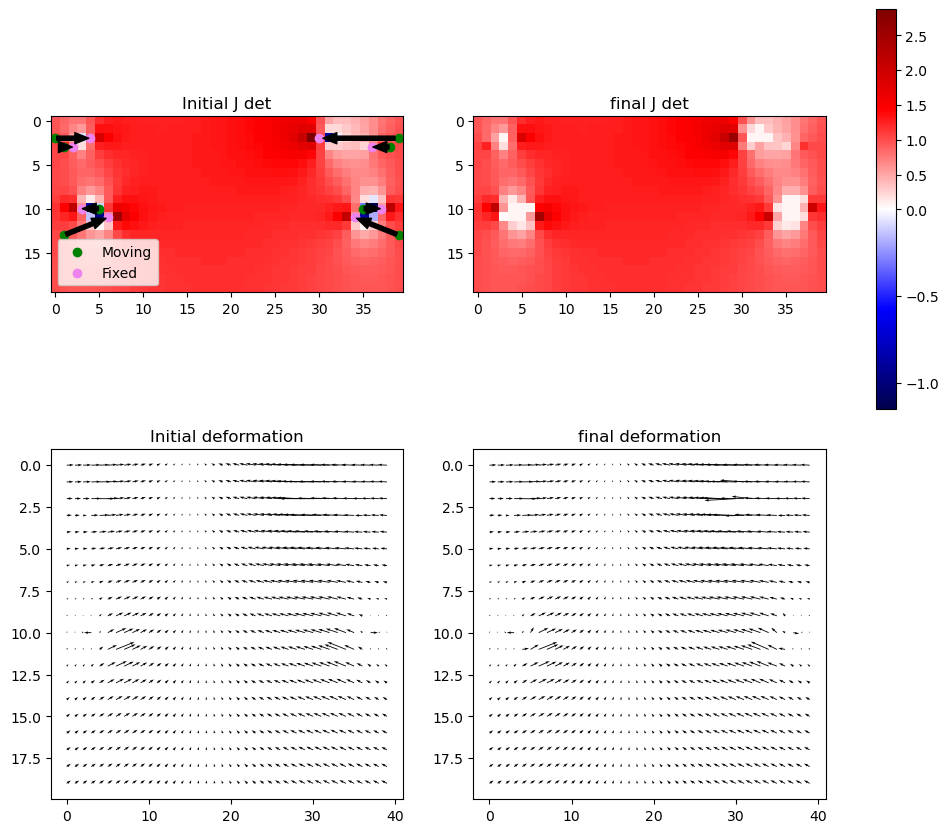

In [15]:
msample = np.array([
    [0, 2, 0],
    [0, 3, 1],
    [0, 10, 5],
    [0, 13, 1],
    [0, 2, 39],
    [0, 3, 38],
    [0, 10, 35],
    [0, 13, 39],
])
fsample = np.array([
    [0, 2, 4],
    [0, 3, 2],
    [0, 10, 3],
    [0, 11, 6],
    [0, 2, 30],
    [0, 3, 36],
    [0, 10, 37],
    [0, 11, 34]
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

## This one takes really long

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)



Iter 1: Fixing index (15, 11)
Is at edge: False, start_y: 13, end_y: 17, start_x: 9, end_x: 13, max_y: 19, max_x: 39
Edge mask for submatrix size 5:
[[ True  True  True  True  True]
 [ True False False False  True]
 [ True False False False  True]
 [ True False False False  True]
 [ True  True  True  True  True]]
NOT AT EDGE
Fixed indices
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Constraints: [<scipy.optimize._constraints.NonlinearConstraint object at 0x0000027D0DFE5280>, <scipy.optimize._constraints.LinearConstraint object at 0x0000027D0DFE5D90>]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.527517887782386
            Iterations: 28
            Function evaluations: 1429
            Gradient evaluations: 28
Jacobian submatrix:
array([[[ 0.97181237,  0.74

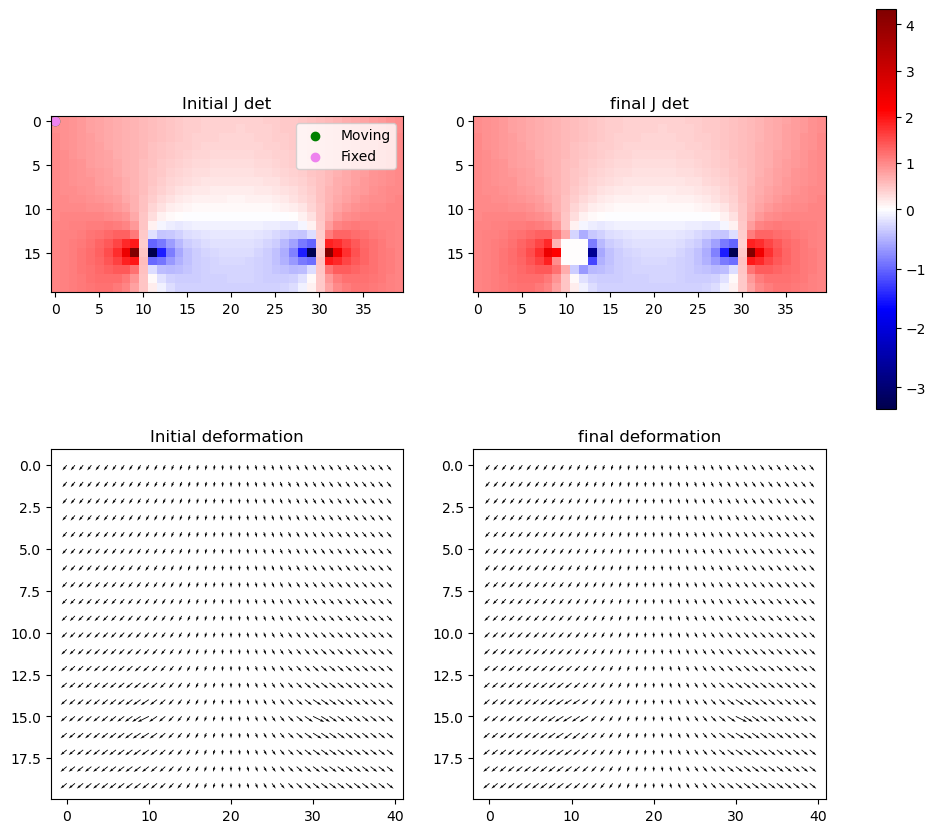


Continue flags:
True
y_start: 13, y_end: 18, x_start: 9, x_end: 14
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[ 1.14442211,  0.73109665, -0.28374772, -0.54064837, -0.3582814 ],
       [ 0.6188105 ,  0.01      ,  0.01000002,  0.01      , -0.86457805],
       [ 2.14666025,  0.00999984,  0.01000003,  0.01000013, -2.69446531],
       [ 0.94849296,  0.00999988,  0.01000002,  0.01000009, -1.21750976],
       [ 1.19796346,  0.69701044, -0.32999071, -0.67806606, -0.46429928]])
Min jacobian value in submatrix: -1.8689609786274446

Iter 1: For index (15, 11), window size increased to 7 at iter 2
Is at edge: False, start_y: 12, end_y: 18, start_x: 8, end_x: 14, max_y: 19, max_x: 39
Edge mask for submatrix size 7:
[[ True  True  True  True  True  True  True]
 [ True False False False False False  True]
 [ True False False False False False  True]
 [ True False False False False False  True]


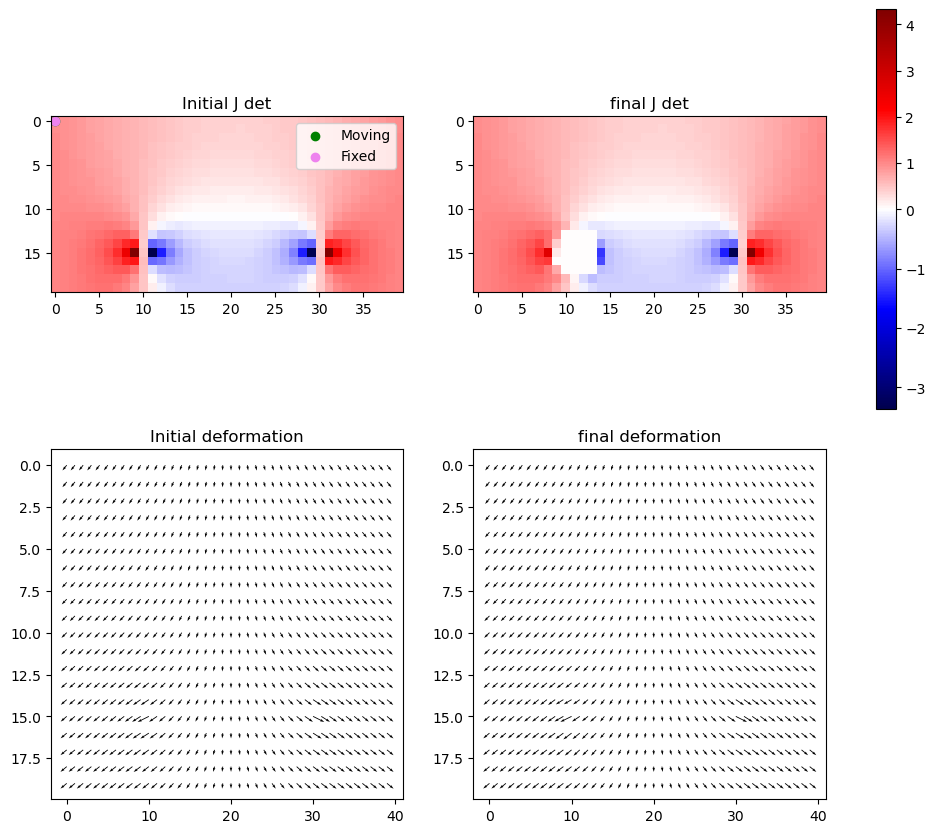


Continue flags:
True
y_start: 12, y_end: 19, x_start: 8, x_end: 15
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[ 1.04499343,  0.89070352,  0.61055775,  0.18504256, -0.06318082, -0.13728528, -0.13664471],
       [ 1.24414616,  0.87761069,  0.01000002,  0.00999999,  0.01      ,  0.01      , -0.2526032 ],
       [ 1.24138491,  0.40911126,  0.01000001,  0.01000002,  0.01      ,  0.00999999, -0.63495993],
       [ 2.66106513,  0.19032897,  0.01000008,  0.01000002,  0.01      ,  0.00999993, -1.33764526],
       [ 1.65835341,  0.00999999,  0.01000002,  0.01000002,  0.01000006,  0.01000001, -1.19859528],
       [ 1.1727964 ,  0.71352868,  0.00999998,  0.01      ,  0.00999999,  0.00999998, -0.43000911],
       [ 1.13798539,  0.99577622,  0.5954135 ,  0.07264927, -0.24987284, -0.42899097, -0.34035232]])
Min jacobian value in submatrix: -0.6067799087199965

Iter 1: For index (15, 11), window

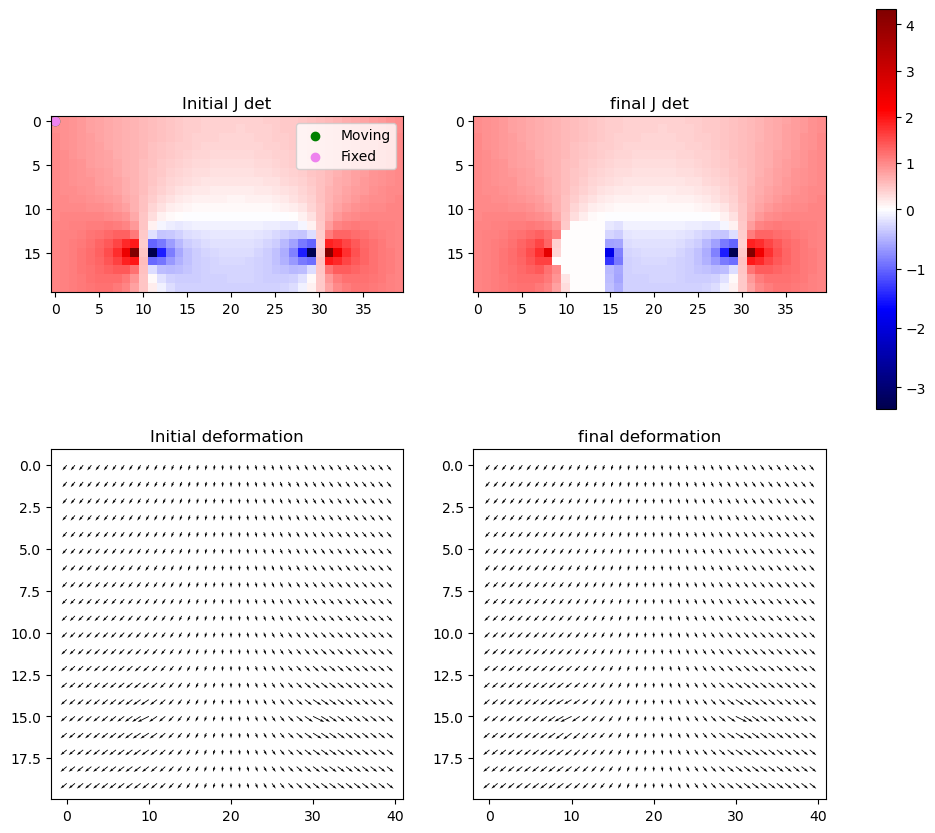


Continue flags:
False
y_start: 11, y_end: 20, x_start: 7, x_end: 16
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[ 0.96892011,  0.88246854,  0.72742636,  0.50094487,  0.30042489,  0.13558107,  0.04123962,  0.00819261, -0.00800879],
       [ 1.11197337,  1.04499343,  0.90795892,  0.44151278,  0.01733531,  0.01      ,  0.01      ,  0.01      , -0.13878495],
       [ 1.32180163,  1.24255253,  1.05703153,  0.01      ,  0.01      ,  0.01000001,  0.01000002,  0.01      , -0.28533715],
       [ 1.58455338,  1.31801541,  0.37225912,  0.01      ,  0.01      ,  0.00999999,  0.00999999,  0.01      , -0.61587459],
       [ 1.7856424 ,  2.58379529,  0.33888672,  0.01000006,  0.00999999,  0.00999997,  0.01      ,  0.01      , -1.87484501],
       [ 1.61168391,  1.62091191,  0.00999997,  0.00999994,  0.01000001,  0.01      ,  0.01000004,  0.01000008, -1.33632234],
       [ 1.39278675,  1.1925344

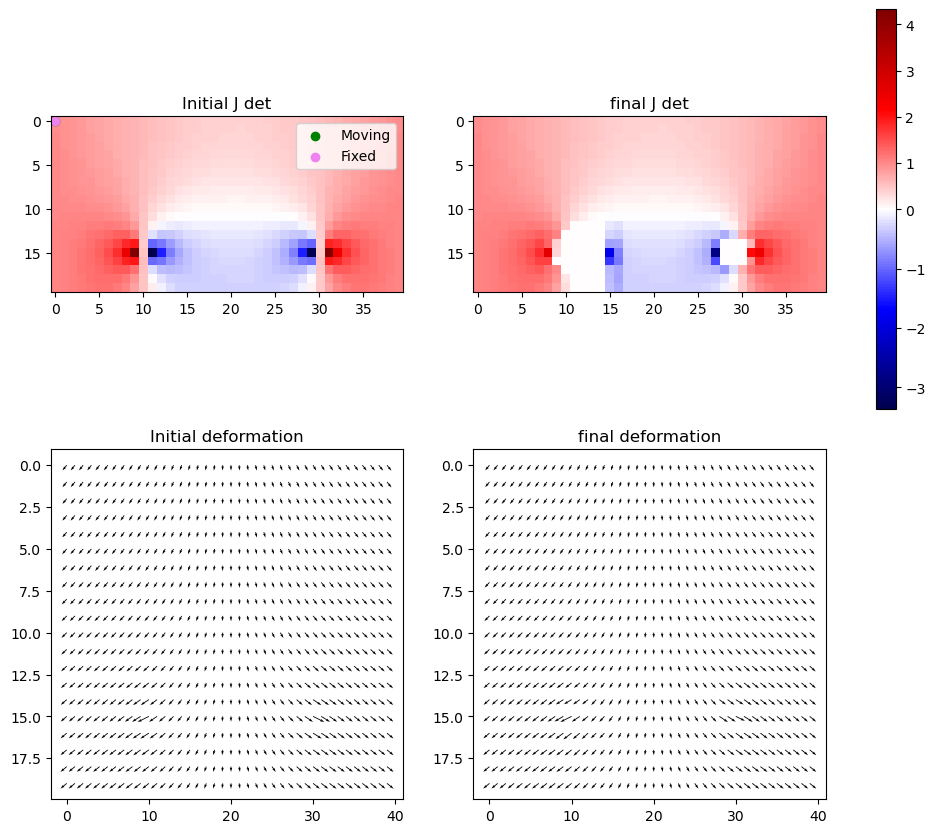


Continue flags:
True
y_start: 13, y_end: 18, x_start: 27, x_end: 32
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[-0.36073009, -0.55096893, -0.24495597,  0.69107345,  1.11168246],
       [-0.8604771 ,  0.00999995,  0.00999998,  0.01000004,  0.58394563],
       [-2.83603949,  0.01000004,  0.01      ,  0.00999998,  2.07639017],
       [-1.20430548,  0.01      ,  0.01      ,  0.01      ,  0.92293339],
       [-0.45127749, -0.66531268, -0.23582704,  0.65776999,  1.15862799]])
Min jacobian value in submatrix: -2.011615643654425

Iter 2: For index (15, 29), window size increased to 7 at iter 2
Is at edge: False, start_y: 12, end_y: 18, start_x: 26, end_x: 32, max_y: 19, max_x: 39
Edge mask for submatrix size 7:
[[ True  True  True  True  True  True  True]
 [ True False False False False False  True]
 [ True False False False False False  True]
 [ True False False False False False  True]

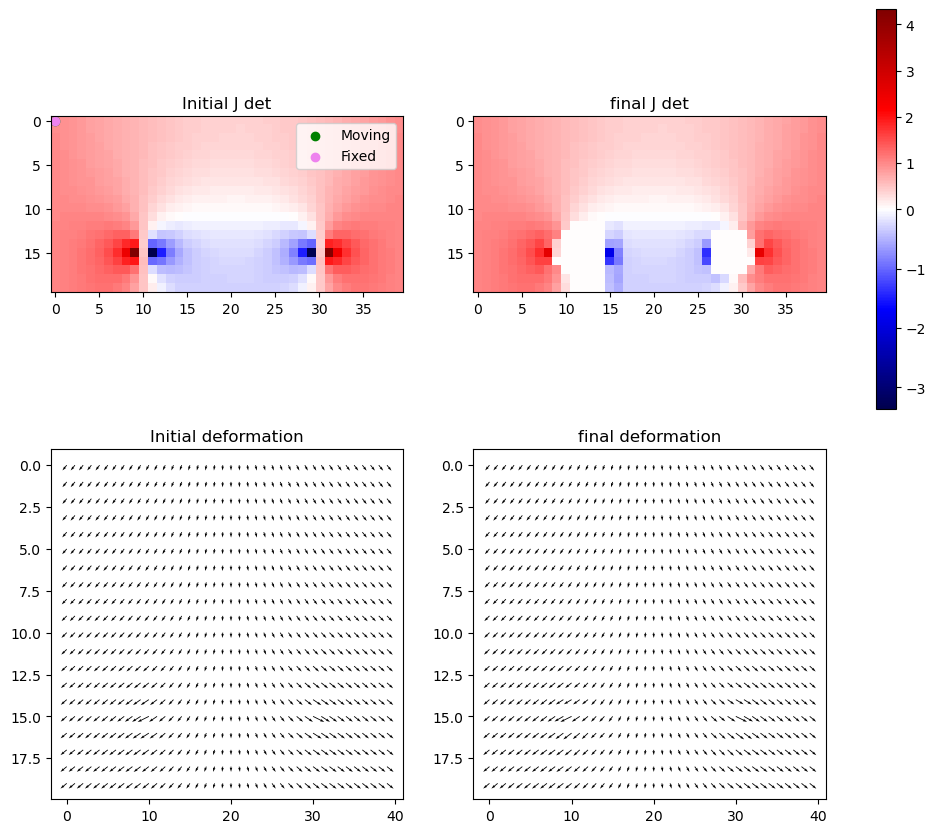


Continue flags:
True
y_start: 12, y_end: 19, x_start: 26, x_end: 33
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[-0.14055901, -0.14451169, -0.07503722,  0.16006745,  0.57876279,  0.86799673,  1.02435126],
       [-0.26175742,  0.01      ,  0.00999998,  0.01      ,  0.01      ,  0.81807879,  1.20291227],
       [-0.68027071,  0.00999991,  0.01      ,  0.00999998,  0.00999999,  0.39934482,  1.20679849],
       [-1.38671317,  0.01      ,  0.01000021,  0.00999999,  0.01000004,  0.18242239,  2.56654185],
       [-1.19508224,  0.00999995,  0.00999999,  0.01      ,  0.01      ,  0.00999989,  1.60820902],
       [-0.41872878,  0.01      ,  0.01000001,  0.01000001,  0.01000003,  0.7237716 ,  1.1327009 ],
       [-0.33188212, -0.41115665, -0.24927514,  0.05441638,  0.54849661,  0.97328069,  1.1026359 ]])
Min jacobian value in submatrix: -0.6539984102116122

Iter 2: For index (15, 29), windo

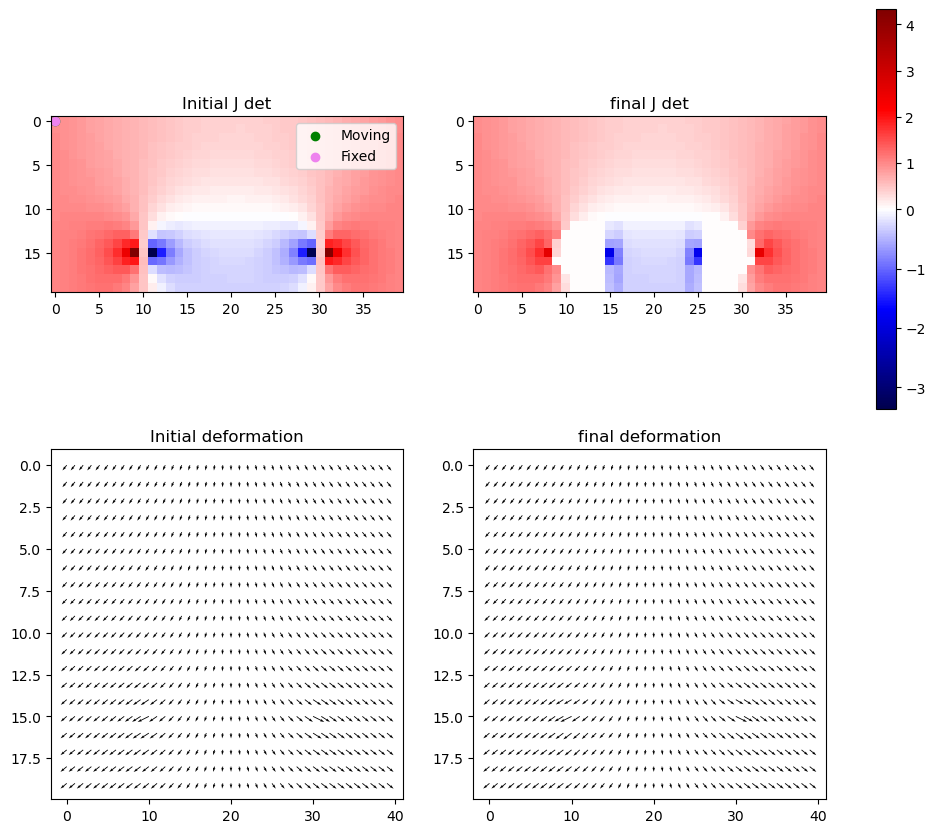


Continue flags:
False
y_start: 11, y_end: 20, x_start: 25, x_end: 34
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[-0.01587553,  0.00514438,  0.03116317,  0.11511681,  0.27950901,  0.48091094,  0.70462196,  0.86493087,  0.95972603],
       [-0.15155102,  0.01      ,  0.01      ,  0.01      ,  0.01      ,  0.40117024,  0.87387266,  1.02435126,  1.09953651],
       [-0.30241926,  0.01      ,  0.01000001,  0.01000001,  0.01      ,  0.01      ,  1.00815419,  1.20276707,  1.30305384],
       [-0.6300225 ,  0.01      ,  0.00999997,  0.01      ,  0.00999999,  0.01      ,  0.28901796,  1.27069585,  1.55824524],
       [-1.84283007,  0.01000002,  0.01      ,  0.00999996,  0.01000001,  0.01000002,  0.31260275,  2.53992371,  1.75171875],
       [-1.32136815,  0.00999999,  0.01000002,  0.01000001,  0.01000003,  0.00999998,  0.00999999,  1.5768626 ,  1.57880737],
       [-0.46591151,  0.01    

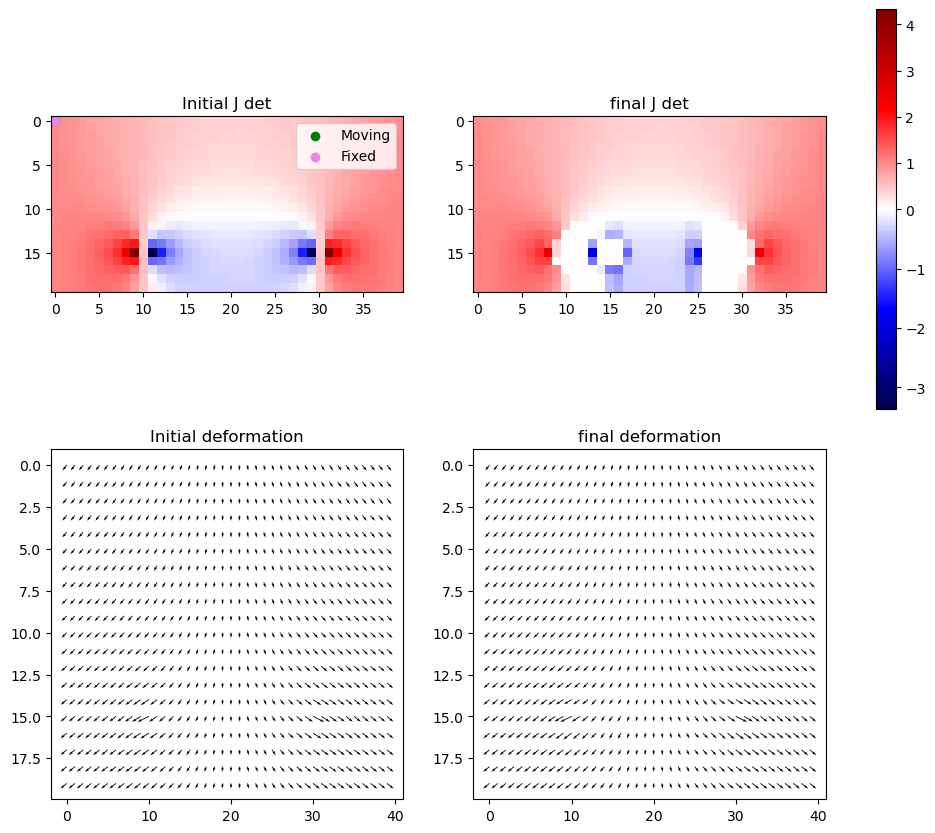


Continue flags:
True
y_start: 13, y_end: 18, x_start: 13, x_end: 18
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[ 0.01000002, -0.07622993, -0.54173738, -0.49410579, -0.15798186],
       [-0.61369398,  0.01000001,  0.0099999 ,  0.01000001, -0.4822387 ],
       [-1.97793785,  0.01000004,  0.00999996,  0.01000007, -1.01185511],
       [-0.91800516,  0.01000001,  0.00999999,  0.01000001, -0.54786881],
       [ 0.01000002, -0.13461374, -0.8532107 , -0.92611008, -0.30307801]])
Min jacobian value in submatrix: -0.9271954470030298

Iter 3: For index (15, 15), window size increased to 7 at iter 2
Is at edge: False, start_y: 12, end_y: 18, start_x: 12, end_x: 18, max_y: 19, max_x: 39
Edge mask for submatrix size 7:
[[ True  True  True  True  True  True  True]
 [ True False False False False False  True]
 [ True False False False False False  True]
 [ True False False False False False  True

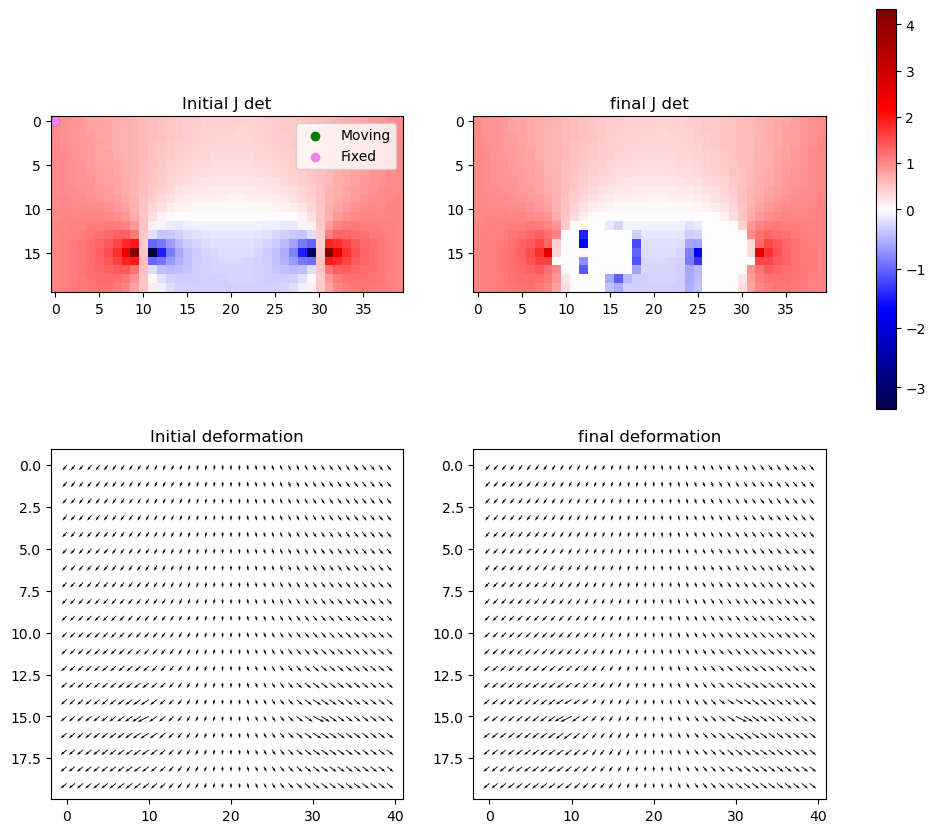


Continue flags:
True
y_start: 12, y_end: 19, x_start: 12, x_end: 19
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[ 0.01      , -0.01700096,  0.01390978, -0.14172239, -0.28613812, -0.08938425, -0.08164137],
       [-1.45279457,  0.00999999,  0.01      ,  0.01000005,  0.01      ,  0.01000002, -0.32391205],
       [-1.67622965,  0.01      ,  0.00999998,  0.01      ,  0.0099999 ,  0.01      , -1.20299919],
       [-0.04319081,  0.01000001,  0.01      ,  0.00999998,  0.01000001,  0.01000003, -1.04845464],
       [-0.74468698,  0.01      ,  0.01000001,  0.00999999,  0.01000004,  0.01000003, -1.15320103],
       [-1.0962868 ,  0.01000001,  0.01      ,  0.00999996,  0.00999997,  0.01      , -0.58721102],
       [ 0.01000002, -0.02512387,  0.01630314, -0.57551017, -1.07027412, -0.45849776, -0.29496744]])
Min jacobian value in submatrix: -1.070256065048734

Iter 3: For index (15, 15), window

KeyboardInterrupt: 

In [38]:
msample = np.array([
    [0, 5, 10],
    [0, 5, 30],
])
fsample = np.array([
    [0, 15, 30],
    [0, 15, 10],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

# 600 iterations
# 83min - final size 9x9

In [ ]:
msample = np.array([
    [0, 5, 10],
    [0, 15, 10],
])
fsample = np.array([
    [0, 15, 30],
    [0, 5, 30],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

In [ ]:
msample = np.array([
    [0, 5, 10],
    [0, 5, 30],
])
fsample = np.array([
    [0, 15, 30],
    [0, 15, 10],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

# not all iterations take the same time?
# Iter 1 Optimisation for index 611 completed in 0.7802479267120361s
# Iter 635 Optimisation for index 693 completed in 278.3064708709717s
# Iter 573 Optimisation for index 494 completed in 63.11005783081055s
# total time 175m - unfinished

In [ ]:
msample = np.array([
    [0, 2, 10],
    [0, 3, 5],
    [0, 6, 4],
    [0, 11, 5],
    [0, 15, 7],
    [0, 19, 12],
    [0, 15, 15],
    [0, 13, 22],
    [0, 19, 22],
    [0, 19, 27],
    [0, 15, 30],
    [0, 12, 33],
    [0, 10, 38],
    [0, 4, 37],
    [0, 6, 30],
    [0, 1, 33],
    [0, 5, 26],
    [0, 2, 23],
    [0, 1, 19],
    [0, 2, 14],
])
fsample = np.array([
    [0, 1, 7],
    [0, 5, 11],
    [0, 6, 1],
    [0, 15, 1],
    [0, 12, 2],
    [0, 16, 14],
    [0, 18, 17],
    [0, 15, 20],
    [0, 16, 24],
    [0, 19, 27],
    [0, 18, 34],
    [0, 17, 40],
    [0, 10, 35],
    [0, 6, 35],
    [0, 2, 34],
    [0, 3, 30],
    [0, 2, 26],
    [0, 2, 23],
    [0, 3, 20],
    [0, 2, 14],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

In [ ]:
# data analysis

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

mpoints, fpoints = correspondences.downsample_points(mpoints_path, fpoints_path, debug=False)
#print(mpoints.shape, fpoints.shape) 

fixed_sample = np.zeros((1, 20, 40))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 1

# use 
mask = mpoints[:,0]==slice_no
new_mpoints = mpoints[mask].copy()
new_mpoints[:,0] = 0

mask = fpoints[:,0]==slice_no
new_fpoints = fpoints[mask].copy()
new_fpoints[:,0] = 0

print(new_mpoints.shape, new_fpoints.shape)


#test_grad(fixed_sample, msample, fsample)
#red_test_scipy(fixed_sample, new_mpoints[:5], new_fpoints[:5])
run_lapl_and_correction(fixed_sample, new_mpoints, new_fpoints)

## Real slice

In [ ]:
# data analysis

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

mpoints, fpoints = correspondences.downsample_points(mpoints_path, fpoints_path, debug=False)
#print(mpoints.shape, fpoints.shape) 

deformation_field_path = "data/base_unique_correspondences/registered_output/deformation3d.npy"
deformation_field = np.load(deformation_field_path)

# select a slice
def_shape = deformation_field.shape
print(def_shape)
deformation_i = deformation_field[:, 349].reshape((def_shape[0], 1, def_shape[2], def_shape[3]))
print(deformation_i.shape)
# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 0

# use 
mask = mpoints[:,0]==slice_no
new_mpoints = mpoints[mask].copy()
new_mpoints[:,0] = 0

mask = fpoints[:,0]==slice_no
new_fpoints = fpoints[mask].copy()
new_fpoints[:,0] = 0

print(new_mpoints.shape, new_fpoints.shape)

phi_corrected, jacobians = iterative_with_jacobians2(deformation_i)
plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
# kept running for 450min

# Real data 350

## 0.3

deformation shape: (3, 1, 96, 136)
deformation_i shape: (3, 1, 96, 136), phi_init shape: (2, 96, 136)



Iter 1: Fixing index (68, 63)
Iter 1: For index (68, 63), window size increased to 9 at iter 1
Is at edge: False, start_y: 64, end_y: 72, start_x: 59, end_x: 67, max_y: 95, max_x: 135
Edge mask for submatrix size 9:
[[ True  True  True  True  True  True  True  True  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True  True  True  True  True  True  True  True  True]]
NOT AT EDGE
Fixed indices
(162,) [0, 81, 1, 82, 2, 83, 3, 84, 4, 85, 5, 86, 6, 87, 7, 88, 8, 89, 9, 90, 17, 98, 18, 99, 26, 107, 27, 108, 35, 116, 36, 117, 44, 125, 

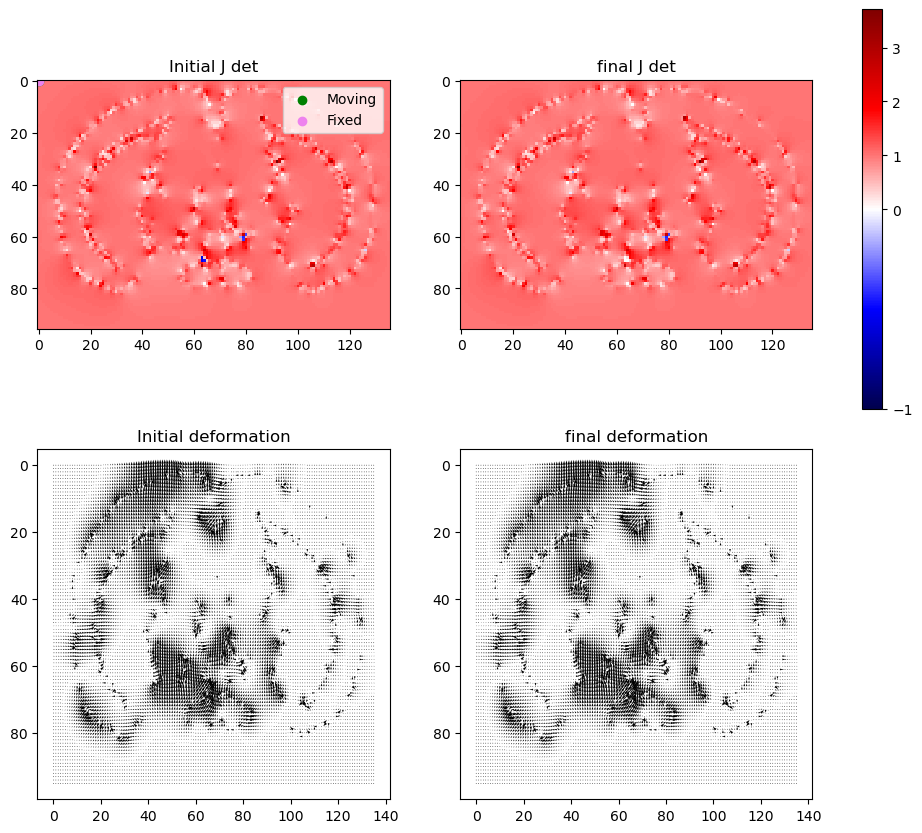


Continue flags:
False
y_start: 64, y_end: 73, x_start: 59, x_end: 68
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[1.02765493, 1.08708642, 1.20598107, 1.40725412, 1.6724692 , 1.7294845 , 1.14410876, 1.03389745, 1.01713995],
       [0.93255418, 0.99154212, 1.09108027, 1.26194423, 1.59808989, 2.49618013, 1.77028312, 1.42148719, 1.25643734],
       [0.81857326, 0.86957858, 0.92117005, 0.9700116 , 0.87841027, 1.77290809, 2.0554982 , 1.66773812, 1.4475033 ],
       [0.73555928, 0.7619447 , 0.77255048, 1.00302175, 0.63910046, 1.21056838, 1.86603069, 1.70017066, 1.53707927],
       [0.67454105, 0.67883417, 0.53347694, 0.54917085, 0.00999987, 0.24333419, 1.79804984, 1.66333585, 1.54427174],
       [0.61199396, 0.61075125, 0.7255035 , 0.97610262, 0.01      , 0.01000002, 0.35657726, 1.18136799, 1.44596935],
       [0.50921927, 0.46039404, 0.48221273, 1.31694792, 1.55753531, 1.29854304, 1.02

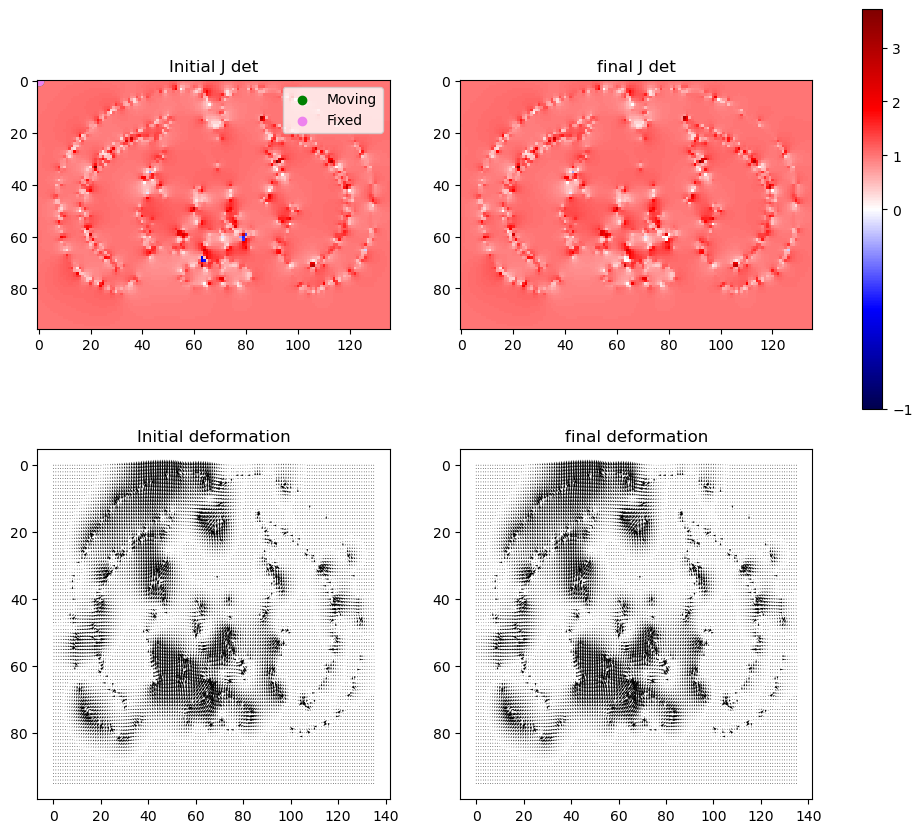


Continue flags:
False
y_start: 56, y_end: 65, x_start: 75, x_end: 84
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[0.9706564 , 2.09556781, 1.12060858, 0.89300332, 0.89542852, 0.91357014, 0.97438724, 1.08687433, 1.00493248],
       [0.43037015, 0.71160352, 0.70880929, 0.62476653, 0.8392697 , 0.70207705, 0.91969002, 0.92478057, 1.01381198],
       [1.06368348, 0.28889408, 0.30336826, 0.53229858, 0.78788667, 0.61523819, 0.76711716, 0.64665867, 0.54796765],
       [0.73722089, 0.39803869, 0.52630913, 1.05361449, 2.31300847, 0.01      , 0.58559333, 0.73647774, 0.52747397],
       [0.71658286, 0.67979884, 0.74191093, 0.01      , 0.01000003, 0.56226266, 0.99705241, 1.15299723, 1.12300762],
       [0.75597948, 0.78607516, 0.75625556, 0.66961752, 0.00999992, 1.72687006, 1.45922153, 1.21527978, 1.06891157],
       [0.86810443, 0.94814818, 1.03950869, 1.24682724, 2.08182185, 1.78870389, 1.34

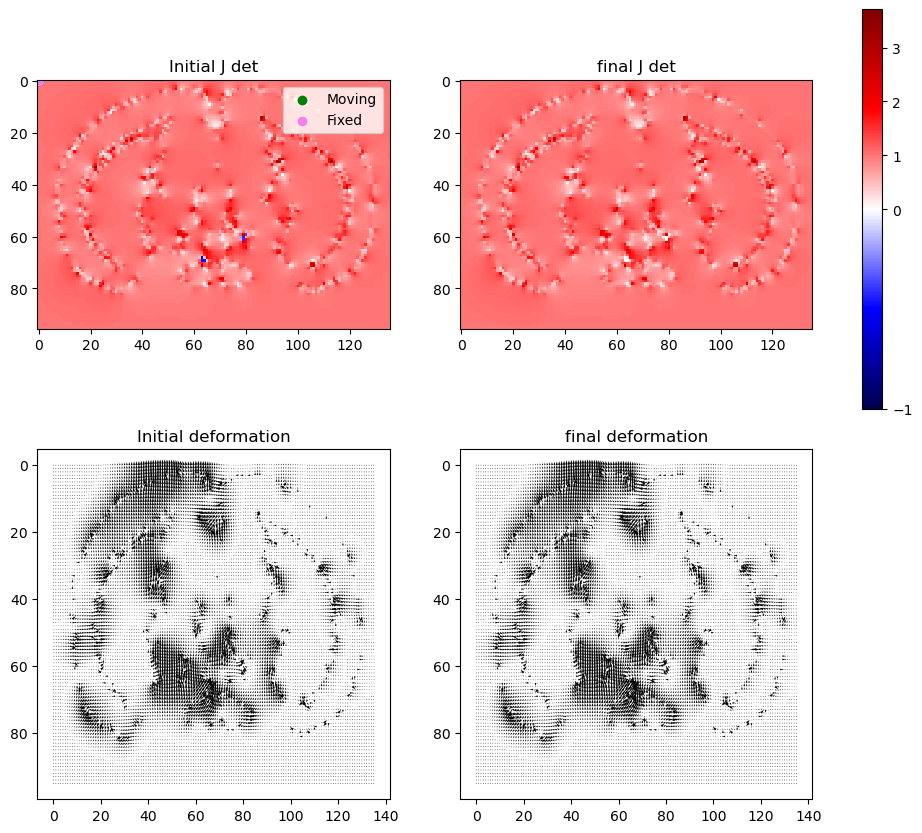


Continue flags:
False
y_start: 31, y_end: 40, x_start: 39, x_end: 48
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[0.99504423, 1.0129692 , 1.04742022, 1.09976643, 1.13878214, 1.0747589 , 1.04992958, 1.27954296, 0.9818739 ],
       [0.97144881, 0.97938336, 1.01163527, 1.09570676, 1.20785733, 0.91220976, 0.87250268, 0.8672237 , 0.94993158],
       [0.94139604, 0.91964051, 0.91330474, 1.03625514, 1.62447729, 0.95948007, 0.63482429, 0.77444462, 0.9092258 ],
       [0.91853873, 0.83958297, 0.66512284, 0.36186564, 0.62225141, 0.57372396, 0.11657788, 0.7074608 , 0.91662016],
       [0.94406945, 0.85238056, 0.5732316 , 0.16103505, 0.0099996 , 0.36711324, 0.68397462, 1.025866  , 1.04581232],
       [1.04637429, 1.08495551, 0.77811212, 0.67531096, 1.04610137, 1.67389127, 1.19409451, 1.24691915, 1.16131136],
       [1.18244398, 1.85905454, 1.90025377, 0.76894872, 1.31762512, 1.59782572, 0.95

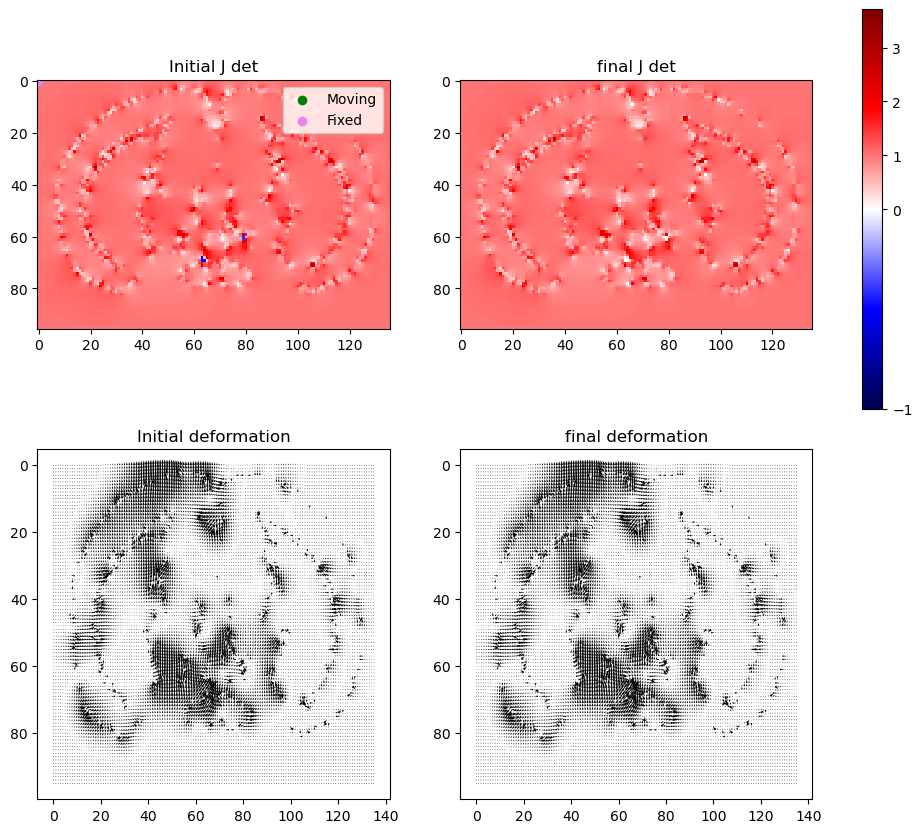


Continue flags:
False
y_start: 61, y_end: 70, x_start: 122, x_end: 131
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[0.99865892, 0.99432397, 0.99441202, 0.9941037 , 0.97726104, 0.48108119, 0.65943759, 1.19638423, 1.03167367],
       [0.98836671, 0.99347026, 1.00808889, 1.02993185, 0.99368244, 0.3895642 , 0.64148258, 0.91685611, 0.97695638],
       [0.97623289, 0.98393454, 1.01492777, 1.12621092, 1.43299895, 0.7840131 , 0.74972134, 0.90640326, 0.96790071],
       [0.96052521, 0.95119949, 0.94498975, 1.01043373, 0.76531658, 1.02019196, 0.99980139, 0.98956913, 0.9974344 ],
       [0.95163292, 0.9185338 , 0.80337061, 0.45183894, 0.00999999, 1.02872494, 1.0574152 , 1.03996891, 1.02718022],
       [0.96783527, 0.96981019, 0.97419554, 0.58963415, 0.59450264, 1.14011192, 1.1163632 , 1.07468801, 1.05017356],
       [0.98528248, 1.02101012, 0.98356308, 0.62985399, 1.01965437, 1.17446401, 1.

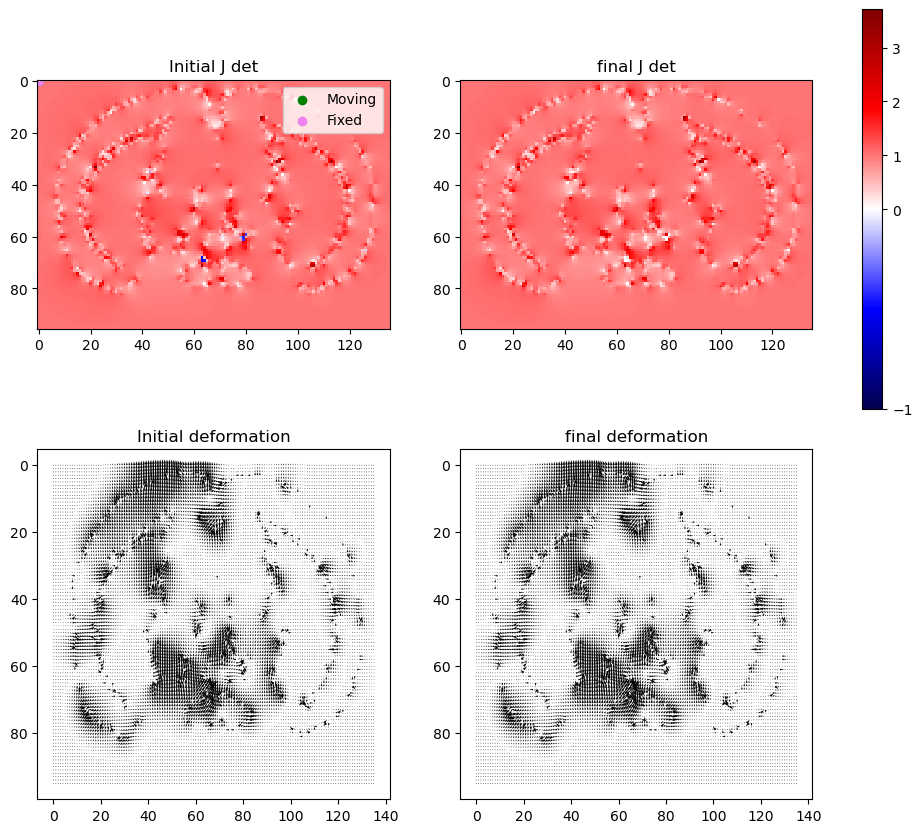


Continue flags:
False
y_start: 56, y_end: 65, x_start: 67, x_end: 76
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[1.22695884, 1.15344095, 1.0874757 , 1.0470679 , 1.13773014, 0.94198728, 0.44479653, 0.61475648, 0.9706564 ],
       [1.24943277, 1.15266853, 1.04291147, 0.84308642, 1.33443558, 1.13832973, 0.99875405, 1.44938781, 0.43038268],
       [0.94286898, 0.95079365, 0.97106711, 0.46937736, 0.95282978, 1.35143738, 1.01728157, 1.06484314, 1.06387086],
       [0.64144314, 0.70686714, 0.75171445, 0.82192382, 0.33758326, 0.60389704, 0.70942479, 0.78575348, 0.73739303],
       [0.75207444, 0.70865356, 0.64533601, 0.46634578, 0.00999981, 0.34366094, 0.5429841 , 0.67218287, 0.71674025],
       [0.70729356, 0.71944641, 0.65959103, 0.49471413, 0.1215506 , 0.3428283 , 0.4976313 , 0.65814982, 0.75613144],
       [0.7388165 , 0.77721494, 0.76963646, 0.74642415, 0.51093429, 0.43486911, 0.48

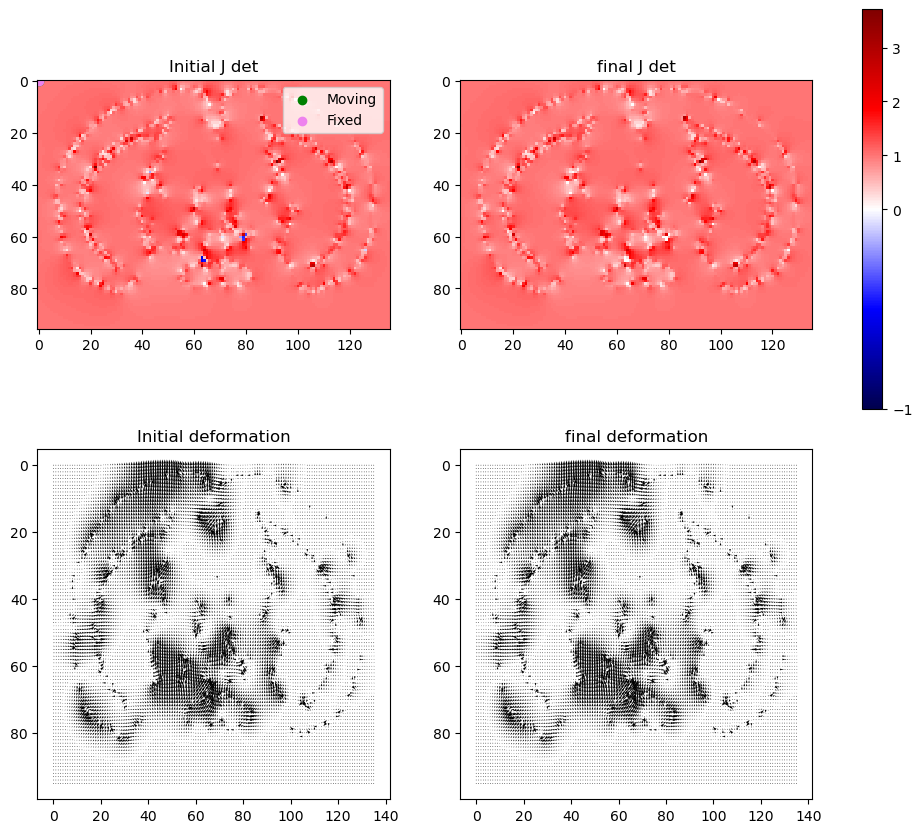


Continue flags:
False
y_start: 39, y_end: 48, x_start: 38, x_end: 47
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[0.81113587, 0.73230106, 0.54877526, 0.04649618, 0.60157993, 0.60420835, 0.4427144 , 0.49796473, 0.95238267],
       [0.76349461, 0.67888824, 0.55172938, 0.403443  , 0.5169177 , 0.57090016, 0.57801109, 0.61369381, 1.37651587],
       [0.7492862 , 0.67280343, 0.57850274, 0.48982063, 0.46556542, 0.57514422, 0.67732862, 0.84866838, 1.25819198],
       [0.75764267, 0.68715943, 0.59576616, 0.47463439, 0.37492352, 0.56682836, 0.71209507, 0.82343539, 0.84775386],
       [0.78540925, 0.72562855, 0.63270379, 0.44401678, 0.01      , 0.59856193, 0.80425094, 0.88557963, 0.87938987],
       [0.83069555, 0.80012938, 0.76141708, 0.67068933, 0.89764548, 1.1164122 , 1.04627252, 1.0380213 , 1.05277644],
       [0.87996955, 0.88739839, 0.95364078, 1.15560407, 1.81935984, 1.39227732, 1.21

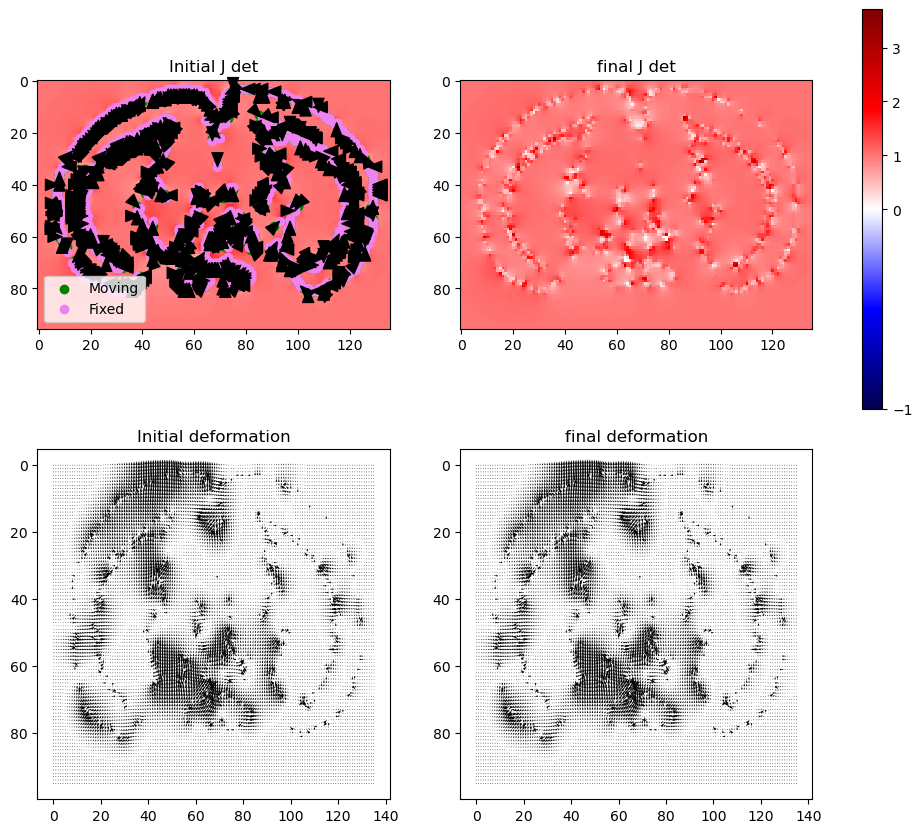

In [18]:
idx = 350
scale_factor = 0.3

mpoints_path="data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path="data/corrected_correspondences_count_touching/fpoints.npy"

##############################################################################

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)

# Filter points for the specified slice
mask_m = msample[:, 0] == idx
mask_f = fsample[:, 0] == idx

new_mpoints = msample[mask_m].copy()
new_fpoints = fsample[mask_f].copy()

new_mpoints[:, 0] = 0
new_fpoints[:, 0] = 0

downscaled_mpoints = np.round(new_mpoints[:, :] * scale_factor).astype(int)
downscaled_fpoints = np.round(new_fpoints[:, :] * scale_factor).astype(int)

fixed_sample = np.zeros((1, int(320 * scale_factor), int(456 * scale_factor)))  # Adjusted size for smaller resolution

run_lapl_and_correction(fixed_sample, downscaled_mpoints, downscaled_fpoints)

## 0.5

deformation shape: (3, 1, 160, 228)
deformation_i shape: (3, 1, 160, 228), phi_init shape: (2, 160, 228)



Iter 1: Fixing index (99, 133)
Iter 1: For index (99, 133), window size increased to 9 at iter 1
Is at edge: False, start_y: 95, end_y: 103, start_x: 129, end_x: 137, max_y: 159, max_x: 227
Edge mask for submatrix size 9:
[[ True  True  True  True  True  True  True  True  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True False False False False False False False  True]
 [ True  True  True  True  True  True  True  True  True]]
NOT AT EDGE
Fixed indices
(162,) [0, 81, 1, 82, 2, 83, 3, 84, 4, 85, 5, 86, 6, 87, 7, 88, 8, 89, 9, 90, 17, 98, 18, 99, 26, 107, 27, 108, 35, 116, 36, 117, 

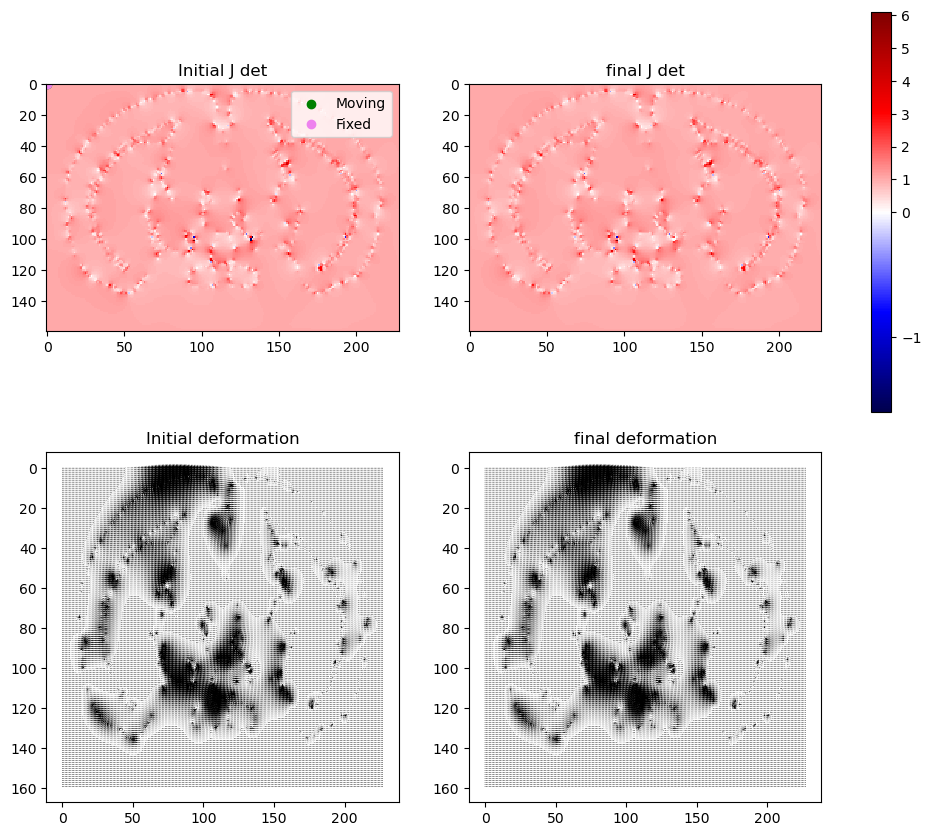


Continue flags:
False
y_start: 95, y_end: 104, x_start: 129, x_end: 138
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[ 0.86116113,  0.81017945,  0.8357265 ,  0.85061118,  0.83717588,  0.81813435,  0.7653407 ,  0.89759821,  0.99886419],
       [ 0.52204533,  0.64201879,  0.79840046,  0.86116557,  0.82958498,  0.84344178,  0.90956359,  1.08068267,  0.97275987],
       [-0.46968767,  0.47881859,  0.86132429,  0.95871955,  0.17389179,  0.79280972,  0.90984064,  1.04829723,  1.15548744],
       [ 0.19625125,  1.10080425,  1.25353938,  0.5616186 ,  0.27227457,  0.74193369,  0.84705178,  0.9909456 ,  1.02896582],
       [ 0.0919462 ,  0.96787946,  1.73408796,  2.30635198,  0.01000014,  0.33342005,  0.86884673,  1.03542989,  1.10476797],
       [ 0.46516162,  0.37095508,  0.01      ,  0.01      ,  0.01      ,  0.89522689,  1.1281709 ,  1.19108059,  1.23880127],
       [ 0.68552274,  0.712

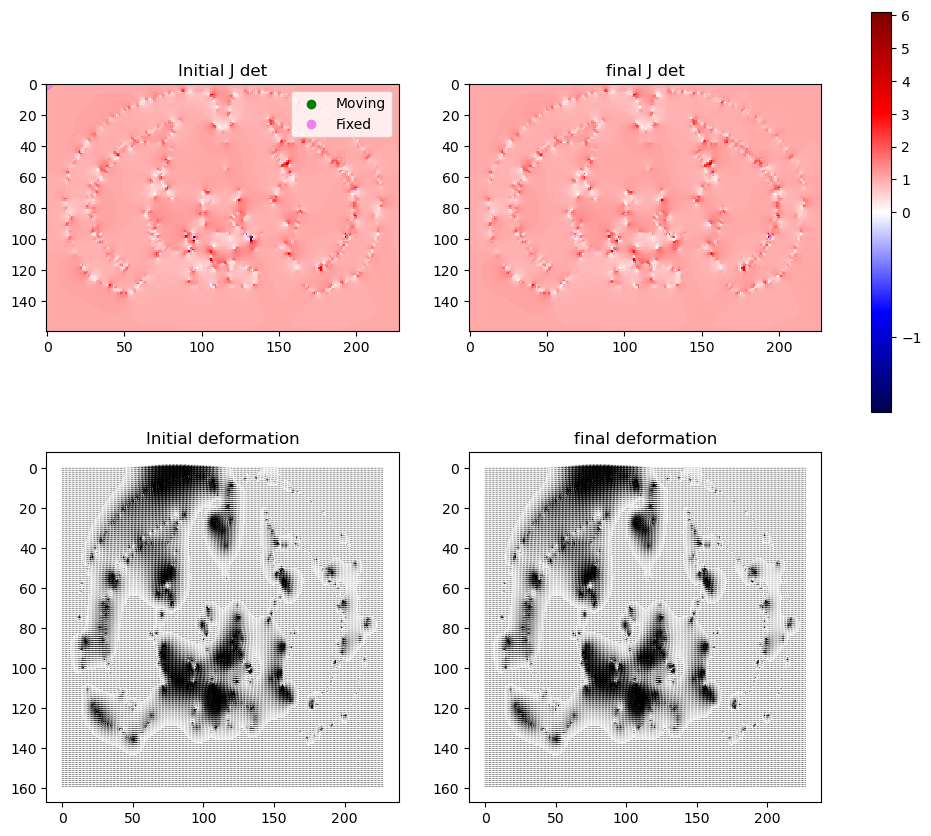


Continue flags:
False
y_start: 95, y_end: 104, x_start: 91, x_end: 100
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[1.12885812, 1.17302829, 0.56657627, 0.49982891, 0.64833165, 0.77917274, 0.86690958, 0.92071997, 0.95882479],
       [1.80516599, 1.80553014, 1.03990221, 0.19865507, 0.6028273 , 0.8134851 , 0.92310222, 0.97390751, 1.00022349],
       [1.93757279, 1.83508061, 1.56553576, 0.88154051, 0.6186438 , 0.98596028, 1.05249383, 1.05732269, 1.04826677],
       [2.66434827, 1.82667219, 1.30211104, 0.91585404, 0.60177031, 1.1675853 , 1.26661175, 1.15862468, 1.09244492],
       [1.90340399, 1.52290082, 1.26511252, 0.56035288, 0.01      , 2.49242845, 1.79124233, 1.22053355, 1.09817157],
       [1.09981297, 1.35166332, 1.34481146, 0.87475974, 1.52350351, 0.16747007, 1.37404135, 1.06367351, 1.01678978],
       [1.34287923, 1.46809835, 1.73733532, 2.60542269, 5.52754755, 0.01      , 0.

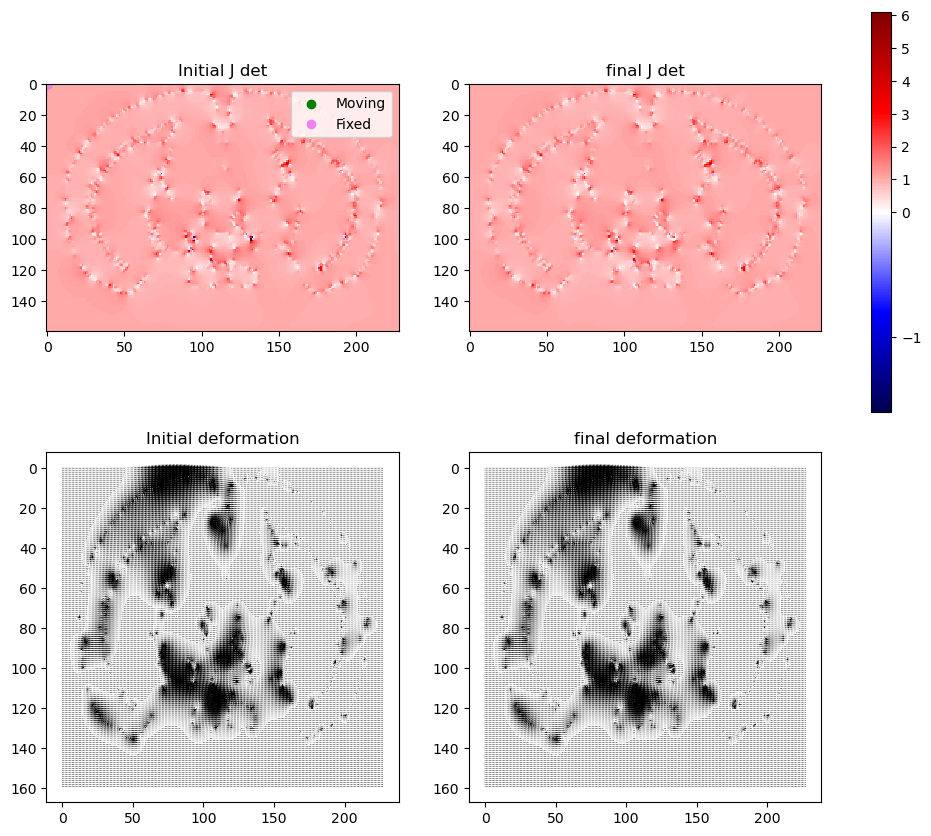


Continue flags:
False
y_start: 95, y_end: 104, x_start: 189, x_end: 198
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[1.04229633, 1.07030377, 1.1171142 , 1.17802141, 1.19697923, 0.97711679, 1.25033906, 1.33401733, 1.25173223],
       [1.01906104, 1.04941022, 1.12317454, 1.28679267, 1.53904511, 1.02675599, 1.27992501, 1.41655274, 1.21813133],
       [0.97873873, 0.98771376, 1.03566638, 1.29521016, 2.44458268, 1.2473647 , 1.38289821, 1.91077084, 1.25322302],
       [0.93020975, 0.88692255, 0.73158466, 0.2324991 , 1.21898681, 2.0191804 , 1.19499073, 1.34330083, 0.90324103],
       [0.90659313, 0.89624545, 0.89826391, 0.6362374 , 0.01      , 1.81227921, 1.03444299, 0.47521167, 0.84908121],
       [0.87278606, 0.8812613 , 1.05713598, 1.25437815, 0.67840239, 1.48959312, 0.72411626, 0.40006523, 0.92729174],
       [0.80397552, 0.72866078, 0.81817495, 0.79311475, 0.45491069, 0.70639335, 0

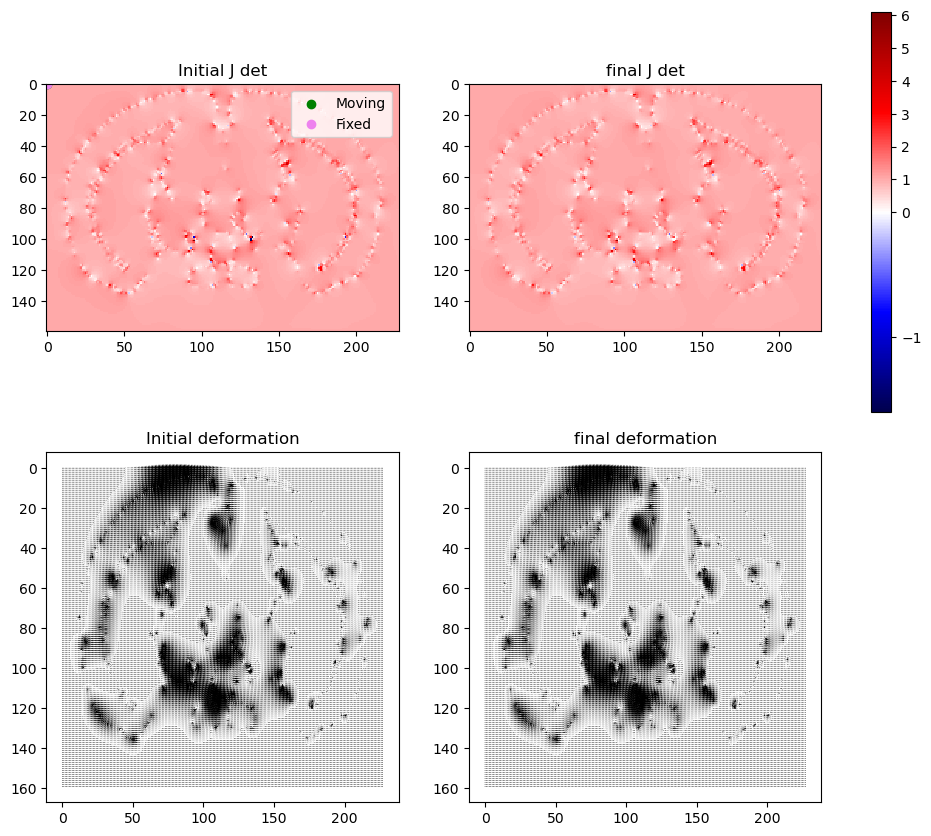


Continue flags:
False
y_start: 54, y_end: 63, x_start: 70, x_end: 79
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[0.98258748, 1.07573852, 1.22218678, 1.07307087, 0.86417051, 0.58577259, 0.87593067, 1.22767478, 1.12295358],
       [0.88834858, 1.01817789, 1.61982903, 1.15837136, 0.83253741, 0.60352022, 0.39432245, 0.82952156, 0.96351069],
       [0.67625908, 0.44915103, 0.84705699, 1.10885317, 0.47521718, 0.56689077, 0.56476211, 0.74979009, 0.88187825],
       [0.6054948 , 0.77221756, 0.21755329, 0.69401023, 0.24558346, 0.26997876, 0.55857087, 0.72970488, 0.85458021],
       [0.30201104, 0.48832986, 0.67634973, 0.46306418, 0.01      , 0.19444625, 0.57697312, 0.75799192, 0.87219487],
       [0.29597954, 0.18826221, 0.79126622, 0.98596805, 0.45031518, 0.33681294, 0.72895761, 0.86525725, 0.93231107],
       [0.63328186, 0.64671529, 1.06758101, 1.73450861, 2.18548701, 1.19917235, 1.06

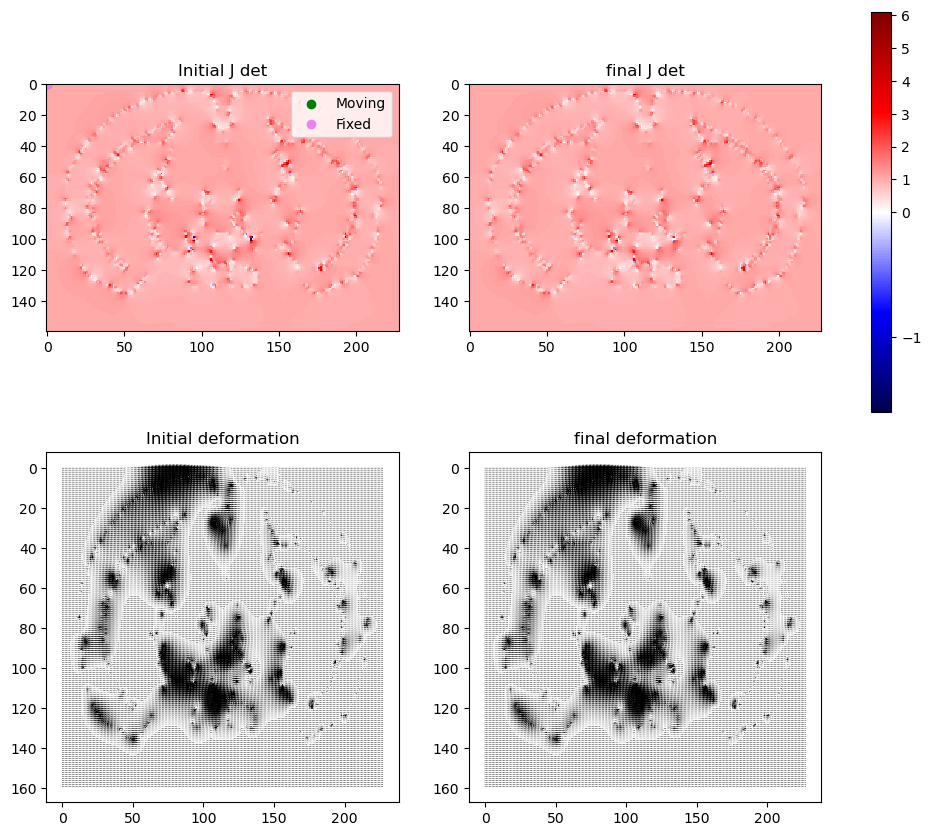


Continue flags:
True
y_start: 93, y_end: 102, x_start: 125, x_end: 134
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[ 0.89131409,  1.70587181,  1.41397137,  1.20628023,  1.05282168,  0.96107065,  0.91203701,  0.88424341,  0.86445072],
       [ 0.67661293,  1.27951557,  1.51924388,  1.21958501,  1.00696127,  0.91264576,  0.88083129,  0.8655244 ,  0.84746401],
       [ 1.00547642,  0.64224529,  1.24096513,  1.1448671 ,  0.91873321,  0.80868182,  0.83423401,  0.84906052,  0.83717588],
       [ 0.88719905,  0.76777287,  1.22317308,  1.04114393,  0.52111201,  0.71574159,  0.79696788,  0.86097987,  0.83088004],
       [ 0.91991902,  1.07833495,  1.54901297,  0.62226127,  0.01      ,  0.4768791 ,  0.68514946,  0.96033146,  0.17491735],
       [ 0.85568729,  0.90627975,  0.8760065 ,  0.01      ,  0.19398174,  1.01803883,  1.26504294,  0.54122368,  0.27313417],
       [ 0.79538694,  0.79616

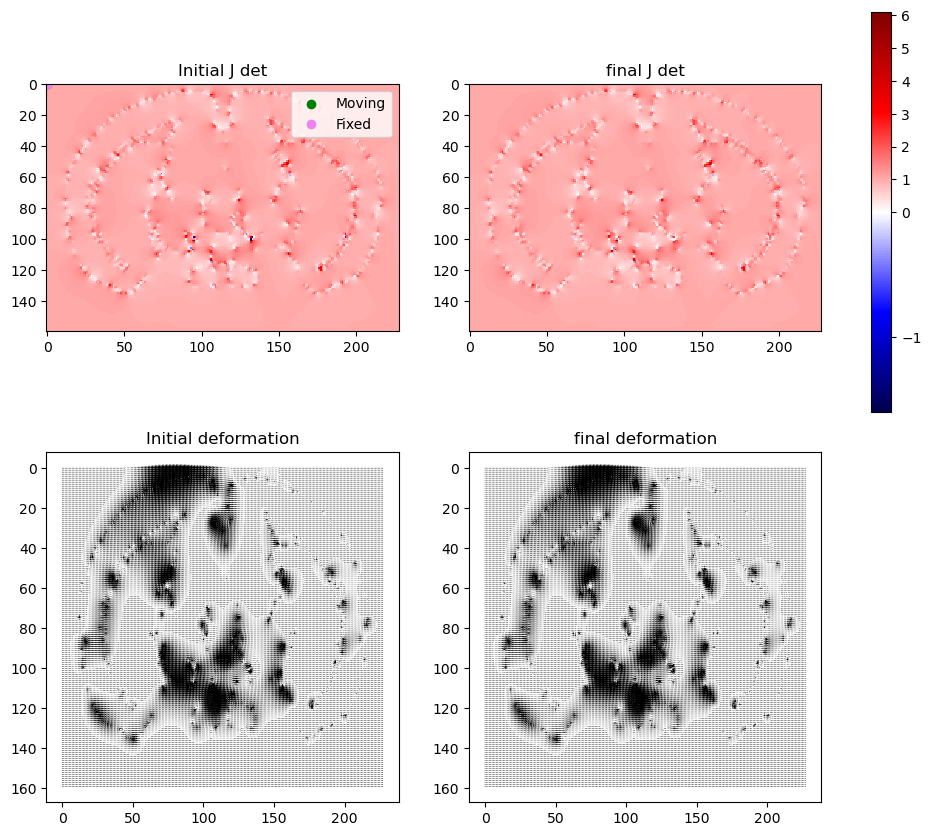


Continue flags:
False
y_start: 92, y_end: 103, x_start: 124, x_end: 135
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[0.97296334, 1.14041168, 1.35474577, 1.29312344, 1.16468551, 1.04910489, 0.96944904, 0.92168167, 0.89415147, 0.87786153, 0.8681642 ],
       [0.6631984 , 0.89131412, 1.70587179, 1.4139714 , 1.20628025, 1.0528217 , 0.96107065, 0.91203702, 0.88424342, 0.86445072, 0.84769294],
       [0.50859511, 0.67661294, 1.27951559, 1.51924387, 1.219585  , 1.00696127, 0.91264577, 0.88083126, 0.86552442, 0.847464  , 0.82445189],
       [0.73653198, 1.0054764 , 0.64224531, 1.24096513, 1.14486708, 0.91875079, 0.80868202, 0.83423418, 0.8490607 , 0.83561669, 0.81813434],
       [0.80319242, 0.88719905, 0.76777287, 1.2231731 , 1.04112622, 0.52111211, 0.71573409, 0.79696805, 0.85951238, 0.82923327, 0.84463526],
       [0.82335464, 0.91991903, 1.07833495, 1.54900148, 0.62226128, 0.01      

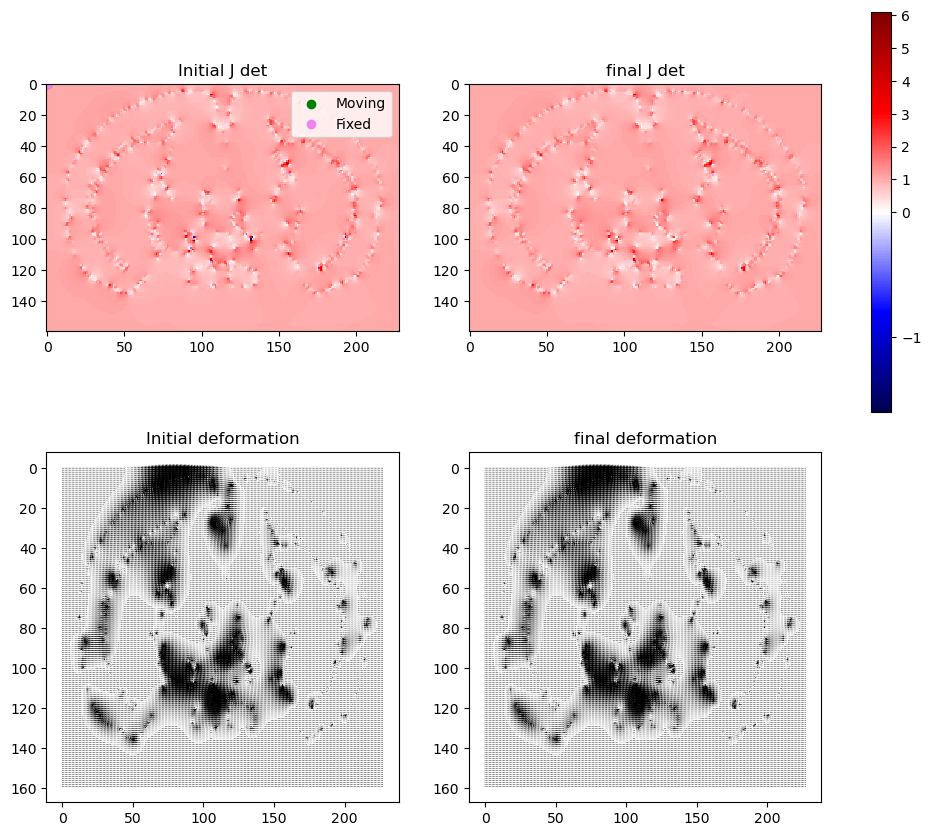


Continue flags:
True
y_start: 102, y_end: 111, x_start: 89, x_end: 98
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: True
array([[7.71846258e-01, 5.67630073e-01, 9.46287214e-01, 1.44283865e+00, 1.55633249e+00, 1.91386166e+00, 2.22295445e+00, 5.25581530e-01, 5.24786790e-01],
       [7.61457265e-01, 6.10878388e-01, 4.39101363e-01, 9.11991690e-01, 1.14438947e+00, 1.37701718e+00, 1.40654527e+00, 8.67814453e-01, 7.99495822e-01],
       [8.04224506e-01, 7.10203359e-01, 6.42620926e-01, 7.11006756e-01, 7.35159043e-01, 1.11044406e+00, 1.20048947e+00, 1.05845165e+00, 9.75364611e-01],
       [8.63476489e-01, 7.79333647e-01, 6.64719192e-01, 4.23246286e-01, 4.45528481e-01, 1.20067766e+00, 1.23302001e+00, 1.17151126e+00, 1.09280502e+00],
       [9.52674001e-01, 8.77317183e-01, 7.20433214e-01, 2.65030421e-01, 9.99999956e-03, 1.48059719e+00, 1.50294320e+00, 1.30722728e+00, 1.17532467e+00],
       [1.10094702e+0

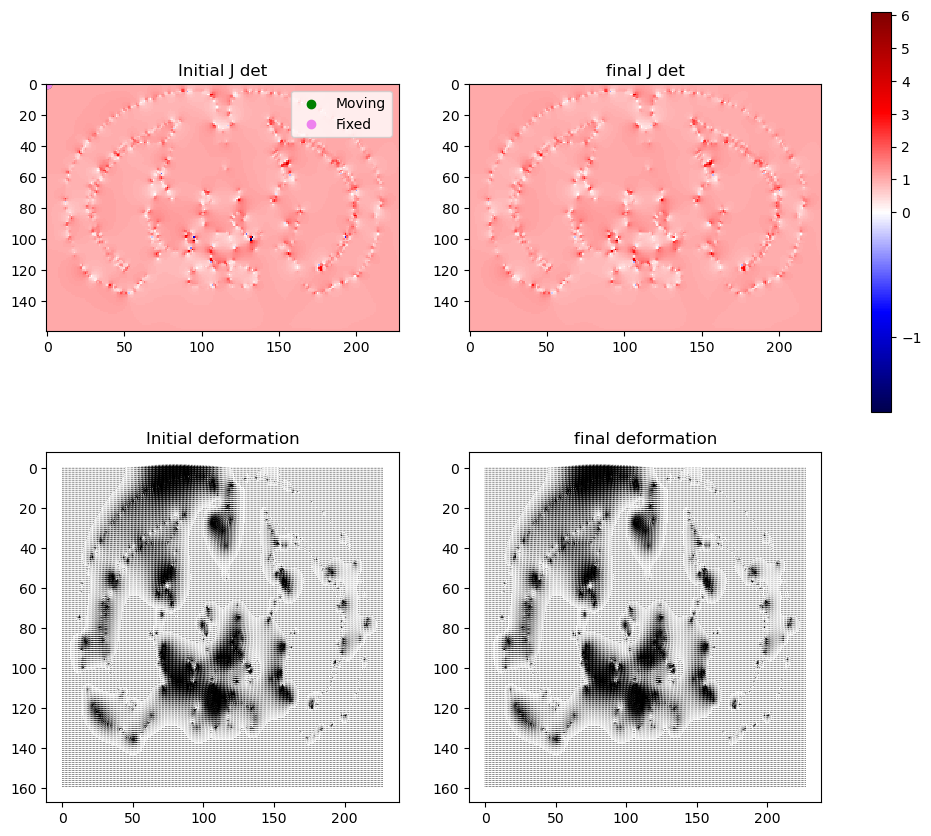


Continue flags:
False
y_start: 101, y_end: 112, x_start: 88, x_end: 99
submatrix_size==3: False OR
not window_reached_max: True
per_index_iter < max_per_index_iter: True
jacobian_submatrix < threshold - 1e-5: False
array([[ 1.00164772,  0.89159146,  0.69866023,  1.34287923,  1.46932354,  1.73854066,  2.60649529,  5.5277144 , -0.05784407,  0.27567992,  0.70701864],
       [ 0.90813123,  0.77184625,  0.56763031,  0.94692498,  1.44358926,  1.55633398,  1.91386284,  2.26206093,  0.5255821 ,  0.51280199,  0.72538273],
       [ 0.87951639,  0.76145795,  0.61087961,  0.43910239,  0.91100902,  1.14347482,  1.37623271,  1.40591212,  0.90737245,  0.79888389,  0.8490508 ],
       [ 0.89276608,  0.80422519,  0.71020395,  0.64262093,  0.71100676,  0.73515914,  1.11044406,  1.20048947,  1.05845068,  0.97536368,  0.96546418],
       [ 0.9285766 ,  0.86347718,  0.7793343 ,  0.66471919,  0.42324636,  0.44552848,  1.20067754,  1.23302   ,  1.17151029,  1.09280407,  1.05478502],
       [ 0.98261825,  0.

In [ ]:
idx = 350
scale_factor = 0.5

mpoints_path="data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path="data/corrected_correspondences_count_touching/fpoints.npy"

##############################################################################

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)

# Filter points for the specified slice
mask_m = msample[:, 0] == idx
mask_f = fsample[:, 0] == idx

new_mpoints = msample[mask_m].copy()
new_fpoints = fsample[mask_f].copy()

new_mpoints[:, 0] = 0
new_fpoints[:, 0] = 0

downscaled_mpoints = np.round(new_mpoints[:, :] * scale_factor).astype(int)
downscaled_fpoints = np.round(new_fpoints[:, :] * scale_factor).astype(int)

fixed_sample = np.zeros((1, int(320 * scale_factor), int(456 * scale_factor)))  # Adjusted size for smaller resolution

run_lapl_and_correction(fixed_sample, downscaled_mpoints, downscaled_fpoints)

## 1.0

In [ ]:
idx = 350
scale_factor = 1.0

mpoints_path="data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path="data/corrected_correspondences_count_touching/fpoints.npy"

##############################################################################

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)

# Filter points for the specified slice
mask_m = msample[:, 0] == idx
mask_f = fsample[:, 0] == idx

new_mpoints = msample[mask_m].copy()
new_fpoints = fsample[mask_f].copy()

new_mpoints[:, 0] = 0
new_fpoints[:, 0] = 0

downscaled_mpoints = np.round(new_mpoints[:, :] * scale_factor).astype(int)
downscaled_fpoints = np.round(new_fpoints[:, :] * scale_factor).astype(int)

fixed_sample = np.zeros((1, int(320 * scale_factor), int(456 * scale_factor)))  # Adjusted size for smaller resolution

run_lapl_and_correction(fixed_sample, downscaled_mpoints, downscaled_fpoints)

In [ ]:
slice_idx = 350
title = f"Case 2c - Real data slice {slice_idx}, downscaled to 20% (64 x 91)"
load_path = f"experiments/02c_64x91_slice{slice_idx}.npy"

save_path = f"paper_outputs/{load_path}"
# Sample moving and fixed points
msample = np.array([
    [0, 0, 0],
])
fsample = np.array([
    [0, 0, 0],
])
deformation_i = np.load(load_path)

##############################################################################################################

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)



phi_corrected, _ = full_slsqp(deformation_i, 'SLSQP')
np.save(save_path, phi_corrected)
plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10, 10), title=title, save_path=save_path)

## Jdet function testing

In [ ]:
# global val list
print(list_dev)
print('===')
print(num_neg_jac)
print('=====')
print(time_taken)

# L2
list_dev_L2 = [2.680895253076589, 69.80633869969029, 9.418067274643581, 69.80633869969029, 5.197075330527052, 1.8231005476373714, 2.2589086079637837, 2.8612431766103588, 0.0, 27.945036523729176]

num_neg_jac_init_L2 = [12, 158, 28, 158, 29, 5, 3, 2, 0, 129]

num_neg_jac_L2 = [0, 132, 15, 132, 0, 0, 0, 0, 0, 115]

# L2s
list_dev_L2s = [4.768607942055218, 26.252278493509536, 10026.7948106916, 26.252278493509536, 9.104921565888146, 2.379737612461383, 3.019209538644817, 3.1687868005130904, 0.0, 25.14703328621248]

num_neg_jac_L2s = [0, 137, 15, 137, 0, 0, 0, 0, 0, 109]

# L1

list_dev_L1 = [3.1452826411439276, 49.78213374285741, 12.373348412316172, 49.78213374285741, 12.224721045040889, 2.2478387386726184, 2.419587408528433, 3.1974909624498786, 0.0, 22.553299646732658]

num_neg_jac_L1 = [0, 135, 7, 135, 2, 0, 0, 0, 0, 106]

# L1s
list_dev_L1s = [3.8200316274887136, 27.98726389799386, 11.400909181236925, 27.98726389799386, 7.421816327869949, 2.3274873804728444, 2.952056050877296, 3.112671741644684, 0.0, 21.352944007229933]

num_neg_jac_L1s = [0, 132, 11, 132, 0, 0, 0, 0, 0, 110]

#L2wr
list_dev_L2wr = [1.3388562022484387e-06, 2.1911745978666906, 0.5583311141489217, 2.1911745978666906, 0.00010905921377629281, 8.880030350916757e-08, 8.065887478278329e-07, 8.93188013674346e-08, 0.0, 1.4515563532878142]

num_neg_jac_L2wr = [12, 156, 27, 156, 29, 5, 3, 2, 0, 125]

#L1wr - this
list_dev_L1wr = [1.8719204800182033e-05, 2.800815958456984, 0.6335240860765275, 2.800815958456984, 0.01548376720517454, 3.821057987703311e-05, 2.2714245365299625e-05, 3.223513937255436e-05, 0.0, 2.2229220010626967]

num_neg_jac_L1wr = [12, 156, 29, 156, 29, 5, 3, 2, 0, 123]

#L2swr
list_dev_L2swr = [6.347496024011014, 6.0603622126465195, 8.073554663868867, 6.0603622126465195, 9.805082662138908, 2.4315062468207964, 3.329061274139249, 1.7311478095318673, 0.0, 19.893147478504304]

num_neg_jac_L2swr = [0, 162, 30, 162, 6, 0, 0, 0, 0, 127]
tt_L2swr = [[1.0550048351287842, 15.897326946258545, 5.623910903930664, 16.062530040740967, 12.120941877365112, 0.3773469924926758, 0.3408081531524658, 0.3339860439300537, 0.15784001350402832, 8.772908926010132]
]
ttt_L2swr = 71.68918776512146

#L1swr
list_dev_L1swr = [3.300356140988371, 5.219200883030088, 3.8569020877225846, 5.219200883030088, 4.37866602840255, 1.4021137590566208, 2.0081703705493297, 1.228014013747989, 0.0, 11.192059918711248]

num_neg_jac_L1swr = [11, 156, 28, 156, 19, 4, 3, 0, 0, 121]
tt_L1swr = [38.703429222106934, 85.19641089439392, 57.048078775405884, 85.34915089607239, 37.369688749313354, 21.995036840438843, 18.338409185409546, 3.49845290184021, 0.16025185585021973, 81.12396311759949]

ttt_L1swr = 437.7158851623535

full_end = time.time()
print("time taken is", full_end-full_start)